## shNfkb components
2/12/2024 - Data generated from shNfkb1 single hairpin experiments; did not include hairpin library; data submitted by Jason/ERH/Selena/CHP on 1/19/2024

Analyze global run on cellranger v6 data and create h5_ad files for further analysis

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib

#from solo import hashsolo
import anndata

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/3827628456.py:2: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

scanpy==1.9.8 anndata==0.10.5.post1 umap==0.5.5 numpy==1.26.3 scipy==1.12.0 pandas==2.2.0 scikit-learn==1.4.0 statsmodels==0.14.1 igraph==0.11.3 pynndescent==0.5.11


In [3]:
results_file = 'write/shNfkb.h5ad'  # the file that will store the analysis results

Read in the count matrix into an [`AnnData`](https://anndata.readthedocs.io/en/latest/anndata.AnnData.html) object, which holds many slots for annotations and different representations of the data. It also comes with its own HDF5 file format: `.h5ad`.

In [4]:
adata = sc.read_10x_h5('filtered_feature_bc_matrix.h5', gex_only=False)

reading filtered_feature_bc_matrix.h5
 (0:00:01)


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/anndata/_core/anndata.py:1908: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [5]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [6]:
library = ["2117-Nfkb1.2331","2118-Nfkb1.3737",'JCP628-shIkbkg-1.2526','JCP629-shIkbkg-2.2984',
           'JCP618-shRela-1.1202','JCP621-shRela-4.1182','JCP623-shRel-1.1868',
           'JCP625-shRel-3.342','Ikbsr-FLAG','shRenilla']

In [7]:
samples = list(adata[:,adata.var['feature_types']=='Antibody Capture'].var.index)

In [8]:
print(samples)

['BE1156_(BD1671)_B0301', 'BE1155_(BD1672)_B0302', 'BD1939_B0303', 'BE1137_B0304', 'BE1157_(BD1674)_B0305', 'BD1941_B0306', 'BE1139_B0307', 'BE1140-NT_B0308', 'BE1490_B0309', 'BE1491-NT_B0310', 'BE1662_B0311', 'BF1240_(BE1834)_B0312', 'BF1087_B0313']


In [9]:
# Now filter out barcodes
hashadata = adata[:,samples]
adata = adata[:,[y for y in adata.var_names if y not in samples]]

In [10]:
hashadata.var

,gene_ids,feature_types,genome
BE1156_(BD1671)_B0301,BE1156_(BD1671)_B0301,Antibody Capture,
BE1155_(BD1672)_B0302,BE1155_(BD1672)_B0302,Antibody Capture,
BD1939_B0303,BD1939_B0303,Antibody Capture,
BE1137_B0304,BE1137_B0304,Antibody Capture,
BE1157_(BD1674)_B0305,BE1157_(BD1674)_B0305,Antibody Capture,
BD1941_B0306,BD1941_B0306,Antibody Capture,
BE1139_B0307,BE1139_B0307,Antibody Capture,
BE1140-NT_B0308,BE1140-NT_B0308,Antibody Capture,
BE1490_B0309,BE1490_B0309,Antibody Capture,
BE1491-NT_B0310,BE1491-NT_B0310,Antibody Capture,


## Preprocessing

Show those genes that yield the highest fraction of counts in each single cell, across all cells.

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


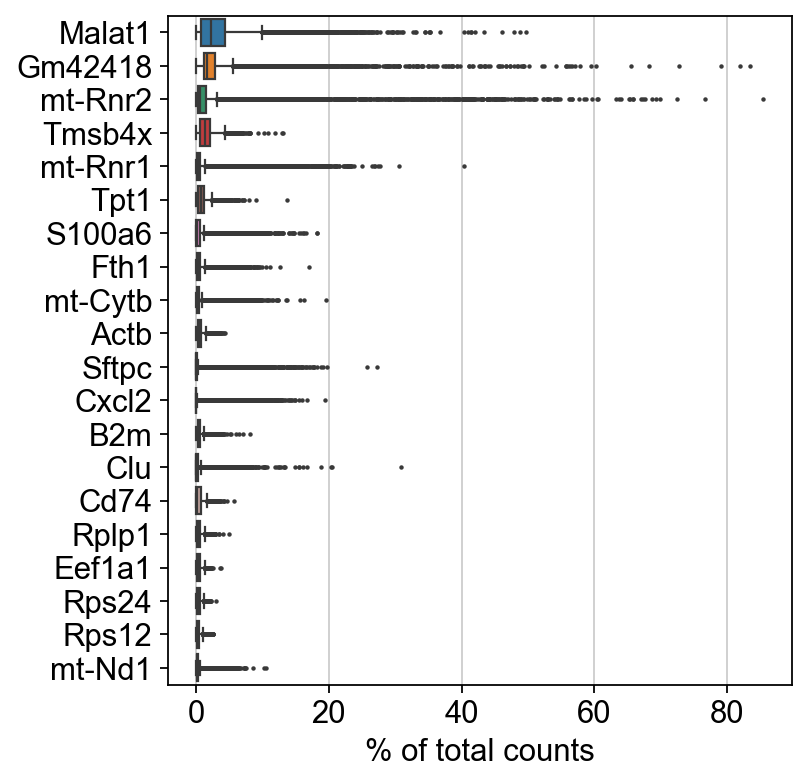

In [11]:
sc.pl.highest_expr_genes(adata, n_top=20, )

Basic filtering:

In [12]:
sc.pp.filter_cells(adata, min_counts=1500)
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)
#sc.pp.filter_genes(adata, min_cells=0.1*len(adata.obs))

filtered out 823 cells that have less than 1500 counts
filtered out 73 cells that have less than 300 genes expressed
filtered out 28131 genes that are detected in less than 3 cells


Let's assemble some information about mitochondrial genes, which are important for quality control.

Citing from "Simple Single Cell" workflows [(Lun, McCarthy & Marioni, 2017)](https://master.bioconductor.org/packages/release/workflows/html/simpleSingleCell.html#examining-gene-level-metrics):

> High proportions are indicative of poor-quality cells (Islam et al. 2014; Ilicic et al. 2016), possibly because of loss of cytoplasmic RNA from perforated cells. The reasoning is that mitochondria are larger than individual transcript molecules and less likely to escape through tears in the cell membrane.

With `pp.calculate_qc_metrics`, we can compute many metrics very efficiently.

In [13]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

A violin plot of some of the computed quality measures:

* the number of genes expressed in the count matrix
* the total counts per cell
* the percentage of counts in mitochondrial genes

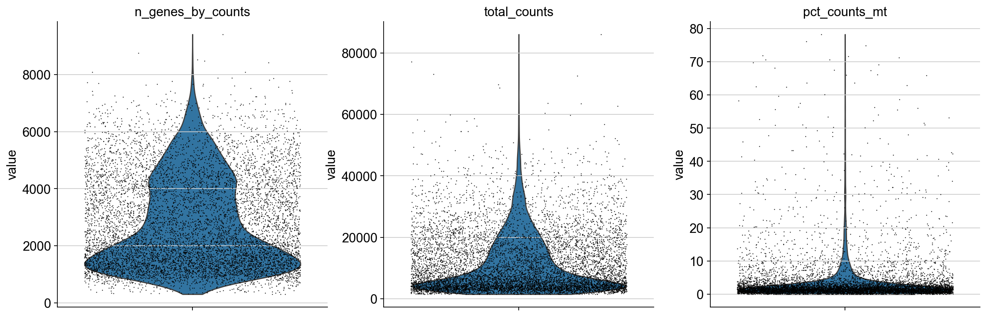

In [14]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

(array([   5.,   11.,   67.,  218.,  512., 1514., 2893., 2800.,  618.,
          36.]),
 array([0.68123135, 0.70865125, 0.73607115, 0.76349105, 0.79091096,
        0.81833086, 0.84575076, 0.87317066, 0.90059057, 0.92801047,
        0.95543037]),
 <BarContainer object of 10 artists>)

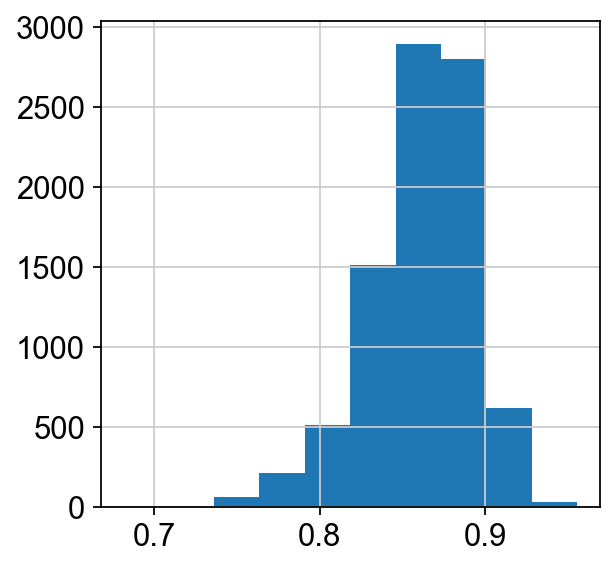

In [15]:
adata.obs["log10GenesPerUMI"] = adata.obs['n_genes_by_counts'].apply(math.log10) / adata.obs['total_counts'].apply(math.log10)
matplotlib.pyplot.hist(adata.obs["log10GenesPerUMI"])

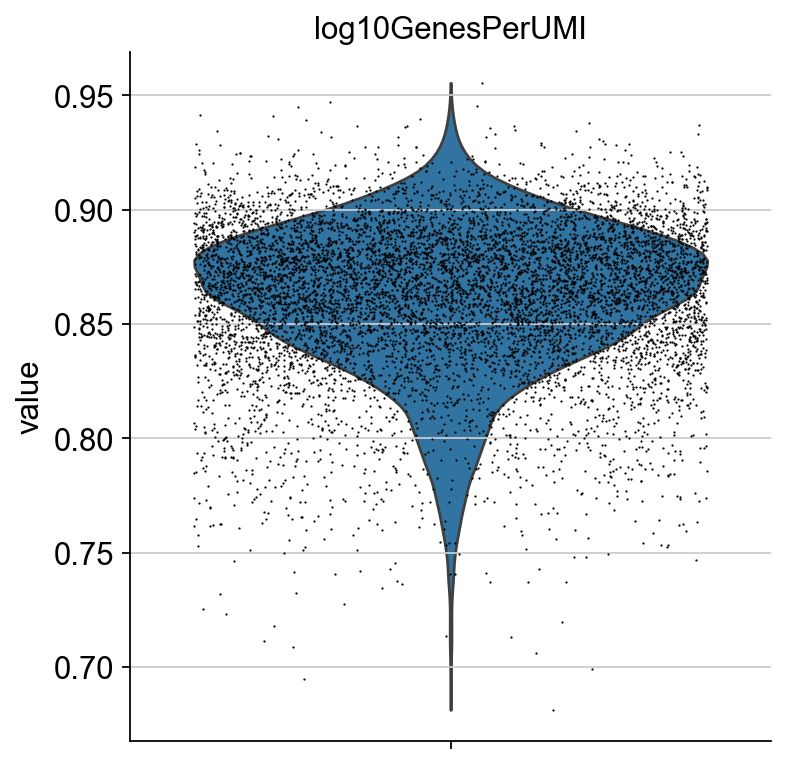

In [16]:
sc.pl.violin(adata, ['log10GenesPerUMI'],
             jitter=0.4, multi_panel=True, rotation=90)
#99% seems like a good Human pct count cutoff

Keep singlets, remove cells that have too many mouse reads, or mitochondrial genes expressed or too many total counts:

In [17]:
#Filter by Log10GenesPerUMI
adata = adata[adata.obs.log10GenesPerUMI >= 0.8,:]

In [18]:
#adata = adata[adata.obs.n_genes_by_counts < 2500, :]
adata = adata[adata.obs.pct_counts_mt <= 20, :]

## Run Demultiplexing

In [19]:
hashadata = hashadata[hashadata.obs.index.isin(adata.obs.index), :]

In [20]:
hashadata.var_names

Index(['BE1156_(BD1671)_B0301', 'BE1155_(BD1672)_B0302', 'BD1939_B0303',
       'BE1137_B0304', 'BE1157_(BD1674)_B0305', 'BD1941_B0306', 'BE1139_B0307',
       'BE1140-NT_B0308', 'BE1490_B0309', 'BE1491-NT_B0310', 'BE1662_B0311',
       'BF1240_(BE1834)_B0312', 'BF1087_B0313'],
      dtype='object')

In [21]:
hashCounts = pd.DataFrame(hashadata.X.todense(), columns=hashadata.var_names, index=adata.obs.index)

In [22]:
hashDisc = hashCounts.describe([.1,.2,.3,.4,.5,.6,.7,.8,.9,0.99])
hashDisc

,BE1156_(BD1671)_B0301,BE1155_(BD1672)_B0302,BD1939_B0303,BE1137_B0304,BE1157_(BD1674)_B0305,BD1941_B0306,BE1139_B0307,BE1140-NT_B0308,BE1490_B0309,BE1491-NT_B0310,BE1662_B0311,BF1240_(BE1834)_B0312,BF1087_B0313
count,8043.000000,8043.000000,8043.000000,8043.000000,8043.000000,8043.000000,8043.000000,8043.000000,8043.000000,8043.000000,8043.000000,8043.000000,8043.000000
mean,194.810150,171.674133,63.669029,12.613453,99.034317,168.007217,30.771851,168.484772,425.793976,66.910851,28.677359,21.218575,950.064392
std,1065.797729,1174.389893,559.442078,437.418213,496.304810,923.505798,393.445709,935.578979,1704.965210,463.165985,309.176086,444.463257,1276.697144
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10%,6.000000,8.000000,1.000000,0.000000,5.000000,6.000000,0.000000,8.000000,11.000000,0.000000,0.000000,0.000000,18.000000
20%,8.000000,10.000000,1.000000,0.000000,6.000000,7.000000,0.000000,10.000000,14.000000,1.000000,0.000000,0.000000,23.000000
30%,9.000000,12.000000,2.000000,0.000000,7.000000,8.000000,1.000000,11.000000,16.000000,1.000000,1.000000,0.000000,31.000000
40%,11.000000,13.000000,3.000000,0.000000,8.000000,9.000000,1.000000,12.000000,17.000000,2.000000,1.000000,0.000000,176.800000
50%,12.000000,14.000000,3.000000,0.000000,9.000000,11.000000,1.000000,14.000000,19.000000,2.000000,1.000000,0.000000,747.000000
60%,13.000000,16.000000,4.000000,0.000000,11.000000,12.000000,2.000000,15.000000,21.000000,3.000000,1.000000,1.000000,1056.200000


In [23]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(hashDisc.loc["90%",hashName])
    hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
hashIDs

BE1156_(BD1671)_B0301
25.0
BE1155_(BD1672)_B0302
26.0
BD1939_B0303
8.0
BE1137_B0304
2.0
BE1157_(BD1674)_B0305
39.0
BD1941_B0306
22.0
BE1139_B0307
4.0
BE1140-NT_B0308
28.0
BE1490_B0309
187.80000000000018
BE1491-NT_B0310
7.0
BE1662_B0311
3.0
BF1240_(BE1834)_B0312
2.0
BF1087_B0313
2266.8


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2942643048.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2942643048.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False  True]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2942643048.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise 

,BE1156_(BD1671)_B0301,BE1155_(BD1672)_B0302,BD1939_B0303,BE1137_B0304,BE1157_(BD1674)_B0305,BD1941_B0306,BE1139_B0307,BE1140-NT_B0308,BE1490_B0309,BE1491-NT_B0310,BE1662_B0311,BF1240_(BE1834)_B0312,BF1087_B0313
AAACCCAAGGACATCG-1,False,False,False,False,False,False,False,False,False,False,False,False,False
AAACCCAAGGGTAGCT-1,False,False,False,False,False,False,False,False,False,False,False,True,False
AAACCCAAGGTCCAGA-1,False,False,True,False,False,False,False,False,False,False,False,True,True
AAACCCACATCTAACG-1,False,False,False,False,False,False,False,False,True,False,False,False,False
AAACCCAGTCGCCTAG-1,False,False,False,False,False,False,False,False,True,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTCCAAATC-1,False,False,False,False,True,False,False,False,False,False,False,False,False
TTTGTTGTCACCATCC-1,False,False,False,False,False,False,False,False,False,False,True,False,False
TTTGTTGTCATGCCCT-1,False,False,False,False,False,False,True,False,False,False,False,False,False
TTTGTTGTCTATCACT-1,False,False,False,False,False,False,False,False,True,False,False,False,False


In [24]:
from matplotlib import pyplot as plt

In [25]:
hashCounts

,BE1156_(BD1671)_B0301,BE1155_(BD1672)_B0302,BD1939_B0303,BE1137_B0304,BE1157_(BD1674)_B0305,BD1941_B0306,BE1139_B0307,BE1140-NT_B0308,BE1490_B0309,BE1491-NT_B0310,BE1662_B0311,BF1240_(BE1834)_B0312,BF1087_B0313
AAACCCAAGGACATCG-1,10.0,18.0,3.0,0.0,10.0,13.0,0.0,15.0,18.0,1.0,3.0,0.0,1783.0
AAACCCAAGGGTAGCT-1,10.0,23.0,3.0,0.0,11.0,22.0,1.0,15.0,21.0,4.0,1.0,3.0,800.0
AAACCCAAGGTCCAGA-1,17.0,9.0,31.0,0.0,8.0,13.0,4.0,20.0,27.0,2.0,3.0,3.0,2311.0
AAACCCACATCTAACG-1,10.0,12.0,3.0,0.0,6.0,15.0,0.0,8.0,2989.0,3.0,1.0,2.0,1731.0
AAACCCAGTCGCCTAG-1,22.0,18.0,4.0,0.0,20.0,9.0,2.0,17.0,192.0,1.0,0.0,0.0,470.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTCCAAATC-1,12.0,16.0,2.0,0.0,325.0,9.0,2.0,17.0,22.0,1.0,2.0,2.0,18.0
TTTGTTGTCACCATCC-1,15.0,10.0,1.0,0.0,8.0,16.0,2.0,11.0,15.0,1.0,4.0,2.0,705.0
TTTGTTGTCATGCCCT-1,21.0,20.0,5.0,0.0,11.0,8.0,6.0,10.0,15.0,0.0,2.0,0.0,1989.0
TTTGTTGTCTATCACT-1,10.0,11.0,2.0,0.0,7.0,11.0,0.0,12.0,2288.0,2.0,3.0,1.0,17.0


In [26]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
plt.rcParams['figure.figsize'] = (3,4)

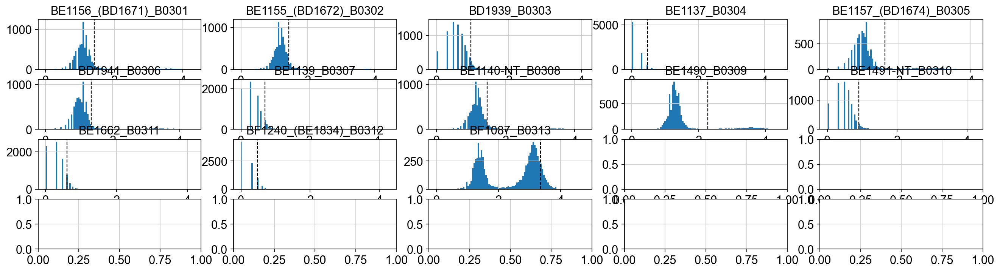

In [27]:
fig, axs = plt.subplots(4,5, figsize =(20, 5))

for i, hashName in enumerate(hashadata.var_names):
    hashCounts2 = np.log10(hashCounts[hashName]+1)
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].hist(hashCounts2, bins = 100)
    axs[i//5,i%5].axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)

#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

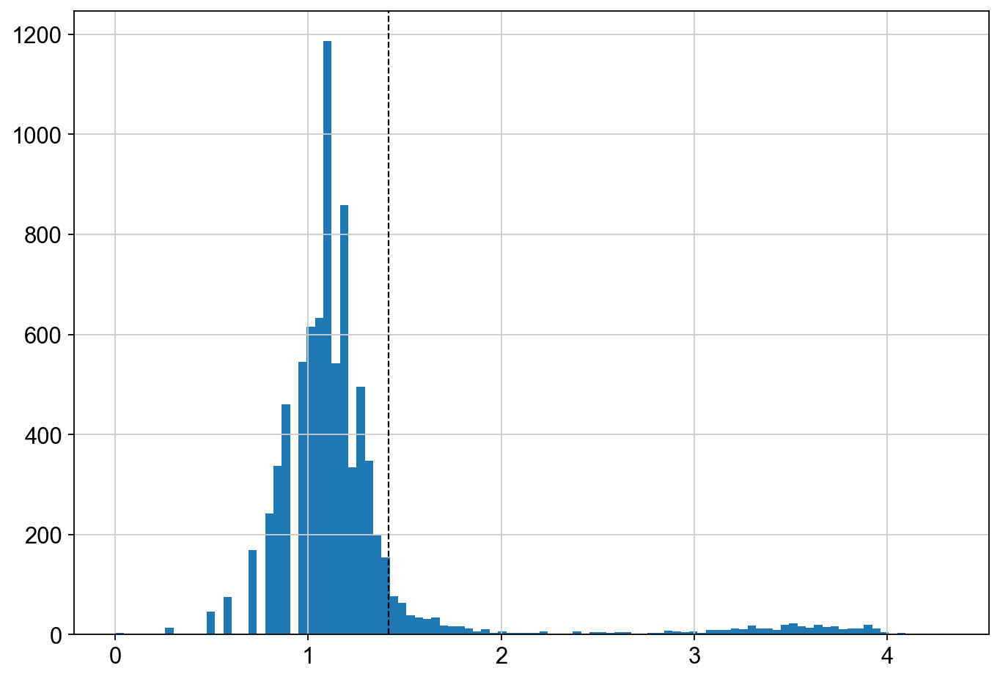

In [28]:
hashName= "BE1156_(BD1671)_B0301"
hash301 = np.log10(hashCounts[hashName]+1)

fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(hash301, bins = 100)
ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
plt.show()

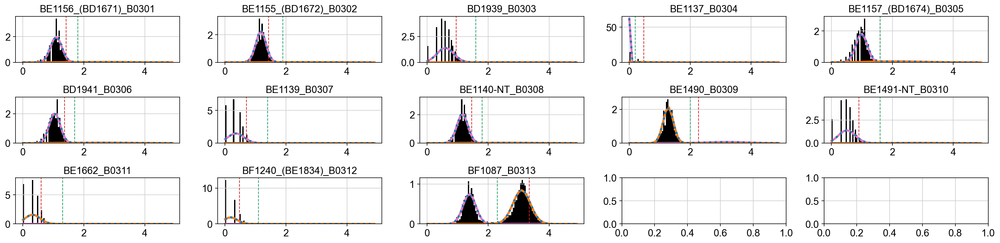

In [29]:
from sklearn.mixture import BayesianGaussianMixture
from scipy.stats import norm
fig, axs = plt.subplots(3,5, figsize =(20, 5))
dfHashBoundry = pd.DataFrame(np.zeros(len(hashadata.var_names)),hashadata.var_names, columns=["boundry"])
gmm = BayesianGaussianMixture(n_components=2, random_state=250,init_params='k-means++')
binEx = np.arange(0,5,5/100).reshape(-1,1)

for i, hashName in enumerate(hashadata.var_names):
    hashCount = np.array(np.log10(hashCounts[hashName]+1)).reshape(-1, 1)
    fitGMM = gmm.fit(hashCount)
    mean = fitGMM.means_  
    covs  = fitGMM.covariances_
    weights = fitGMM.weights_
  
    fitGmmBound = fitGMM.predict(binEx)

    x_axis = np.arange(0, 5, 0.1)
    y_axis0 = norm.pdf(x_axis, float(mean[0][0]), np.sqrt(float(covs[0][0][0])))*weights[0] # 1st gaussian
    y_axis1 = norm.pdf(x_axis, float(mean[1][0]), np.sqrt(float(covs[1][0][0])))*weights[1] # 2nd gaussian

    hashBoundry = False #binEx[np.where(fitGmmBound == 1)[0][0]][0]    
    if mean[0][0] < mean[1][0]:
        hashBoundry = x_axis[np.where(y_axis1 < y_axis0)[0][-1]+2]
    else:
        hashBoundry = x_axis[np.where(y_axis0 < y_axis1)[0][-1]+2]
    
    naiveBoundry = np.log10(int(hashDisc.loc["90%",hashName])+1)
    
    dfHashBoundry.loc[hashName] = hashBoundry
    
    # Plot 2
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].axvline(naiveBoundry, c='C3', linestyle='dashed', linewidth=1) #red
    axs[i//5,i%5].axvline(hashBoundry, c='C2', linestyle='dashed', linewidth=1)  #green
    axs[i//5,i%5].hist(hashCount, density=True, color='black', bins=100)        
    axs[i//5,i%5].plot(x_axis, y_axis0, lw=3, c='C6')                            #pink
    axs[i//5,i%5].plot(x_axis, y_axis1, lw=3, c='C1')                            #orange
    axs[i//5,i%5].plot(x_axis, y_axis0+y_axis1, lw=3, c='C0', ls=':')            #dotted blue
    
plt.tight_layout(pad=1.0)
#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

In [30]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(dfHashBoundry.loc[hashName].values[0])
    hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
#hashIDs.loc[:,'AT1129_B0304_2117'] = False
#hashIDs.loc[:,'AT1606_B0305_Renilla'] = False
#hashIDs.loc[:,'AT1831_B0306_2117'] = False
#hashIDs.loc[:,'AT1607_B0307_Renilla'] = False
#hashIDs.loc[:,'AV1189_B0310_2118'] = False
hashIDs

BE1156_(BD1671)_B0301
1.8
BE1155_(BD1672)_B0302
1.9000000000000001
BD1939_B0303
1.6
BE1137_B0304
0.2
BE1157_(BD1674)_B0305
1.6
BD1941_B0306
1.7000000000000002
BE1139_B0307
1.4000000000000001
BE1140-NT_B0308
1.8
BE1490_B0309
2.0
BE1491-NT_B0310
1.6
BE1662_B0311
1.3
BF1240_(BE1834)_B0312
1.1
BF1087_B0313
2.3000000000000003


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/1750252066.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/1750252066.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False  True]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/1750252066.py:6: FutureWarning: Setting an item of incomp

,BE1156_(BD1671)_B0301,BE1155_(BD1672)_B0302,BD1939_B0303,BE1137_B0304,BE1157_(BD1674)_B0305,BD1941_B0306,BE1139_B0307,BE1140-NT_B0308,BE1490_B0309,BE1491-NT_B0310,BE1662_B0311,BF1240_(BE1834)_B0312,BF1087_B0313
AAACCCAAGGACATCG-1,False,False,False,False,False,False,False,False,False,False,False,False,True
AAACCCAAGGGTAGCT-1,False,False,False,False,False,False,False,False,False,False,False,False,True
AAACCCAAGGTCCAGA-1,False,False,False,False,False,False,False,False,False,False,False,False,True
AAACCCACATCTAACG-1,False,False,False,False,False,False,False,False,True,False,False,False,True
AAACCCAGTCGCCTAG-1,False,False,False,False,False,False,False,False,True,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTCCAAATC-1,False,False,False,False,True,False,False,False,False,False,False,False,False
TTTGTTGTCACCATCC-1,False,False,False,False,False,False,False,False,False,False,False,False,True
TTTGTTGTCATGCCCT-1,False,False,False,False,False,False,False,False,False,False,False,False,True
TTTGTTGTCTATCACT-1,False,False,False,False,False,False,False,False,True,False,False,False,False


In [31]:
classification = np.empty(len(adata), dtype="object")
i = 0
for cellBar, hashBool in hashIDs.iterrows():
    #print(i)
    #print(hashBool)
    #print(hashBool.values)
    #print(sum(hashBool))
    numHashes = sum(hashBool)
    if (numHashes == 1):
        classif = hashID[hashBool.values].values[0]
    elif (numHashes > 1):
        classif = "doublet"
    else:
        classif = "negative"
    classification[i] = classif
    i = i + 1
    #break

In [32]:
adata.obs["Classification"] = classification
hashadata.obs["Classification"] = classification
adata.obs["Classification"].value_counts()

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/4135005838.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["Classification"] = classification
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/4135005838.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  hashadata.obs["Classification"] = classification


Classification
doublet                  3287
BF1087_B0313             2706
BE1490_B0309              452
BE1157_(BD1674)_B0305     397
BD1941_B0306              247
BE1156_(BD1671)_B0301     188
negative                  185
BE1491-NT_B0310           167
BE1155_(BD1672)_B0302     126
BE1137_B0304               69
BE1662_B0311               58
BD1939_B0303               57
BE1140-NT_B0308            53
BE1139_B0307               40
BF1240_(BE1834)_B0312      11
Name: count, dtype: int64

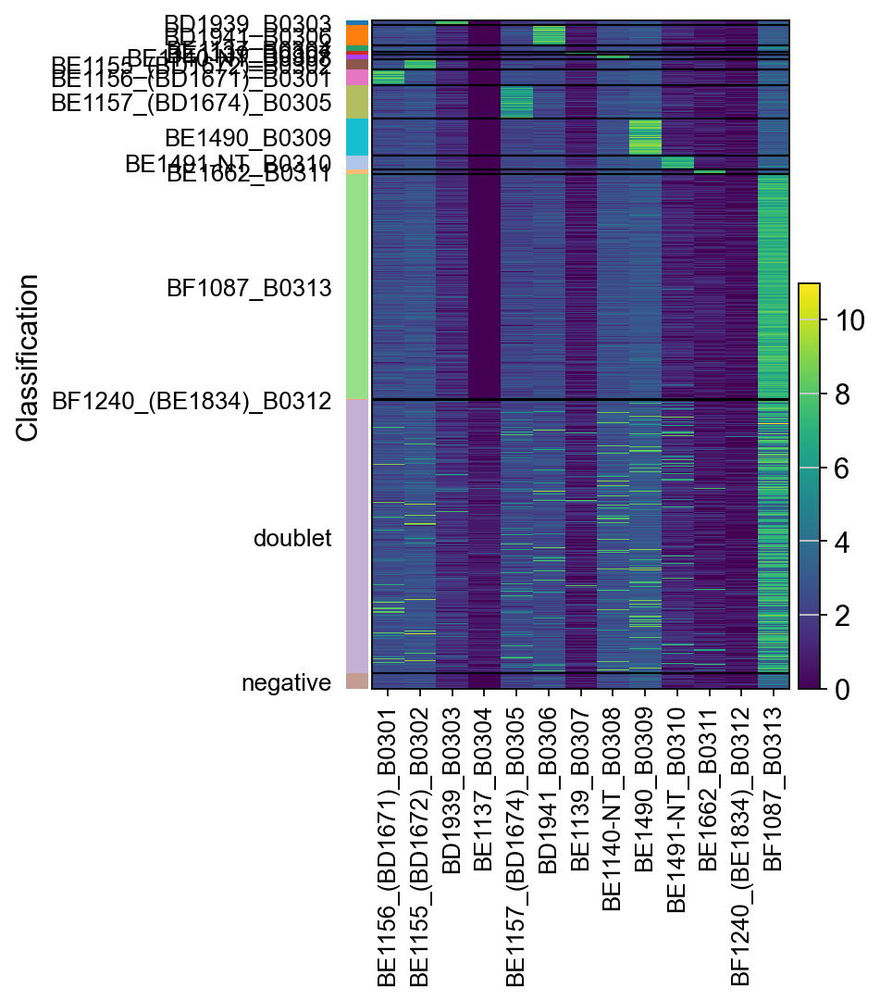

In [33]:
#output visulaization of hashing
sc.pl.heatmap(hashadata, hashadata.var_names, groupby="Classification", log=True)#, save = f"_{figName}_hash.png")

## Scrublet

## Examine raw data

## set highly variable genes before moving all mean to 0

(array([7.97e+03, 3.60e+01, 1.90e+01, 1.00e+01, 4.00e+00, 1.00e+00,
        2.00e+00, 0.00e+00, 0.00e+00, 1.00e+00]),
 array([  0.        ,  10.80000019,  21.60000038,  32.40000153,
         43.20000076,  54.        ,  64.80000305,  75.59999847,
         86.40000153,  97.19999695, 108.        ]),
 <BarContainer object of 10 artists>)

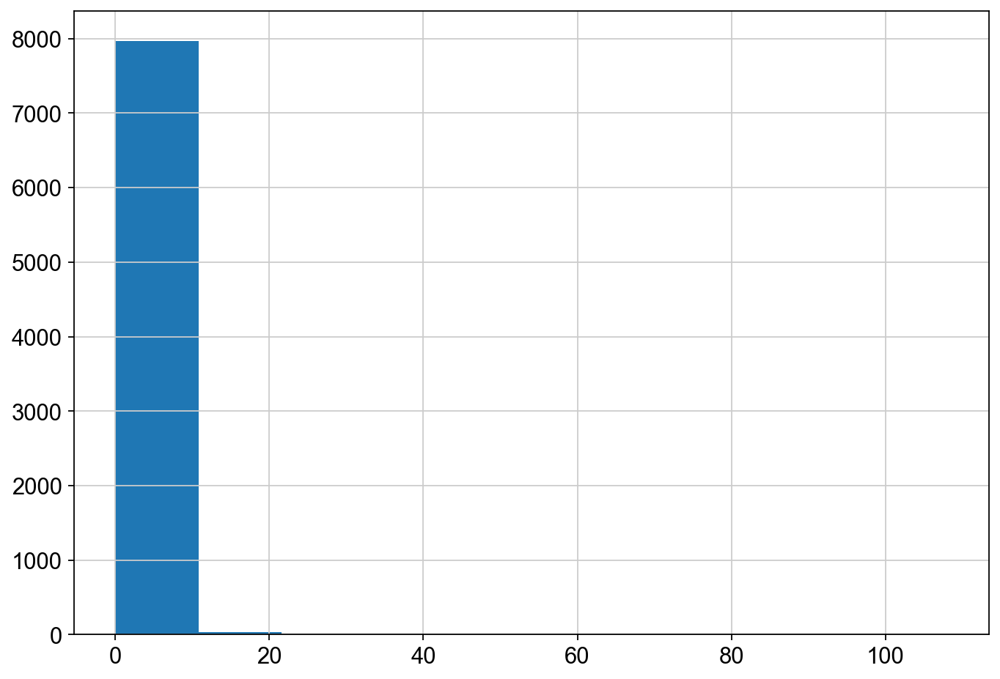

In [34]:
#Remove any cell with PTPRC counts
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata.X[:,adata.var.index.isin(['shRenilla'])].toarray())
#ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
#adata.obs['shRen'] = 0

#adata.obs['shRenilla'][adata.X[:,adata.var.index.isin(['shRenilla'])] >0] #= adata.X[:,adata.var.index.isin(['shRenilla'])]

In [35]:
adata.obs['shRen'] = adata.X[:,adata.var.index.isin(['shRenilla'])].toarray()

(array([7.989e+03, 3.300e+01, 1.100e+01, 6.000e+00, 2.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 1.000e+00]),
 array([  0.        ,  15.69999981,  31.39999962,  47.09999847,
         62.79999924,  78.5       ,  94.19999695, 109.90000153,
        125.59999847, 141.30000305, 157.        ]),
 <BarContainer object of 10 artists>)

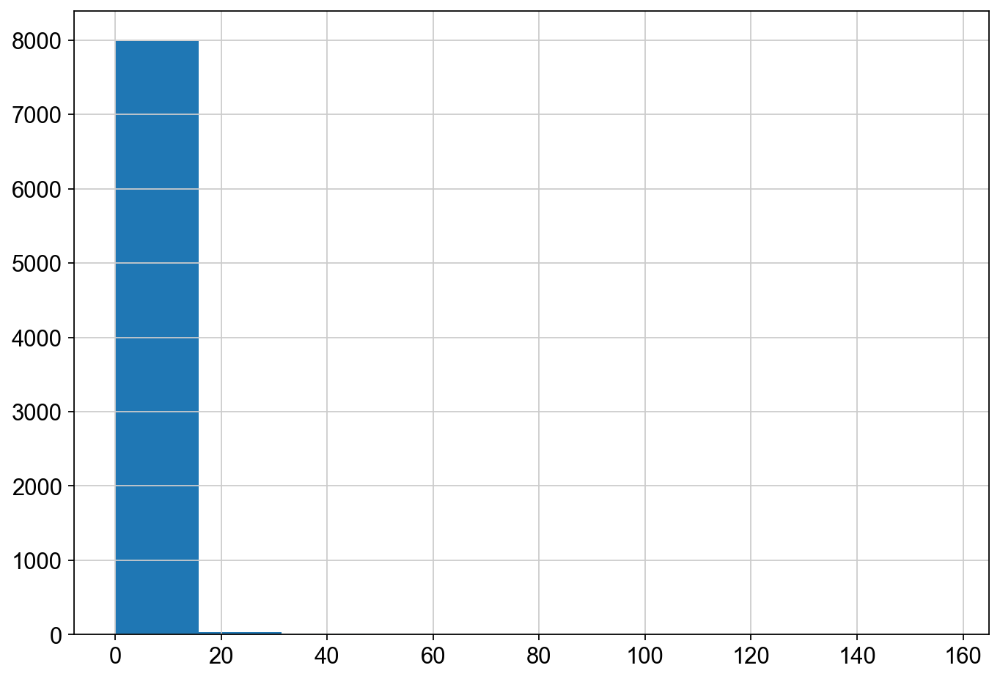

In [36]:
#Remove any cell with PTPRC counts
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata.X[:,adata.var.index.isin(['2118-Nfkb1.3737'])].toarray())
#ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
#adata.obs['2118-Nfkb1.3737'] = 0

#adata.obs['shRenilla'][adata.X[:,adata.var.index.isin(['shRenilla'])] >0] #= adata.X[:,adata.var.index.isin(['shRenilla'])]

In [37]:
adata.obs['2118-Nfkb1'] = adata.X[:,adata.var.index.isin(['2118-Nfkb1.3737'])].toarray()

(array([7.976e+03, 4.400e+01, 1.300e+01, 6.000e+00, 3.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([  0. ,  12.5,  25. ,  37.5,  50. ,  62.5,  75. ,  87.5, 100. ,
        112.5, 125. ]),
 <BarContainer object of 10 artists>)

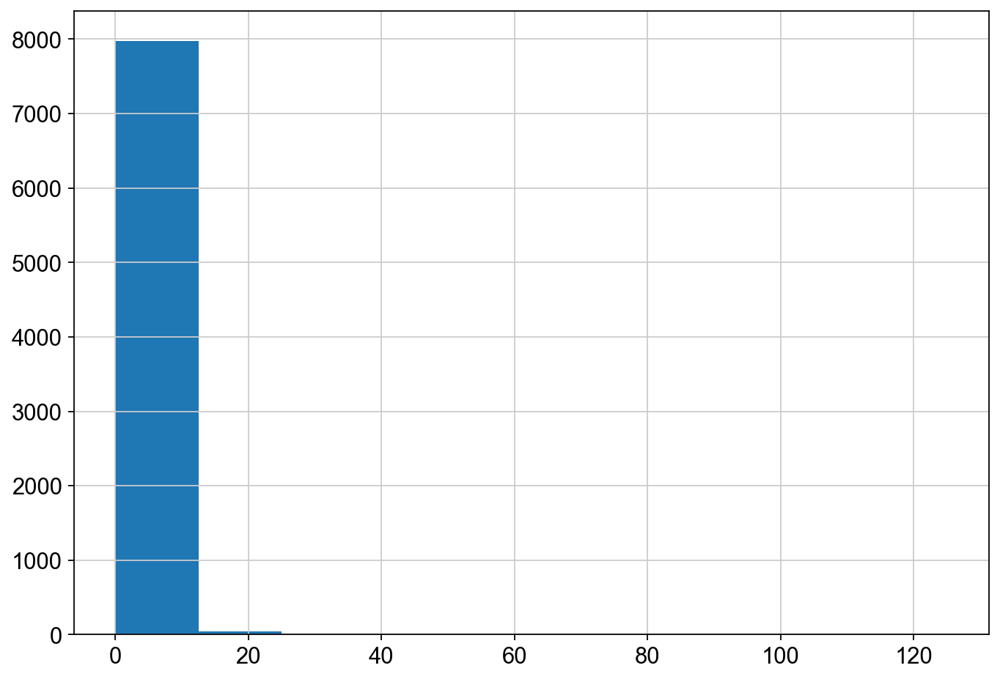

In [38]:
#Remove any cell with PTPRC counts
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata.X[:,adata.var.index.isin(['JCP621-shRela-4.1182'])].toarray())
#ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
#adata.obs['2118-Nfkb1.3737'] = 0

#adata.obs['shRenilla'][adata.X[:,adata.var.index.isin(['shRenilla'])] >0] #= adata.X[:,adata.var.index.isin(['shRenilla'])]

In [39]:
adata.obs['shRela'] = adata.X[:,adata.var.index.isin(['JCP621-shRela-4.1182'])].toarray()

(array([7.932e+03, 4.600e+01, 3.500e+01, 1.300e+01, 5.000e+00, 3.000e+00,
        2.000e+00, 4.000e+00, 2.000e+00, 1.000e+00]),
 array([  0.        ,  13.80000019,  27.60000038,  41.40000153,
         55.20000076,  69.        ,  82.80000305,  96.59999847,
        110.40000153, 124.19999695, 138.        ]),
 <BarContainer object of 10 artists>)

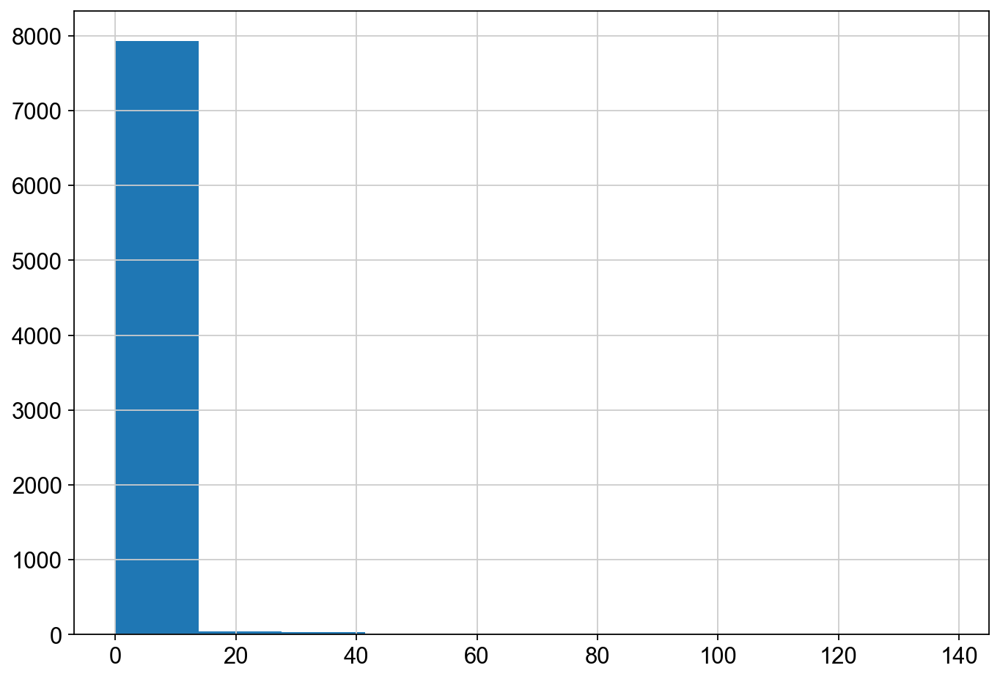

In [40]:
#Remove any cell with PTPRC counts
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata.X[:,adata.var.index.isin(['JCP625-shRel-3.342'])].toarray())
#ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
#adata.obs['2118-Nfkb1.3737'] = 0

#adata.obs['shRenilla'][adata.X[:,adata.var.index.isin(['shRenilla'])] >0] #= adata.X[:,adata.var.index.isin(['shRenilla'])]

In [41]:
adata.obs['shRel'] = adata.X[:,adata.var.index.isin(['JCP625-shRel-3.342'])].toarray()

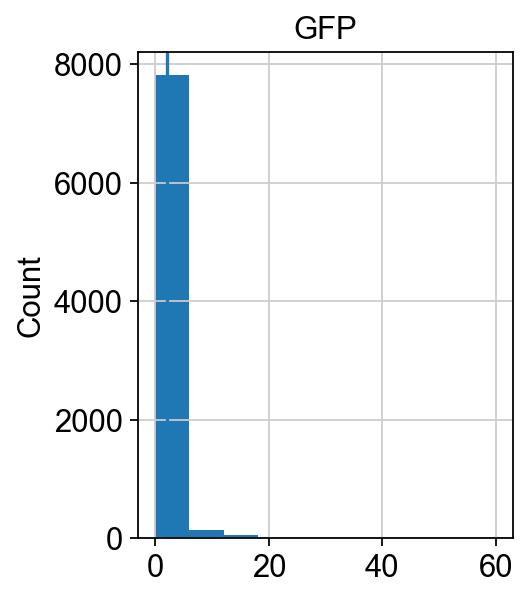

In [42]:
import matplotlib.pyplot as plt
adata.var.index.isin(['GFP'])
_ = plt.hist(adata[adata.obs.index,'GFP'].X.toarray())
plt.ylabel("Count")
plt.title("GFP")
plt.axvline(x=2)
plt.show()

In [43]:
adata.obs['GFP_count'] = adata.X[:,adata.var.index.isin(['GFP'])].toarray()

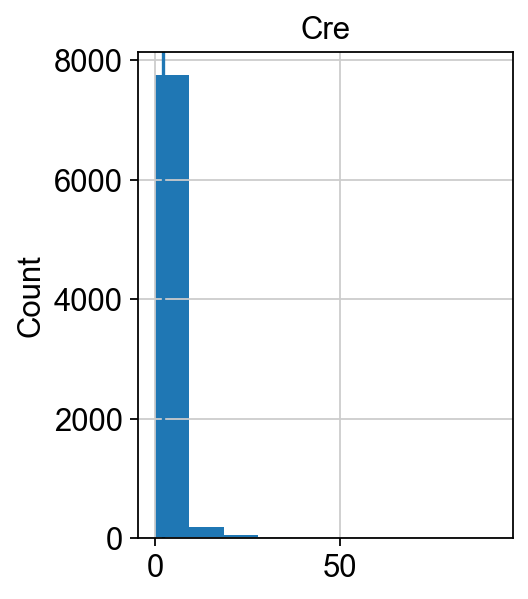

In [44]:
import matplotlib.pyplot as plt
adata.var.index.isin(['GFP'])
_ = plt.hist(adata[adata.obs.index,'Cre'].X.toarray())
plt.ylabel("Count")
plt.title("Cre")
plt.axvline(x=2)
plt.show()

In [45]:
adata.obs['Cre_count'] = adata.X[:,adata.var.index.isin(['Cre'])].toarray()

## Filter doublets and negative cells

In [46]:
adata.obs.Classification.value_counts()

Classification
doublet                  3287
BF1087_B0313             2706
BE1490_B0309              452
BE1157_(BD1674)_B0305     397
BD1941_B0306              247
BE1156_(BD1671)_B0301     188
negative                  185
BE1491-NT_B0310           167
BE1155_(BD1672)_B0302     126
BE1137_B0304               69
BE1662_B0311               58
BD1939_B0303               57
BE1140-NT_B0308            53
BE1139_B0307               40
BF1240_(BE1834)_B0312      11
Name: count, dtype: int64

In [47]:
#adata = adata[~(adata.obs['Classification'].isin(['doublet','negative']) | adata.obs.Scrublet_doublet),:]
adata = adata[~adata.obs['Classification'].isin(['doublet','negative']),:]

In [48]:
adata.obs.Classification.value_counts()

Classification
BF1087_B0313             2706
BE1490_B0309              452
BE1157_(BD1674)_B0305     397
BD1941_B0306              247
BE1156_(BD1671)_B0301     188
BE1491-NT_B0310           167
BE1155_(BD1672)_B0302     126
BE1137_B0304               69
BE1662_B0311               58
BD1939_B0303               57
BE1140-NT_B0308            53
BE1139_B0307               40
BF1240_(BE1834)_B0312      11
Name: count, dtype: int64

## Filter genes ( >= 1% of cells )

In [49]:
#sc.pp.filter_genes(adata, min_cells=0.01*len(adata.obs))

## Set Groups

In [50]:
samples

['BE1156_(BD1671)_B0301',
 'BE1155_(BD1672)_B0302',
 'BD1939_B0303',
 'BE1137_B0304',
 'BE1157_(BD1674)_B0305',
 'BD1941_B0306',
 'BE1139_B0307',
 'BE1140-NT_B0308',
 'BE1490_B0309',
 'BE1491-NT_B0310',
 'BE1662_B0311',
 'BF1240_(BE1834)_B0312',
 'BF1087_B0313']

In [51]:
#Set shRNA groups
adata.obs['shRNA'] = None
adata.obs['shRNA'][adata[adata.obs['shRen'] >= 2,:].obs.index] = 'shRenilla'
adata.obs['shRNA'][adata[adata.obs['2118-Nfkb1'] >= 2,:].obs.index] = '2118'
adata.obs['shRNA'][adata[adata.obs['shRel'] >= 2,:].obs.index] = 'shRel'
adata.obs['shRNA'][adata[adata.obs['shRela'] >= 2,:].obs.index] = 'shRela'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/74134016.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['shRNA'] = None
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/74134016.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pa

In [52]:
samples

['BE1156_(BD1671)_B0301',
 'BE1155_(BD1672)_B0302',
 'BD1939_B0303',
 'BE1137_B0304',
 'BE1157_(BD1674)_B0305',
 'BD1941_B0306',
 'BE1139_B0307',
 'BE1140-NT_B0308',
 'BE1490_B0309',
 'BE1491-NT_B0310',
 'BE1662_B0311',
 'BF1240_(BE1834)_B0312',
 'BF1087_B0313']

In [53]:
#Set shRNA groups
adata.obs['Group'] = 'shNfkb1'
adata.obs['Group'][adata.obs.Classification.isin(['BF1240_(BE1834)_B0312','BF1087_B0313'])] = 'shRenilla'
adata.obs['Group'][adata.obs.Classification.isin(['BE1157_(BD1674)_B0305','BD1941_B0306','BE1139_B0307','BE1140-NT_B0308'])] = 'shRela'
adata.obs['Group'][adata.obs.Classification.isin(['BE1490_B0309','BE1491-NT_B0310','BE1662_B0311'])] = 'shRel'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/3992414676.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.obs['Group'][adata.obs.Classification.isin(['BF1240_(BE1834)_B0312','BF1087_B0313'])] = 'shRenilla'
/var/fo

## Double check shRNAs and filter accordingly

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/s

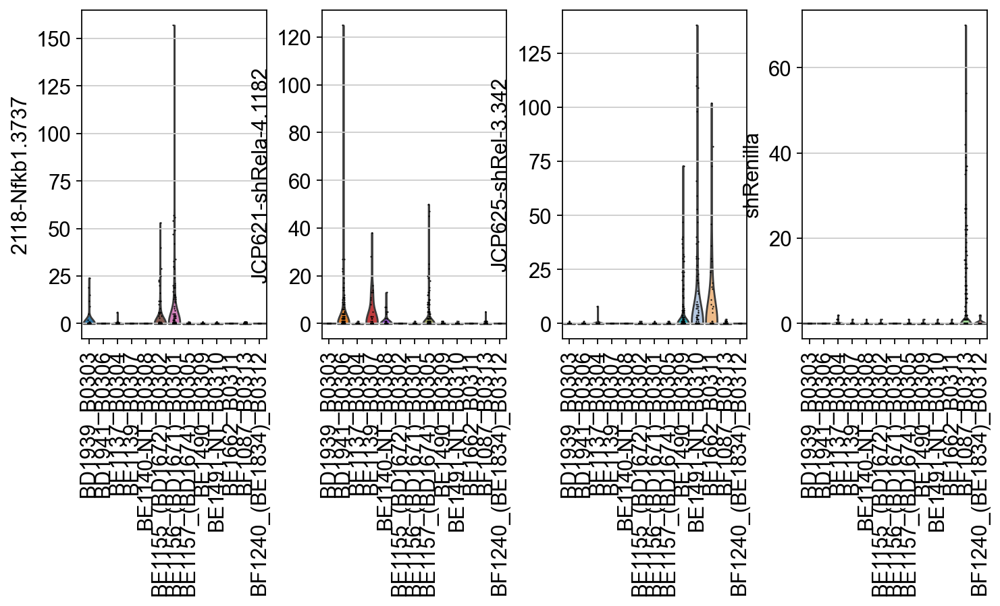

In [54]:
sc.pl.violin(adata,['2118-Nfkb1.3737','JCP621-shRela-4.1182','JCP625-shRel-3.342', 'shRenilla'], groupby='Classification', rotation=90)

In [55]:
adata.obs[['shRNA','Group']].value_counts(sort=False)

shRNA      Group    
2118       shNfkb1       80
shRel      shNfkb1        1
           shRel        120
           shRenilla      1
shRela     shRela       127
           shRenilla      1
shRenilla  shNfkb1        2
           shRenilla     79
Name: count, dtype: int64

In [56]:
#start here

In [57]:
adata = adata[~((adata.obs.shRNA.isin(['shRela']) & adata.obs.Group.isin(['shRenilla'])) | 
                (adata.obs.shRNA.isin(['shRenilla']) & adata.obs.Group.isin(['shNfkb1'])) |
               (adata.obs.shRNA.isin(['shRel']) & adata.obs.Group.isin(['shNfkb1','shRenilla']))),:]

In [58]:
adata.obs[['shRNA','Group']].value_counts()

shRNA      Group    
shRela     shRela       127
shRel      shRel        120
2118       shNfkb1       80
shRenilla  shRenilla     79
Name: count, dtype: int64

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/s

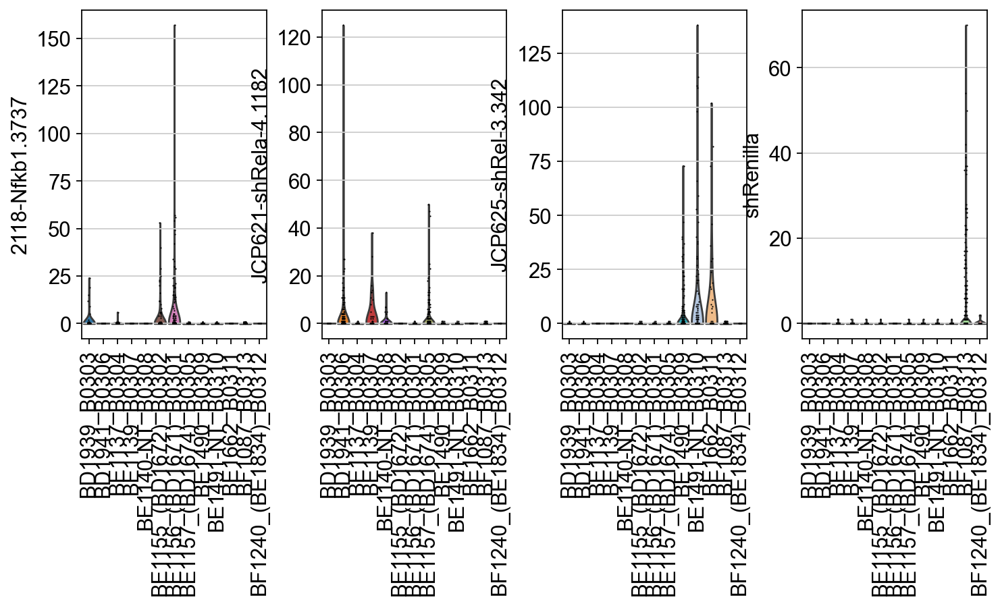

In [59]:
sc.pl.violin(adata,['2118-Nfkb1.3737','JCP621-shRela-4.1182','JCP625-shRel-3.342', 'shRenilla'], groupby='Classification', rotation=90)

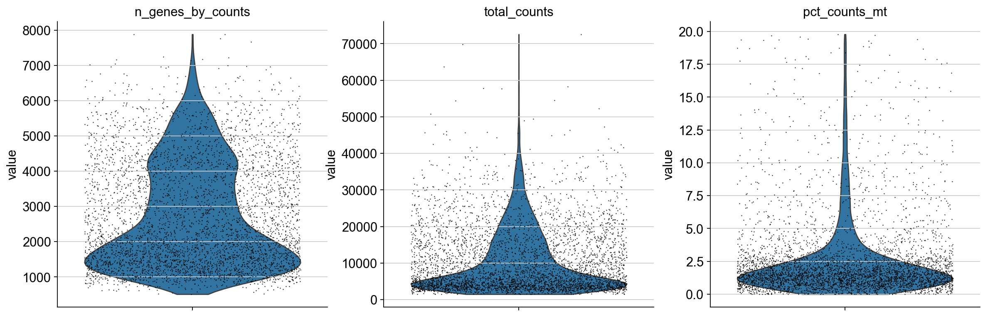

In [60]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

In [61]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [62]:
adata.layers['counts']=adata.X.copy()

Logarithmize the data:

In [63]:
sc.pp.log1p(adata)

In [64]:
sc.pp.highly_variable_genes(adata) #batch_key=Classification

extracting highly variable genes


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


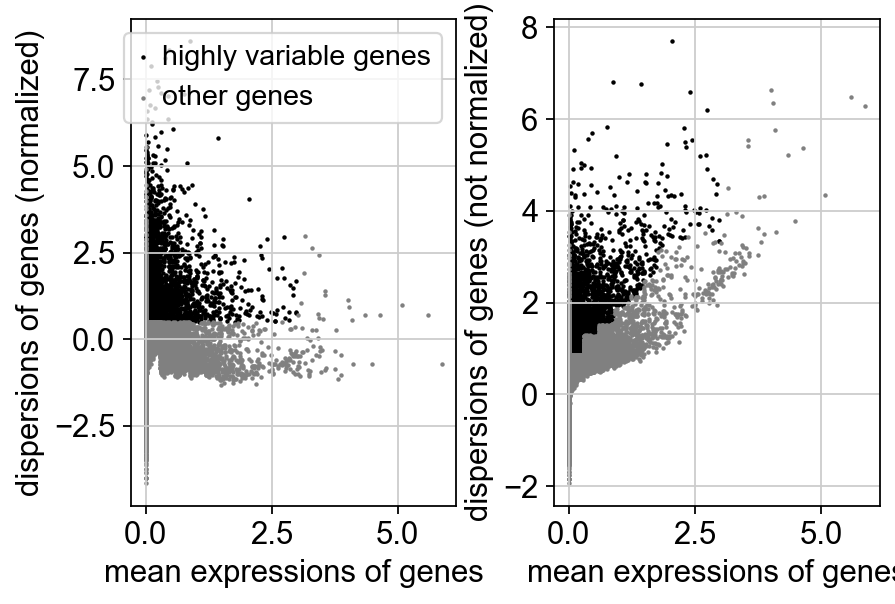

In [65]:
sc.pl.highly_variable_genes(adata)

In [66]:
library = ["1659-Fosl2.226","1660-Fosl2.752","1661-Fhl2.467","1662-Fhl2.179","1663-Myc.989","1664-Myc.1389","1665-Yap1.735","1666-Yap1.2847","1667-Atf4.1383","1668-Atf4.536","1669-Maff.85","1670-Maff.587","1671-Nfkb2.152","1672-Nfkb2.534","1673-Relb.286","1674-Relb.1795","1675-Onecut2.1799","1676-Onecut2.2361","1810-Slc4a11.541","1934-Slc4a11.1966","1811-Itga2.672","1812-Itga2.204","1998-Cldn4-1013","1999-Cldn4-951","2113-Lif.440","2114-Lif.1890","2115-Fosl1.1401","2116-Fosl1.699","2117-Nfkb1.2331","2118-Nfkb1.3737","2190-Jun_2481","2191-Jun_3136","2193-JunB_406","2194-JunD_78","2195-JunD_859","JCP618-Rela_1202","JCP621-Rela_1182","JCP623-Rel_1868","JCP625-Rel_342","JCP628-Ikbkg_2526","JCP629-Ikbkg_2984"]

In [67]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['GFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Cre'] = False
for x in library:
    adata.var.highly_variable[x] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2494002207.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['GFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2494002

In [68]:
adata.raw = adata

In [69]:
adata.write('write/allmice.h5ad', compression='gzip')

In [70]:
adata = sc.read('write/allmice.h5ad')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [71]:
adata = adata[:, adata.var.highly_variable]

In [72]:
sc.pp.scale(adata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [73]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:01)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often a rough estimate of the number of PCs does fine.

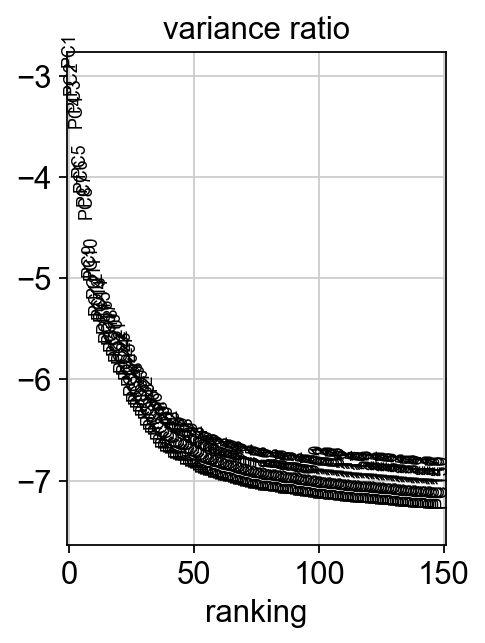

In [74]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

In [75]:
adata.write(results_file, compression='gzip')

In [76]:
adata

AnnData object with n_obs × n_vars = 4566 × 4031
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'shRen', '2118-Nfkb1', 'shRela', 'shRel', 'GFP_count', 'Cre_count', 'shRNA', 'Group'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Classification_colors', 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [77]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=70)

computing neighbors
    using 'X_pca' with n_pcs = 70
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


## Embedding the neighborhood graph

We suggest embedding the graph in two dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [78]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


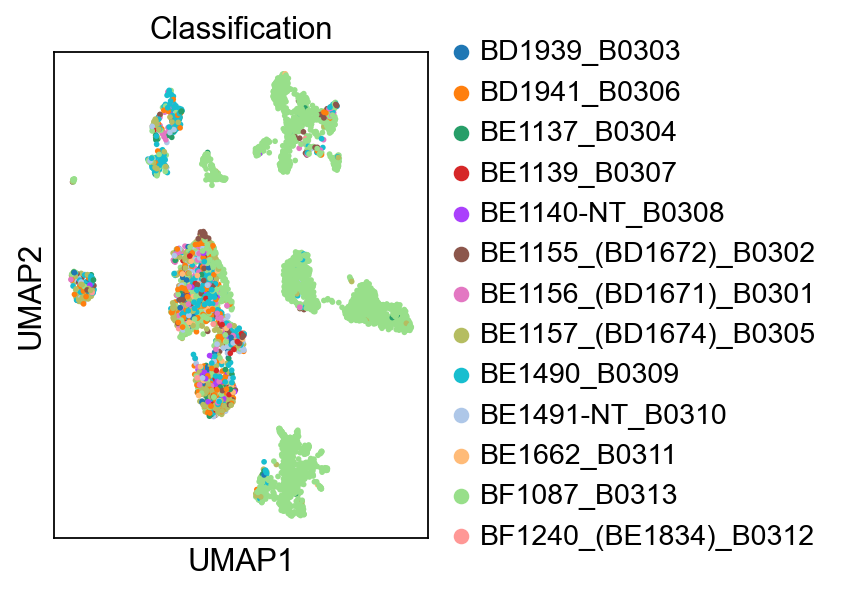

In [79]:
sc.pl.umap(adata, color=['Classification'])

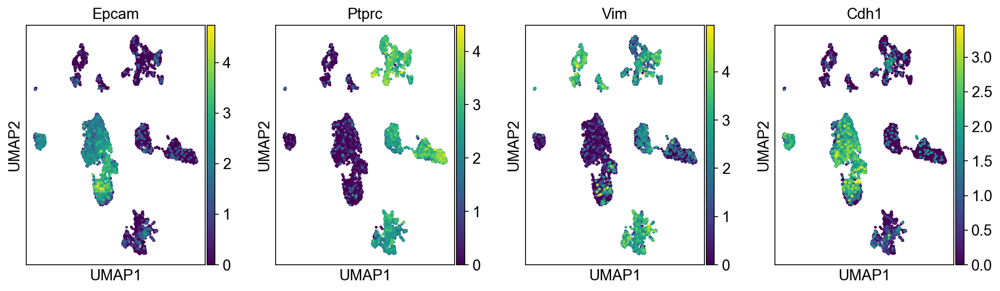

In [80]:
sc.pl.umap(adata, color=['Epcam','Ptprc','Vim', 'Cdh1',]) #'Ptprc','Cdh2'

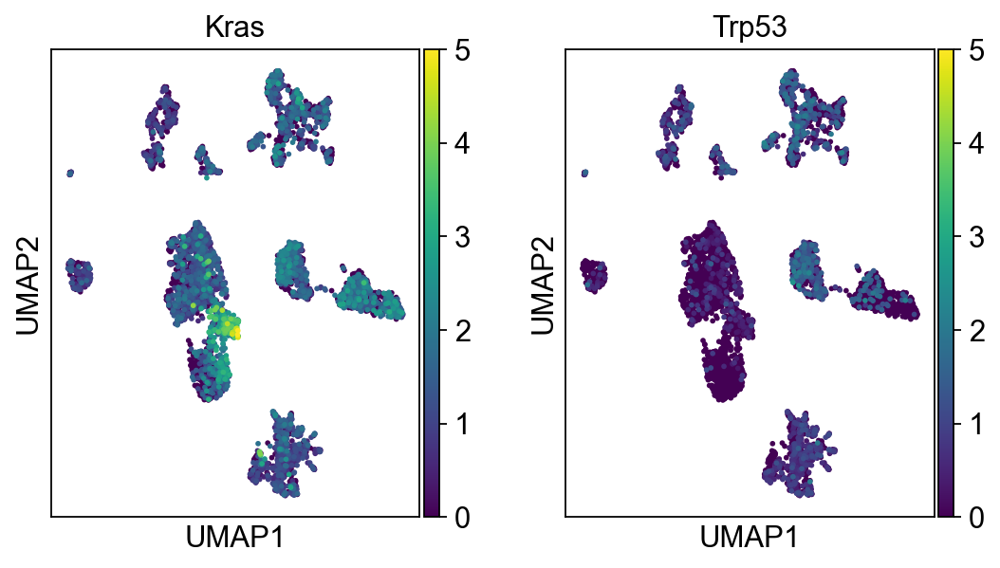

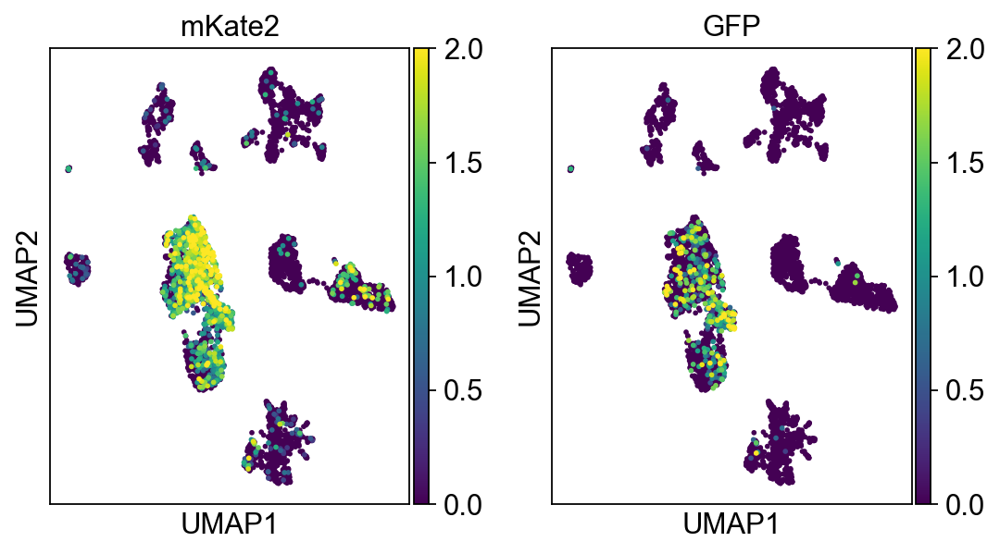

In [81]:
sc.pl.umap(adata, color=['Kras','Trp53'], vmax=5)
sc.pl.umap(adata, color=['mKate2','GFP'], vmax=2)

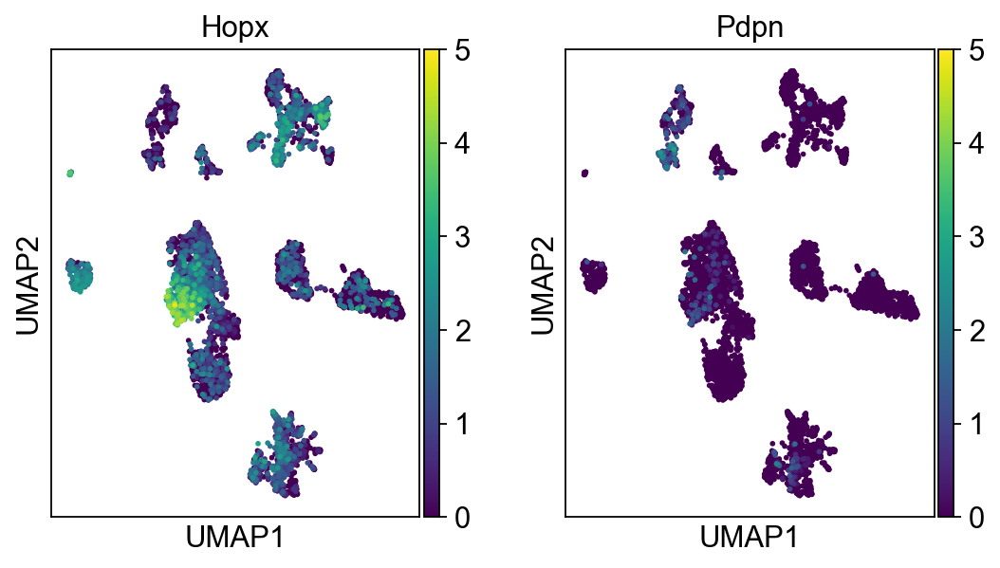

In [82]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], vmax=5)

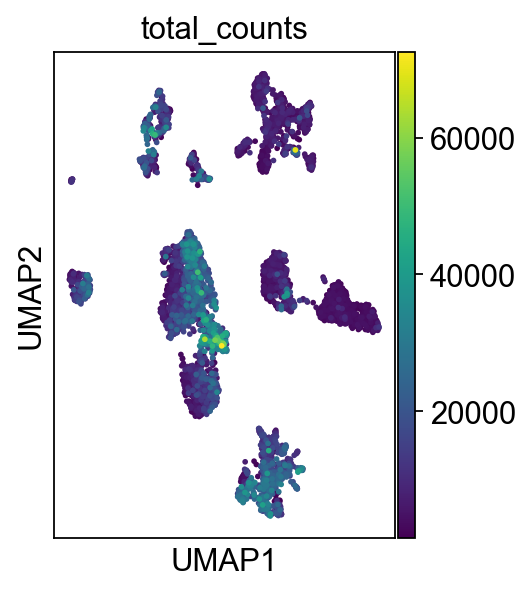

In [83]:
sc.pl.umap(adata, color=['total_counts'])

## Define scoring Functions

In [84]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'tumorClusters':
            with open('clusters/tumorClustersv2.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            for i in range(0,16):
                clusterkeys.append('%i' % i)
            HPCS = '3'
        elif hpcs == 'cell2020':         
            with open('clusters/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        elif hpcs == 'cl5bootstrap':
            with open('clusters/cl5bootstrap.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            #for i in range(0,1):
                #clusterkeys.append('%i' % i)
            clusterkeys.append('Cl5Bootstrap')
            HPCS = 'Cl5Bootstrap'
        elif hpcs == 'cl5bootstrap2':
            with open('clusters/cl5bootstrap2.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            #for i in range(0,1):
                #clusterkeys.append('%i' % i)
            clusterkeys.append('Cl5Bootstrap2')
            HPCS = 'Cl5Bootstrap2'
        elif hpcs == 'Nfkb':
            with open('clusters/NfkbC5.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            #for i in range(0,1):
                #clusterkeys.append('%i' % i)
            clusterkeys.append('Rela5down')
            HPCS = 'Rela5down'
        elif hpcs == 'HPCS':
            with open('clusters/HPCS.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
                    clusterkeys.append(row[0])
            HPCS = 'HPCS_unscaled'
        elif hpcs == 'shRenilla':
            raise ValueError
            ###
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [85]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=25,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
        #sc.tl.score_genes(ad, clusters['Highly_mixed'],score_name="Highly_mixed")
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        #sc.pl.violin(ad, ['SLC4A11','ITGA2','CLDN4','TGIF1','Cluster5'],
         #   jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation)     
        #sc.pl.violin(ad, ['Highly_mixed'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation)            
        #sc.pl.violin(ad, ['MYC_sig','MYC','Fredlund','Jung'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation)     
        #sc.pl.violin(ad, ['ONECUT2','ONECUT2_369_sig','ONECUT2_29_sig'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation) 
        #sc.pl.violin(ad, ['YAP1', 'TAZ', 'YAP_sig'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation) 
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [86]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
        #sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    8902 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    7972 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    8425 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    8967 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    10342 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    11782 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    11785 total control genes ar

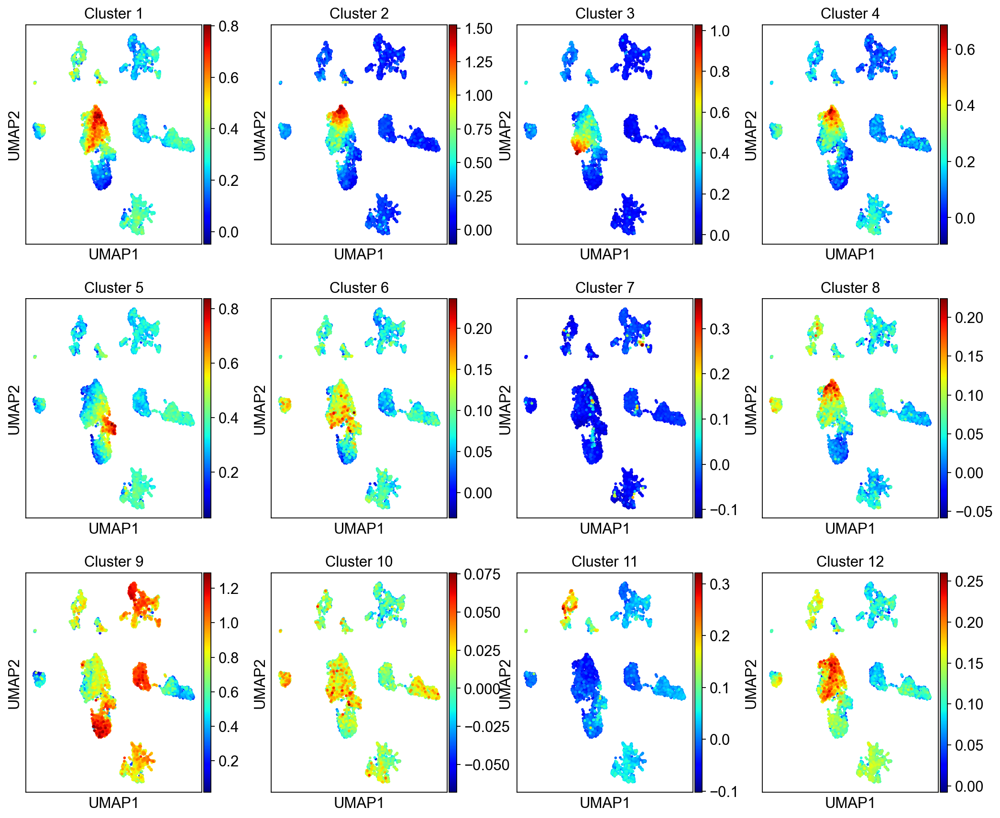

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

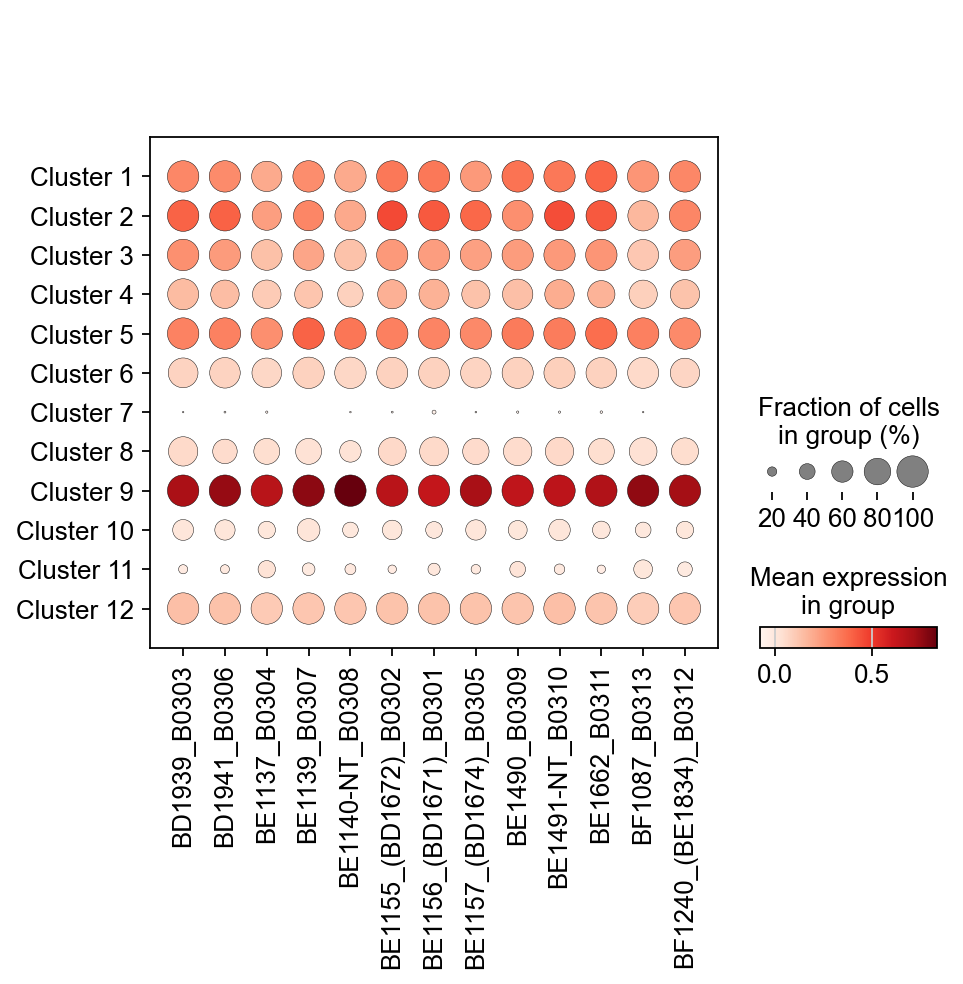

In [87]:
scoreAndPlot(adata, numgenes=500)

computing score 'HPCS_unscaled'
    finished: added
    'HPCS_unscaled', score of gene set (adata.obs).
    10782 total control genes are used. (0:00:00)
computing score 'HPCS_scaled'
    finished: added
    'HPCS_scaled', score of gene set (adata.obs).
    11785 total control genes are used. (0:00:00)


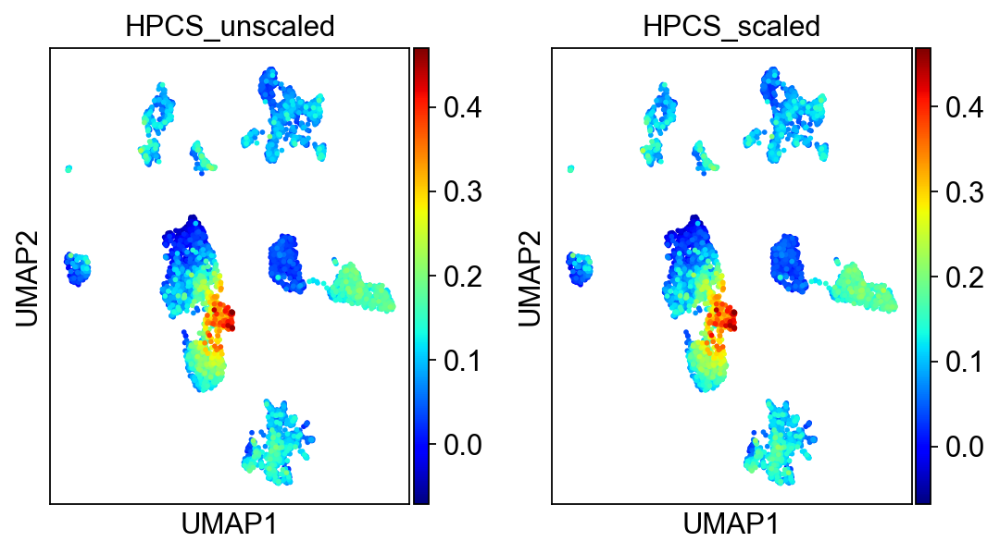

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

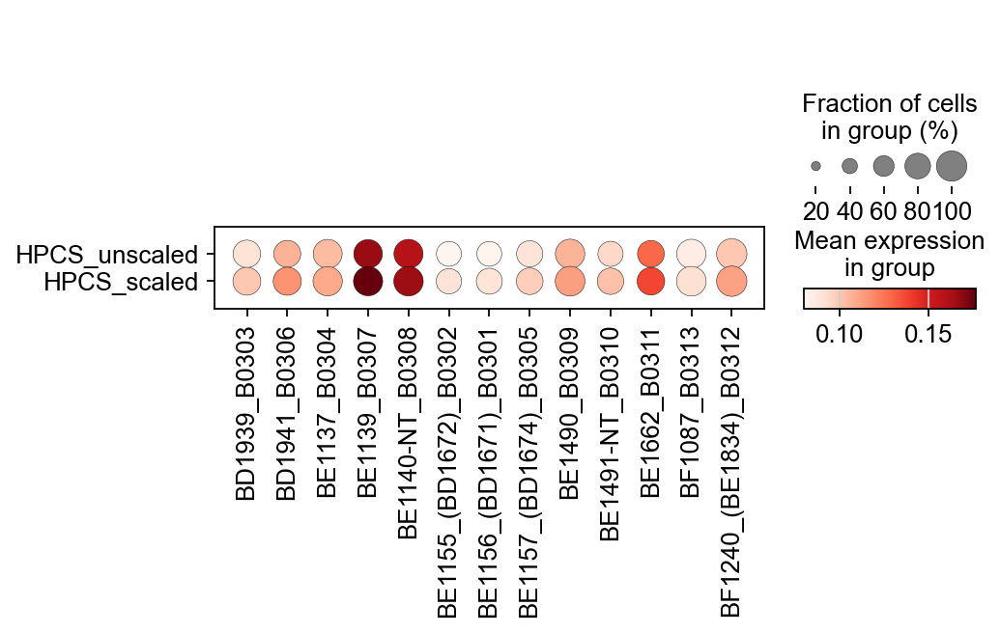

In [88]:
(clusters, clusterkeys, HPCS) = resetClusters('HPCS')
scoreAndPlot(adata, numgenes=500)

## Clustering the neighborhood graph

As with Seurat and many other frameworks, we recommend the Leiden graph-clustering method (community detection based on optimizing modularity) by [Traag *et al.* (2018)](https://scanpy.readthedocs.io/en/latest/references.html#traag18). Note that Leiden clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.

In [89]:
sc.tl.leiden(adata, resolution=0.3)
#sc.tl.leiden(adata, resolution=0.25)

running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


Plot the clusters, which agree quite well with the result of Seurat.

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


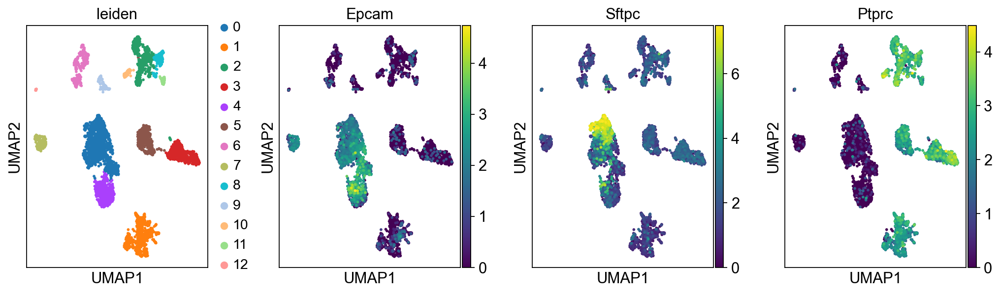

(None,)

In [90]:
sc.pl.umap(adata, color=['leiden', 'Epcam', 'Sftpc', # Tumor cells
                         'Ptprc']), #immune
                         #  'Cd4', 'Cd8a', #T cell #'Cd3e',
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

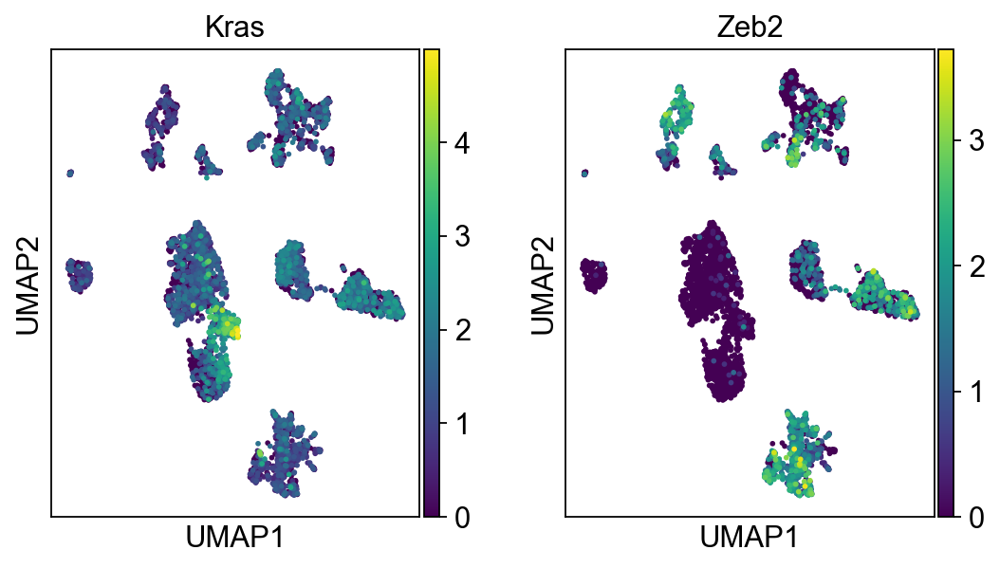

In [91]:
sc.pl.umap(adata, color=['Kras',  'Zeb2', ]) #'Cd109', #'Sox11'

Save the result.

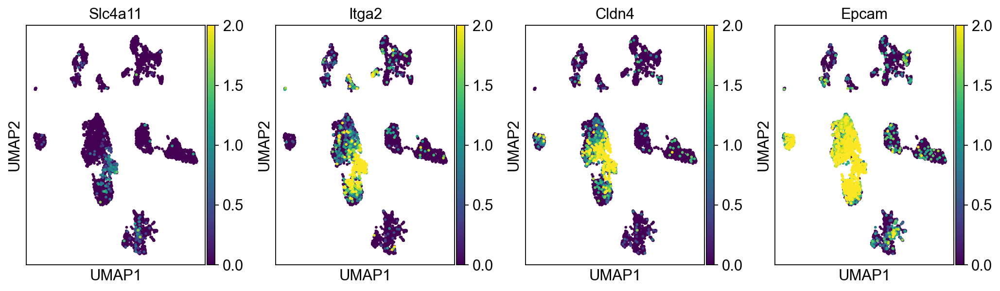

In [92]:
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4','Epcam'], vmax=2) #'Tigit', 

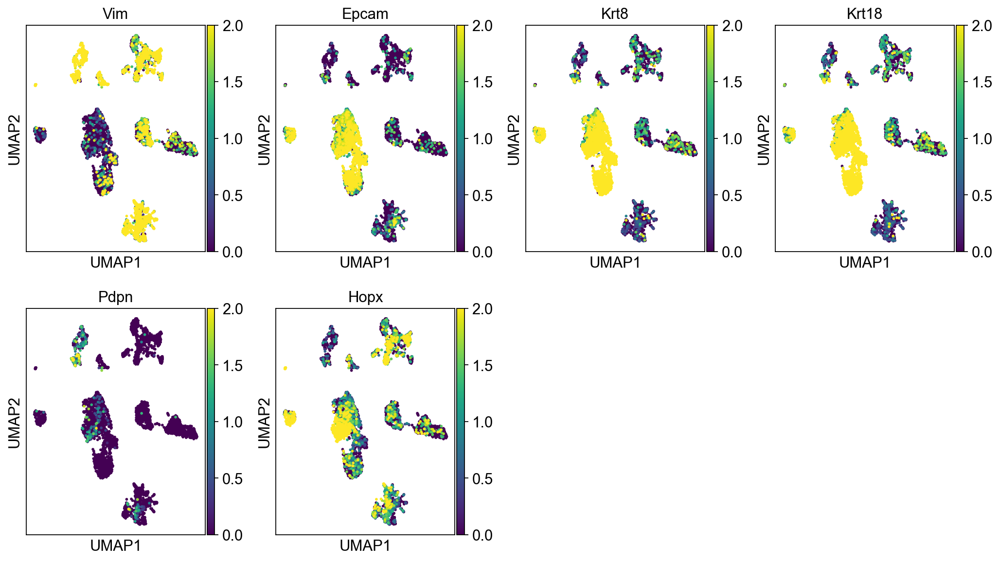

In [93]:
sc.pl.umap(adata, color=['Vim', 'Epcam', 'Krt8', 'Krt18', 'Pdpn', 'Hopx'], vmax=2) #'Pecam1',

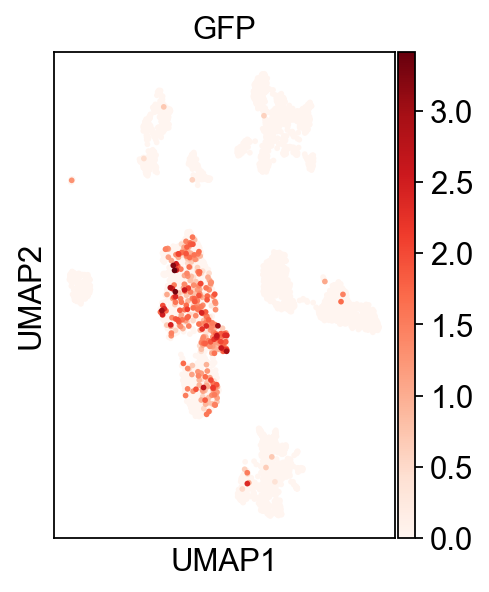

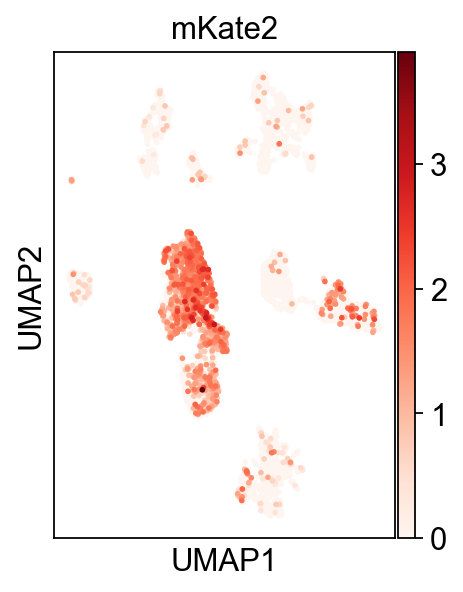

In [94]:
sc.pl.umap(adata, color=['GFP'], cmap='Reds')
sc.pl.umap(adata, color=['mKate2'], cmap='Reds')

In [95]:
adata

AnnData object with n_obs × n_vars = 4566 × 4031
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'shRen', '2118-Nfkb1', 'shRela', 'shRel', 'GFP_count', 'Cre_count', 'shRNA', 'Group', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'HPCS_unscaled', 'HPCS_scaled', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Classification_colors', 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

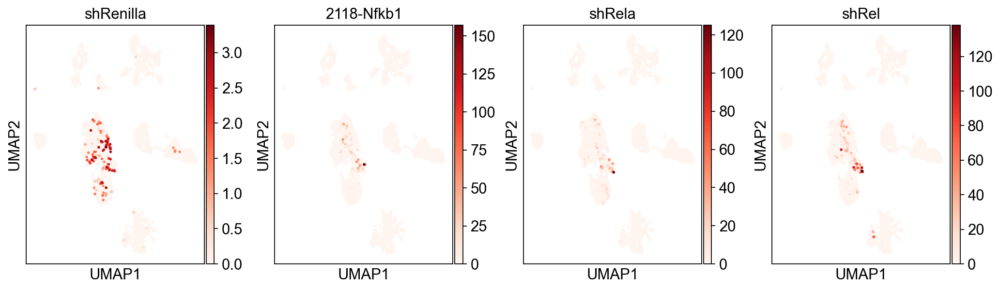

In [96]:
sc.pl.umap(adata, color=["shRenilla", "2118-Nfkb1", "shRela",'shRel'], cmap='Reds')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


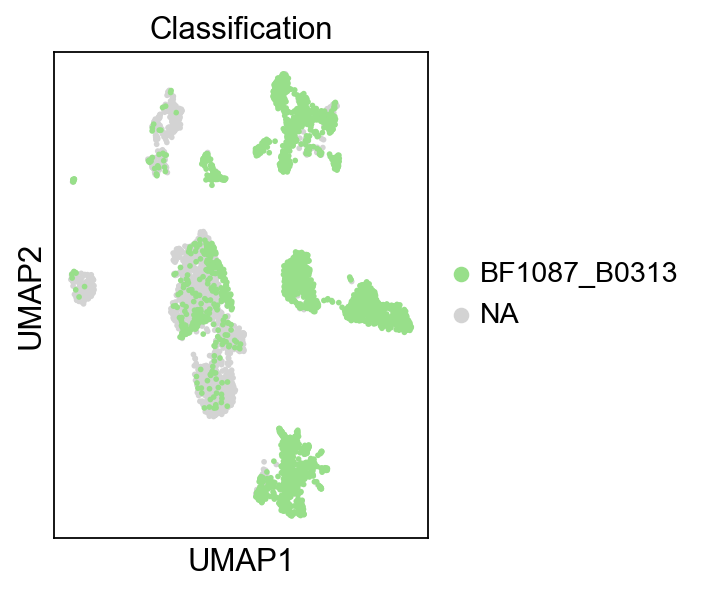

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


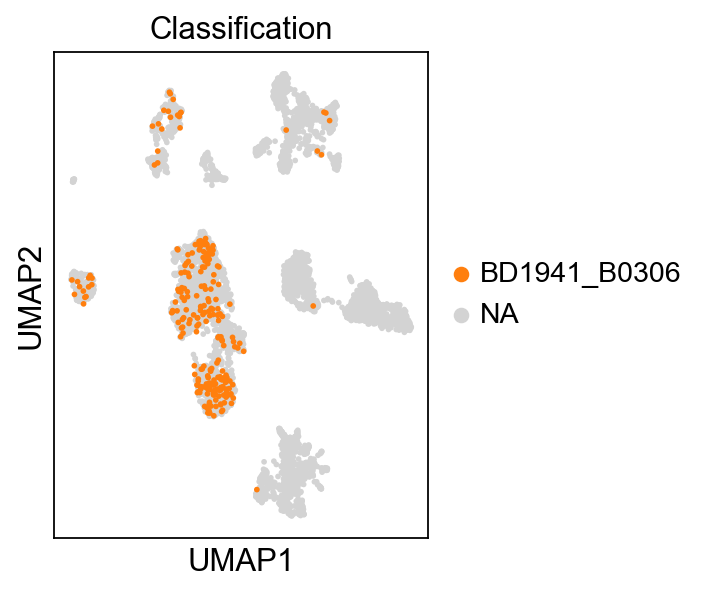

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


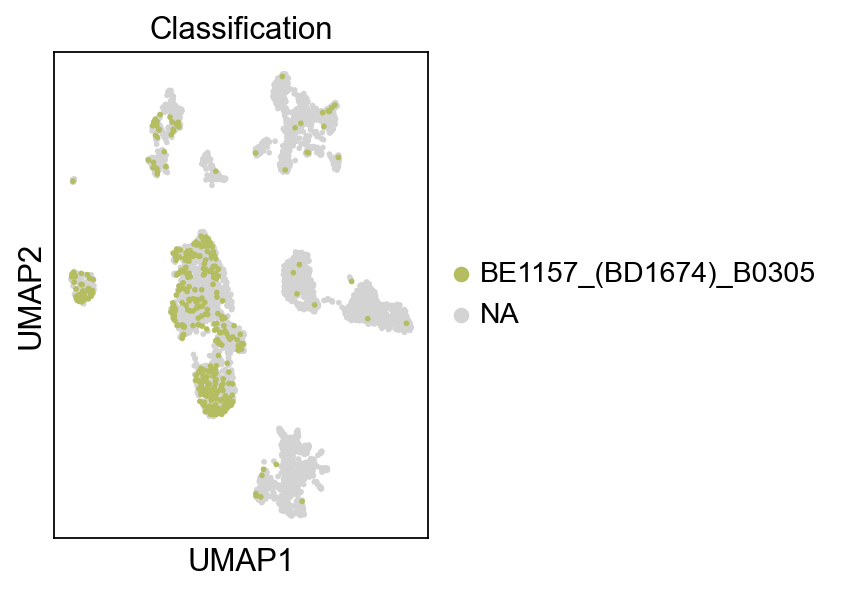

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


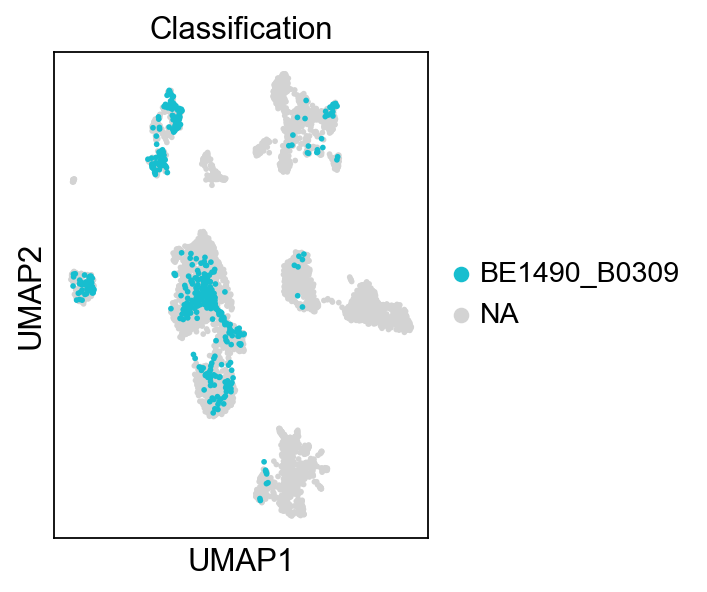

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


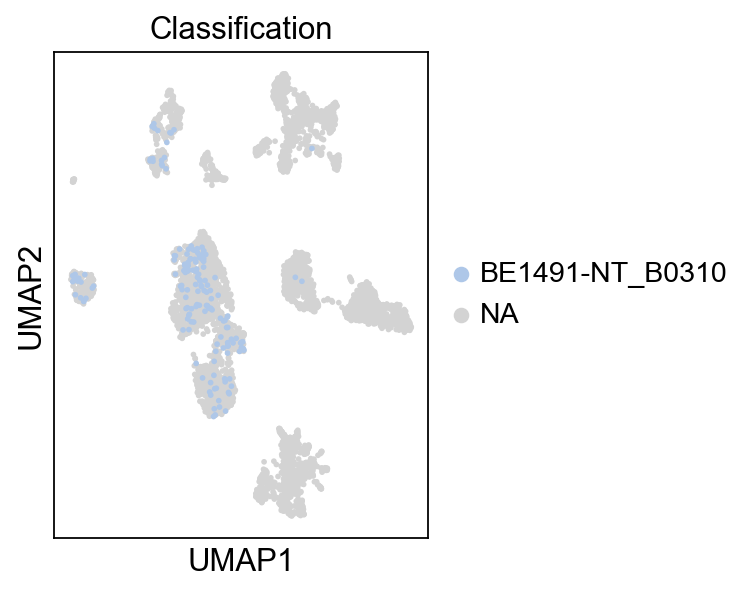

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


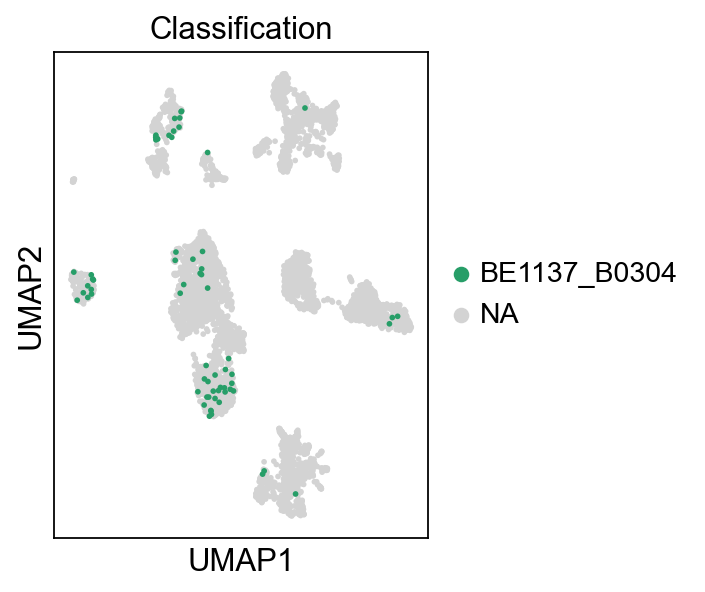

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


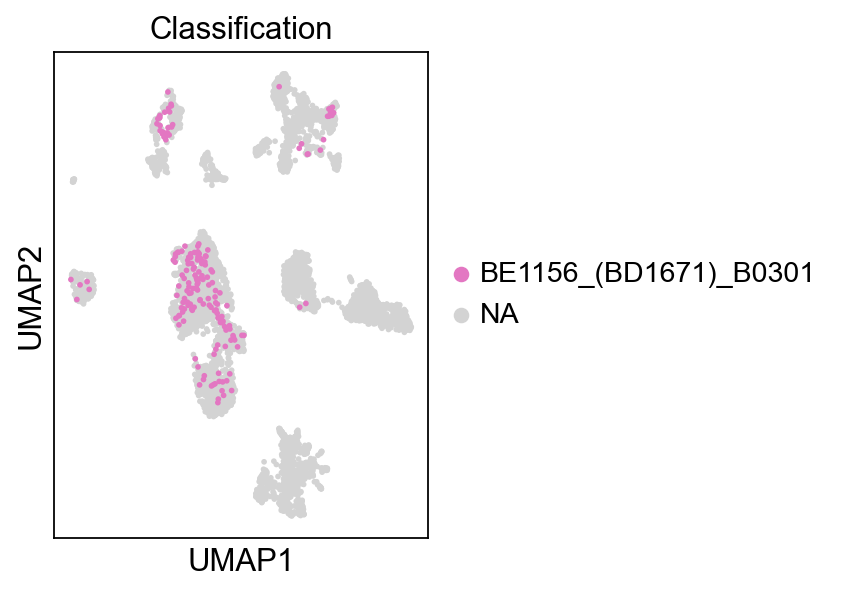

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


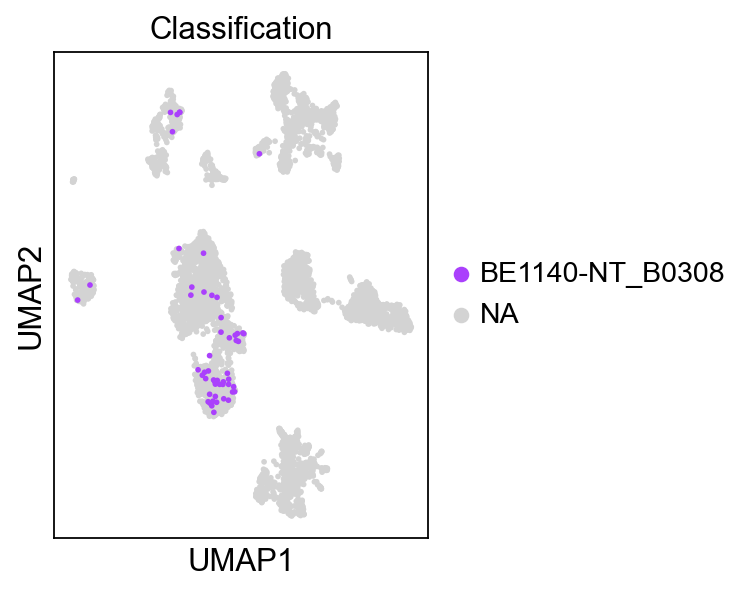

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


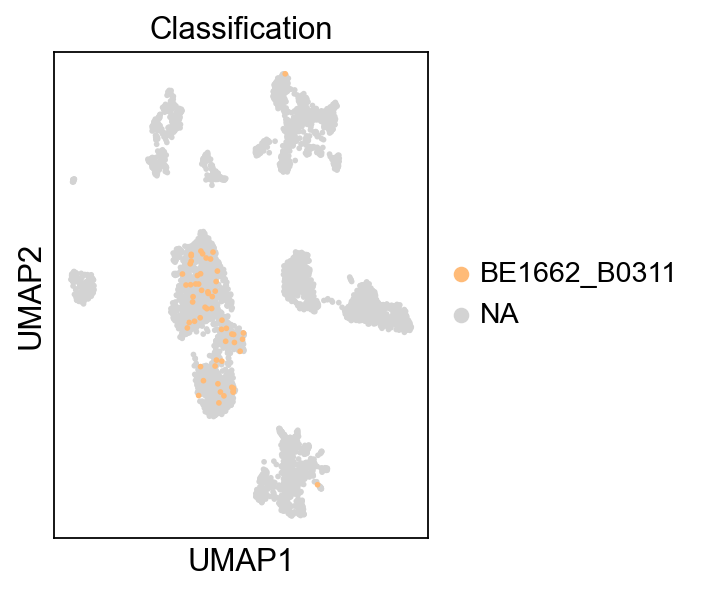

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


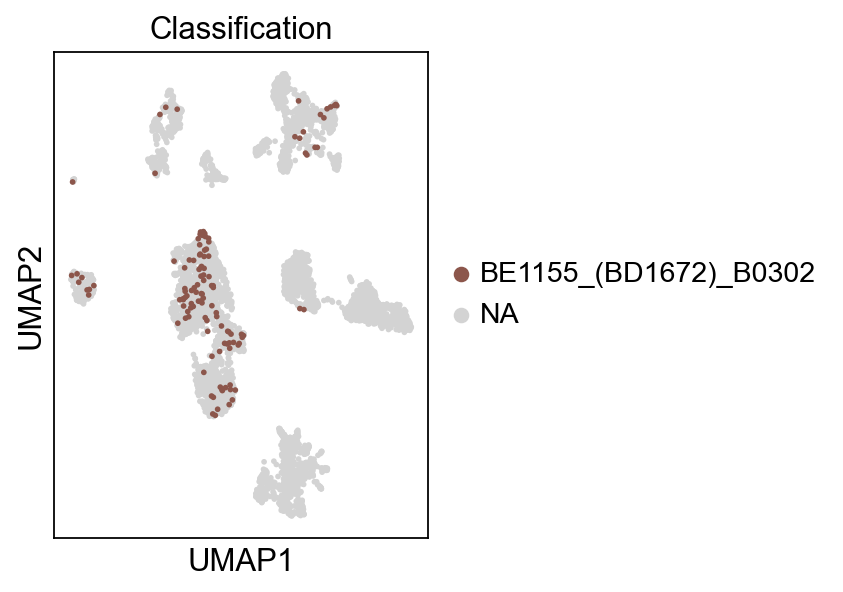

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


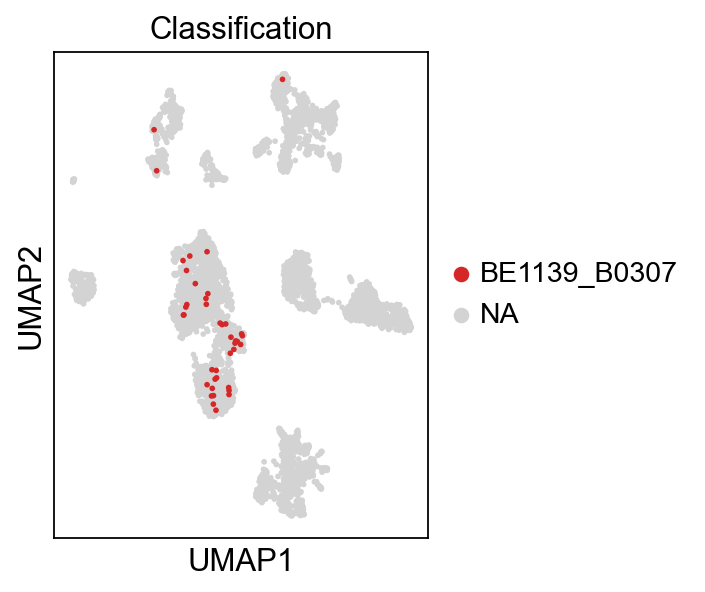

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


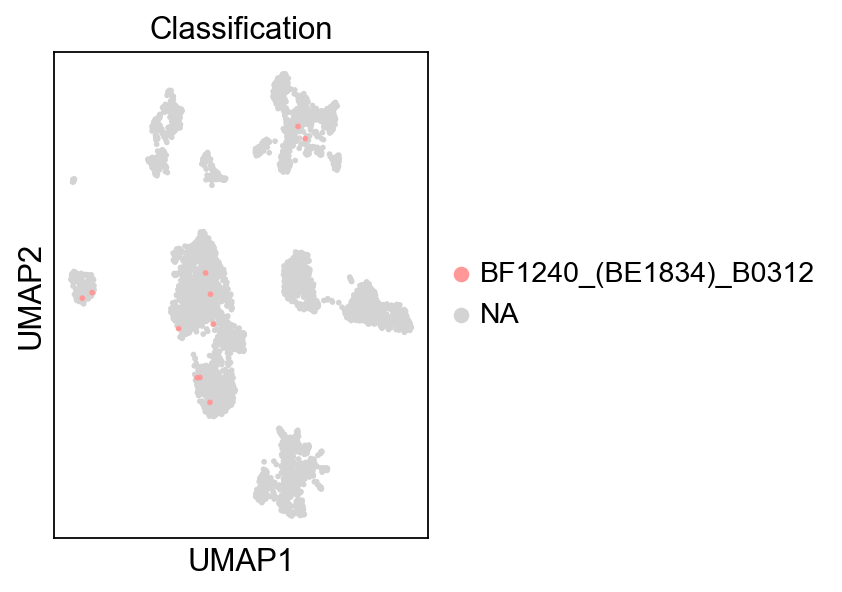

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


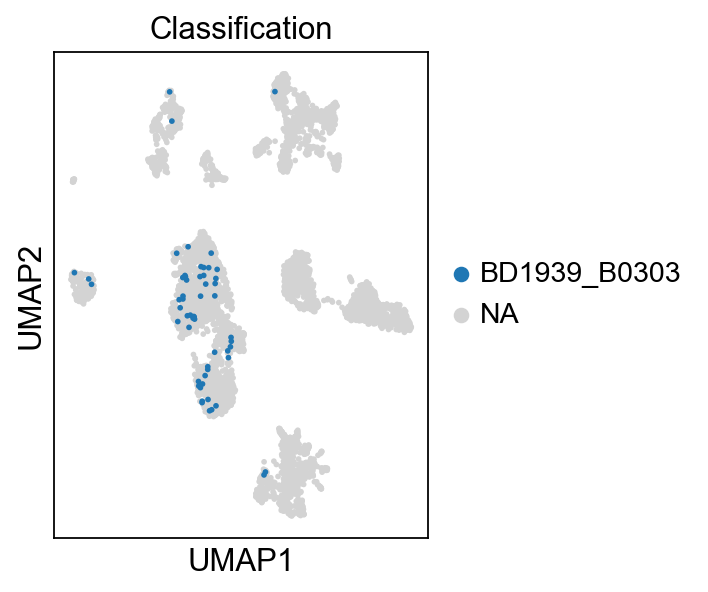

In [97]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

Cluster 1 appears to be fibroblasts based on Krt8 and Krt18 weak staining

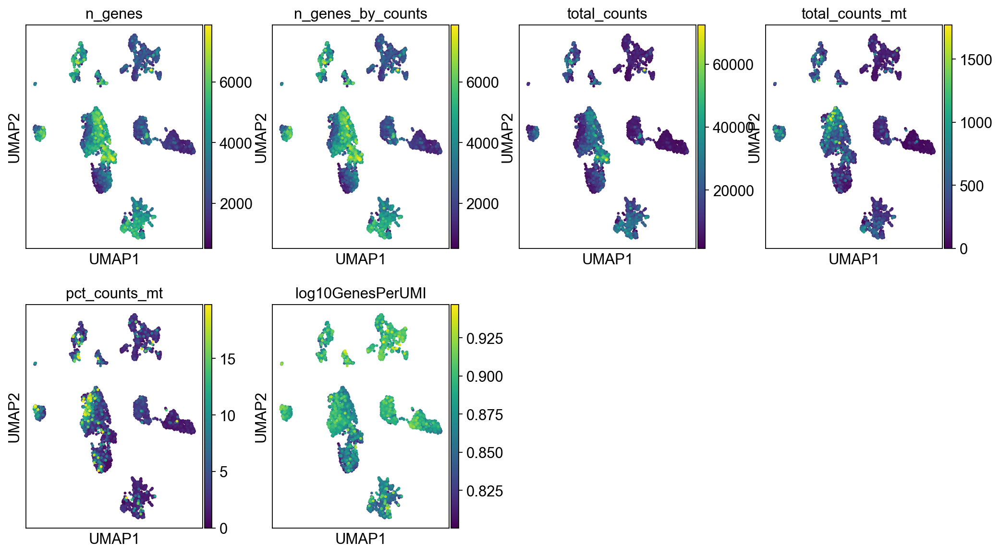

In [98]:
sc.pl.umap(adata,color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


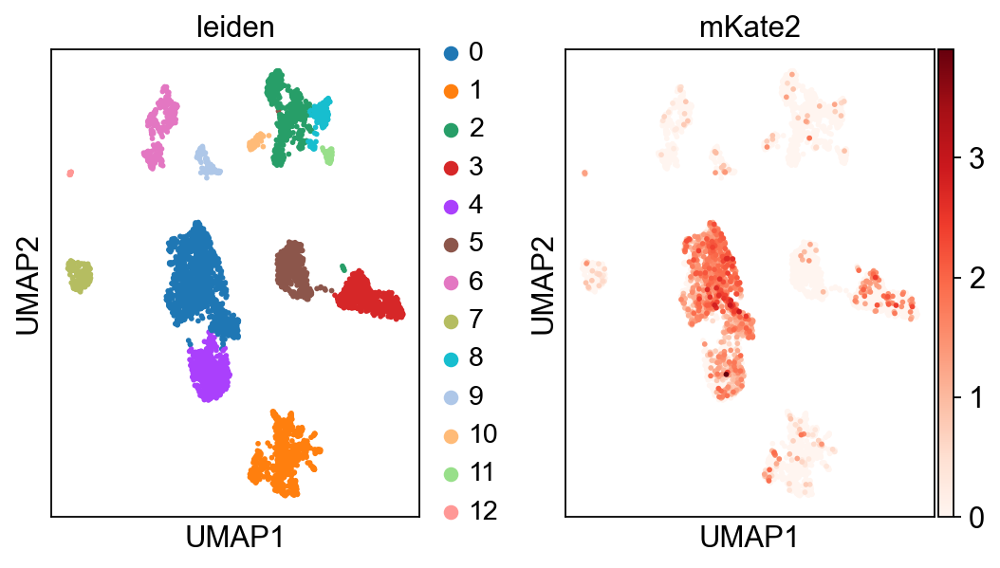

In [99]:
sc.pl.umap(adata, color=['leiden','mKate2'],cmap="Reds")

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


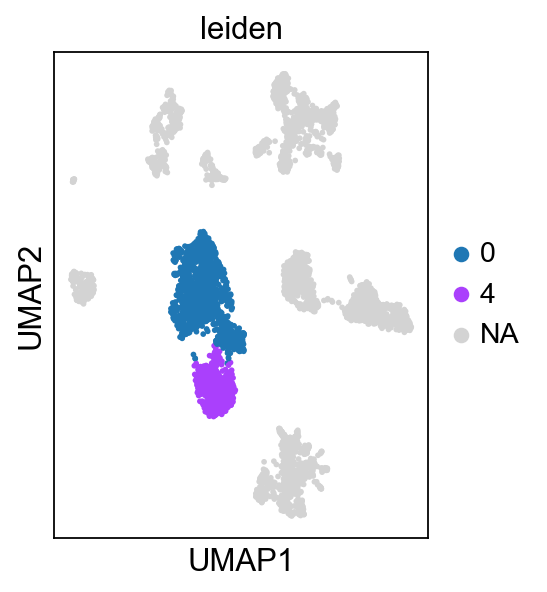

In [100]:
sc.pl.umap(adata, color=['leiden'], groups=['0','4'])

## End Analysis

In [101]:
# Select only those subset of cells that are useful
adata2 = sc.read('write/allmice.h5ad')
adata = adata2[adata.obs['leiden'].isin(['0','4']),:] # keep tumor cells
del adata2

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [102]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2000007.py:2: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['log1p'] = {}


In [103]:
sc.pp.highly_variable_genes(adata)#, batch_key='Classification')

extracting highly variable genes


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [104]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['GFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Cre'] = False
for x in library:
    adata.var.highly_variable[x] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2494002207.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['GFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2494002

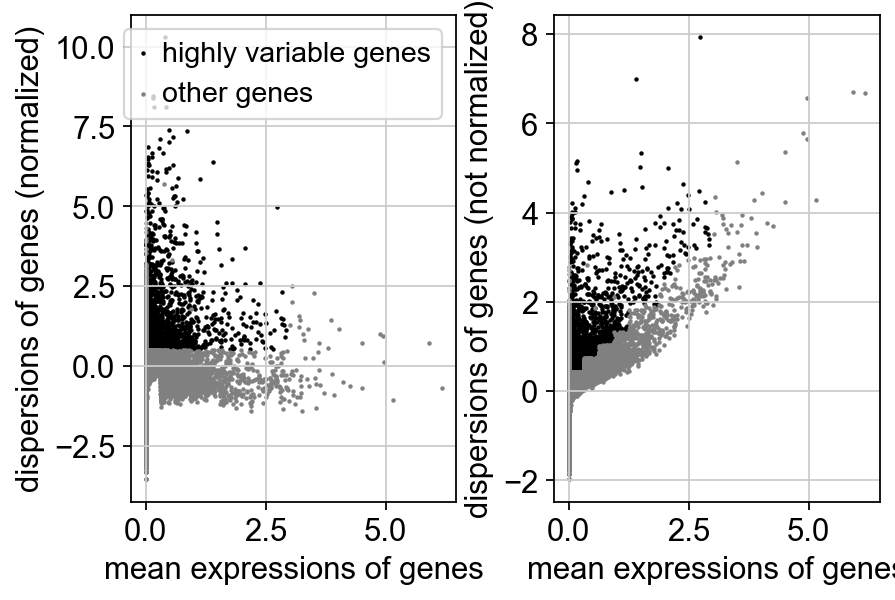

In [105]:
sc.pl.highly_variable_genes(adata)

In [106]:
adata.raw = adata

In [107]:
adata.write('write/allmice-tumor.h5ad', compression='gzip')
adata = sc.read('write/allmice-tumor.h5ad')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Now rerun algorithm

In [108]:
adata = adata[:, adata.var.highly_variable]

In [109]:
sc.pp.scale(adata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [110]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:01)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

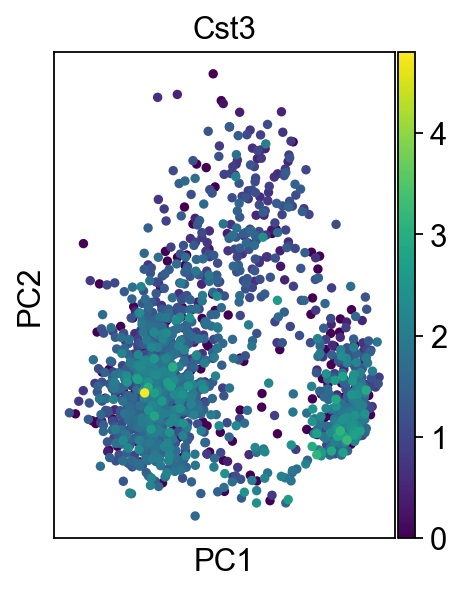

In [111]:
sc.pl.pca(adata, color='Cst3')

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often a rough estimate of the number of PCs does fine.

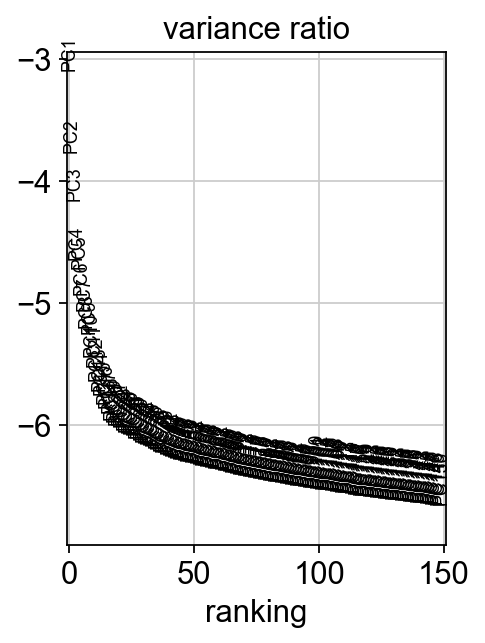

In [112]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

In [113]:
adata.write(results_file, compression='gzip')

In [114]:
adata

AnnData object with n_obs × n_vars = 1673 × 3608
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'shRen', '2118-Nfkb1', 'shRela', 'shRel', 'GFP_count', 'Cre_count', 'shRNA', 'Group'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Classification_colors', 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [115]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


## Embedding the neighborhood graph

We suggest embedding the graph in two dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [116]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


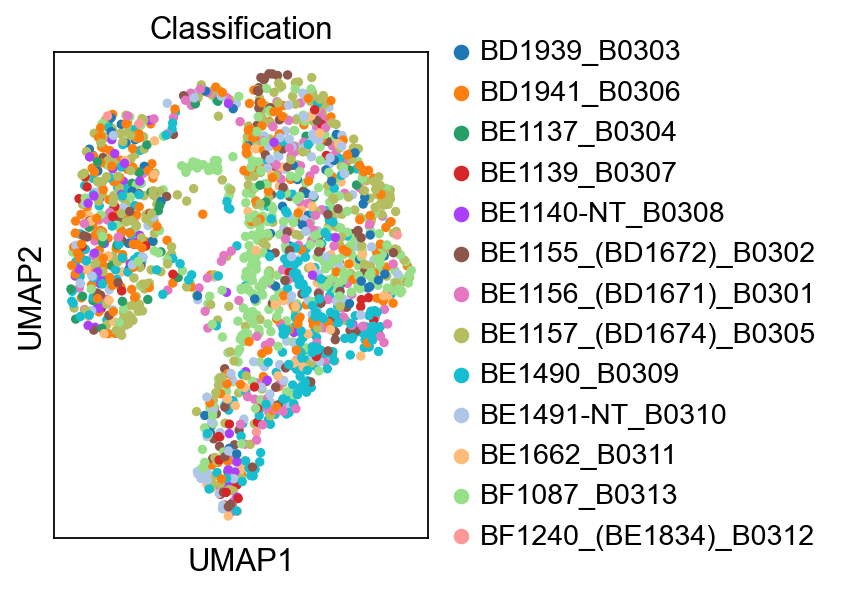

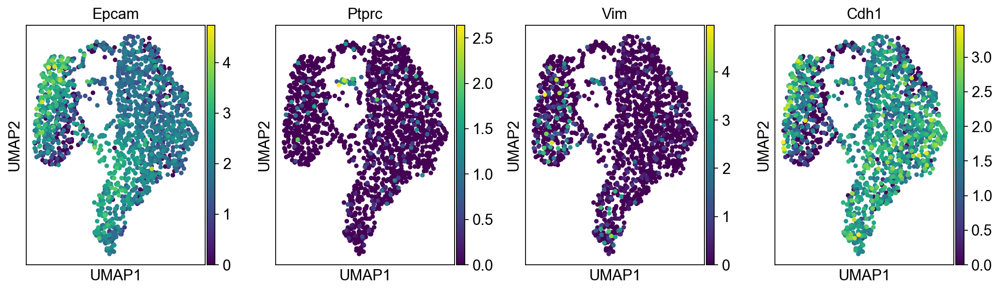

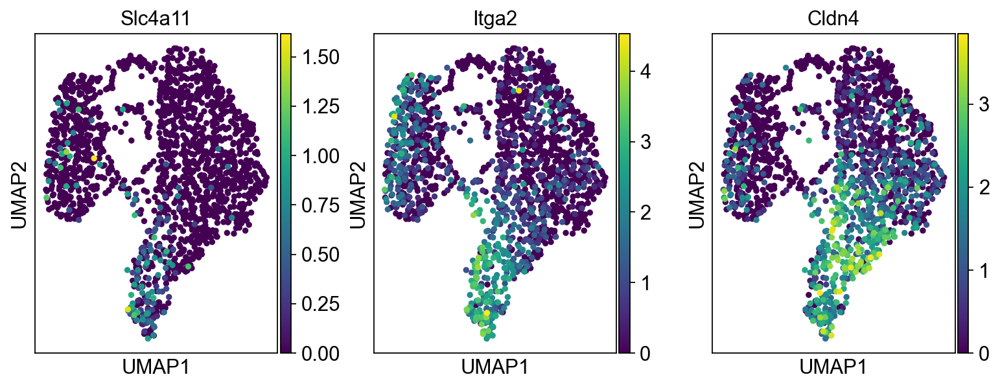

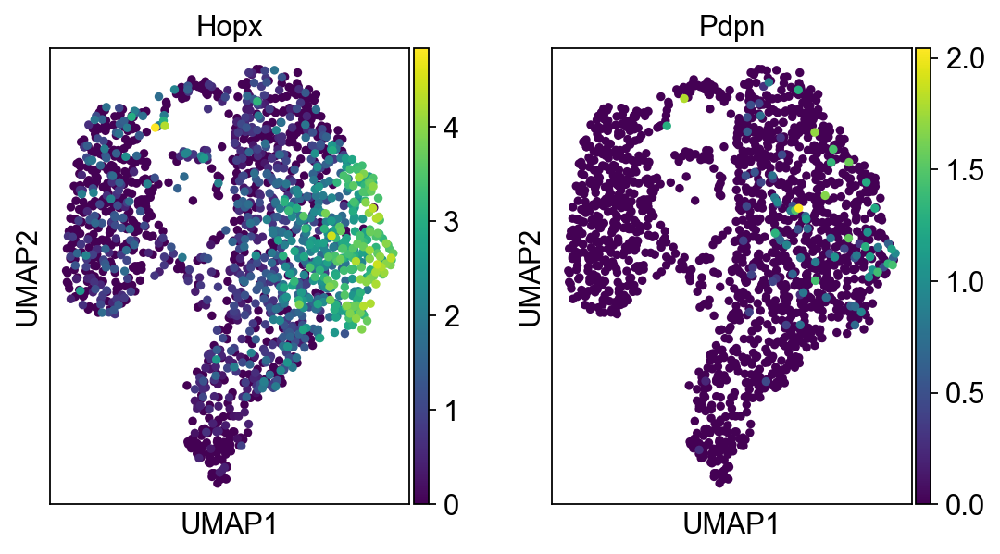

In [117]:
sc.pl.umap(adata, color=['Classification'])
#sc.pl.umap(adata, color=['Porcn', 'Lgr5', 'Lgr6','Axin2']) #LGR5 not found #
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',]) #CDH2 not found #'Cdh2'
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])
#sc.pl.umap(adata, color=['Cd81', 'Cd19'])
#sc.pl.umap(adata, color=['Trp53','Meg3'], vmax=5)

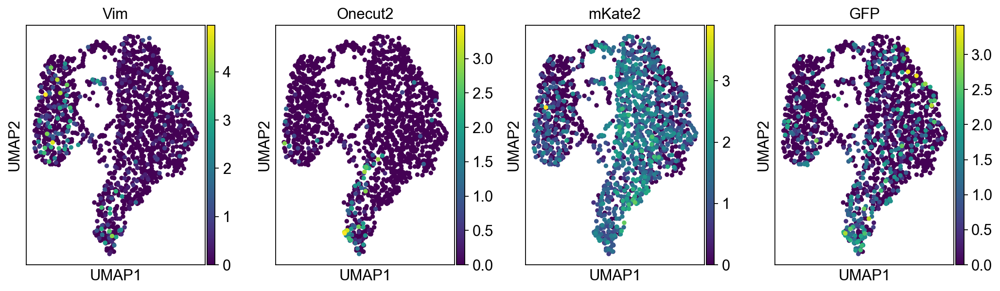

In [118]:
sc.pl.umap(adata, color=['Vim', 'Onecut2', 'mKate2', 'GFP']) #'Sox11', 

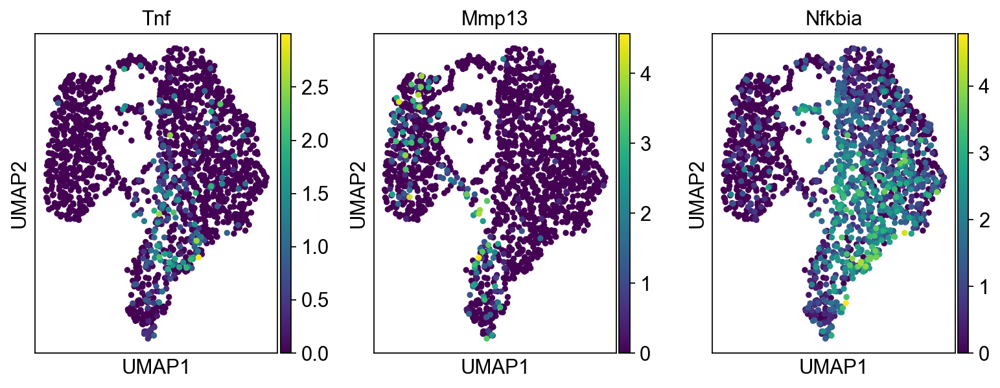

computing score 'score'
    finished: added
    'score', score of gene set (adata.obs).
    350 total control genes are used. (0:00:00)


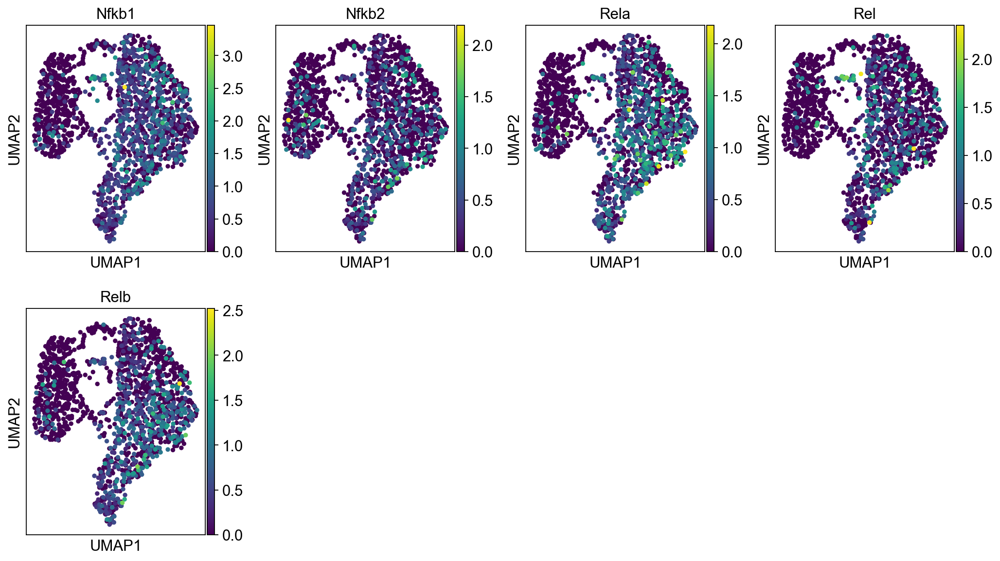

In [119]:
#NFkB targets
nfkb = ['Tnf', 'Mmp13','Nfkbia']
nfkball = ['Tnf', 'Mmp13', 'Nfkbia', 'Bcl2', 'Bcl2l1', 'Xiap', 'Birc2', 'Il6', 'Birc5', 'Ccnd1', 'Mmp3']
nfkbfactors = ['Nfkb1', 'Nfkb2', 'Rela', 'Rel', 'Relb']
sc.pl.umap(adata,color=nfkb)
sc.tl.score_genes(adata, nfkball)
sc.pl.umap(adata, color=nfkbfactors)

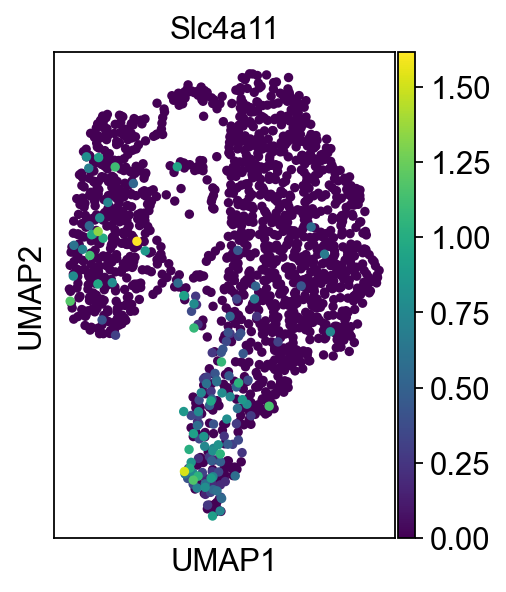

In [120]:
sc.pl.umap(adata, color='Slc4a11')

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    7401 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    5964 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    7918 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    7976 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    8836 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    11085 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    10786 total control genes are

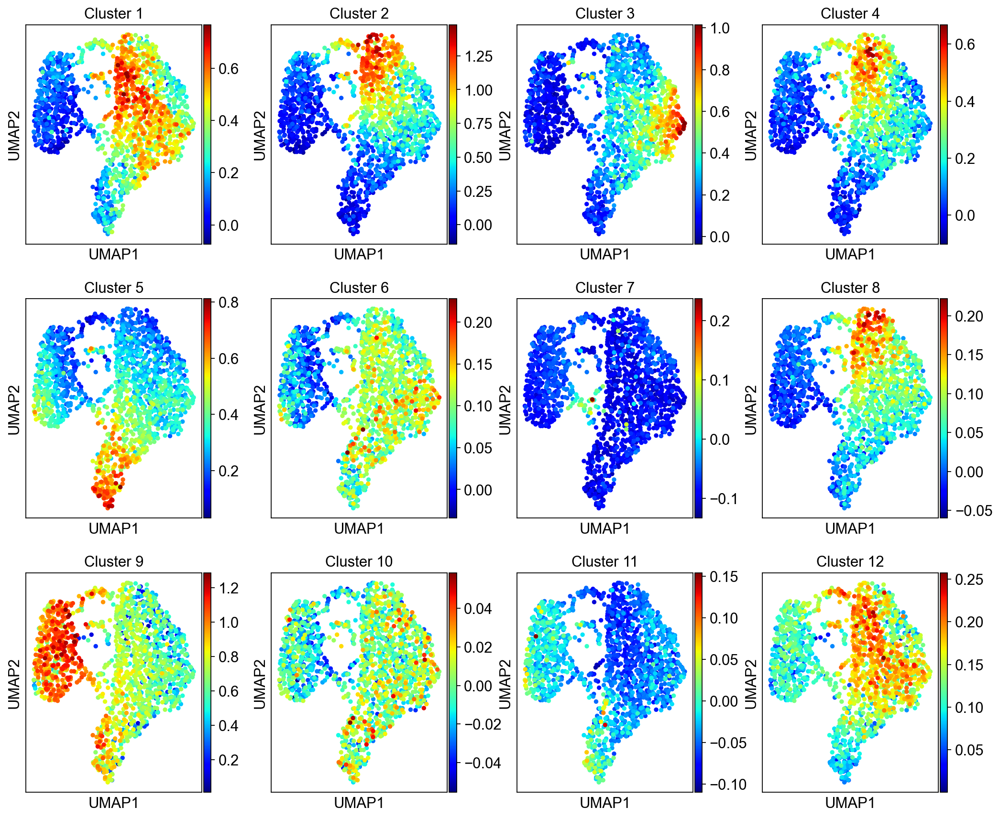

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

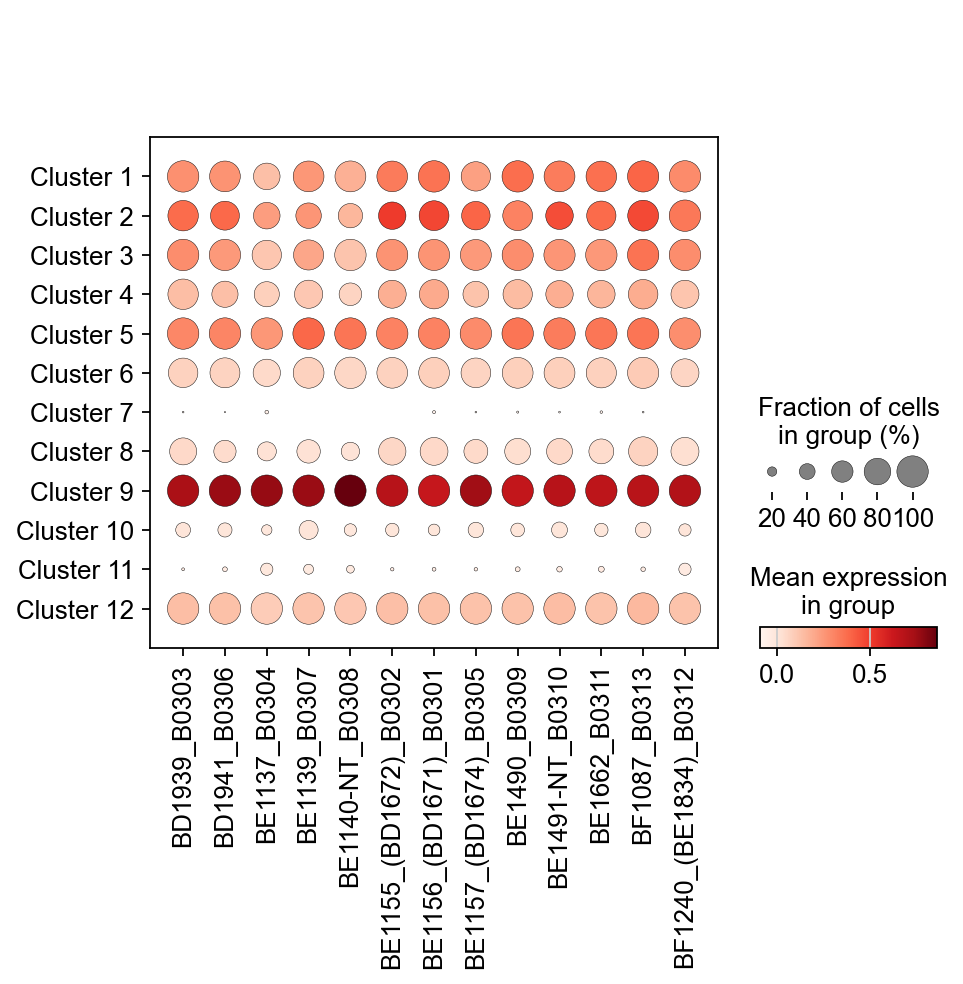

In [121]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata, numgenes=500)

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    790 total control genes are used. (0:00:00)


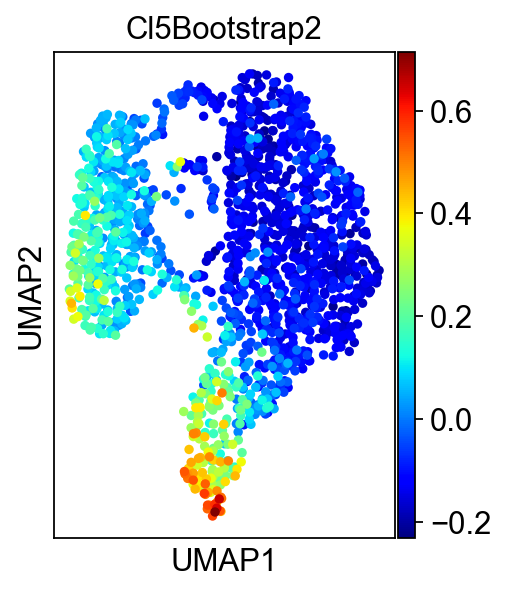

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

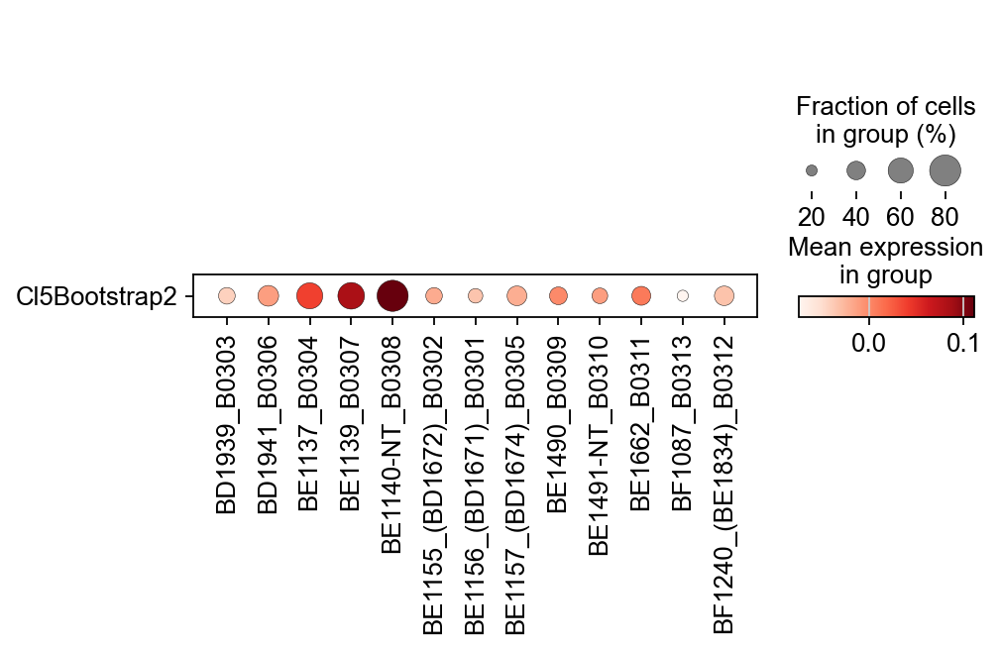

In [122]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(adata,numgenes=100)

computing score 'HPCS_unscaled'
    finished: added
    'HPCS_unscaled', score of gene set (adata.obs).
    9775 total control genes are used. (0:00:00)
computing score 'HPCS_scaled'
    finished: added
    'HPCS_scaled', score of gene set (adata.obs).
    10312 total control genes are used. (0:00:00)


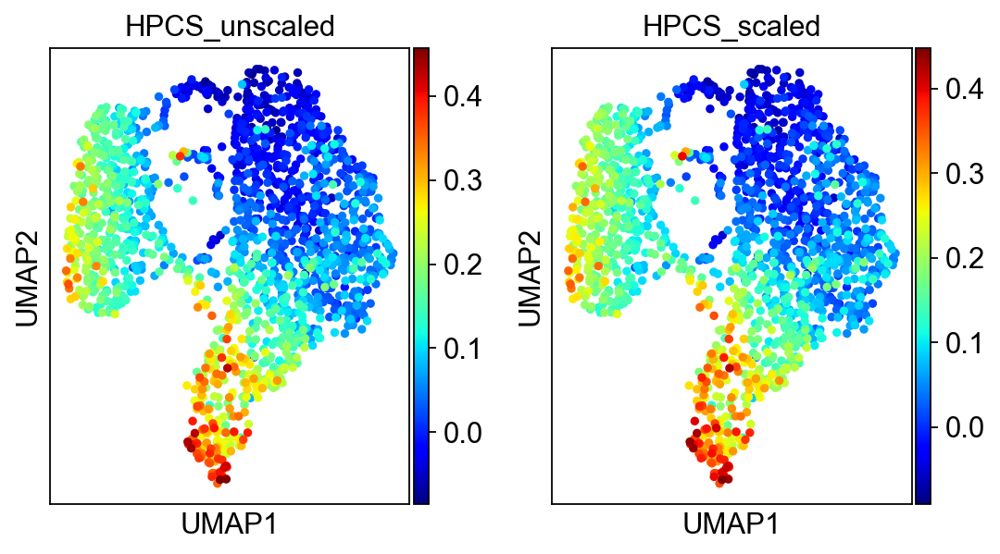

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

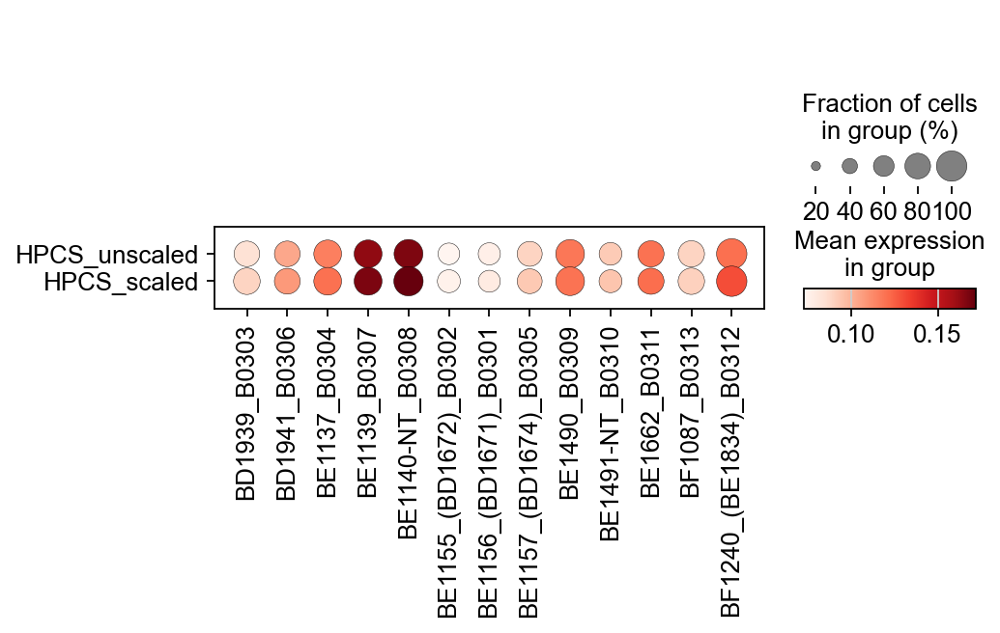

In [123]:
(clusters, clusterkeys, HPCS) = resetClusters('HPCS')
scoreAndPlot(adata, numgenes=500)

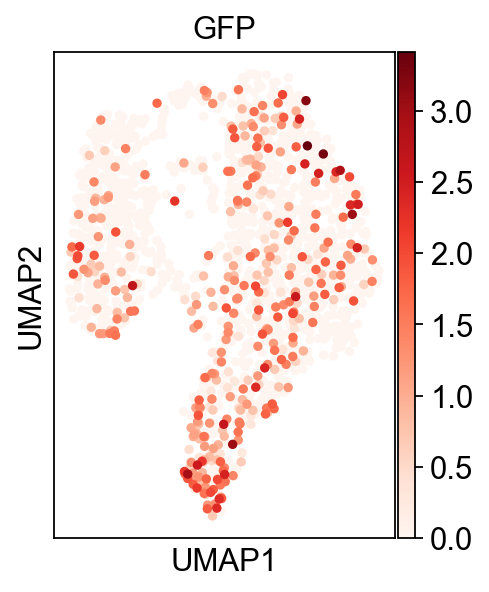

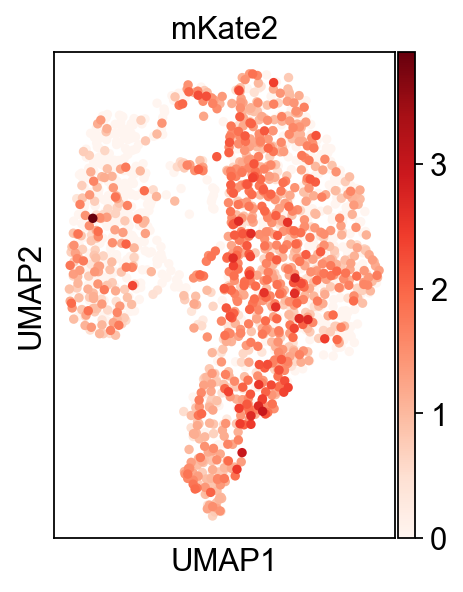

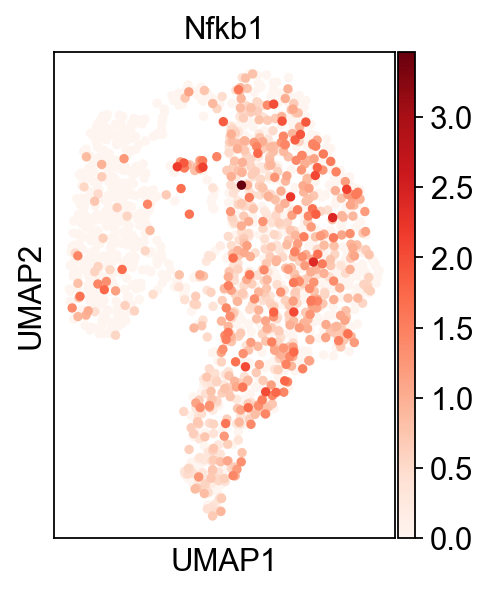

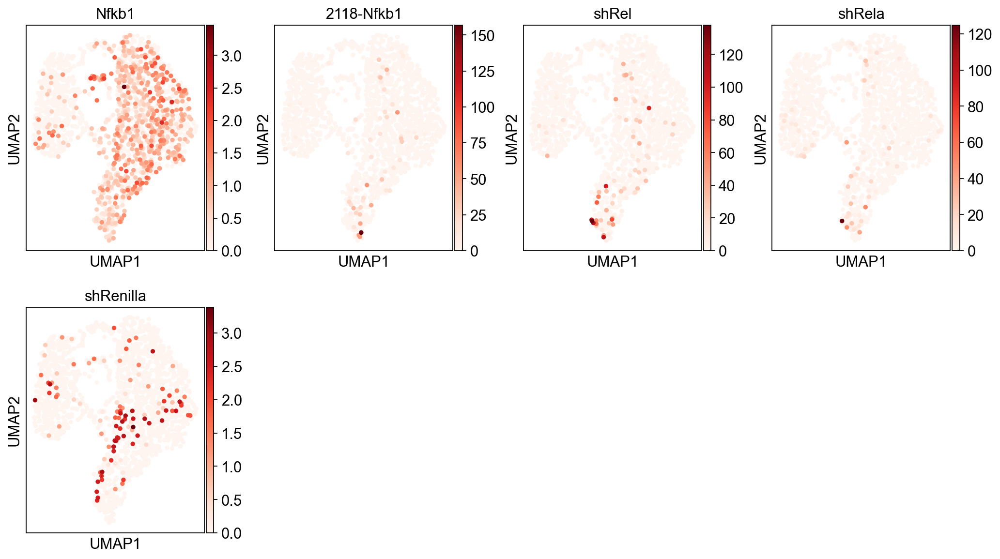

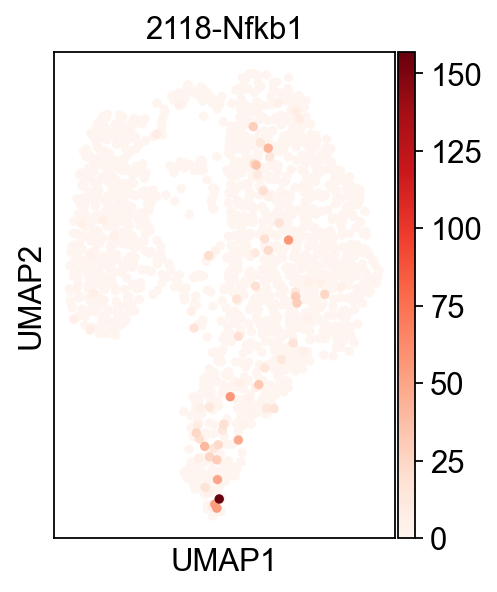

In [124]:
sc.pl.umap(adata, color=['GFP'], cmap='Reds')
sc.pl.umap(adata, color=['mKate2'], cmap='Reds')
sc.pl.umap(adata, color=['Nfkb1'], cmap='Reds')
sc.pl.umap(adata, color=['Nfkb1', "2118-Nfkb1",'shRel', 'shRela','shRenilla'], cmap='Reds')
sc.pl.umap(adata, color=["2118-Nfkb1"], cmap='Reds')

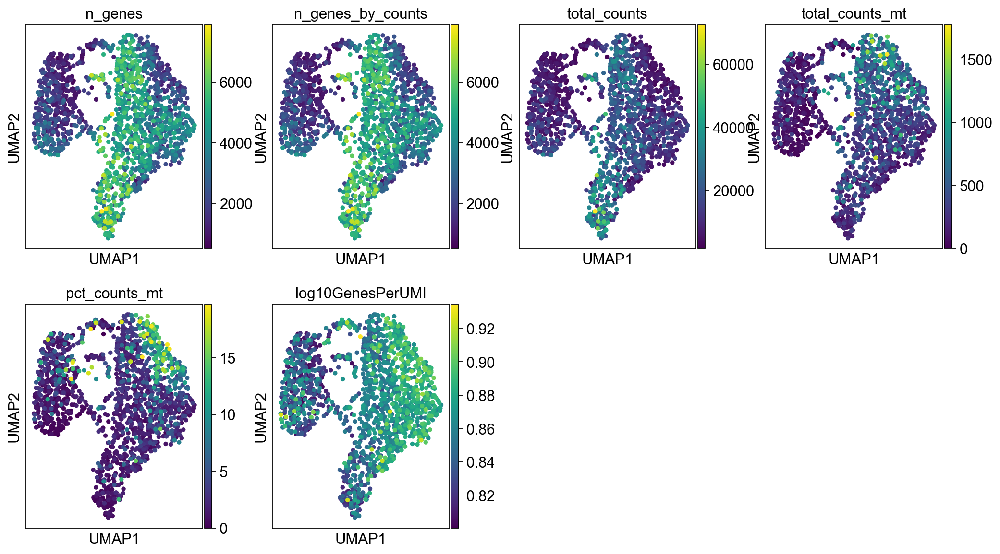

In [125]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

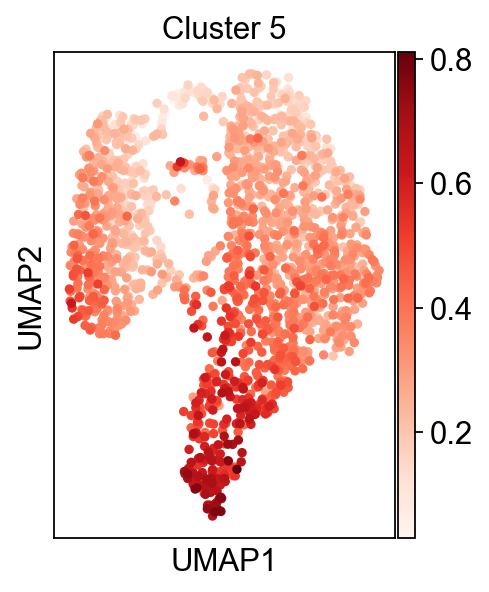

In [126]:
sc.pl.umap(adata,color='Cluster 5', cmap='Reds')

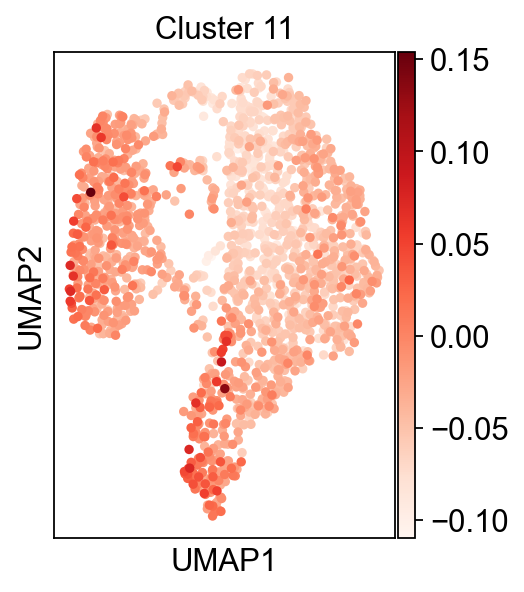

In [127]:
sc.pl.umap(adata,color='Cluster 11', cmap='Reds')

In [128]:
sc.tl.embedding_density(adata, basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


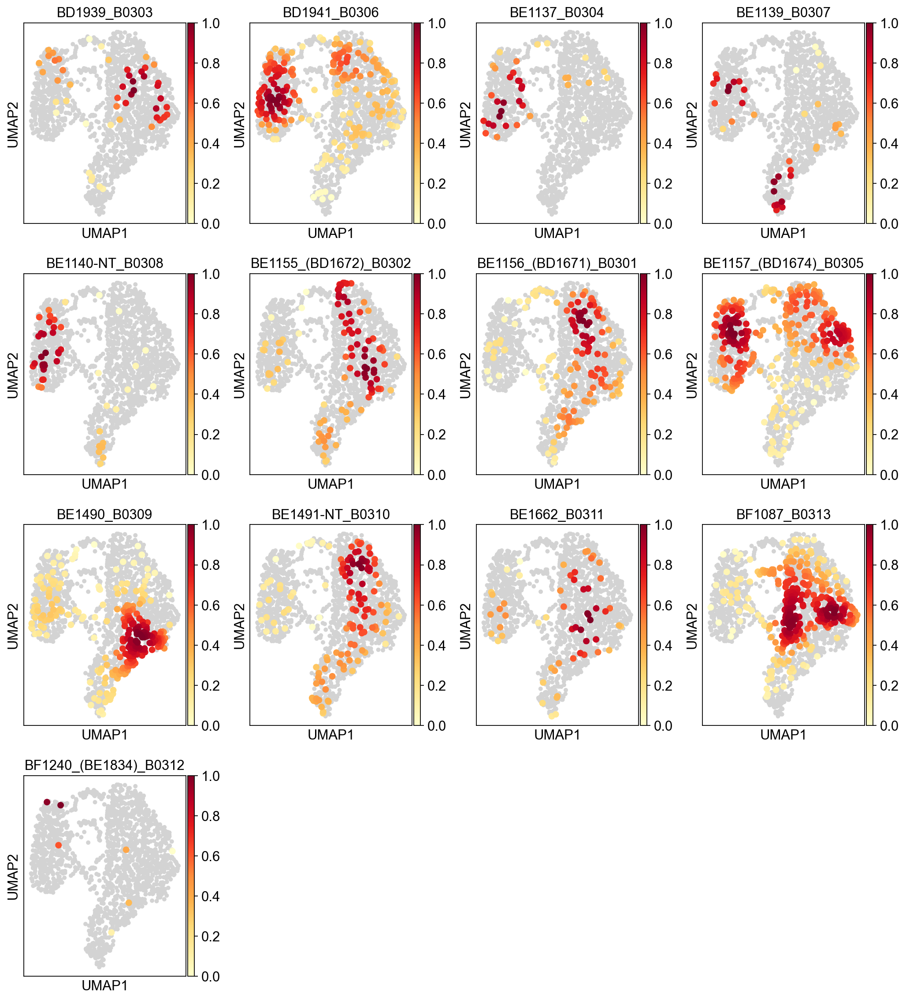

In [129]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Classification')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


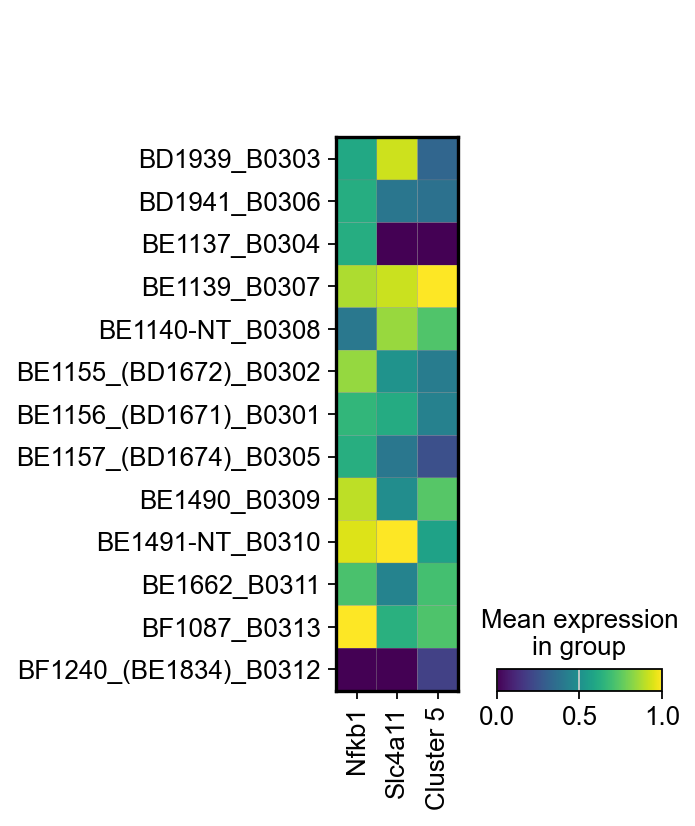

In [130]:
sc.pl.matrixplot(adata, ['Nfkb1','Slc4a11','Cluster 5'], groupby='Classification', standard_scale='var')

In [131]:
adata.obs.Classification.value_counts()

Classification
BF1087_B0313             326
BE1157_(BD1674)_B0305    295
BE1490_B0309             253
BD1941_B0306             209
BE1156_(BD1671)_B0301    134
BE1491-NT_B0310          131
BE1155_(BD1672)_B0302     96
BE1662_B0311              56
BD1939_B0303              49
BE1140-NT_B0308           45
BE1139_B0307              37
BE1137_B0304              35
BF1240_(BE1834)_B0312      7
Name: count, dtype: int64

## Clustering the neighborhood graph

As with Seurat and many other frameworks, we recommend the Leiden graph-clustering method (community detection based on optimizing modularity) by [Traag *et al.* (2018)](https://scanpy.readthedocs.io/en/latest/references.html#traag18). Note that Leiden clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.

running Leiden clustering
    finished: found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


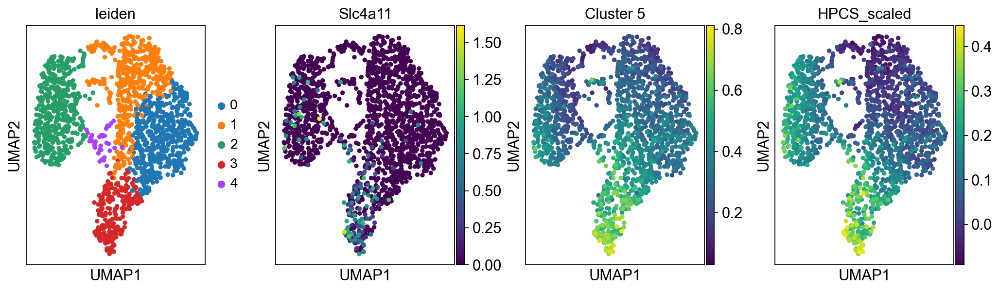

In [132]:
sc.tl.leiden(adata, resolution=.275)
sc.pl.umap(adata, color=['leiden','Slc4a11','Cluster 5','HPCS_scaled'])

Plot the clusters, which agree quite well with the result of Seurat.

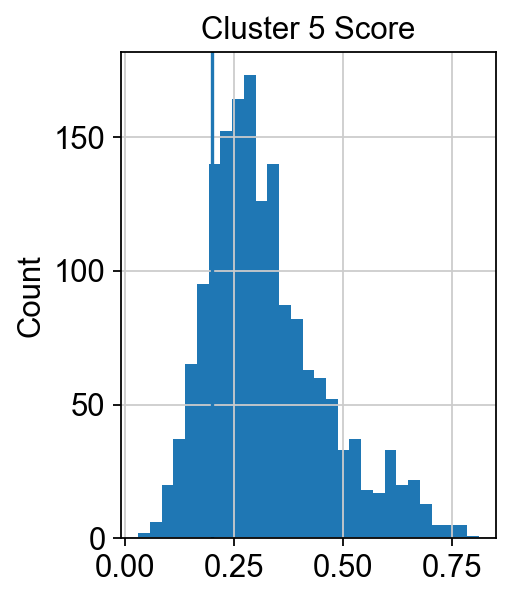

In [133]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.obs['Cluster 5'], bins='auto')
plt.ylabel("Count")
plt.title("Cluster 5 Score")
plt.axvline(x=0.2)
plt.show()

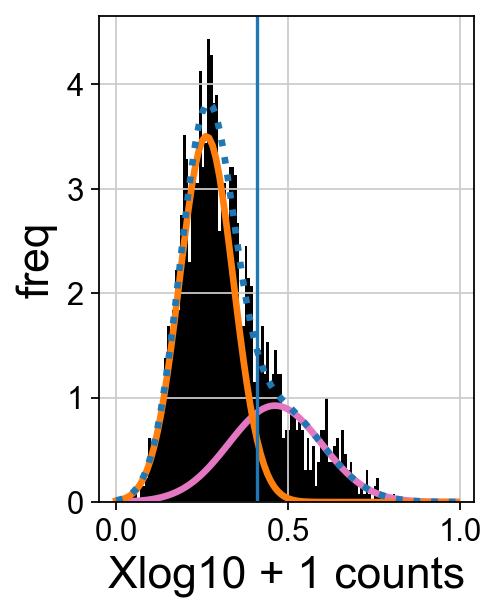

True


In [134]:
# import libraries (some are for cosmetics)
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter, AutoMinorLocator)
from scipy.stats import norm
from sklearn.mixture import BayesianGaussianMixture
import matplotlib as mpl

x = np.array(adata.obs['Cluster 5']).reshape(-1, 1)

# create GMM model object
gmm = BayesianGaussianMixture(n_components=2, random_state=250,init_params='k-means++')

# find useful parameters
fitGMM = gmm.fit(x)
mean = fitGMM.means_  
covs  = fitGMM.covariances_
weights = fitGMM.weights_

# create necessary things to plot
x_axis = np.arange(0, 1, 0.01)
y_axis0 = norm.pdf(x_axis, float(mean[0][0]), np.sqrt(float(covs[0][0][0])))*weights[0] # 1st gaussian
y_axis1 = norm.pdf(x_axis, float(mean[1][0]), np.sqrt(float(covs[1][0][0])))*weights[1] # 2nd gaussian
cutoff = 0
if mean[0][0] < mean[1][0]:
    cutoff = x_axis[np.where(y_axis1 < y_axis0)[0][-1]+2]
else:
    cutoff = x_axis[np.where(y_axis0 < y_axis1)[0][-1]+2]
    

ax = fig.add_subplot(1,2,2)
# Plot 2
plt.hist(x, density=True, color='black', bins=100)
plt.plot(x_axis, y_axis0, lw=3, c='C6')
plt.plot(x_axis, y_axis1, lw=3, c='C1')
plt.plot(x_axis, y_axis0+y_axis1, lw=3, c='C0', ls=':')
#plt.xlim(0, 4, 0.1)
#plt.ylim(0.0, 2.0)
plt.xlabel(r"Xlog10 + 1 counts", fontsize=20)
plt.ylabel(r"freq", fontsize=20)
plt.axvline(x=cutoff)

#plt.subplots_adjust(wspace=0.3)
plt.show()
plt.close('all')
print(fitGMM.converged_)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


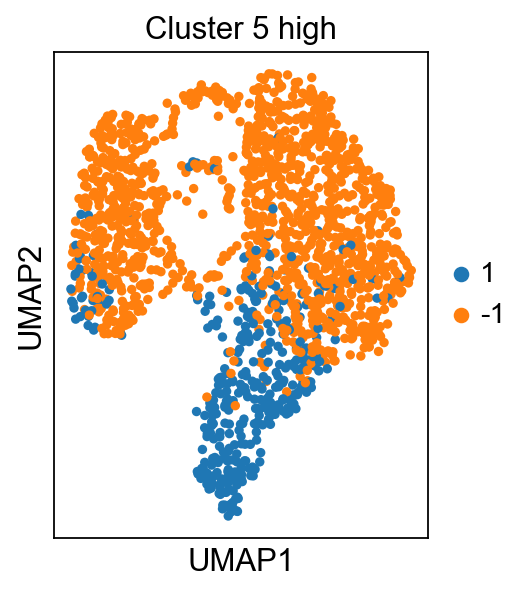

In [135]:
adata.obs['Cluster 5 high'] = ['1' if z >cutoff else '-1' for z in adata.obs['Cluster 5']]


sc.pl.umap(adata, color=['Cluster 5 high'], cmap="tab20c_r")

In [136]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

Save the result.

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


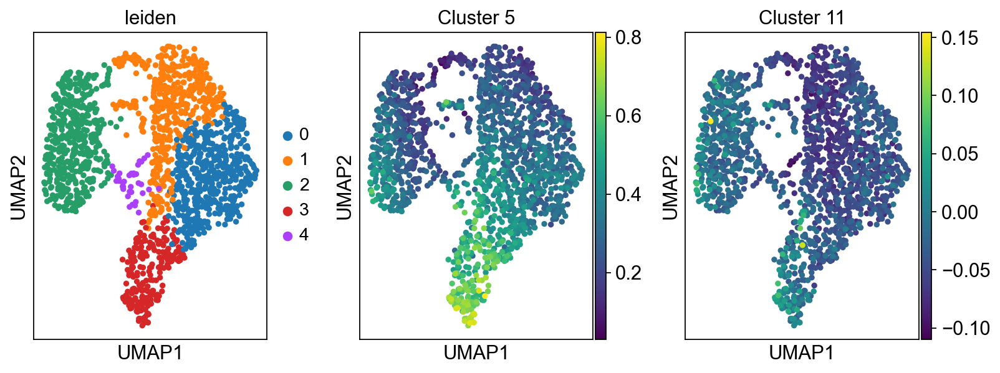

In [137]:
sc.pl.umap(adata, color=['leiden', 'Cluster 5', 'Cluster 11'])

In [138]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group      Classification       
shNfkb1    BD1939_B0303              49
           BE1137_B0304              35
           BE1155_(BD1672)_B0302     96
           BE1156_(BD1671)_B0301    134
shRel      BE1490_B0309             253
           BE1491-NT_B0310          131
           BE1662_B0311              56
shRela     BD1941_B0306             209
           BE1139_B0307              37
           BE1140-NT_B0308           45
           BE1157_(BD1674)_B0305    295
shRenilla  BF1087_B0313             326
           BF1240_(BE1834)_B0312      7
Name: count, dtype: int64

## Logistic Regression

In [139]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('genes.joblib')

In [140]:
adata_log = adata[:,adata.var.index.isin(names)]

In [141]:
adata_names = [x for x in adata_log.var.index]

In [142]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [143]:
smartseq = anndata.read('smartseq.h5ad')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [144]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [145]:
names = [x for x in names_adata.var.index]

In [146]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='saga')
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [147]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[136,   9,   2,   0,   1,   2,   1,   0,   1,   0,   0,   0],
       [  6,  67,   0,   3,   3,   0,   0,   1,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   1,   0,   1,   0,   1,   0,   0],
       [  2,   2,   1,  52,   0,   2,   0,  15,   3,   0,   0,   0],
       [  0,   0,   4,   0, 179,   1,   0,   3,   0,   1,   0,   1],
       [  0,   0,   0,   1,   1,  31,   0,   0,   1,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  13,   0,   2,   0,   0,   0],
       [  0,   0,   0,   2,   2,   0,   1, 131,   2,   4,   0,   2],
       [  0,   0,   0,   0,   2,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   4,   0,   0,   4,   0,  52,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   1,   0,  40]])

Text(0.5, 295.64444444444445, 'Predicted label')

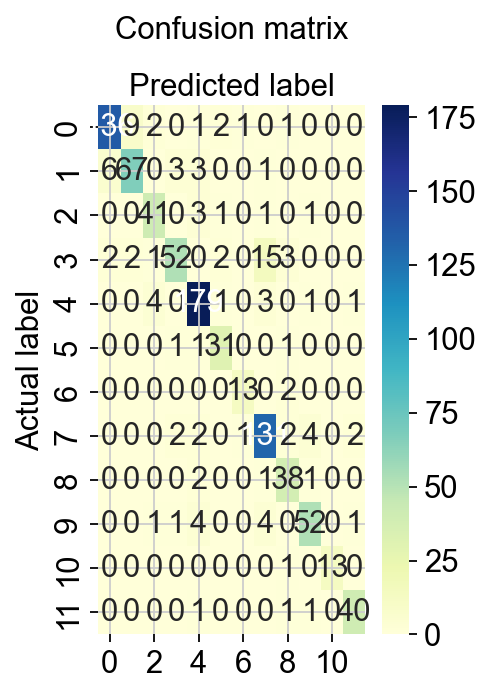

In [148]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [149]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.94      0.89      0.92       152
           2       0.86      0.84      0.85        80
           3       0.84      0.87      0.85        47
           4       0.88      0.68      0.76        77
           5       0.91      0.95      0.93       189
           6       0.84      0.91      0.87        34
           7       0.87      0.87      0.87        15
           8       0.84      0.91      0.87       144
           9       0.78      0.90      0.84        42
          10       0.87      0.83      0.85        63
          11       1.00      0.93      0.96        14
          12       0.91      0.93      0.92        43

    accuracy                           0.88       900
   macro avg       0.88      0.88      0.87       900
weighted avg       0.88      0.88      0.88       900



In [150]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [151]:
class_of_interest = 9
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

8

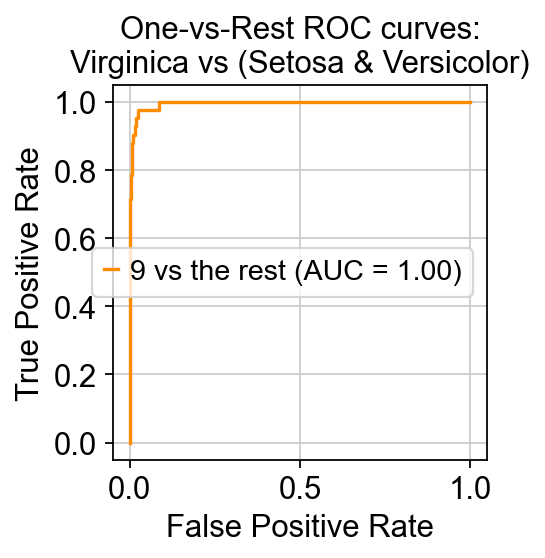

In [152]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [153]:
## Now write logit classifier to load later
from joblib import dump, load
dump(logreg, 'cancerCell2020Logreg_intersecting-all.joblib')
dump(names, 'intersecting_genes_new-all.joblib')

['intersecting_genes_new-all.joblib']

In [154]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [155]:
smartseq.obs['clusterK12_intersecting'] = ["%02d" % x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [156]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,3,3,1.066364e-07,1.093527e-04,5.181664e-01,2.281282e-02,3.128461e-05,1.476008e-03,1.135370e-03,4.222479e-01,5.525026e-05,5.343882e-04,4.869765e-04,3.294421e-02,0.518166,1
1,1,1,9.999999e-01,4.711566e-09,4.219003e-12,5.104630e-10,2.010189e-11,5.113110e-09,5.511818e-08,5.609457e-12,4.309910e-13,9.194831e-13,3.174558e-10,1.114494e-11,1.000000,1
2,8,8,9.663233e-08,8.268446e-06,4.766849e-04,2.341205e-05,9.380813e-05,5.906970e-05,8.872660e-05,9.974107e-01,6.807905e-04,8.707160e-04,1.128605e-04,1.748985e-04,0.997411,1
3,5,10,4.141997e-05,3.158796e-04,8.894532e-05,5.329845e-06,9.950100e-01,9.883863e-05,2.167256e-05,6.310058e-05,2.099004e-05,3.991213e-03,5.317822e-05,2.893840e-04,0.995010,0
4,8,8,4.707352e-07,1.849731e-06,2.096994e-07,1.492551e-06,5.163671e-07,6.069702e-06,4.583133e-05,9.696811e-01,3.015805e-02,8.099685e-05,7.198407e-06,1.625534e-05,0.969681,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,5,5,1.496106e-04,1.845153e-07,1.092275e-05,2.169319e-05,9.933458e-01,3.061703e-03,3.931526e-05,2.209132e-04,1.276509e-04,2.922257e-03,7.316783e-05,2.680595e-05,0.993346,1
896,5,5,3.164155e-06,2.094211e-03,5.338647e-04,3.487858e-04,9.957063e-01,8.086733e-04,3.471164e-05,4.261205e-09,1.875397e-05,8.743898e-08,3.753089e-04,7.616745e-05,0.995706,1
897,8,8,1.731651e-07,4.570807e-06,8.319809e-06,1.793099e-05,5.712025e-10,3.956068e-07,4.296794e-05,9.854044e-01,1.440604e-02,9.600243e-05,1.167008e-05,7.565768e-06,0.985404,1
898,5,5,9.975588e-12,4.673490e-08,9.990510e-07,4.017930e-10,9.999985e-01,2.716535e-09,9.503600e-08,1.386187e-07,2.448653e-09,8.468651e-09,2.371913e-07,3.233206e-09,0.999998,1


In [157]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.24-0.86,0.244860,0.855710,0.472868
1,0.86-0.97,0.855710,0.972870,0.835938
2,0.97-1.0,0.972870,0.996030,0.899225
3,1.0-1.0,0.998843,0.999833,0.990272


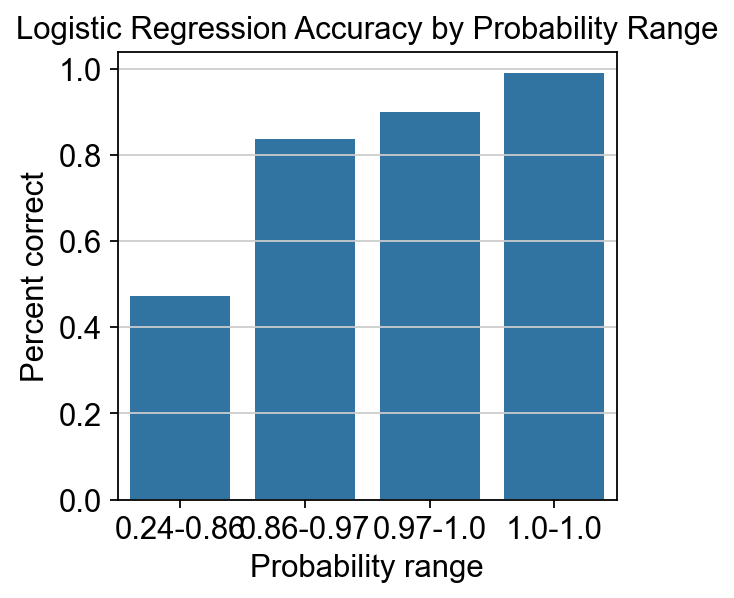

In [158]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [159]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seei

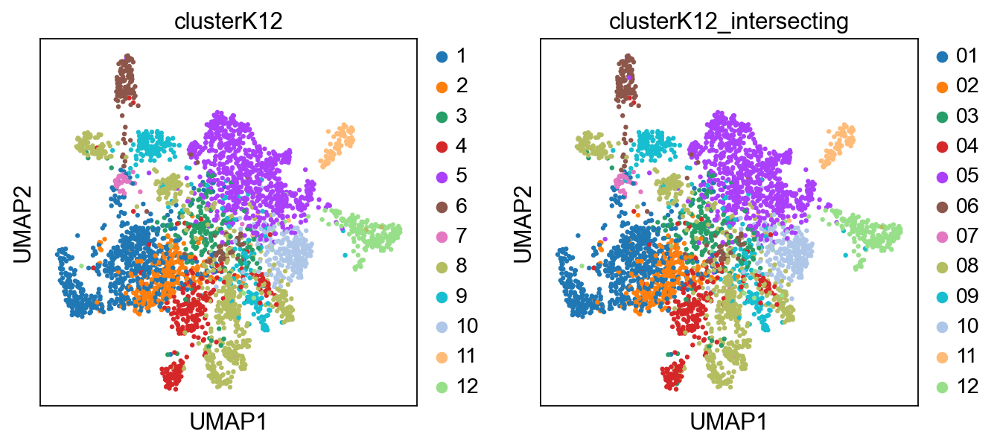

In [160]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [161]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [162]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/3184290090.py:2: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])


0.9702777777777778

In [163]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.381786e-08,2.476443e-06,5.007700e-07,1.942693e-08,1.030738e-05,5.502502e-09,8.513148e-08,6.573178e-14,1.000287e-09,7.498173e-11,9.999866e-01,3.360632e-08,0.999987
1,12,1.375628e-11,2.313953e-08,5.815135e-09,2.984812e-09,9.719959e-12,4.041626e-07,2.881846e-08,1.898598e-07,1.008879e-06,4.994886e-07,1.472880e-08,9.999978e-01,0.999998
2,5,2.096641e-03,1.138027e-07,1.945919e-03,2.822782e-07,9.957017e-01,1.277767e-05,5.043930e-05,3.221068e-06,2.581788e-05,1.013483e-04,2.868881e-05,3.309886e-05,0.995702
3,10,3.092081e-05,2.474493e-05,1.431244e-05,2.449881e-03,1.004848e-06,1.099272e-05,1.406532e-05,4.011083e-03,7.287790e-05,9.933085e-01,8.863599e-06,5.274585e-05,0.993309
4,1,9.999996e-01,2.223302e-09,4.105876e-08,3.202766e-07,1.236916e-10,1.253158e-09,5.769641e-09,1.036806e-10,2.814604e-14,4.507892e-10,2.510603e-08,3.840740e-10,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,8,7.387556e-08,4.364997e-06,2.959884e-08,9.584220e-07,4.072279e-10,4.309905e-09,1.803821e-07,9.999889e-01,5.436659e-06,4.798479e-08,2.058933e-08,2.452280e-08,0.999989
3596,9,1.901361e-11,3.431867e-07,1.332763e-07,1.177503e-07,5.894212e-09,1.092281e-08,1.727685e-06,6.527936e-03,9.934693e-01,1.919175e-07,2.402804e-07,4.017568e-08,0.993469
3597,8,6.976570e-09,7.105922e-07,1.222983e-08,6.978786e-07,4.697369e-11,2.450294e-09,1.111385e-07,9.999551e-01,4.326507e-05,2.858535e-08,2.681075e-08,2.988895e-08,0.999955
3598,8,4.719775e-07,4.956737e-06,3.273221e-06,1.615013e-07,2.361796e-04,9.675056e-07,5.425997e-06,9.997306e-01,1.423689e-05,2.348060e-06,1.188041e-06,1.499936e-07,0.999731


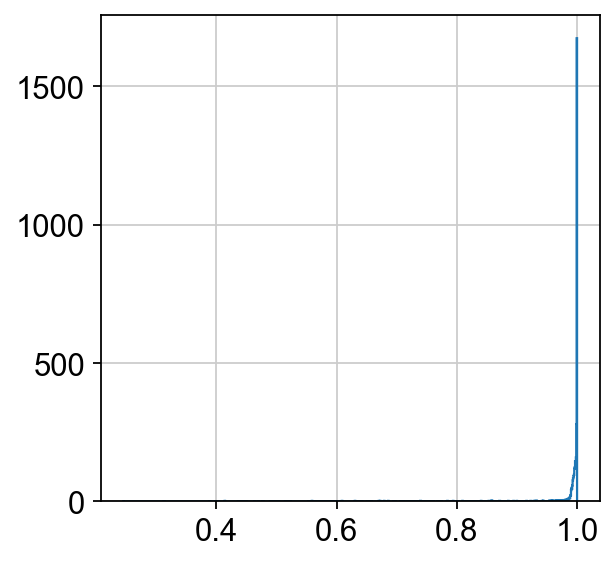

In [164]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## End LogisticRegression

In [165]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [166]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [167]:
y_pred = logreg.predict(adata_log_ordered.X)

In [168]:
adata_log_ordered.obs['clusterK12'] = ["%02d" % x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/1933329291.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = ["%02d" % x for x in y_pred]


In [169]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seei

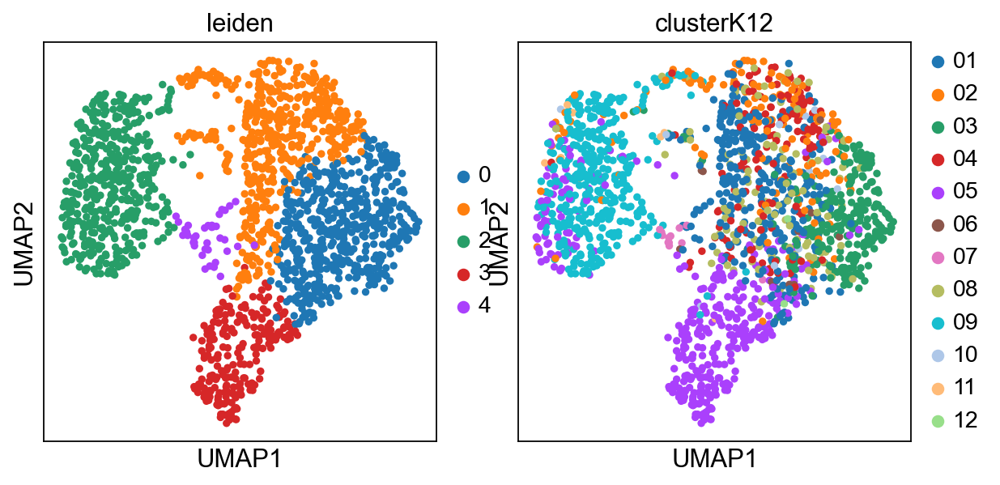

In [170]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


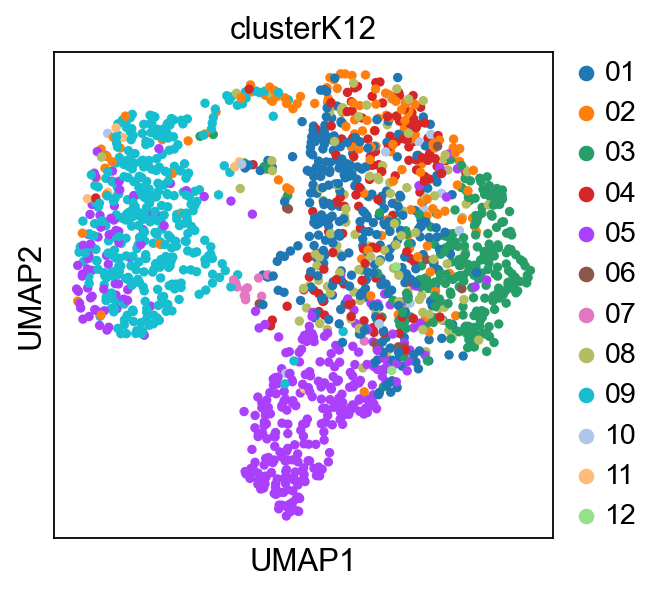

In [171]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


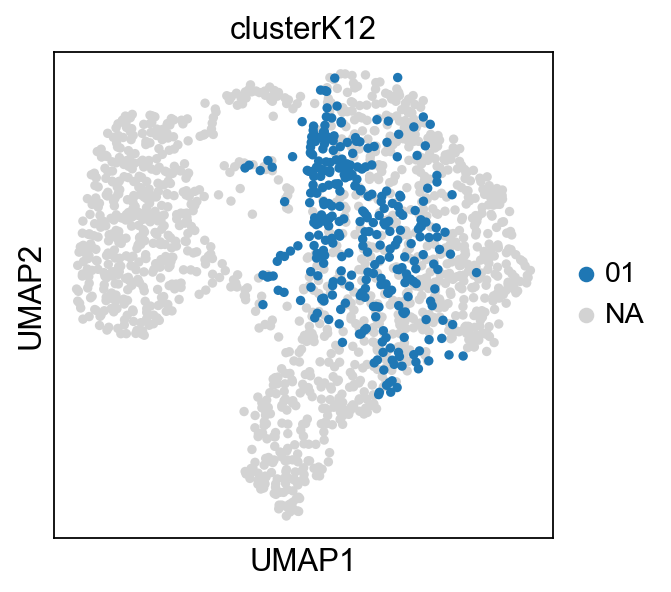

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


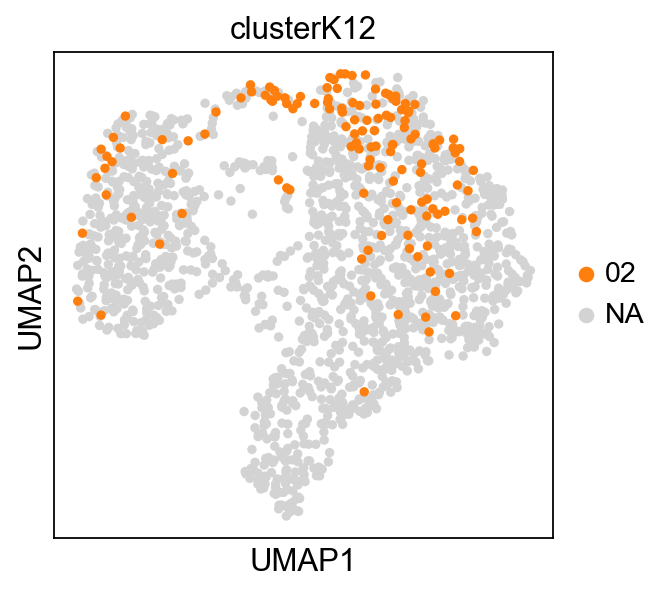

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


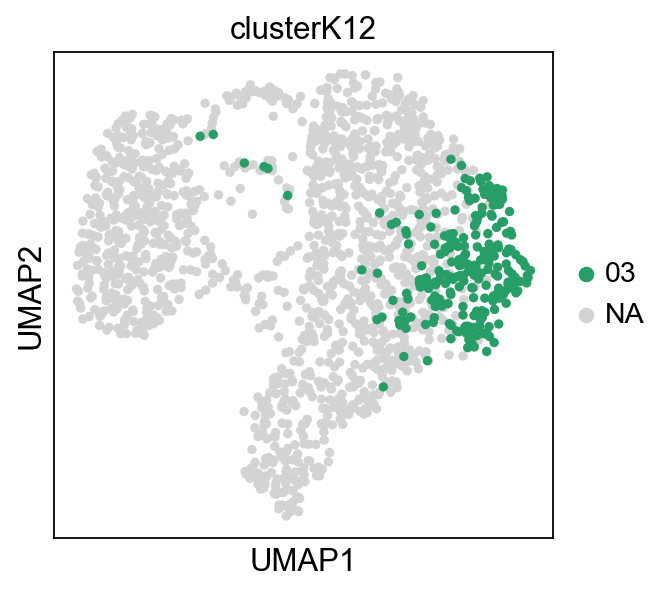

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


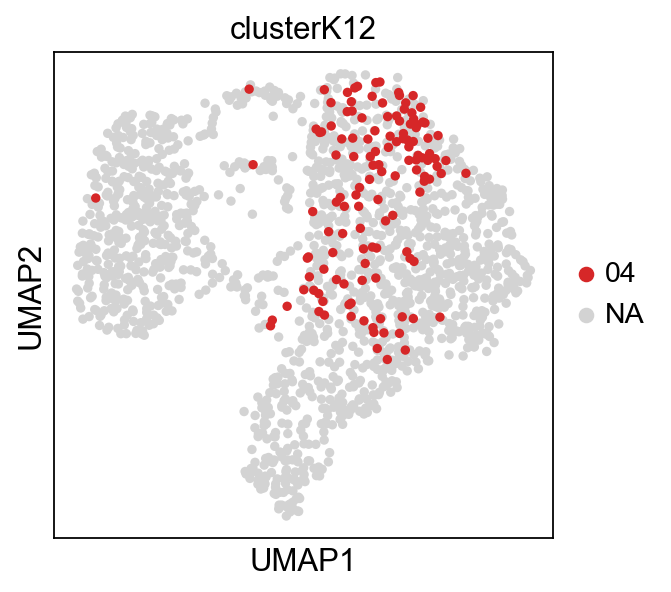

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


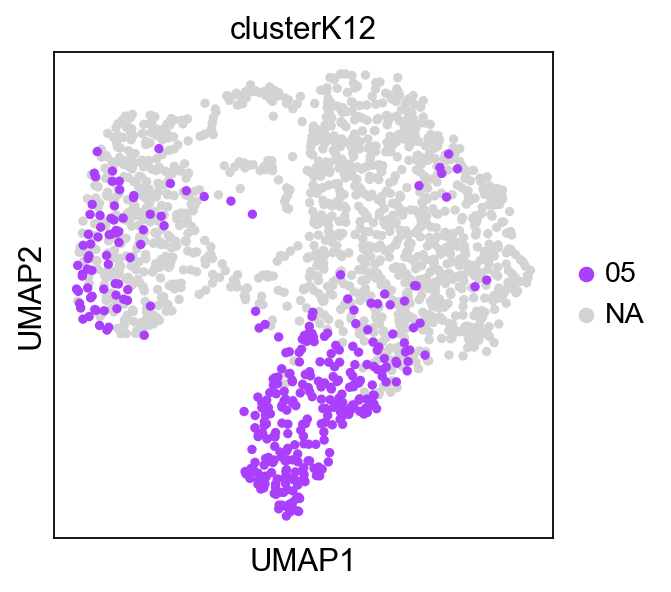

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


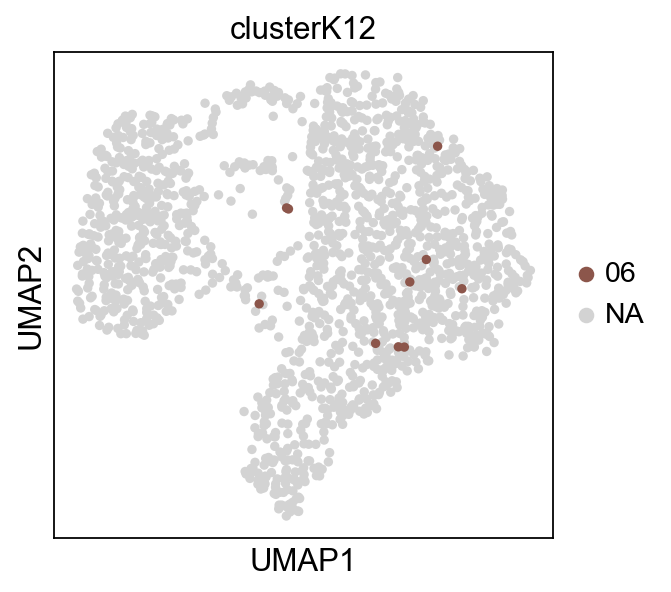

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


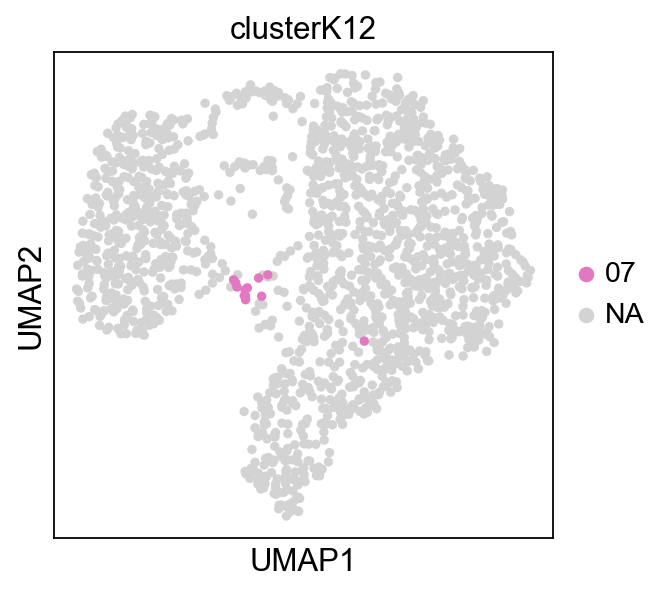

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


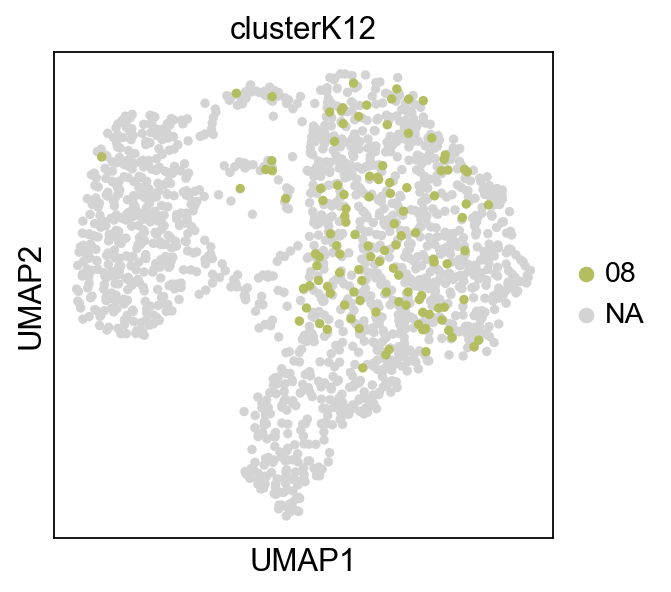

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


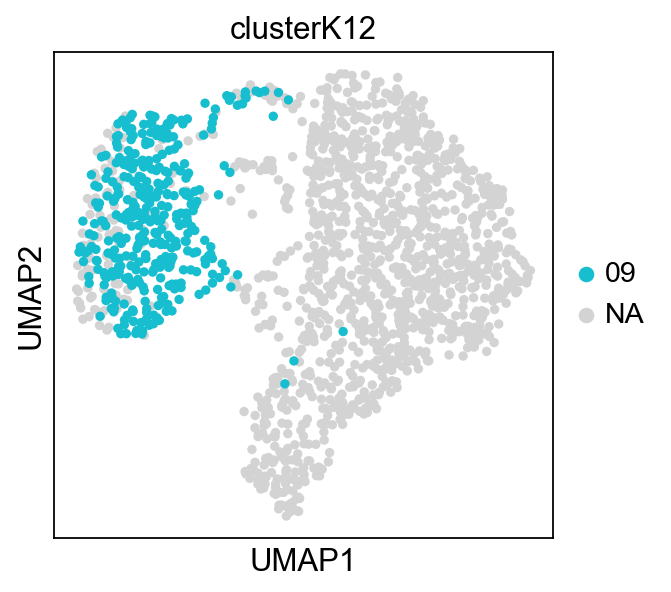

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


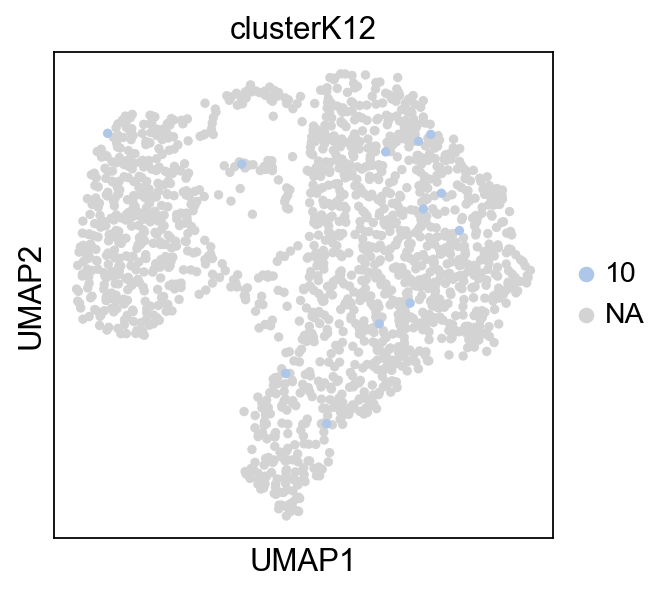

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


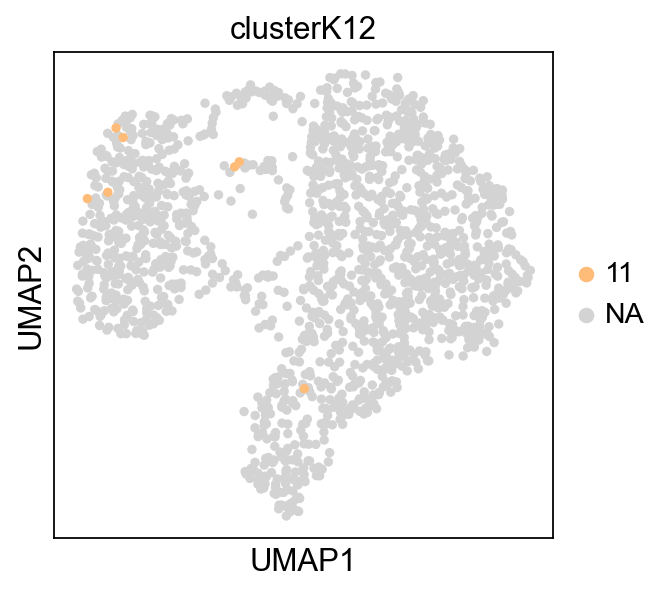

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


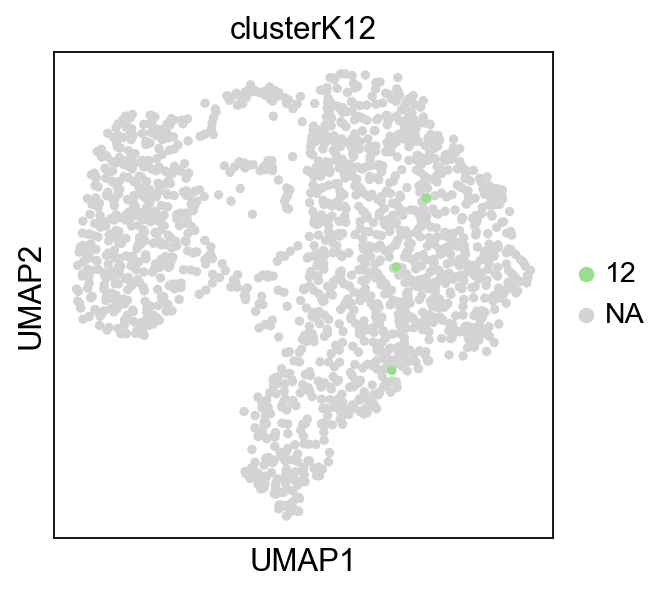

In [172]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

In [173]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

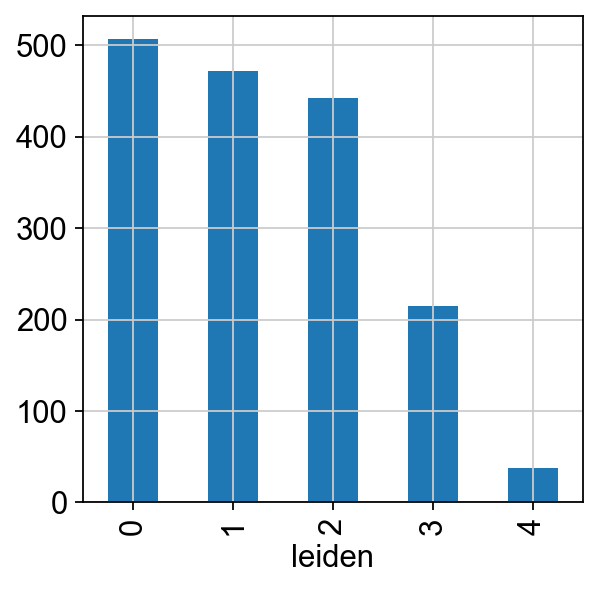

In [174]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

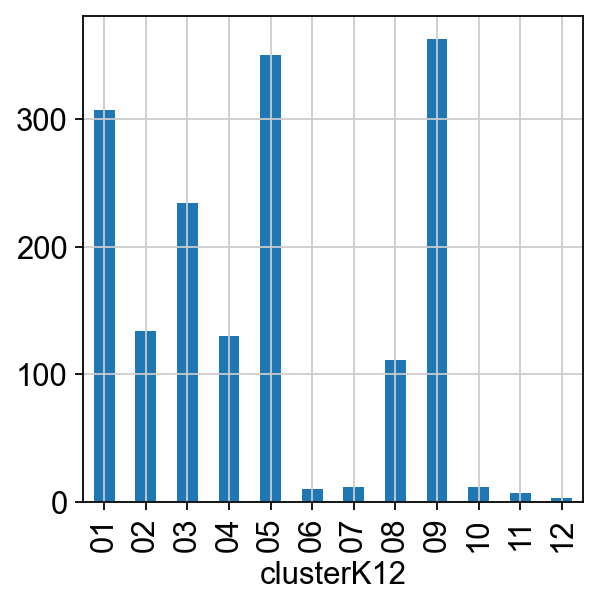

In [175]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

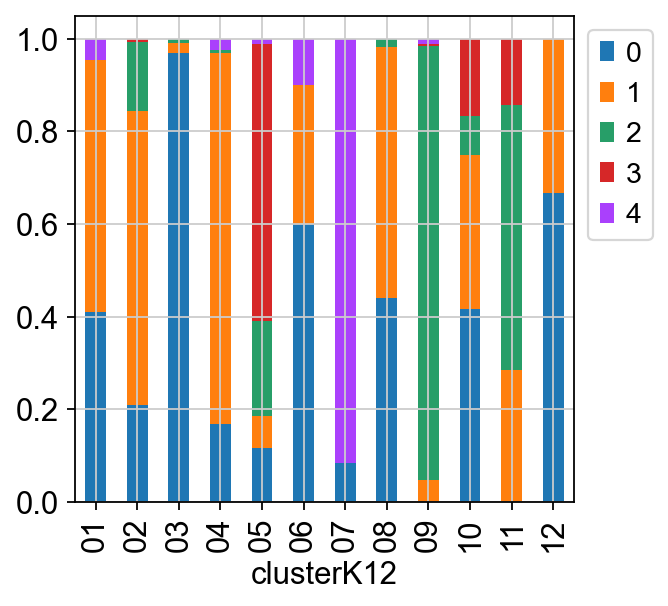

In [176]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [177]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,3,0.000167,7.456307e-07,9.993414e-01,0.000013,7.600521e-05,0.000046,0.000006,3.138665e-04,1.964414e-08,2.633719e-05,0.000010,2.211876e-07,0.999341
1,3,0.000015,1.768066e-01,8.046417e-01,0.000340,2.088099e-04,0.005056,0.000179,1.070706e-02,7.253230e-04,7.367218e-04,0.000315,2.686946e-04,0.804642
2,2,0.005510,9.685860e-01,1.634860e-07,0.022699,4.781349e-09,0.000088,0.001750,7.503095e-04,5.898656e-08,8.660106e-05,0.000087,4.419856e-04,0.968586
3,9,0.000009,2.353073e-02,2.245161e-05,0.000159,4.884993e-03,0.000227,0.000825,8.005220e-04,9.688237e-01,2.848047e-05,0.000579,1.095871e-04,0.968824
4,8,0.158788,7.936216e-06,9.434099e-02,0.000425,2.743456e-03,0.025309,0.004770,6.752253e-01,3.184252e-03,1.010448e-03,0.002270,3.192647e-02,0.675225
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1668,1,0.632692,1.689232e-06,1.783683e-01,0.115947,9.958085e-03,0.025203,0.005314,5.355867e-03,1.632989e-03,5.067336e-03,0.010692,9.766888e-03,0.632692
1669,3,0.210592,9.717576e-07,7.575630e-01,0.013819,1.279035e-02,0.000519,0.001399,1.690313e-04,7.272911e-05,2.232723e-03,0.000265,5.771700e-04,0.757563
1670,5,0.001295,4.539891e-02,7.340588e-03,0.010648,7.181938e-01,0.014244,0.010032,1.001119e-03,1.814082e-02,4.523555e-02,0.022105,1.063648e-01,0.718194
1671,5,0.000477,1.023165e-02,7.857728e-04,0.003099,9.186930e-01,0.000511,0.002064,3.040810e-07,3.100584e-03,2.545282e-03,0.029452,2.904135e-02,0.918693


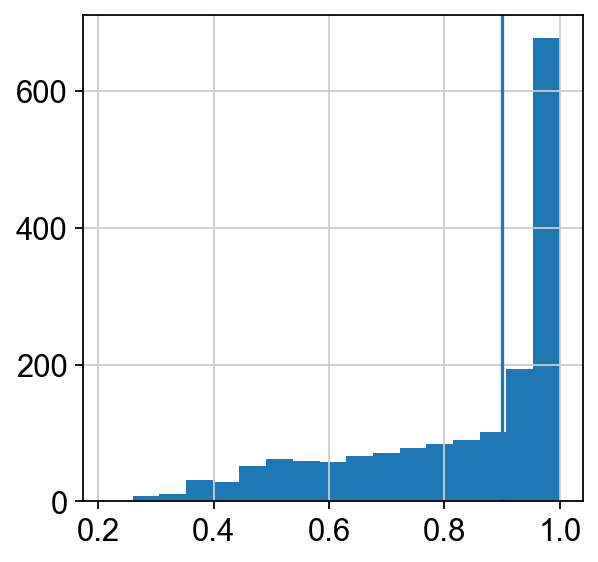

In [178]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [179]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.21-0.57,0.212,0.573
1,0.57-0.74,0.573,0.739
2,0.74-0.87,0.739,0.868
3,0.87-0.94,0.868,0.945
4,0.94-0.98,0.945,0.984
5,0.98-1.0,0.984,0.998
6,1.0-1.0,0.998,1.000


In [180]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [181]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCATCGACGTCG-1       03
AAACGAAGTCGAACAG-1       03
AAACGAATCGAACACT-1       02
AAACGCTGTCACGCTG-1       09
AAAGAACAGCTCGAAG-1    other
                      ...  
TTTGATCAGGATCATA-1    other
TTTGTTGAGATGGGCT-1    other
TTTGTTGAGCTGAAAT-1    other
TTTGTTGAGTACCATC-1       05
TTTGTTGTCTATCACT-1       01
Name: clusterK12_stringent, Length: 1673, dtype: object

In [182]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seei

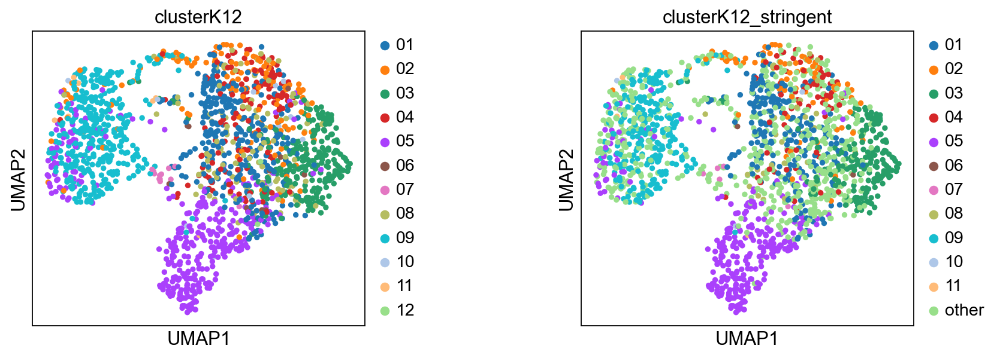

In [183]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

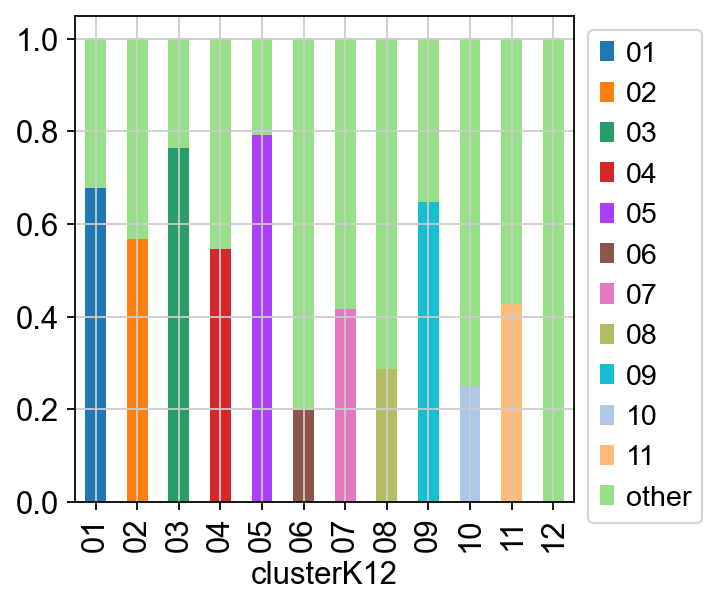

In [184]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

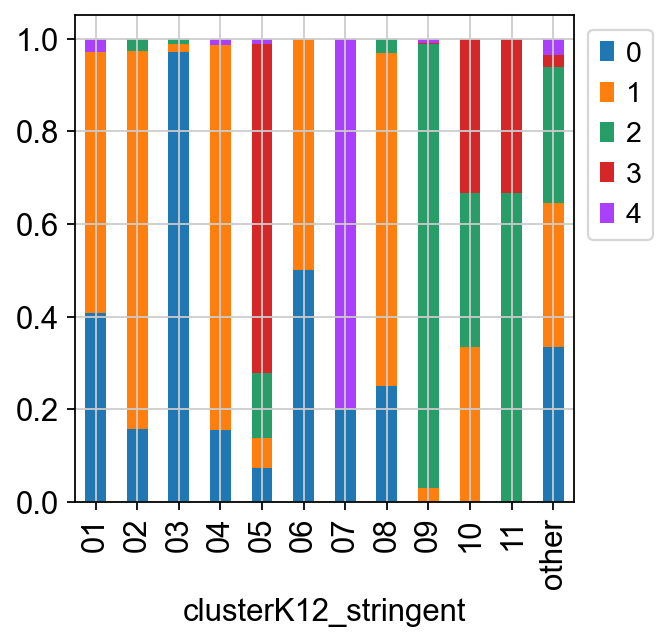

In [185]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

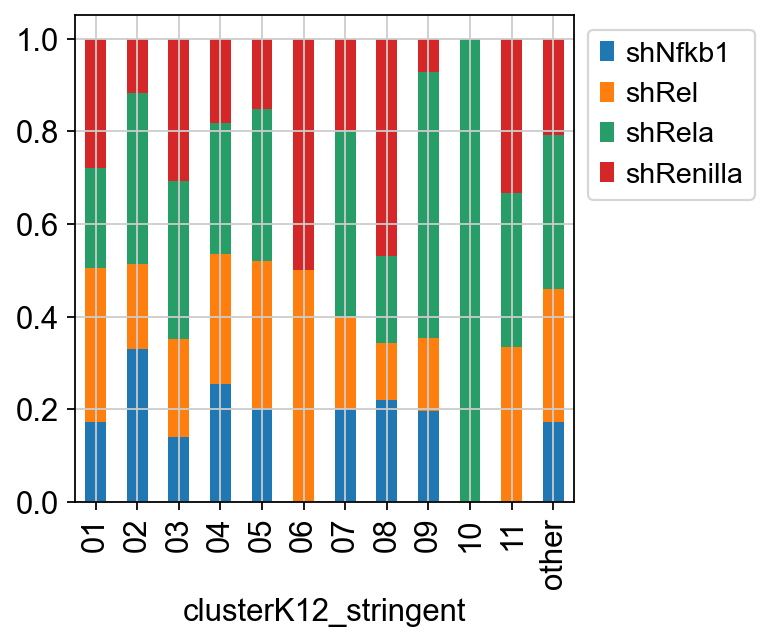

In [186]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


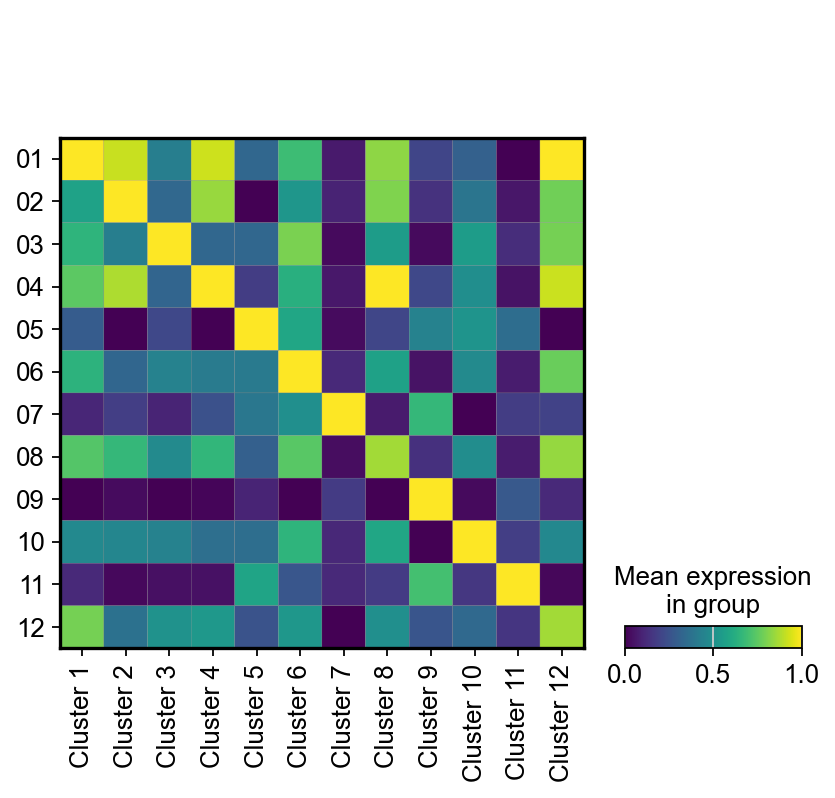

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


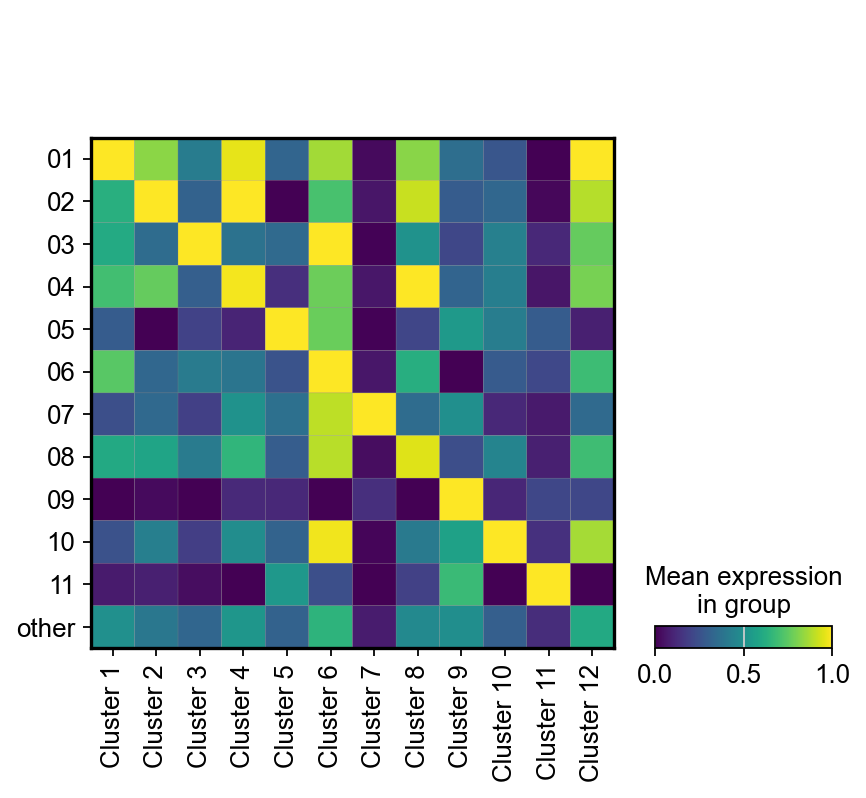

In [187]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


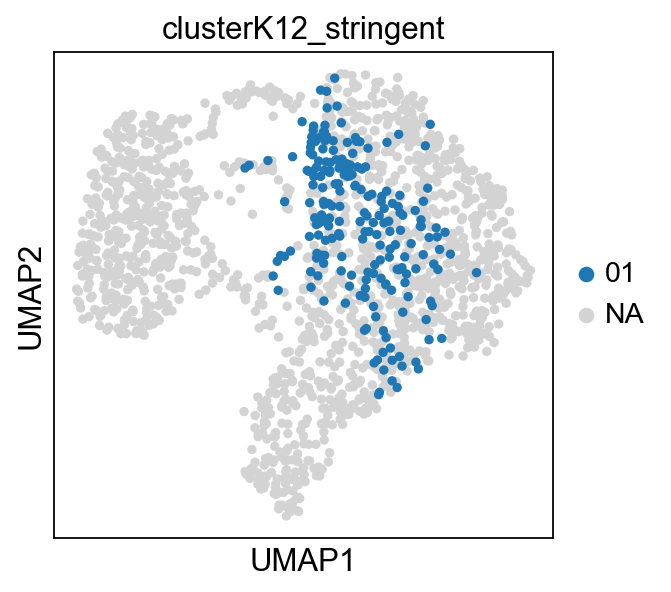

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


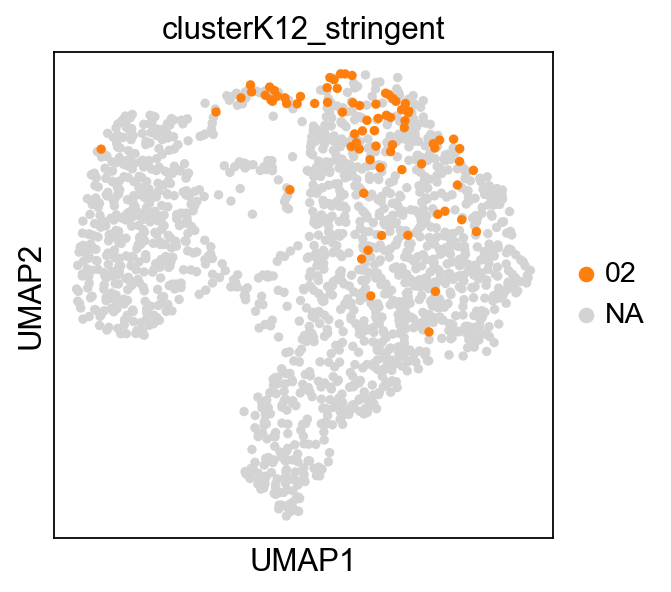

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


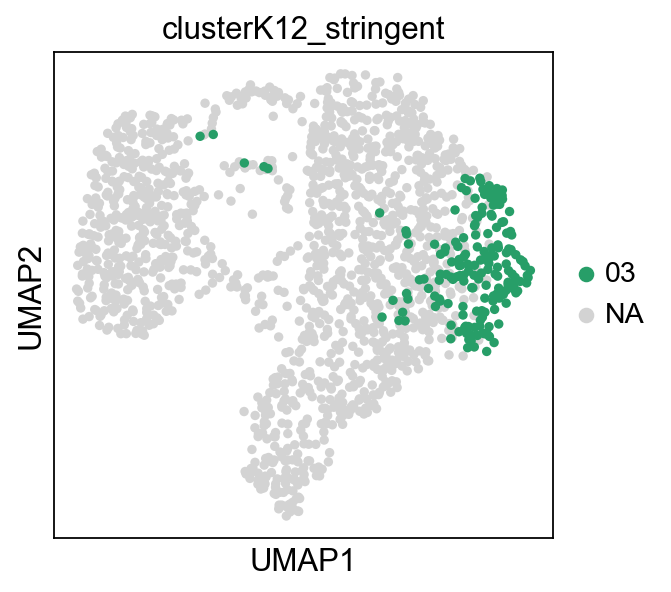

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


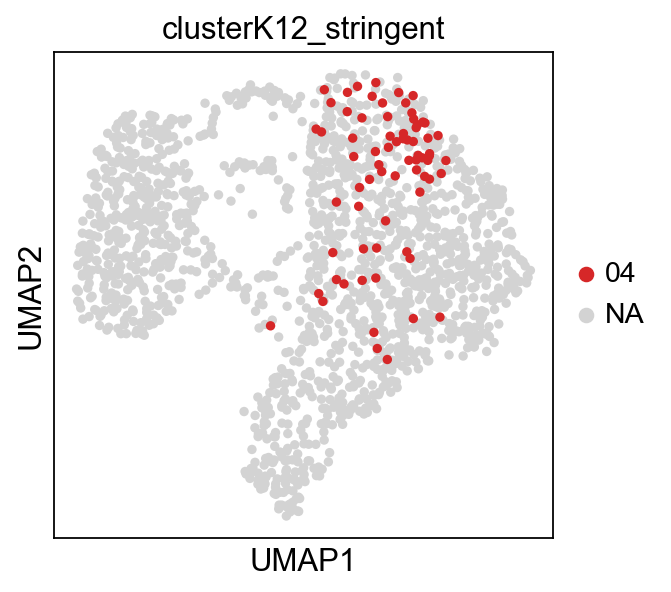

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


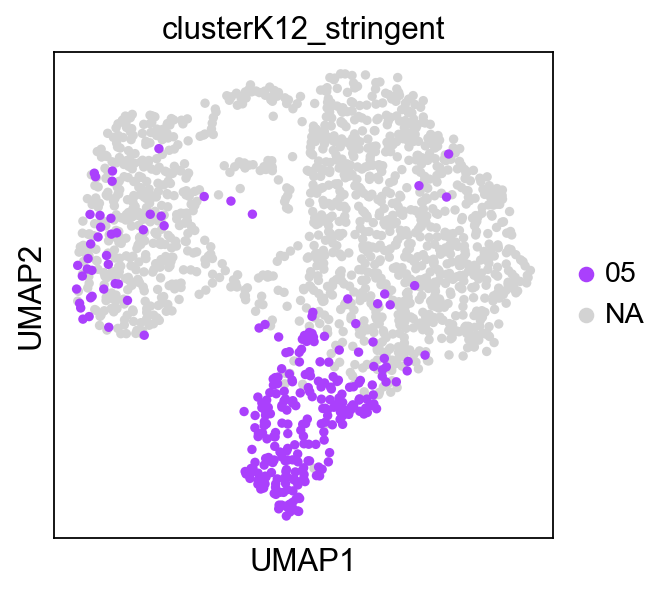

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


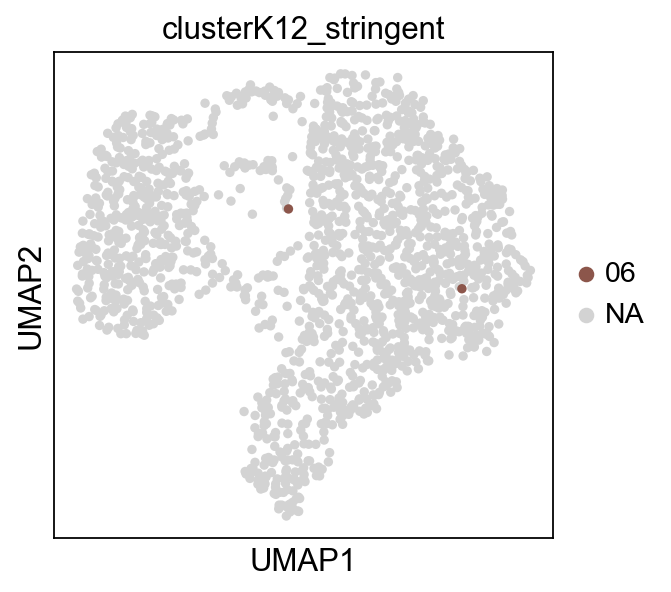

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


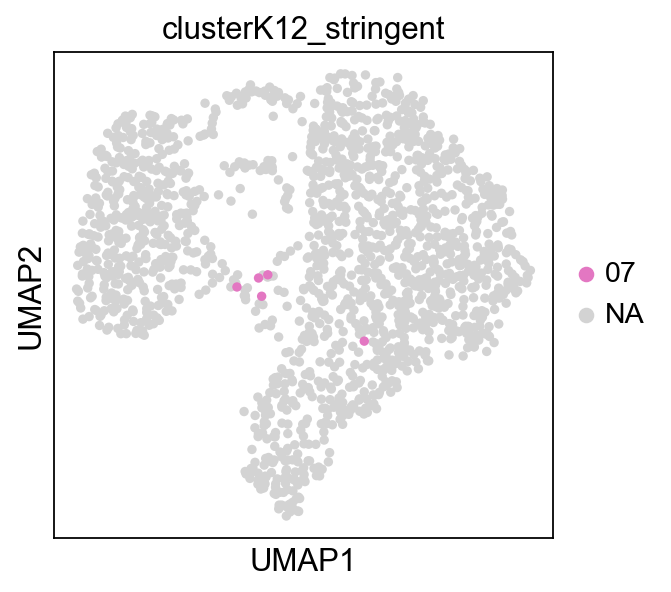

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


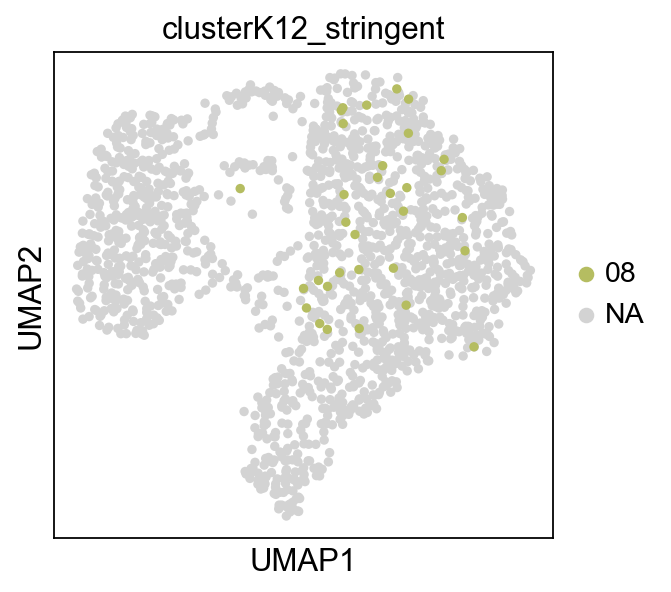

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


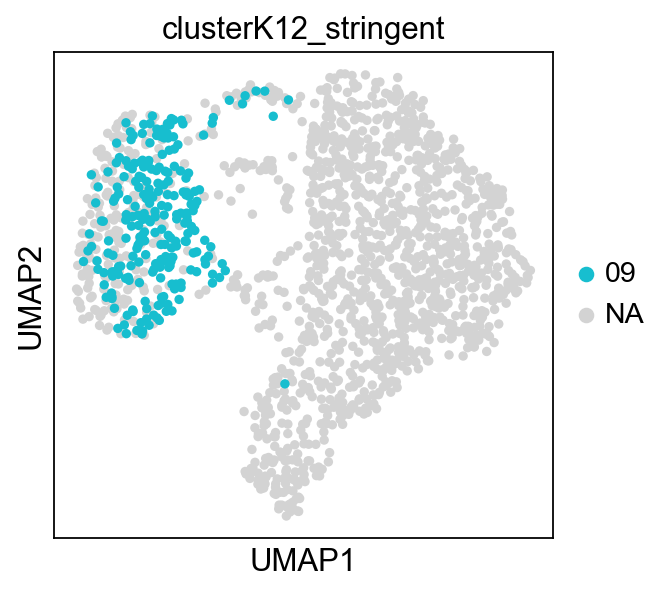

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


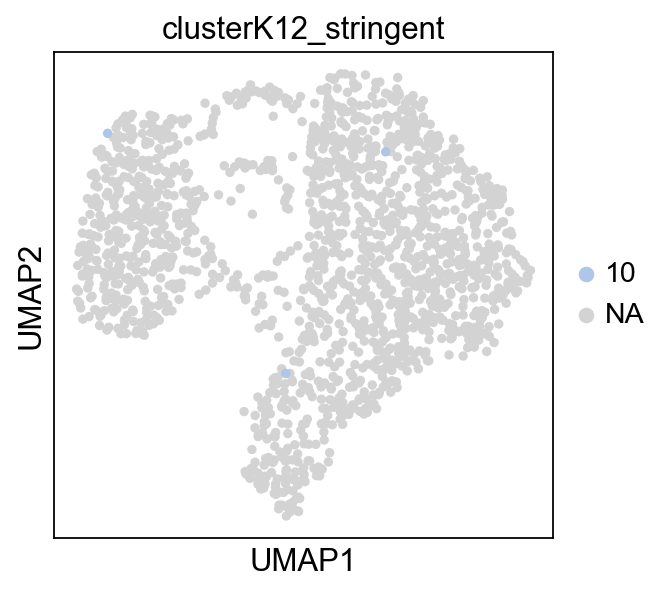

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


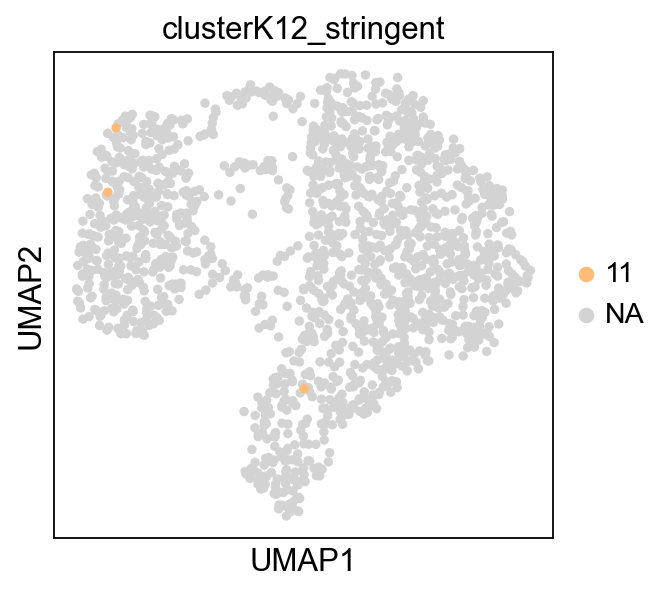

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


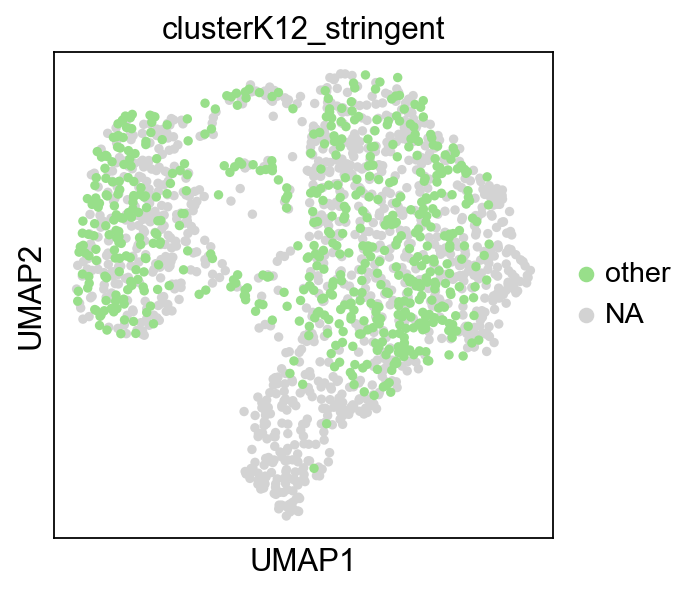

In [188]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [189]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
09    363
05    350
01    307
03    234
02    134
04    130
08    111
07     12
10     12
06     10
11      7
12      3
Name: count, dtype: int64

In [190]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_stacked_violin.py:324: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  _color_df = _matrix.groupby(level=0).median()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_stacked_violin.py:405: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  pd.DataFrame(_matrix.stack(dropna=False))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_stacked_violin.py:461: FutureWarning: 

Passing `palette` without assigni

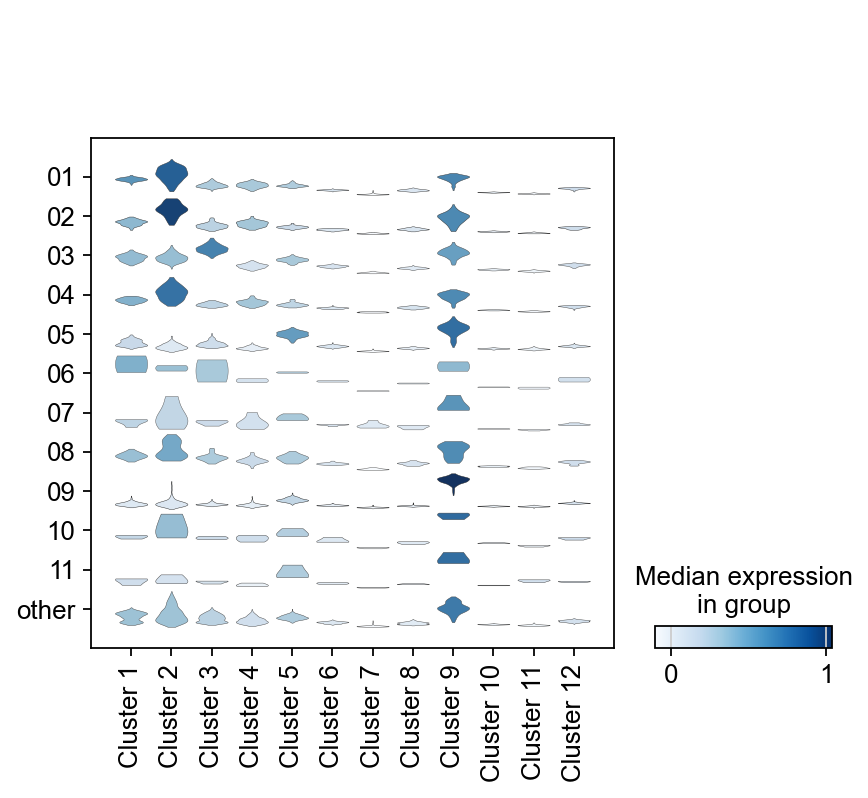

In [191]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

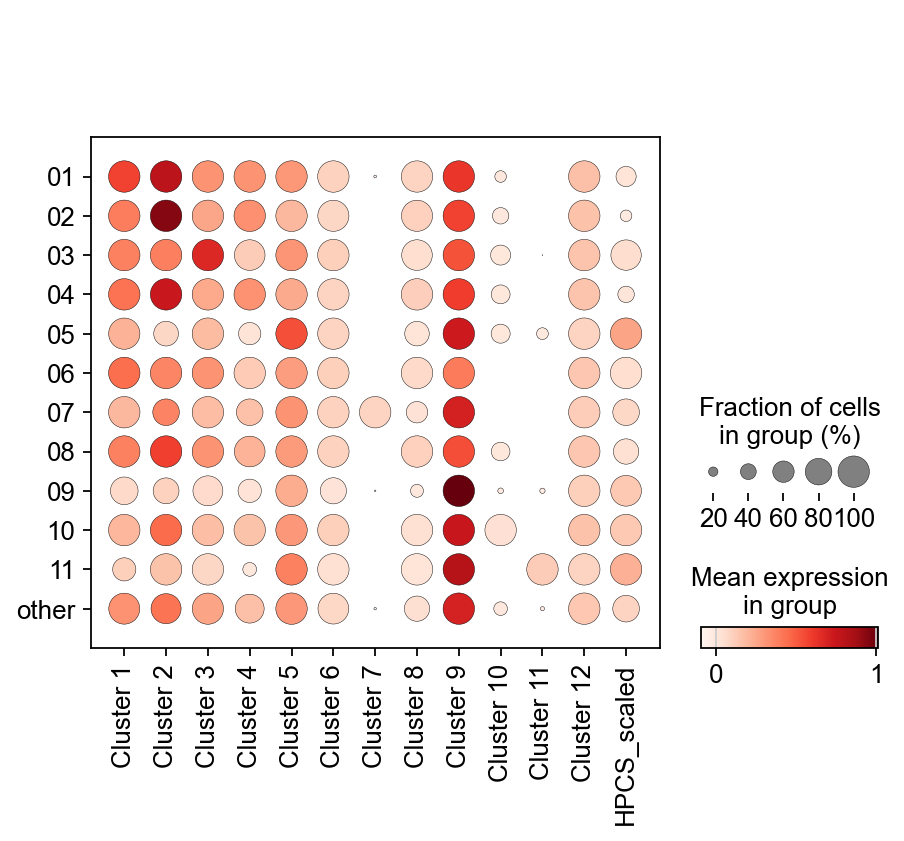

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

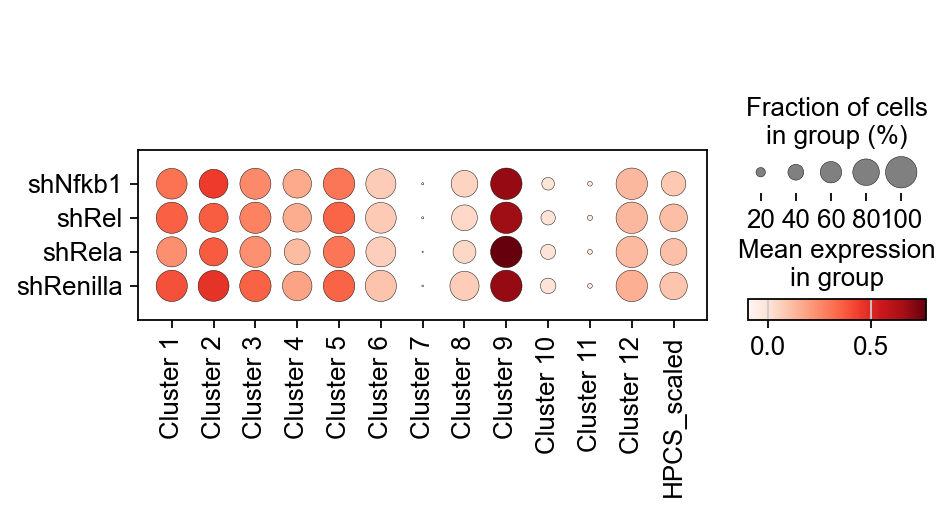

In [192]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell, 'HPCS_scaled'], groupby='clusterK12_stringent')
sc.pl.dotplot(adata_log_ordered, [*cancerCell, 'HPCS_scaled'], groupby='Group')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


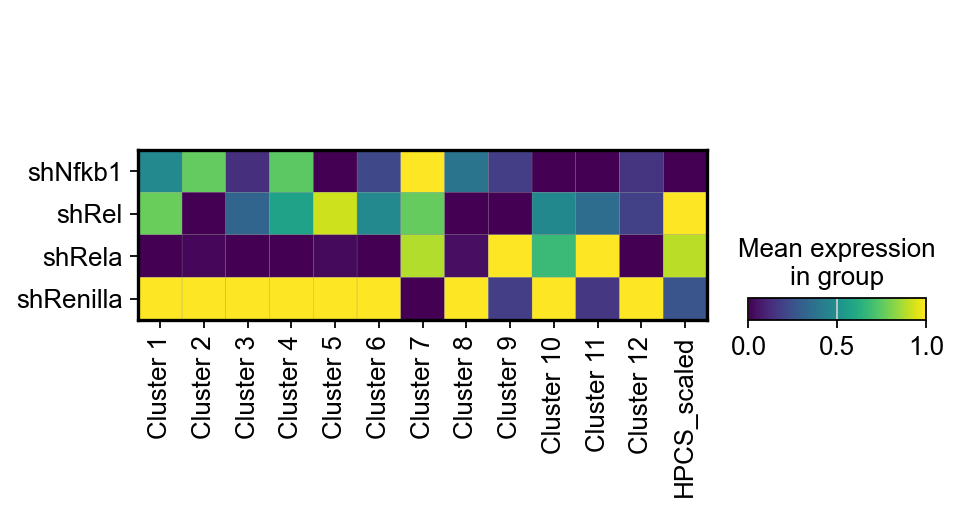

In [193]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell,'HPCS_scaled'], groupby='Group',standard_scale='var')
#sc.pl.matrixplot(adata_log_ordered, cancerCell, groupby='Group',standard_scale='var')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


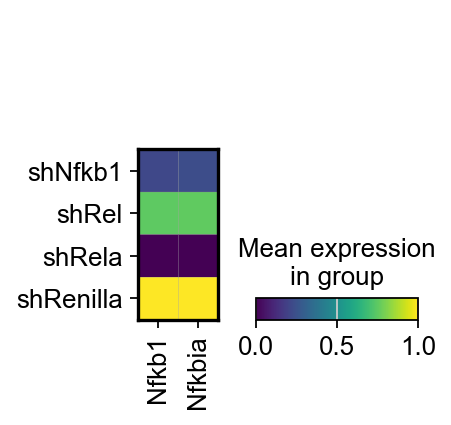

In [194]:
sc.pl.matrixplot(adata_log_ordered, ['Nfkb1','Nfkbia'], groupby='Group',standard_scale='var')

In [195]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

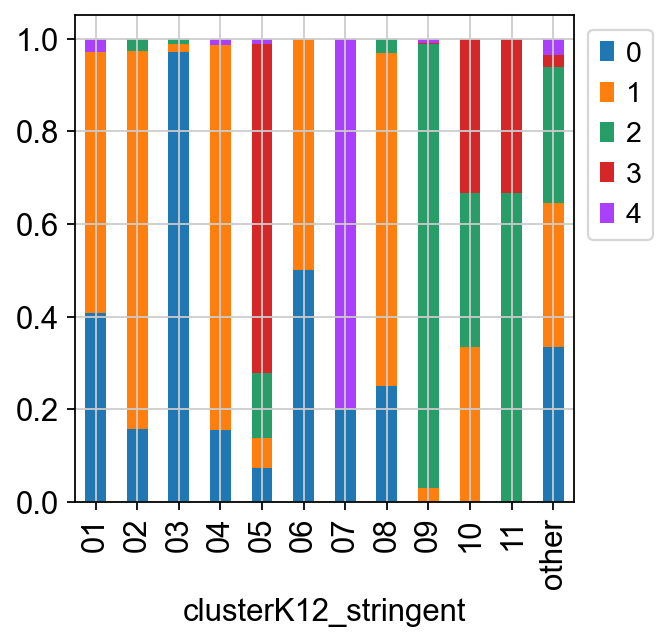

In [196]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

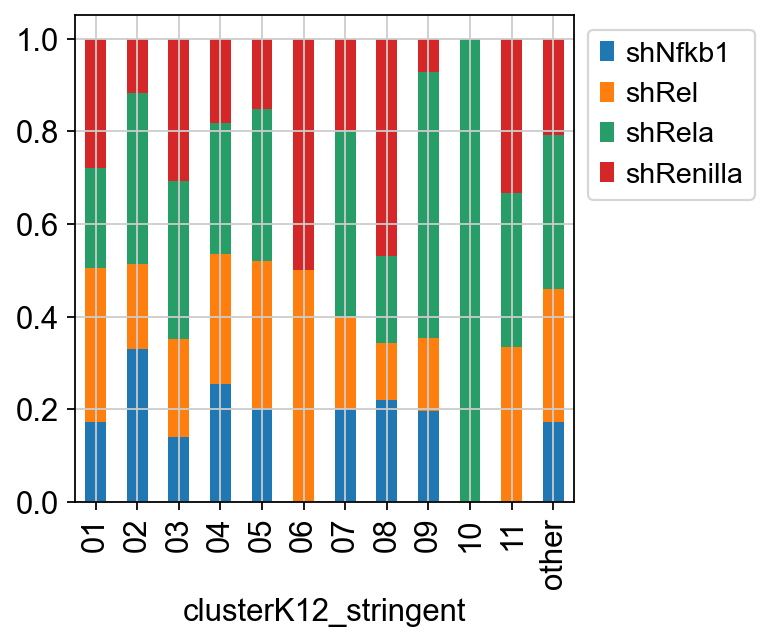

In [197]:
 cell_proportion_df = pd.crosstab(adata.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Now retrain a new Logit classifier based off the single cell 10x data

## Logistic Regression against Cancer Cell 2020 Clusters in 10x data (stringent)

## Examine Groupings

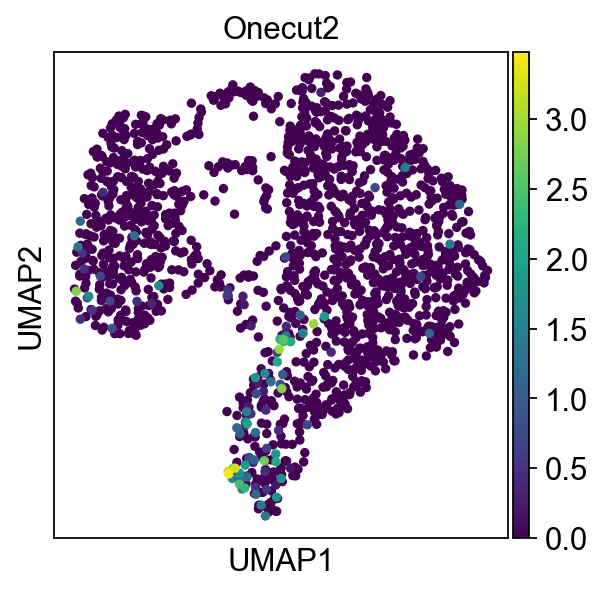

In [198]:
sc.pl.umap(adata, color=['Onecut2'])

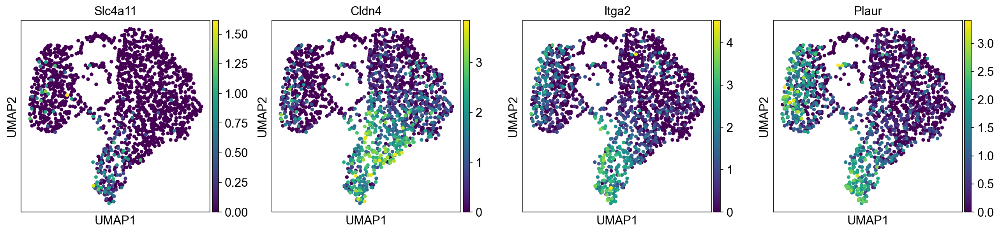

In [199]:
sc.pl.umap(adata, color=['Slc4a11','Cldn4','Itga2', 'Plaur']) #'Tigit',

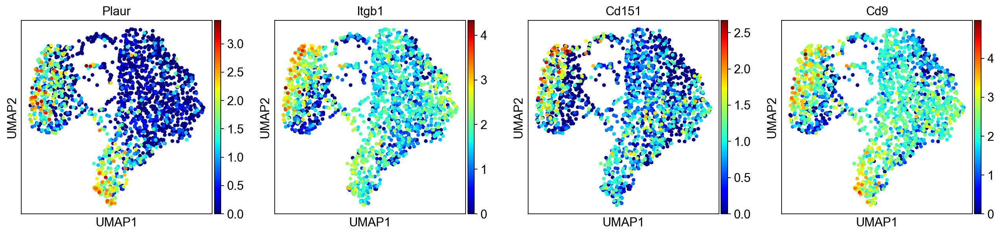

In [200]:
sc.pl.umap(adata, color=['Plaur','Itgb1','Cd151', 'Cd9'], cmap="jet")

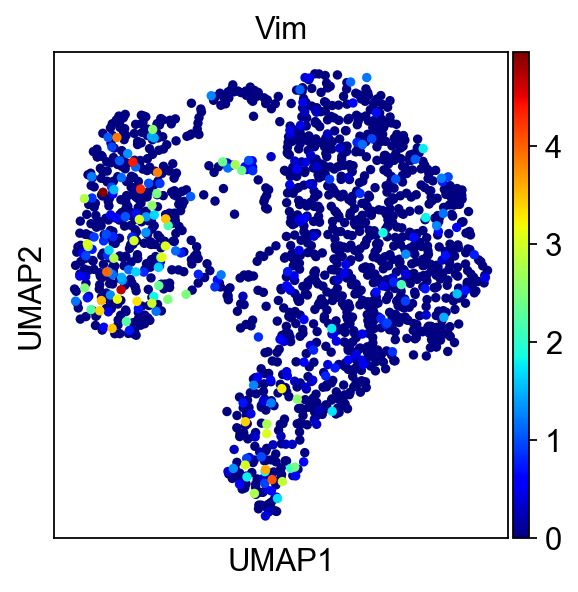

In [201]:
sc.pl.umap(adata, color=['Vim',], cmap="jet") #'Cd109'

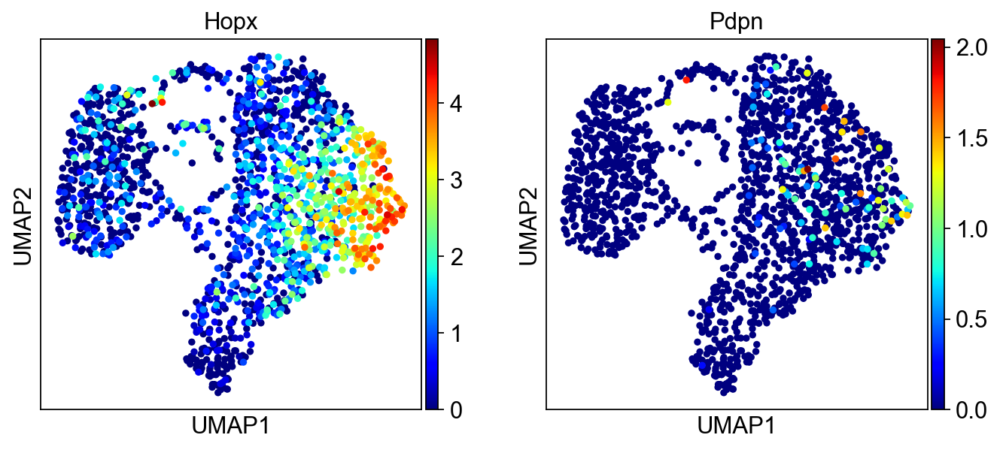

In [202]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], cmap="jet")

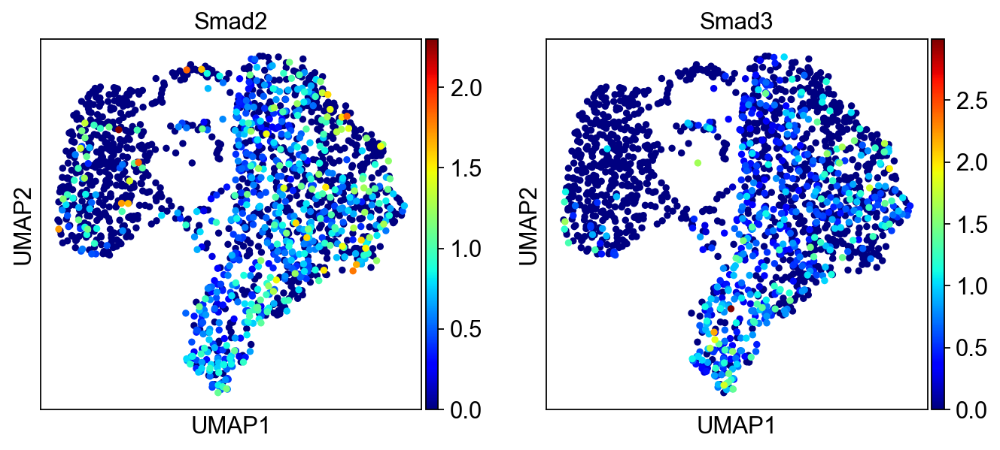

In [203]:
sc.pl.umap(adata, color=['Smad2', 'Smad3'], cmap="jet")

In [204]:
adata.write_h5ad(results_file)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


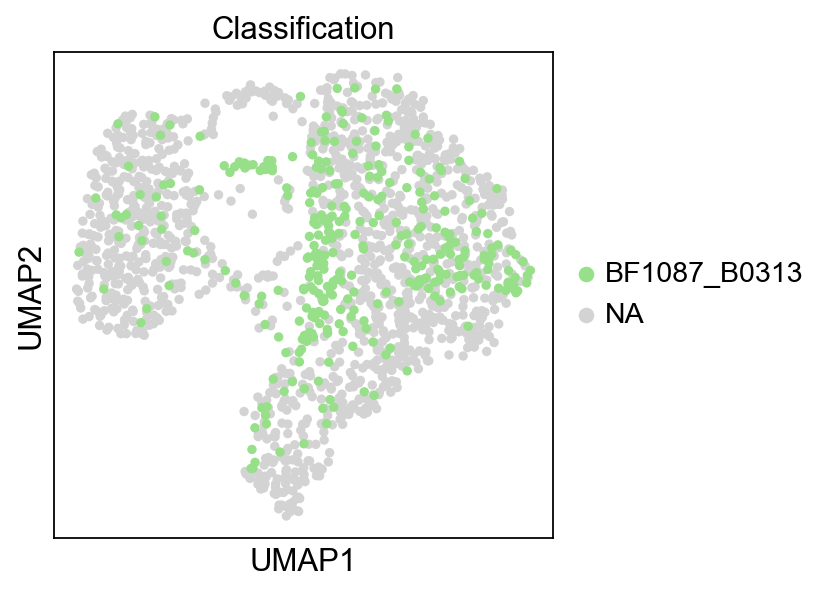

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


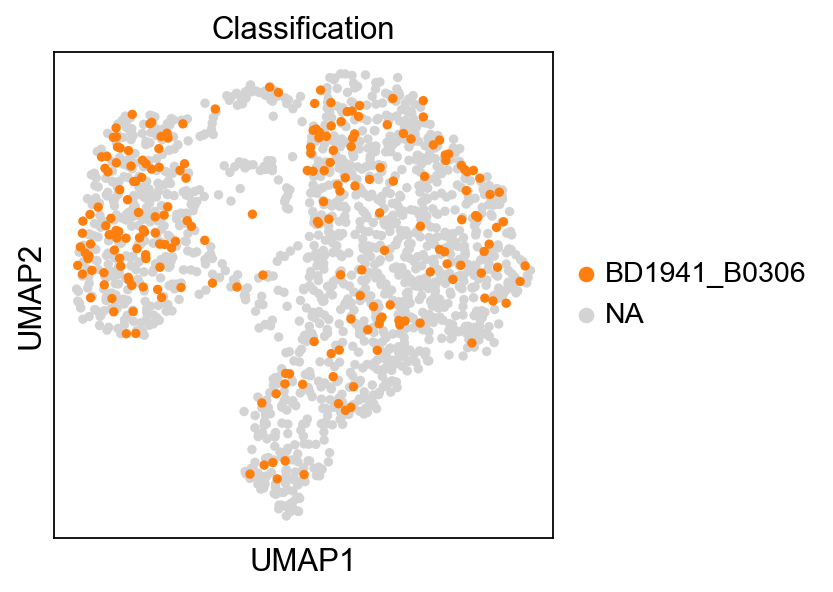

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


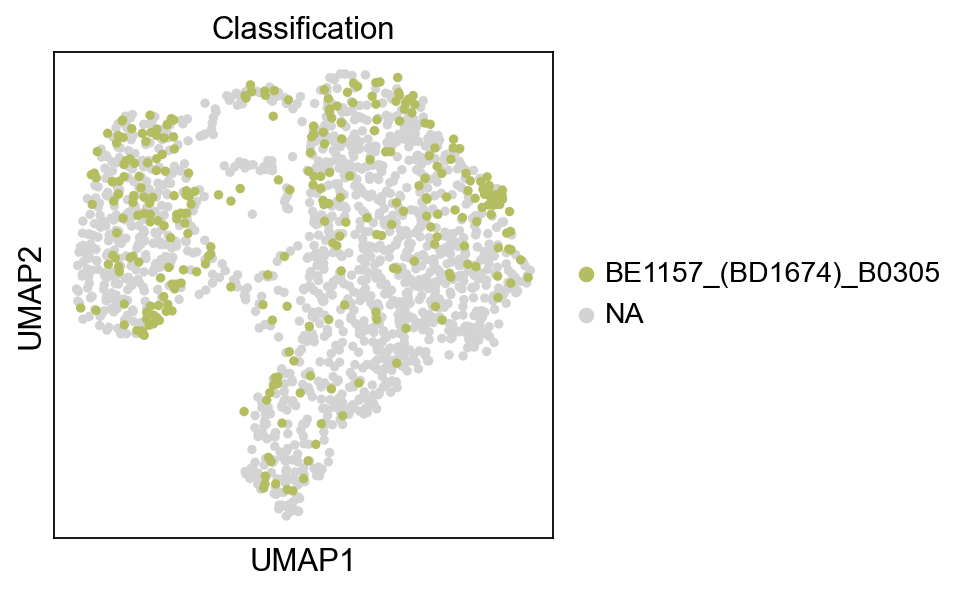

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


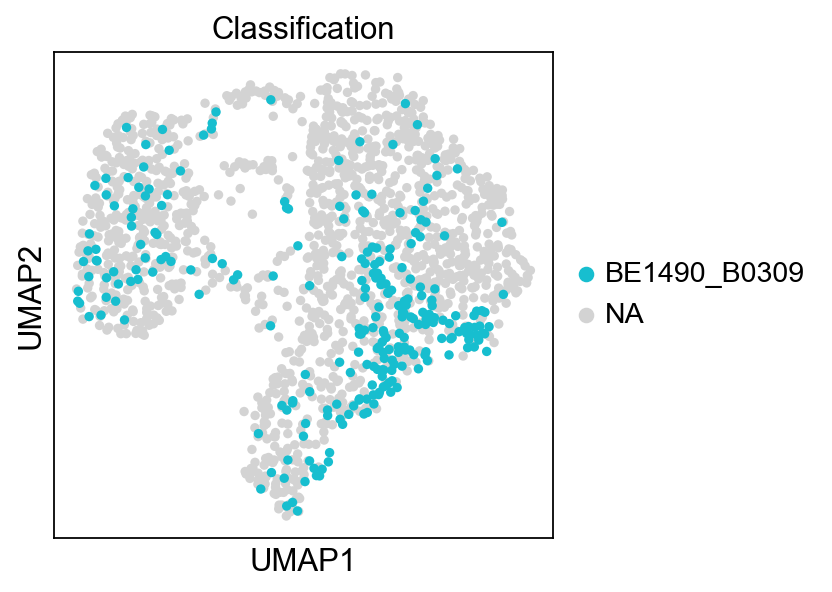

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


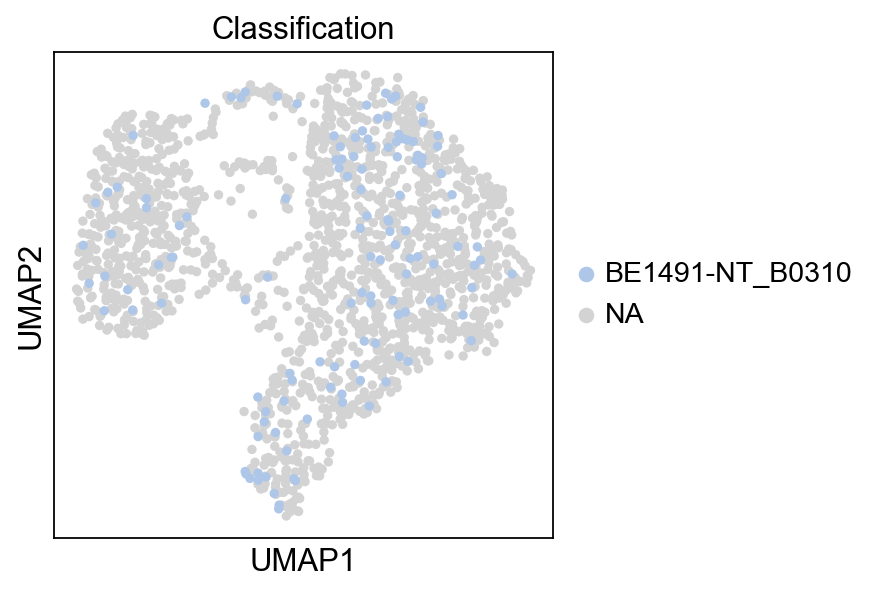

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


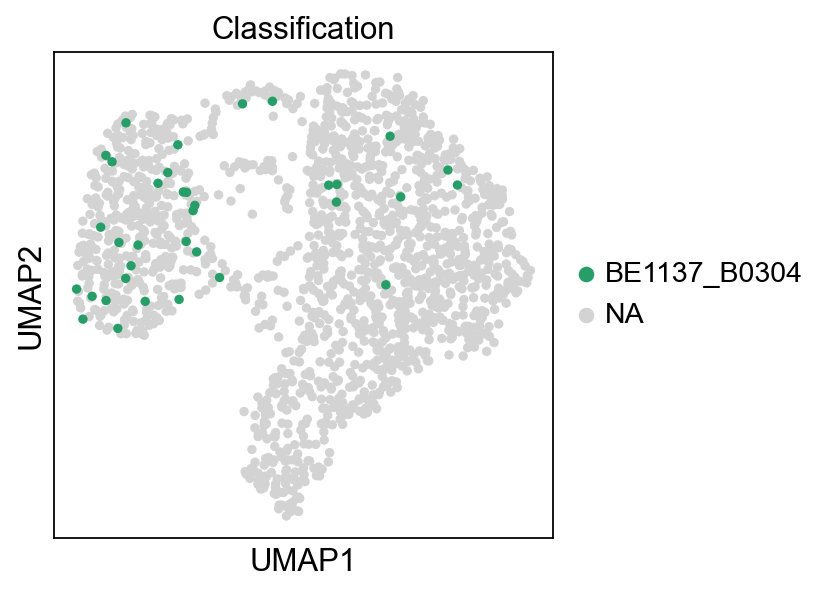

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


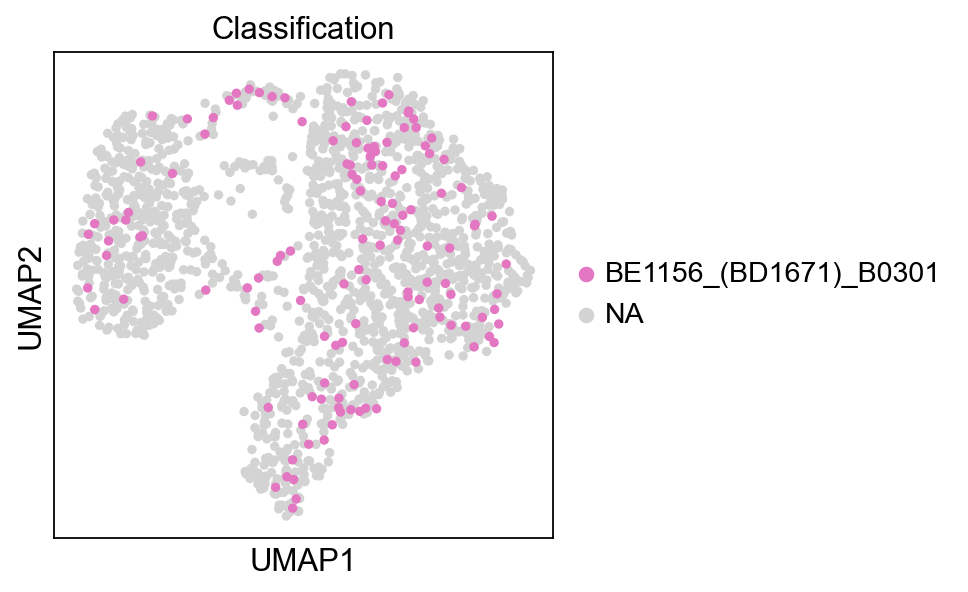

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


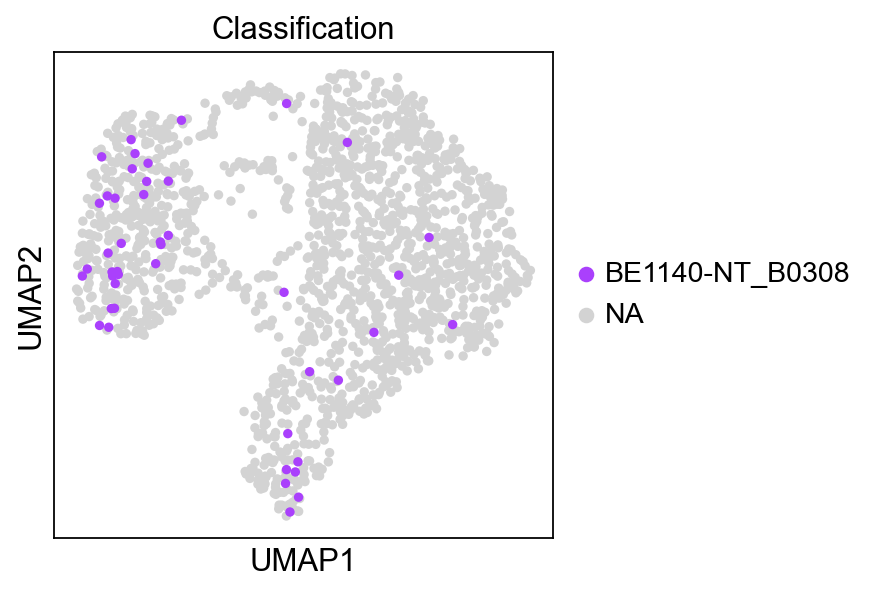

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


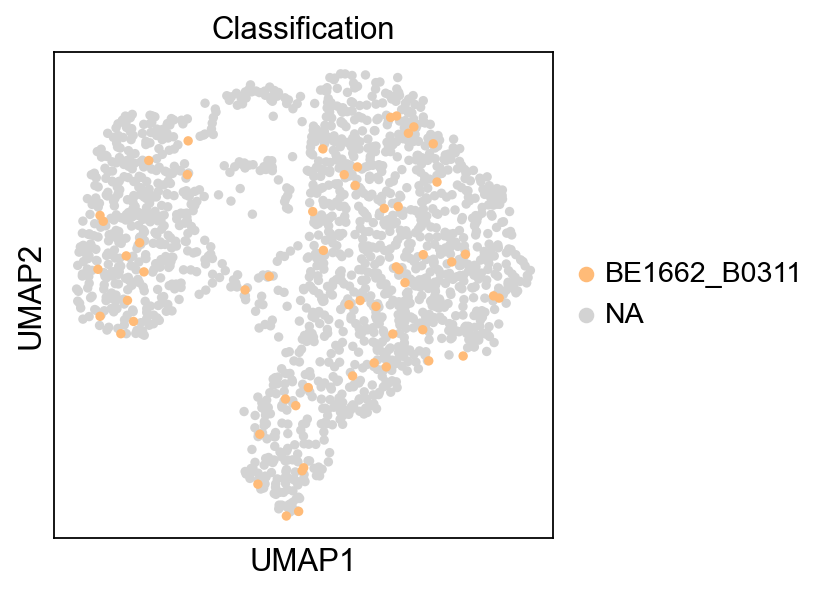

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


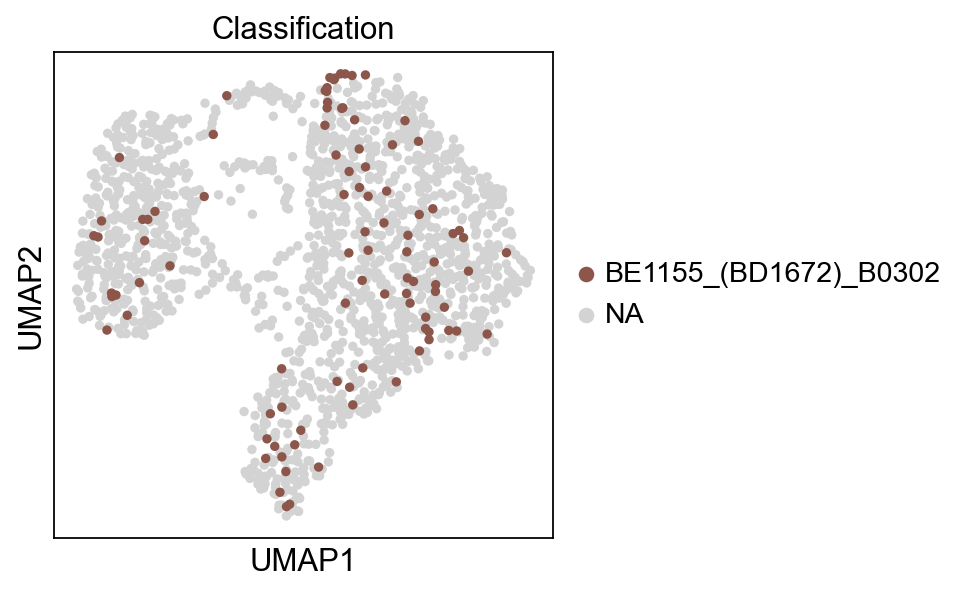

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


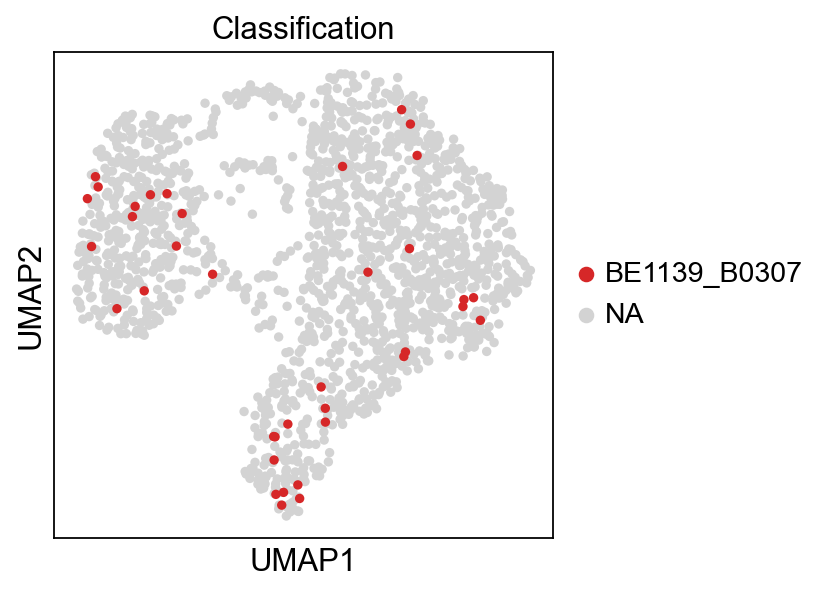

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


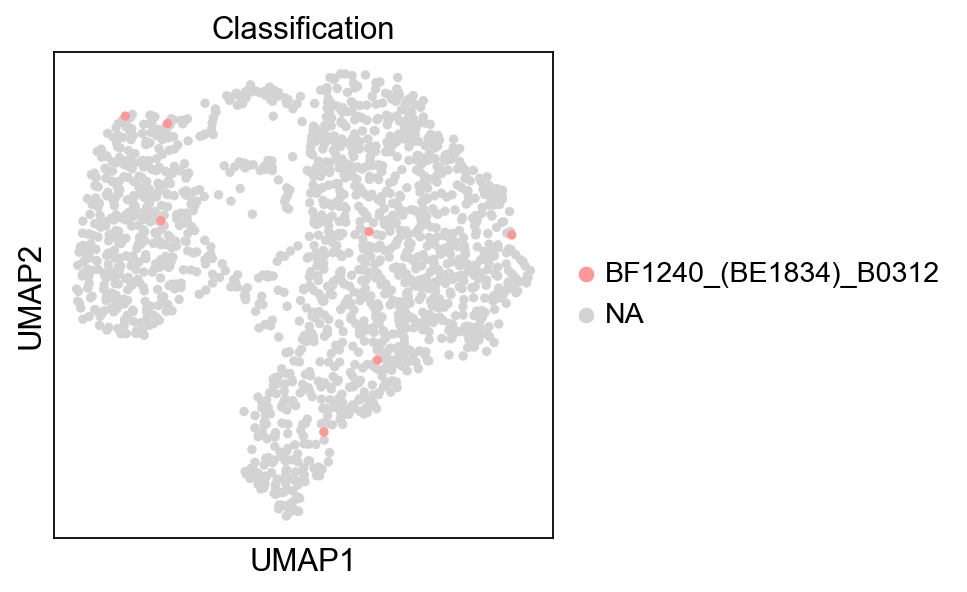

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


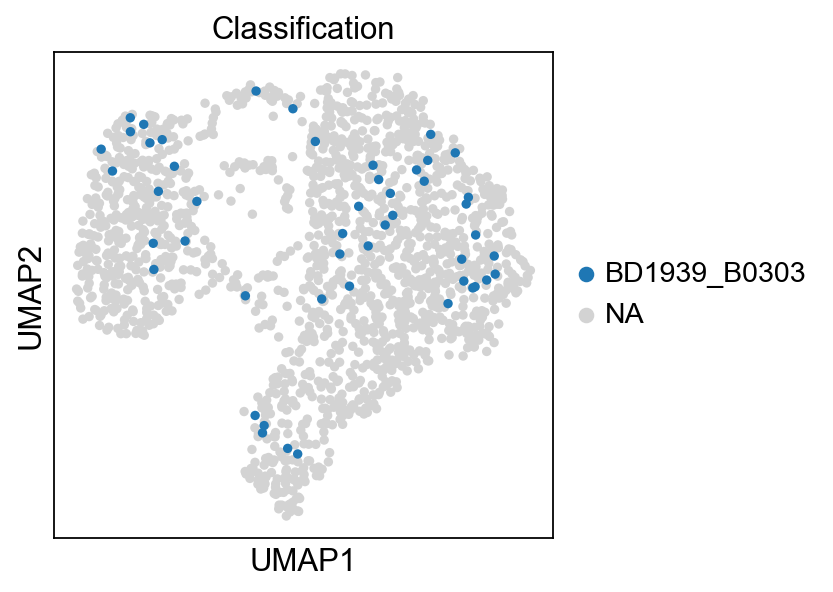

In [205]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [206]:
samples

['BE1156_(BD1671)_B0301',
 'BE1155_(BD1672)_B0302',
 'BD1939_B0303',
 'BE1137_B0304',
 'BE1157_(BD1674)_B0305',
 'BD1941_B0306',
 'BE1139_B0307',
 'BE1140-NT_B0308',
 'BE1490_B0309',
 'BE1491-NT_B0310',
 'BE1662_B0311',
 'BF1240_(BE1834)_B0312',
 'BF1087_B0313']

In [207]:
sc.tl.embedding_density(adata,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


In [208]:
adata.obs.Group.value_counts()

Group
shRela       586
shRel        440
shRenilla    333
shNfkb1      314
Name: count, dtype: int64

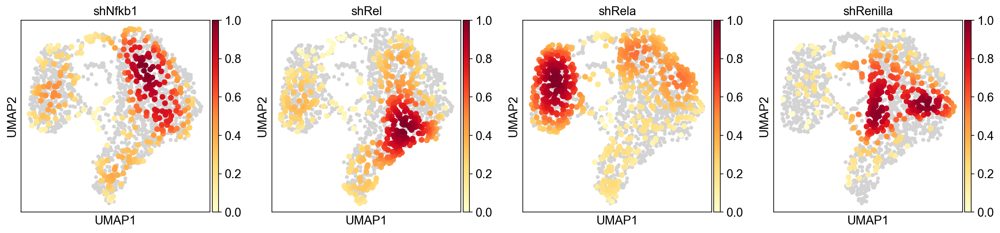

In [209]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Group', )

In [210]:
#sc.tl.embedding_density(adata,basis='umap', groupby='clusterK12')

In [211]:
#sc.pl.embedding_density(adata,basis='umap',key='umap_density_clusterK12')

In [212]:
adata.obs[['Group', 'clusterK12']].value_counts()

Group      clusterK12
shRela     09            201
           05            119
shRel      01            110
           05            109
shRenilla  01             81
shRela     03             77
shRel      09             73
shNfkb1    05             72
shRenilla  03             70
shRela     01             64
shNfkb1    09             58
shRel      03             52
shNfkb1    01             52
shRela     02             51
shRenilla  05             50
shNfkb1    02             39
shRenilla  08             38
shRela     04             36
shRel      04             36
shNfkb1    03             35
shRenilla  04             32
           09             31
shRela     08             28
shRel      02             26
shNfkb1    04             26
           08             24
shRel      08             21
shRenilla  02             18
shRel      06              6
shNfkb1    10              5
shRela     10              4
shRenilla  06              4
shRel      07              4
shNfkb1    07        

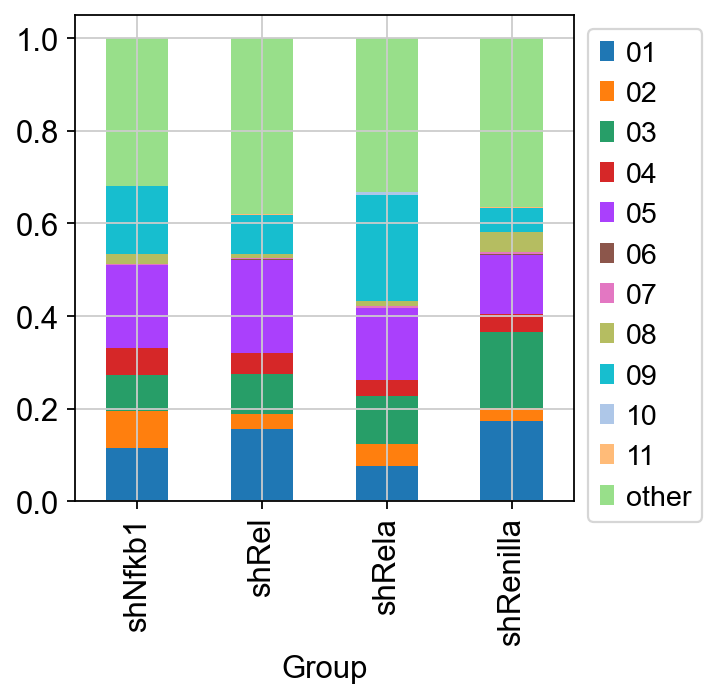

In [213]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [214]:
adata.obs.Group.value_counts(sort=False)

Group
shNfkb1      314
shRel        440
shRela       586
shRenilla    333
Name: count, dtype: int64

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/s

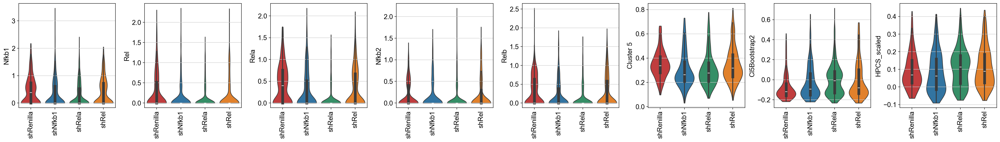

In [215]:
sc.pl.violin(adata, ['Nfkb1','Rel','Rela','Nfkb2','Relb','Cluster 5','Cl5Bootstrap2','HPCS_scaled'], 
             groupby='Group',rotation=90,inner='box',stripplot=False,order=['shRenilla','shNfkb1','shRela','shRel'])

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/s

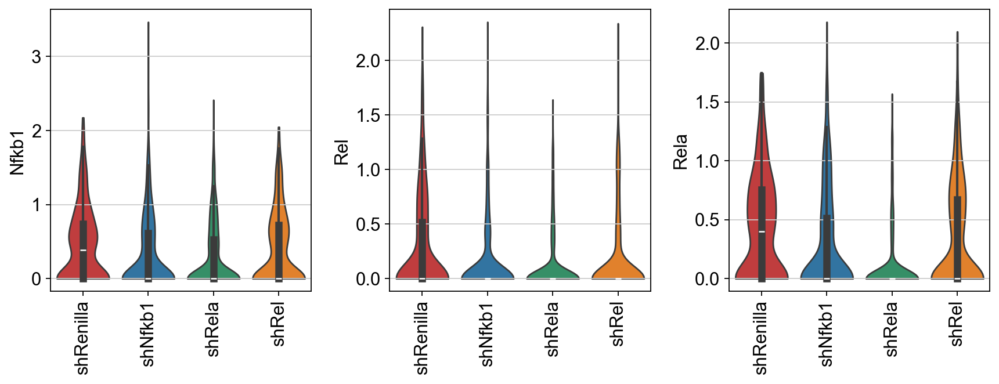

In [216]:
sc.pl.violin(adata, ['Nfkb1','Rel','Rela'], 
             groupby='Group',rotation=90,inner='box',stripplot=False,order=['shRenilla','shNfkb1','shRela','shRel'])

## Determine if variance is equivalent between groups

In [217]:
import scipy

In [218]:
scipy.stats.bartlett(*[adata.raw.to_adata()[:,[x]].X.todense() for x in ['Nfkb1', 'Rela', 'Rel']])

BartlettResult(statistic=array([156.81512897]), pvalue=array([8.87211996e-35]))

## Run Welch's Anova Variant

In [219]:
import pingouin as pg

In [220]:
adata2 = adata.raw.to_adata()[:,['Nfkb1','Rela','Rel']]

In [221]:
for x in ['Nfkb1','Rela','Rel']:
    adata2.obs[x] = adata2[:,x].X.todense()
    print(x)
    print(pg.welch_anova(dv=x,between='Group',data=adata2.obs))

Nfkb1
  Source  ddof1       ddof2          F         p-unc       np2
0  Group      3  814.792542  10.565694  8.039131e-07  0.018444
Rela
  Source  ddof1       ddof2          F         p-unc      np2
0  Group      3  744.075316  75.836585  8.300218e-43  0.09622
Rel
  Source  ddof1       ddof2          F         p-unc       np2
0  Group      3  778.948173  14.886048  1.972416e-09  0.031875


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/4174726234.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2.obs[x] = adata2[:,x].X.todense()


## Now Identify all populations against the control that is significant

In [222]:
b = pg.pairwise_gameshowell(dv='Nfkb1',between='Group',data=adata2.obs)

In [223]:
b[b.B.isin(['shRenilla'])]

,A,B,mean(A),mean(B),diff,se,T,df,pval,hedges
2,shNfkb1,shRenilla,0.322998,0.451733,-0.128734,0.040057,-3.213805,643.964078,0.007498,-0.252371
4,shRel,shRenilla,0.411237,0.451733,-0.040495,0.037114,-1.091089,709.633400,0.695115,-0.079331
5,shRela,shRenilla,0.287481,0.451733,-0.164251,0.033701,-4.873736,614.977480,0.000008,-0.347098


In [224]:
b = pg.pairwise_gameshowell(dv='Rela',between='Group',data=adata2.obs)

In [225]:
b[b.B.isin(['shRenilla'])]

,A,B,mean(A),mean(B),diff,se,T,df,pval,hedges
2,shNfkb1,shRenilla,0.299007,0.428355,-0.129348,0.035331,-3.661085,643.472659,0.001546,-0.287568
4,shRel,shRenilla,0.350553,0.428355,-0.077802,0.032922,-2.363203,718.283232,0.085230,-0.171267
5,shRela,shRenilla,0.102278,0.428355,-0.326078,0.027064,-12.048514,465.153543,0.000000,-0.945347


In [226]:
b = pg.pairwise_gameshowell(dv='Rel',between='Group',data=adata2.obs)

In [227]:
b[b.B.isin(['shRenilla'])]

,A,B,mean(A),mean(B),diff,se,T,df,pval,hedges
2,shNfkb1,shRenilla,0.145411,0.292331,-0.146919,0.031546,-4.657251,616.462923,2.327578e-05,-0.363008
4,shRel,shRenilla,0.176521,0.292331,-0.115810,0.030742,-3.767201,639.386110,1.033182e-03,-0.280262
5,shRela,shRenilla,0.114327,0.292331,-0.178003,0.027360,-6.506028,473.404514,1.179631e-09,-0.507138


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


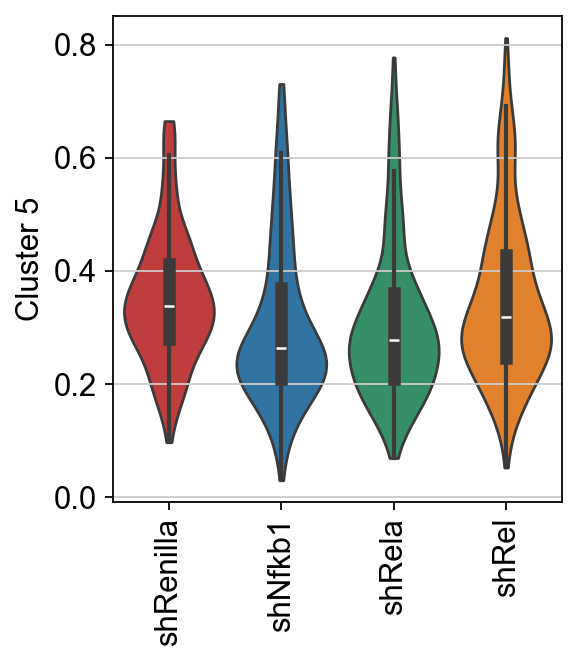

In [343]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
sc.pl.violin(adata, ['Cluster 5',], save='HPCS.pdf',
             groupby='Group',rotation=90,inner='box',stripplot=False,order=['shRenilla','shNfkb1','shRela','shRel'])

## Determine if variance is equivalent between groups - HPCS

In [229]:
import scipy

In [230]:
adata.obs.Group.cat.categories

Index(['shNfkb1', 'shRel', 'shRela', 'shRenilla'], dtype='object')

In [231]:
scipy.stats.bartlett(*[adata.obs['Cluster 5'][adata.obs.Group.isin([x])] for x in ['shRenilla', 'shNfkb1', 'shRela', 'shRel']])

BartlettResult(statistic=19.848053371862946, pvalue=0.00018250494162529187)

## Run Welch's Anova Variant

In [232]:
import pingouin as pg

In [233]:
print(pg.welch_anova(dv='Cluster 5',between='Group',data=adata.obs))

  Source  ddof1       ddof2         F         p-unc       np2
0  Group      3  840.607005  15.92941  4.425280e-10  0.026613


## Now Identify all populations against the control that is significant

In [234]:
b = pg.pairwise_gameshowell(dv='Cluster 5',between='Group',data=adata.obs)

In [235]:
b[b.B.isin(['shRenilla'])]

,A,B,mean(A),mean(B),diff,se,T,df,pval,hedges
2,shNfkb1,shRenilla,0.303457,0.350694,-0.047237,0.010130,-4.663024,603.743760,2.275085e-05,-0.368580
4,shRel,shRenilla,0.347051,0.350694,-0.003643,0.009253,-0.393771,768.221563,9.792857e-01,-0.027733
5,shRela,shRenilla,0.304676,0.350694,-0.046018,0.008378,-5.492462,782.298586,3.208249e-07,-0.360590


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

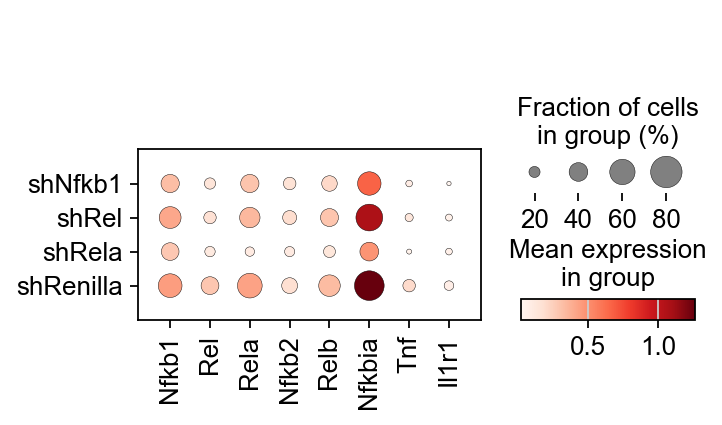

In [236]:
sc.pl.dotplot(adata, ['Nfkb1','Rel','Rela','Nfkb2','Relb','Nfkbia','Tnf','Il1r1'], groupby='Group') #'Il1b'

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


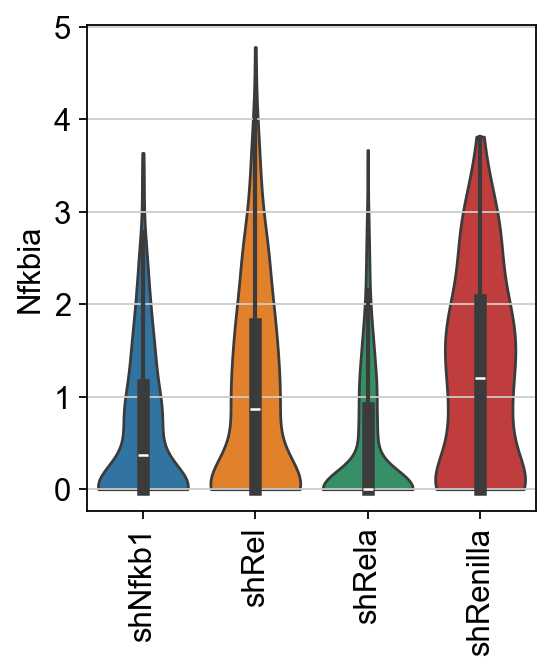

In [237]:
sc.pl.violin(adata, ['Nfkbia'],groupby='Group', rotation=90, stripplot=False, inner='box')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


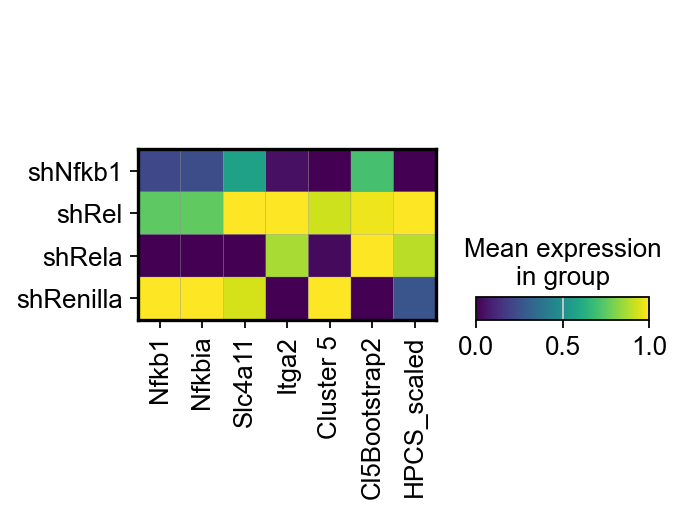

In [238]:
sc.pl.matrixplot(adata, ['Nfkb1','Nfkbia','Slc4a11','Itga2','Cluster 5','Cl5Bootstrap2','HPCS_scaled'], groupby='Group', standard_scale='var')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

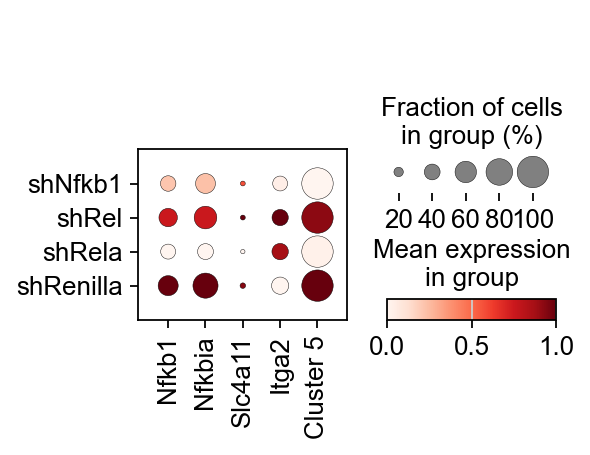

In [239]:
sc.pl.dotplot(adata, ['Nfkb1','Nfkbia','Slc4a11','Itga2','Cluster 5'], groupby='Group', standard_scale='var')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

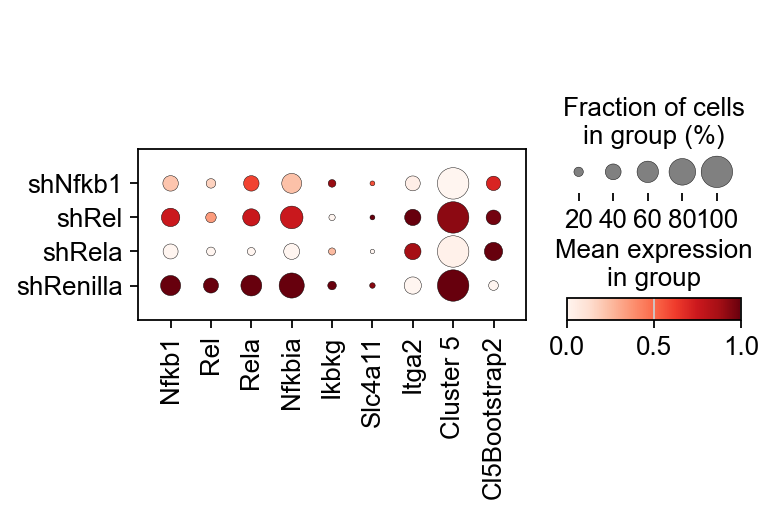

In [240]:
sc.pl.dotplot(adata, ['Nfkb1','Rel','Rela','Nfkbia','Ikbkg','Slc4a11','Itga2','Cluster 5','Cl5Bootstrap2'], groupby='Group', standard_scale='var')

In [241]:
adata.obs.Group.value_counts()

Group
shRela       586
shRel        440
shRenilla    333
shNfkb1      314
Name: count, dtype: int64

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/s

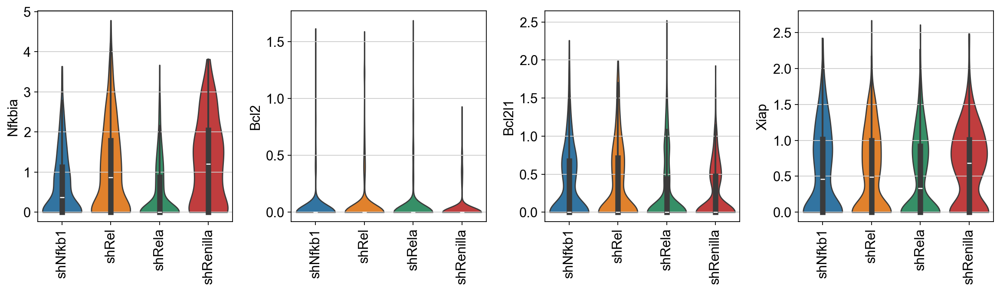

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/s

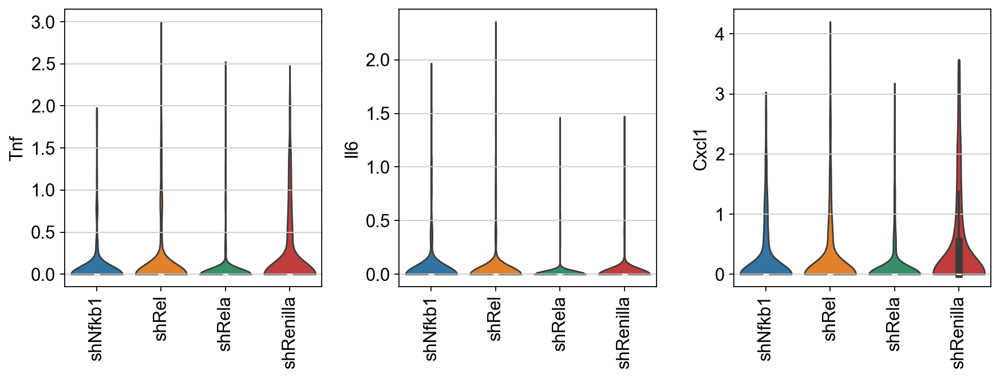

In [242]:
nfkbgenes = ['Nfkbia', 'Bcl2', 'Bcl2l1','Xiap', ]
inflammatory = ['Tnf', 'Il6', 'Cxcl1', 'Il6']

sc.pl.violin(adata, nfkbgenes, groupby='Group', inner='box',stripplot=False,rotation=90)
sc.pl.violin(adata, inflammatory, groupby='Group', inner='box',stripplot=False, rotation=90)

computing score 'Rela5down'
    finished: added
    'Rela5down', score of gene set (adata.obs).
    3424 total control genes are used. (0:00:00)


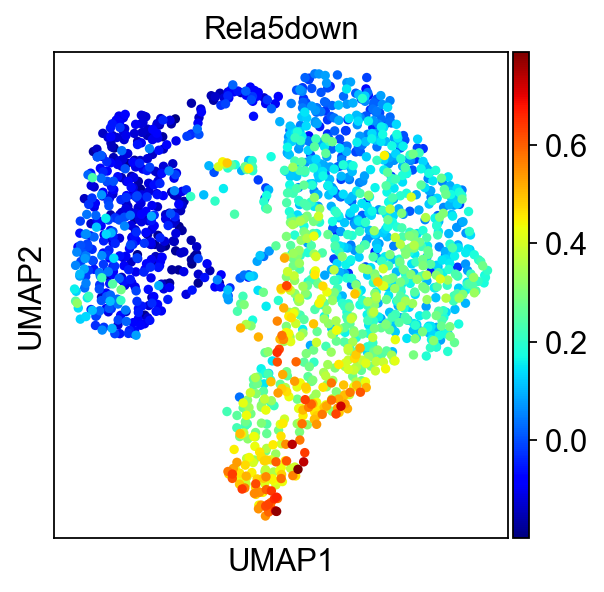

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Pa

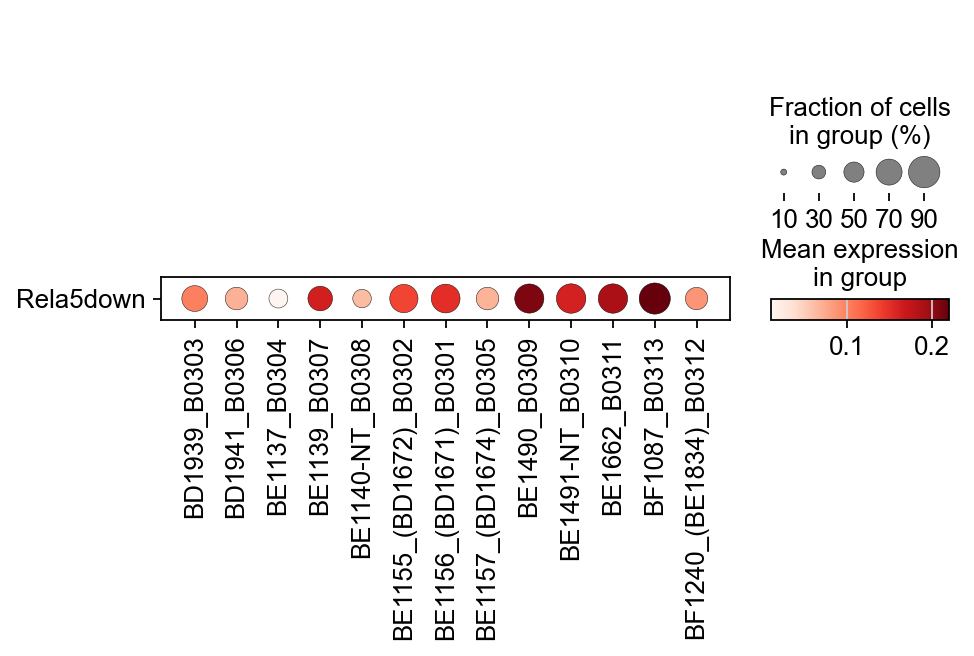

In [243]:
(clusters, clusterkeys, HPCS) = resetClusters('Nfkb')
scoreAndPlot(adata, numgenes=500)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/s

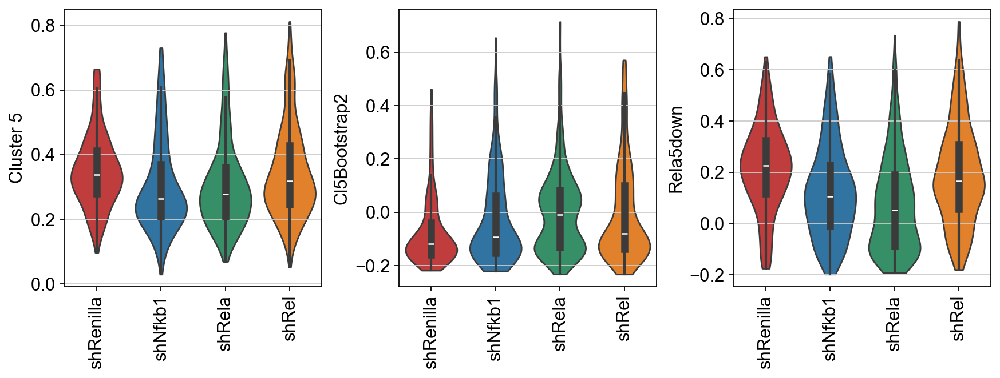

In [244]:
sc.pl.violin(adata, ['Cluster 5','Cl5Bootstrap2','Rela5down'], groupby='Group', inner='box', stripplot=False, 
             order=['shRenilla','shNfkb1','shRela','shRel'],rotation=90)

## Annotate with EnrichR

In [245]:
adata4 = adata

ranking genes


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return 

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


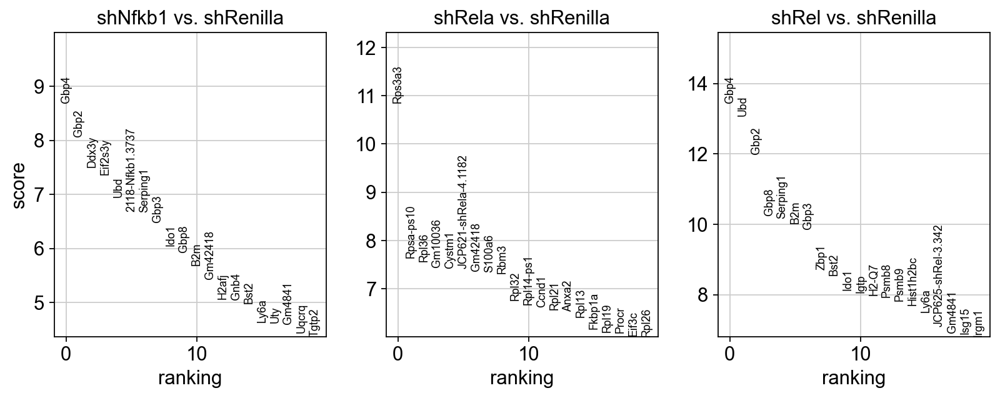

    using 'X_pca' with n_pcs = 150
Storing dendrogram info using `.uns['dendrogram_Group']`
categories: shNfkb1, shRel, shRela, etc.
var_group_labels: shNfkb1, shRela, shRel


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future vers

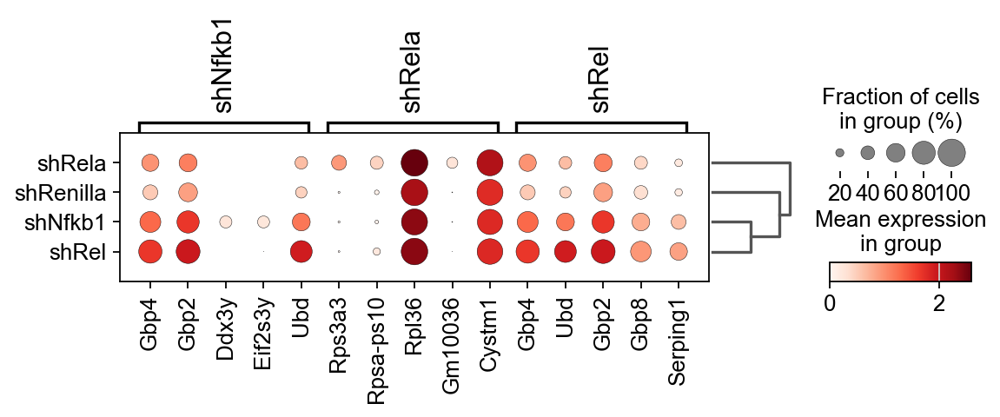

In [246]:
sc.tl.rank_genes_groups(adata4, 'Group', groups=['shNfkb1','shRela','shRel'], reference='shRenilla', method='wilcoxon')
sc.pl.rank_genes_groups(adata4, n_genes=20, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata4, n_genes=5, groupby="Group")

In [247]:
# get deg result
result = adata4.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores', 'pvals_adj','logfoldchanges']})
degs.to_excel('enriched_genes.xlsx')

In [248]:
import gseapy
#Available databases : ‘Human’, ‘Mouse’, ‘Yeast’, ‘Fly’, ‘Fish’, ‘Worm’ 
gene_set_names = gseapy.get_library_name(organism='Mouse')
print(gene_set_names)
#gsets = 'Descartes_Cell_Types_and_Tissue_2021'
#gsets = 'Tabula_Muris'
gsets = 'MSigDB_Hallmark_2020'
#gsets = 'The_Kinase_Library_2023'
#gsets = 'TF_Perturbations_Followed_by_Expression'

['ARCHS4_Cell-lines', 'ARCHS4_IDG_Coexp', 'ARCHS4_Kinases_Coexp', 'ARCHS4_TFs_Coexp', 'ARCHS4_Tissues', 'Achilles_fitness_decrease', 'Achilles_fitness_increase', 'Aging_Perturbations_from_GEO_down', 'Aging_Perturbations_from_GEO_up', 'Allen_Brain_Atlas_10x_scRNA_2021', 'Allen_Brain_Atlas_down', 'Allen_Brain_Atlas_up', 'Azimuth_2023', 'Azimuth_Cell_Types_2021', 'BioCarta_2013', 'BioCarta_2015', 'BioCarta_2016', 'BioPlanet_2019', 'BioPlex_2017', 'CCLE_Proteomics_2020', 'CORUM', 'COVID-19_Related_Gene_Sets', 'COVID-19_Related_Gene_Sets_2021', 'Cancer_Cell_Line_Encyclopedia', 'CellMarker_Augmented_2021', 'ChEA_2013', 'ChEA_2015', 'ChEA_2016', 'ChEA_2022', 'Chromosome_Location', 'Chromosome_Location_hg19', 'ClinVar_2019', 'DSigDB', 'Data_Acquisition_Method_Most_Popular_Genes', 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019', 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019', 'Descartes_Cell_Types_and_Tissue_2021', 'Diabetes_Perturbations_GEO_2022', 'DisGeNET', 'Disease_Perturbations_from_GEO

In [249]:
degs_sig = degs[degs.shNfkb1_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.shNfkb1_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.shNfkb1_logfoldchanges < 0]

In [250]:
enr_res0up = gseapy.enrichr(gene_list=degs_up.shNfkb1_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0up.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,Interferon Gamma Response,15/200,6.102935e-17,1.525734e-15,0,0,32.682295,1220.199245,ZBP1;RTP4;BATF2;TNFAIP2;PSMB8;PSMB9;IL18BP;BST...
1,MSigDB_Hallmark_2020,Interferon Alpha Response,9/97,2.245775e-11,2.807219e-10,0,0,36.907438,904.947689,BST2;RTP4;BATF2;LAP3;GBP2;B2M;GBP4;PSMB8;PSMB9
2,MSigDB_Hallmark_2020,Complement,4/200,3.861288e-03,3.217740e-02,0,0,6.714286,37.309637,GNB4;SERPING1;LAP3;PSMB9
3,MSigDB_Hallmark_2020,Androgen Response,2/100,4.083127e-02,2.551954e-01,0,0,6.529954,20.884798,CCND1;B2M
4,MSigDB_Hallmark_2020,Notch Signaling,1/32,9.755139e-02,3.055058e-01,0,0,10.192012,23.720644,CCND1
5,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,2/200,1.344226e-01,3.055058e-01,0,0,3.215705,6.453171,CCND1;TNFAIP2
6,MSigDB_Hallmark_2020,Myc Targets V1,2/200,1.344226e-01,3.055058e-01,0,0,3.215705,6.453171,RPL34;HSPE1
7,MSigDB_Hallmark_2020,Inflammatory Response,2/200,1.344226e-01,3.055058e-01,0,0,3.215705,6.453171,BST2;RTP4
8,MSigDB_Hallmark_2020,Oxidative Phosphorylation,2/200,1.344226e-01,3.055058e-01,0,0,3.215705,6.453171,UQCRQ;POLR2F
9,MSigDB_Hallmark_2020,p53 Pathway,2/200,1.344226e-01,3.055058e-01,0,0,3.215705,6.453171,HINT1;RPL36


In [251]:
enr_res0down = gseapy.enrichr(gene_list=degs_dw.shNfkb1_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,80/200,3.853183e-38,1.926591e-36,0,0,8.616034,742.265570,BTG2;CDKN1A;TNFAIP8;BTG1;B4GALT1;IRS2;AREG;SAT...
1,MSigDB_Hallmark_2020,p53 Pathway,56/200,1.949417e-18,4.873542e-17,0,0,4.936146,201.291092,APP;CDKN1A;BTG2;BTG1;CD82;CD81;IFI30;SAT1;IER5...
2,MSigDB_Hallmark_2020,TGF-beta Signaling,26/54,1.136677e-15,1.894462e-14,0,0,11.619725,399.842496,PPP1R15A;BMPR2;HDAC1;UBE2D3;ARID4B;THBS1;FNTA;...
3,MSigDB_Hallmark_2020,Apoptosis,44/161,2.301065e-14,2.876331e-13,0,0,4.741092,148.883670,APP;CDKN1A;BTG2;ROCK1;HSPB1;NEDD9;BCL10;CLU;SA...
4,MSigDB_Hallmark_2020,mTORC1 Signaling,47/200,1.313545e-12,1.313545e-11,0,0,3.873122,105.961993,PPP1R15A;GSK3B;RAB1A;CDKN1A;BTG2;FKBP2;TES;TFR...
5,MSigDB_Hallmark_2020,Hypoxia,46/200,5.099327e-12,4.249439e-11,0,0,3.763308,97.853209,PPP1R15A;ERRFI1;CDKN1A;TES;BTG1;SDC4;CITED2;PD...
6,MSigDB_Hallmark_2020,IL-2/STAT5 Signaling,44/199,5.928921e-11,4.234943e-10,0,0,3.571362,84.100543,BMPR2;CD81;RORA;AHR;SLC1A5;AGER;HK2;IGF1R;SOCS...
7,MSigDB_Hallmark_2020,Oxidative Phosphorylation,44/200,7.058380e-11,4.411487e-10,0,0,3.548275,82.938157,ACADVL;OAT;ACAA2;ALAS1;MGST3;MRPL34;UQCRH;TOMM...
8,MSigDB_Hallmark_2020,Estrogen Response Early,42/200,8.699014e-10,4.832785e-09,0,0,3.339171,69.663930,SLC26A2;B4GALT1;MINDY1;WWC1;SLC1A1;CELSR1;ADD3...
9,MSigDB_Hallmark_2020,Androgen Response,27/100,3.117986e-09,1.558993e-08,0,0,4.620153,90.490685,SLC26A2;TNFAIP8;B4GALT1;TMPRSS2;HMGCR;SAT1;MYL...


In [252]:
degs_sig = degs[degs.shRela_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.shRela_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.shRela_logfoldchanges < 0]

In [253]:
enr_res1up = gseapy.enrichr(gene_list=degs_up.shRela_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res1up.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,Myc Targets V1,21/200,2.991102e-15,1.256263e-13,0,0,12.108498,404.946111,CCT2;SLC25A3;RPL34;RPS5;RPL22;RPLP0;EIF2S2;RPL...
1,MSigDB_Hallmark_2020,Oxidative Phosphorylation,12/200,1.496462e-06,3.142571e-05,0,0,6.287074,84.324789,COX7B;SLC25A3;NDUFA7;MDH2;UQCRQ;COX4I1;COX17;C...
2,MSigDB_Hallmark_2020,p53 Pathway,10/200,5.441529e-05,7.618140e-04,0,0,5.131972,50.390140,PROCR;HINT1;PERP;RPL36;RACK1;UPP1;RPL18;CTSD;R...
3,MSigDB_Hallmark_2020,Adipogenesis,8/200,1.316268e-03,9.213875e-03,0,0,4.022373,26.680217,COX7B;MDH2;UQCRQ;EPHX2;CMPK1;UQCR11;GHITM;ALDOA
4,MSigDB_Hallmark_2020,Complement,8/200,1.316268e-03,9.213875e-03,0,0,4.022373,26.680217,LGALS3;SERPINB2;CTSL;ANXA5;PLAUR;PFN1;CTSD;F3
5,MSigDB_Hallmark_2020,mTORC1 Signaling,8/200,1.316268e-03,9.213875e-03,0,0,4.022373,26.680217,ACTR2;PRDX1;PDAP1;PHGDH;ALDOA;EIF2S2;PPIA;GAPDH
6,MSigDB_Hallmark_2020,Androgen Response,5/100,4.172638e-03,2.503583e-02,0,0,5.031681,27.569621,TPD52;CCND1;ABHD2;KRT8;B2M
7,MSigDB_Hallmark_2020,Hypoxia,7/200,5.431538e-03,2.851558e-02,0,0,3.483999,18.170910,TPD52;PRDX5;ANXA2;PLAUR;ALDOA;F3;GAPDH
8,MSigDB_Hallmark_2020,Cholesterol Homeostasis,4/74,7.792154e-03,3.636338e-02,0,0,5.443478,26.426116,LGALS3;ANXA5;PLAUR;S100A11
9,MSigDB_Hallmark_2020,Estrogen Response Early,6/200,1.962573e-02,7.493462e-02,0,0,2.956248,11.620757,LAD1;KRT18;CCND1;ABHD2;MYOF;KRT8


In [254]:
enr_res1down = gseapy.enrichr(gene_list=degs_dw.shRela_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res1down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,117/200,2.660780e-42,1.330390e-40,0,0,7.507564,718.698743,SERPINE1;RNF19B;IRS2;TNF;SAT1;ETS2;ICAM1;ZFP36...
1,MSigDB_Hallmark_2020,TGF-beta Signaling,35/54,1.447190e-15,3.617975e-14,0,0,9.597070,327.923758,PPP1R15A;BMPR2;SERPINE1;UBE2D3;XIAP;ARID4B;FUR...
2,MSigDB_Hallmark_2020,p53 Pathway,78/200,7.306525e-15,1.217754e-13,0,0,3.355296,109.214928,APP;CDKN1A;BTG2;BTG1;CD81;RNF19B;TRIAP1;IFI30;...
3,MSigDB_Hallmark_2020,Interferon Gamma Response,74/200,8.168557e-13,1.021070e-11,0,0,3.077549,85.658392,IFITM3;OGFR;LGALS3BP;RTP4;CDKN1A;SAMD9L;CIITA;...
4,MSigDB_Hallmark_2020,Hypoxia,70/200,6.489010e-11,6.489010e-10,0,0,2.817389,66.091239,ERRFI1;CDKN1A;BTG1;CDKN1B;CITED2;SERPINE1;SLC2...
5,MSigDB_Hallmark_2020,IL-2/STAT5 Signaling,69/199,1.425858e-10,1.188215e-09,0,0,2.776267,62.940966,IFITM3;NRP1;BMPR2;CD81;CTSZ;RORA;AHR;HK2;IGF1R...
6,MSigDB_Hallmark_2020,Estrogen Response Early,68/200,5.077260e-10,3.626614e-09,0,0,2.693405,57.641766,CLIC3;B4GALT1;MAST4;WWC1;HSPB8;SLC2A1;CELSR1;A...
7,MSigDB_Hallmark_2020,Apoptosis,58/161,7.771409e-10,4.857131e-09,0,0,2.940021,61.668123,IFITM3;APP;BTG3;CDKN1A;BTG2;CDKN1B;HMGB2;HSPB1...
8,MSigDB_Hallmark_2020,UV Response Dn,53/144,1.714451e-09,9.524730e-09,0,0,3.038272,61.325013,PHF3;NRP1;CDKN1B;CITED2;CELF2;SERPINE1;PTEN;PT...
9,MSigDB_Hallmark_2020,G2-M Checkpoint,66/200,3.637627e-09,1.818813e-08,0,0,2.573240,50.003038,JPT1;CDKN1B;CCNT1;NUMA1;AMD1;HNRNPU;ARID4A;HMG...


In [255]:
degs_sig = degs[degs.shRel_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.shRel_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.shRel_logfoldchanges < 0]

In [256]:
enr_res2up = gseapy.enrichr(gene_list=degs_up.shRel_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res2up.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,Interferon Gamma Response,36/200,3.055690e-41,1.069491e-39,0,0,42.391679,3954.676605,RTP4;CD274;TNFAIP2;NLRC5;PSMB10;IFIT3;IL18BP;A...
1,MSigDB_Hallmark_2020,Interferon Alpha Response,20/97,2.502895e-24,4.380066e-23,0,0,43.550517,2366.735193,RTP4;BATF2;TAP1;TRAFD1;IFI44;ISG15;PARP14;IFIT...
2,MSigDB_Hallmark_2020,Complement,9/200,1.053341e-05,9.216735e-05,0,0,7.185316,82.350607,SERPINB2;IRF1;CASP4;GNB4;IRF7;SERPING1;LAP3;CT...
3,MSigDB_Hallmark_2020,Allograft Rejection,9/200,1.053341e-05,9.216735e-05,0,0,7.185316,82.350607,SOCS1;STAT1;TAP2;IRF7;TAP1;IRF8;GBP2;B2M;PSMB10
4,MSigDB_Hallmark_2020,Apoptosis,6/161,8.885591e-04,6.219913e-03,0,0,5.779179,40.603987,ISG20;KRT18;CCND1;IRF1;CASP4;TAP1
5,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,6/200,2.675095e-03,1.337547e-02,0,0,4.608247,27.298200,SERPINB2;CCND1;IRF1;NAMPT;TNFAIP2;TAP1
6,MSigDB_Hallmark_2020,p53 Pathway,6/200,2.675095e-03,1.337547e-02,0,0,4.608247,27.298200,SOCS1;RPL36;TAP1;TRAFD1;UPP1;CTSD
7,MSigDB_Hallmark_2020,Inflammatory Response,5/200,1.264672e-02,5.532942e-02,0,0,3.791594,16.570621,BST2;RTP4;IRF1;NAMPT;IRF7
8,MSigDB_Hallmark_2020,IL-6/JAK/STAT3 Signaling,3/87,2.236740e-02,8.698432e-02,0,0,5.232275,19.883435,SOCS1;STAT1;IRF1
9,MSigDB_Hallmark_2020,Reactive Oxygen Species Pathway,2/49,4.501626e-02,1.457799e-01,0,0,6.199937,19.224342,PDLIM1;SBNO2


In [257]:
enr_res2down = gseapy.enrichr(gene_list=degs_dw.shRel_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res2down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,Oxidative Phosphorylation,56/200,2.559081e-18,1.279541e-16,0,0,4.903207,198.613647,ACADVL;ACAA2;ALAS1;COX4I1;ETFA;MRPL34;COX6A1;A...
1,MSigDB_Hallmark_2020,Adipogenesis,44/200,8.560308e-11,1.755603e-09,0,0,3.524776,81.708886,RTN3;SLC27A1;ECHS1;ACAA2;ATL2;ARAF;SLC1A5;COX6...
2,MSigDB_Hallmark_2020,Fatty Acid Metabolism,38/158,1.053362e-10,1.755603e-09,0,0,3.948982,90.723369,ACADVL;ACAA2;ECHS1;MAOA;ECI2;HSD17B4;HSD17B10;...
3,MSigDB_Hallmark_2020,mTORC1 Signaling,40/200,1.123926e-08,1.404908e-07,0,0,3.115058,57.017559,GSK3B;RAB1A;FKBP2;TFRC;PSMD14;RPN1;UBE2D3;GMPS...
4,MSigDB_Hallmark_2020,Protein Secretion,25/96,2.951275e-08,2.951275e-07,0,0,4.364207,75.668553,COPB2;COPB1;CLTC;SNAP23;ATP1A1;CLCN3;RPS6KA3;L...
5,MSigDB_Hallmark_2020,Androgen Response,24/100,2.934810e-07,1.974007e-06,0,0,3.910310,58.816750,ABCC4;SLC26A2;B4GALT1;HMGCS1;HOMER2;XRCC5;TMEM...
6,MSigDB_Hallmark_2020,Estrogen Response Early,37/200,3.158411e-07,1.974007e-06,0,0,2.822177,42.242427,SLC26A2;B4GALT1;MINDY1;WWC1;SLC1A1;CELSR1;ADD3...
7,MSigDB_Hallmark_2020,p53 Pathway,37/200,3.158411e-07,1.974007e-06,0,0,2.822177,42.242427,APP;CEBPA;NOTCH1;HDAC3;CD81;EI24;PDGFA;IFI30;S...
8,MSigDB_Hallmark_2020,TGF-beta Signaling,16/54,1.395021e-06,7.750116e-06,0,0,5.196550,70.063010,BMPR2;IFNGR2;UBE2D3;ARID4B;TGFBR1;RHOA;SMAD7;H...
9,MSigDB_Hallmark_2020,Xenobiotic Metabolism,35/200,2.484595e-06,1.129361e-05,0,0,2.633407,33.985176,ENPEP;ALAS1;MAOA;PROS1;SLC1A5;CSAD;BPHL;ADH5;P...


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

<Axes: title={'center': 'MSigDB_Hallmark_2020 shRel Down'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

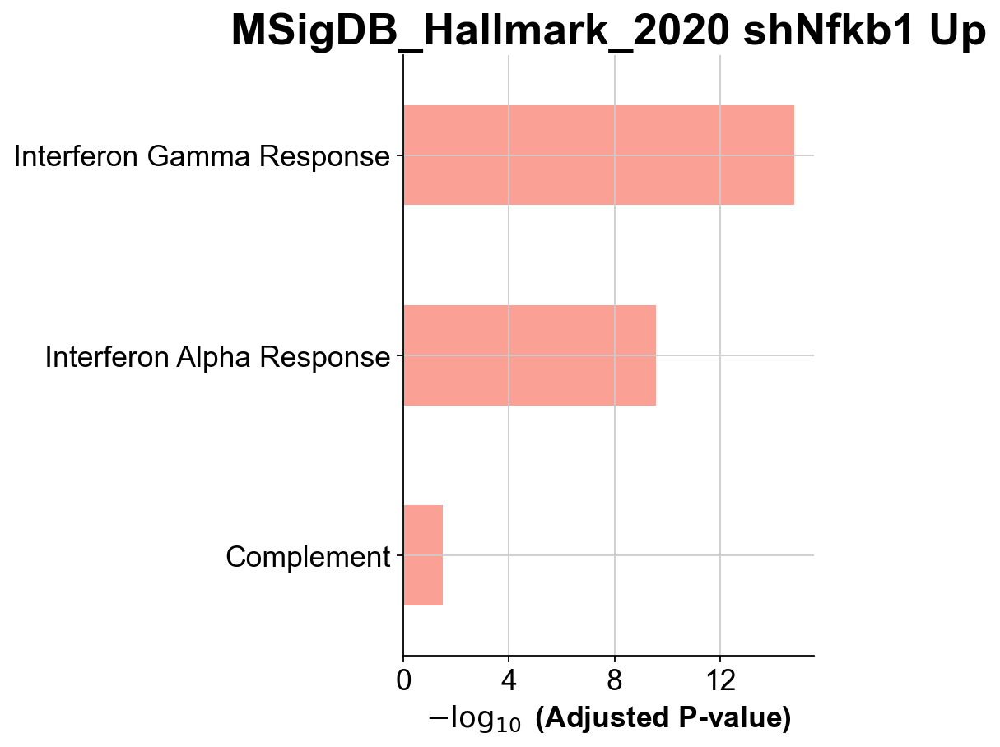

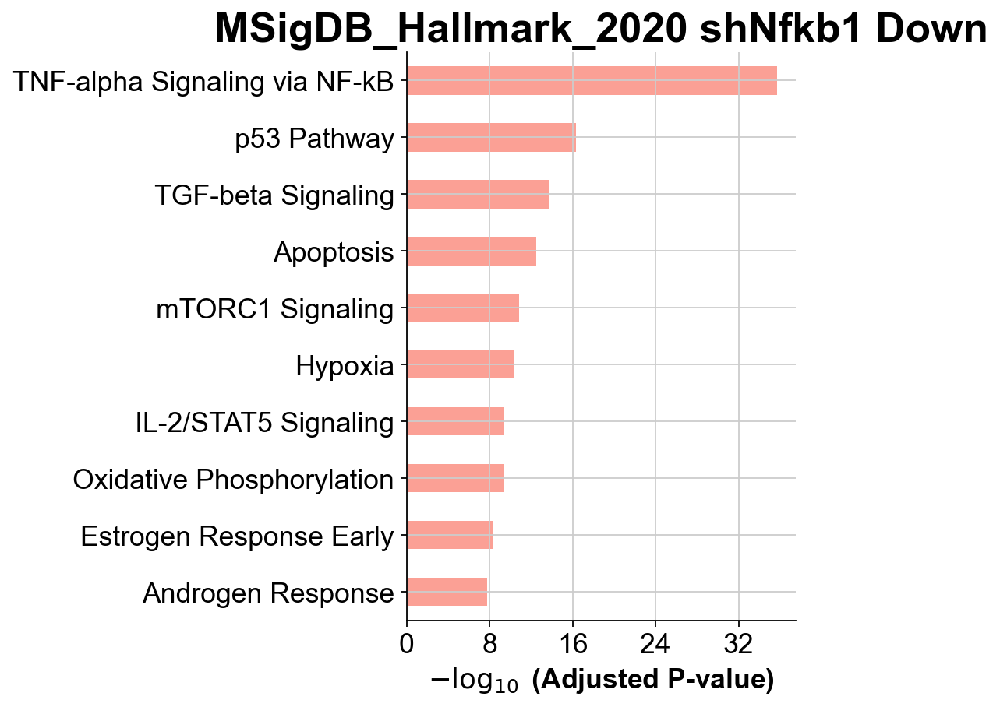

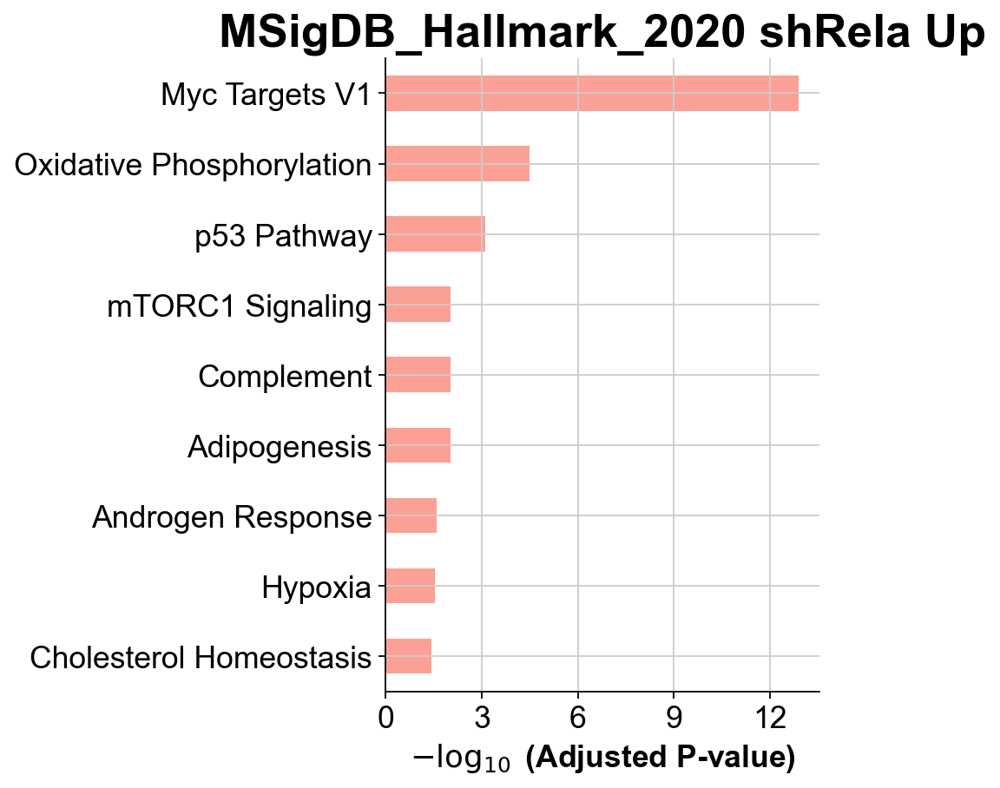

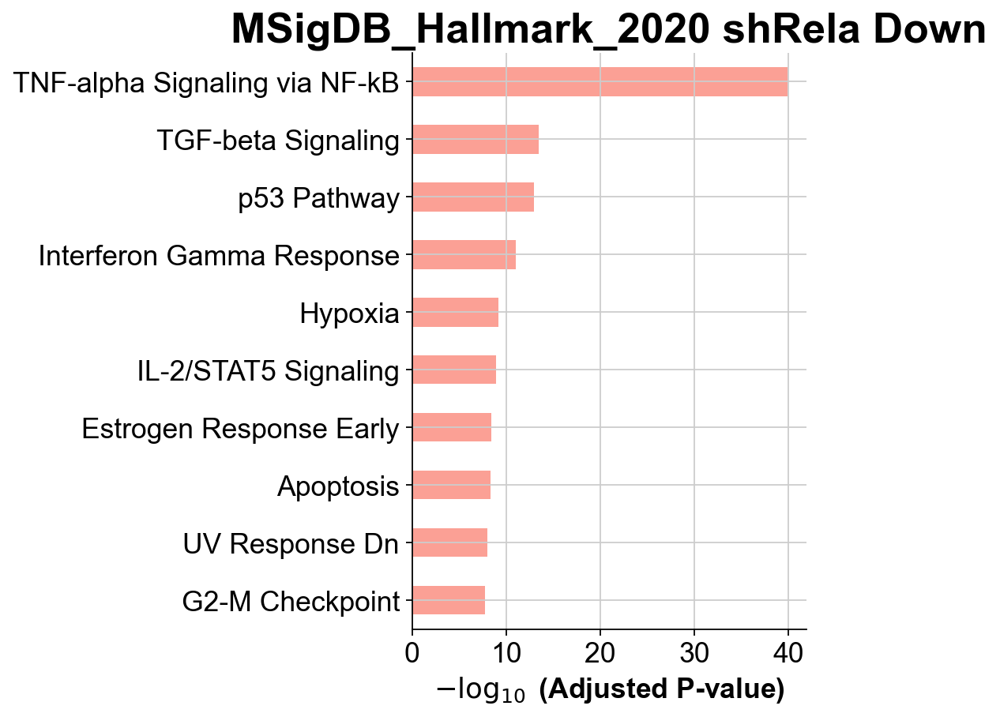

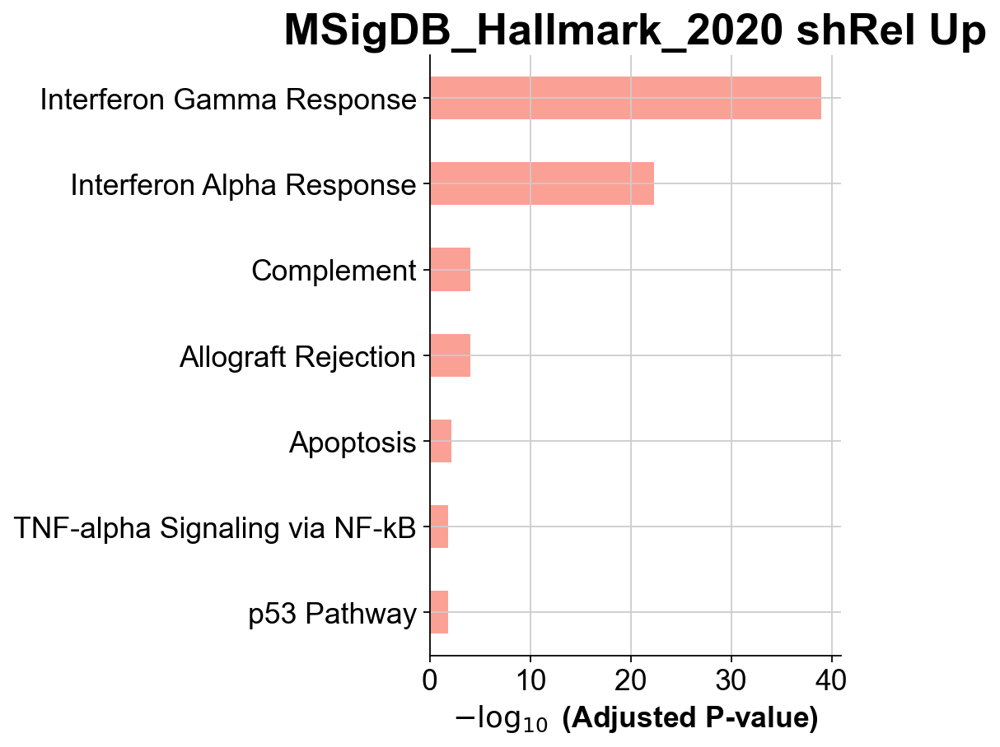

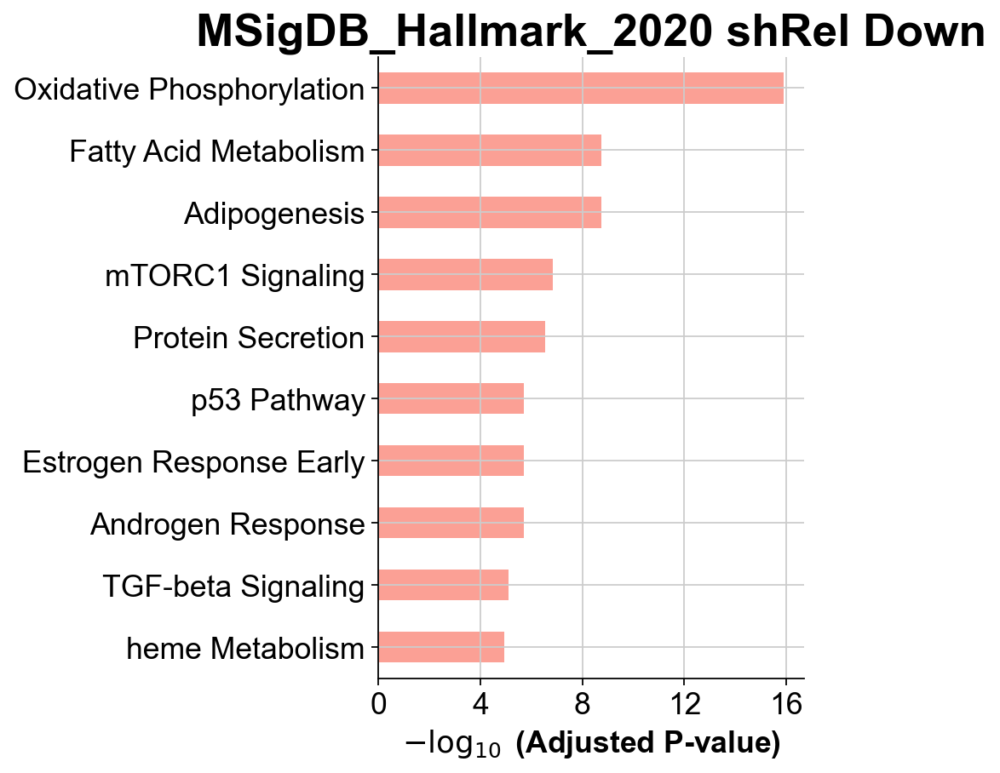

In [258]:
gseapy.barplot(enr_res0up.res2d,title="%s shNfkb1 Up" % gsets)
gseapy.barplot(enr_res0down.res2d,title="%s shNfkb1 Down" % gsets)
gseapy.barplot(enr_res1up.res2d,title="%s shRela Up" % gsets)
gseapy.barplot(enr_res1down.res2d,title="%s shRela Down" % gsets)
gseapy.barplot(enr_res2up.res2d,title="%s shRel Up" % gsets)
gseapy.barplot(enr_res2down.res2d,title="%s shRel Down" % gsets)
#gseapy.barplot(enr_res2.res2d,title="%s Cluster 2" % gsets)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

<Axes: title={'center': 'MSigDB_Hallmark_2020 shRel Down'}, xlabel='Combined Score'>

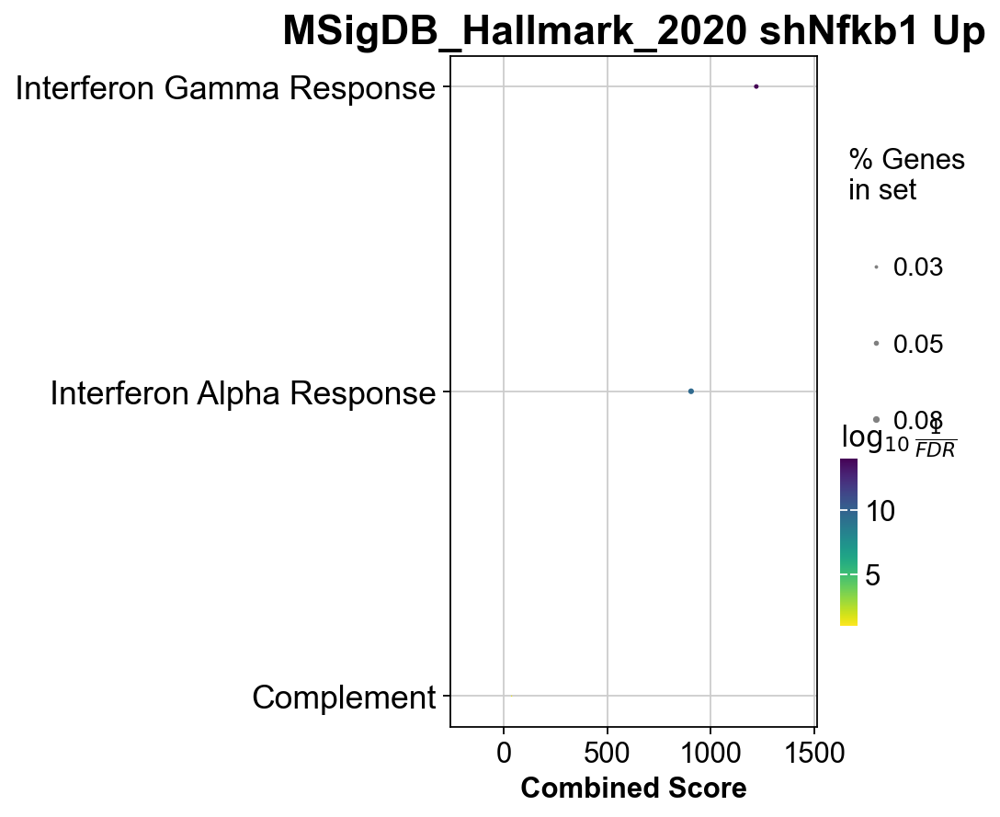

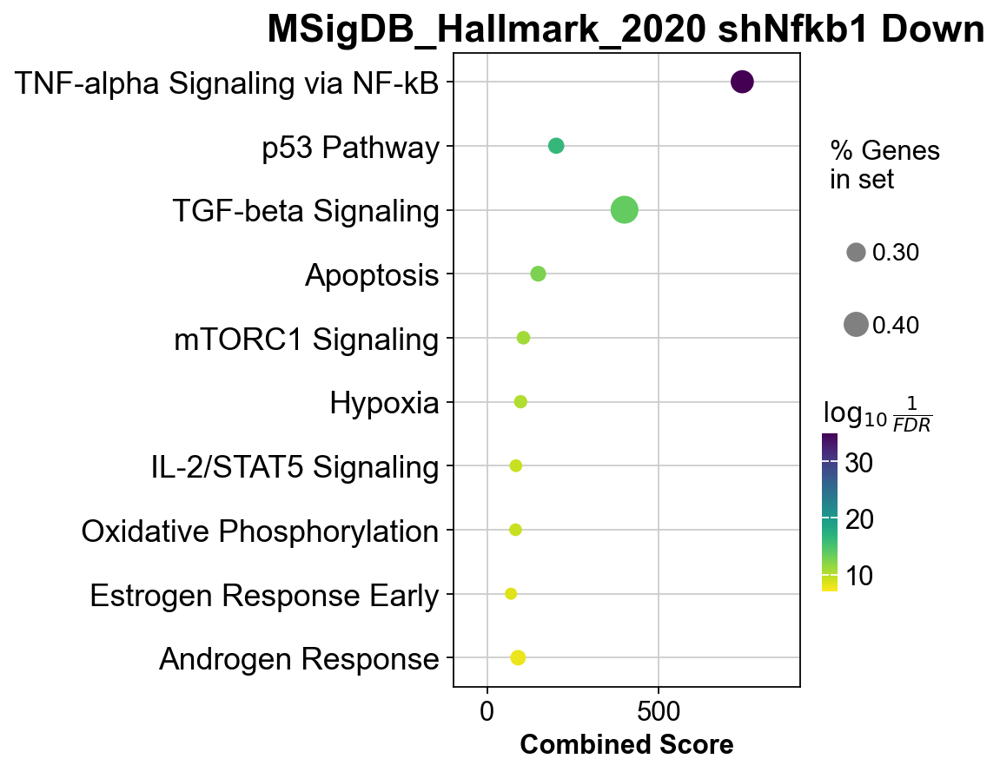

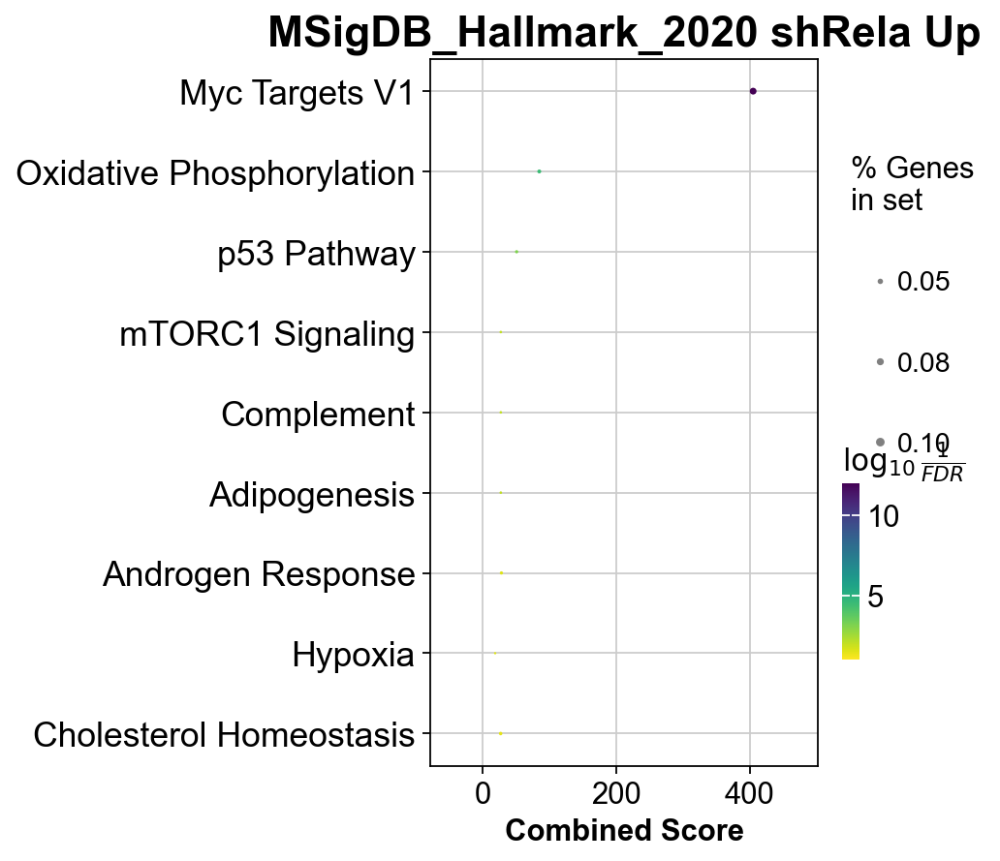

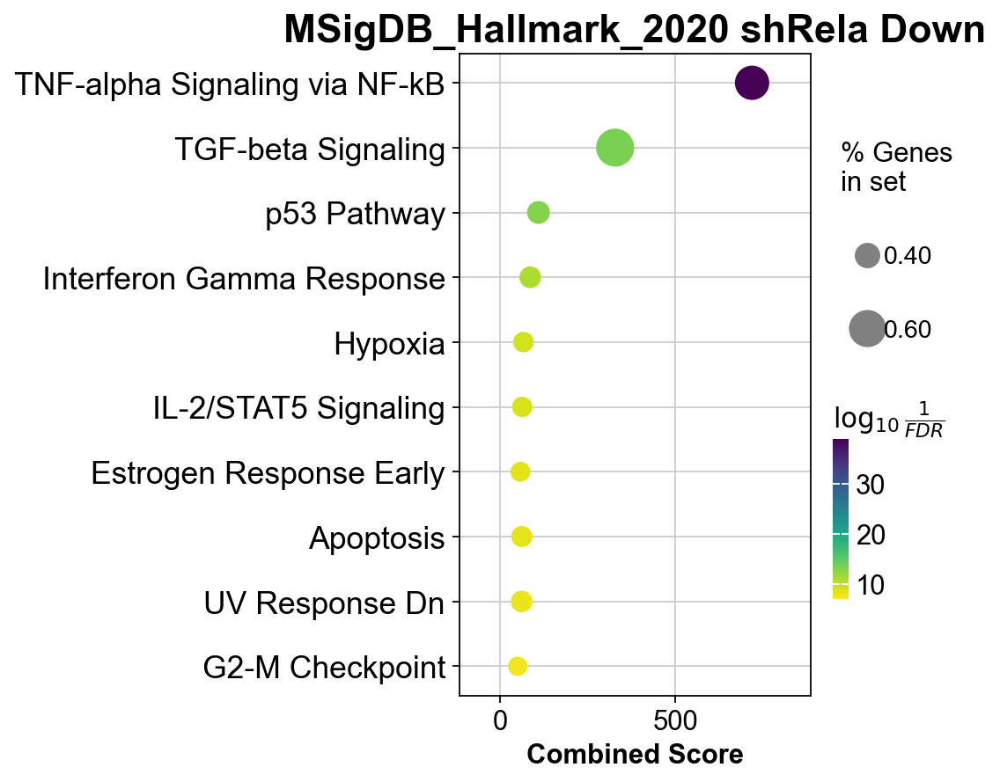

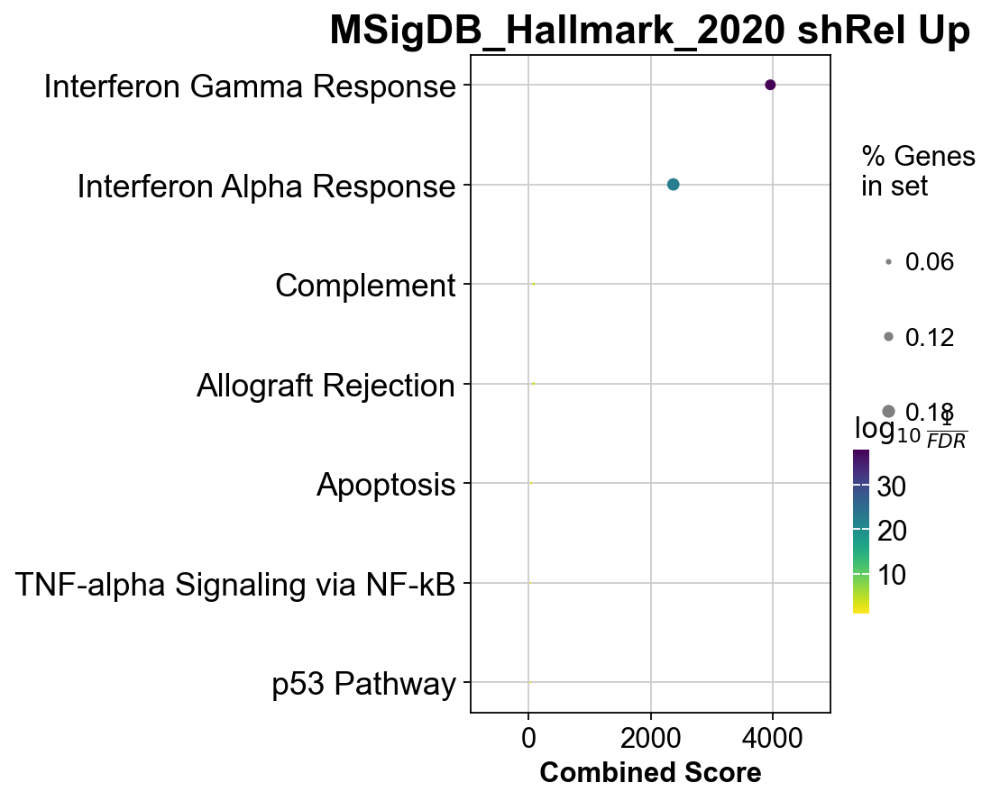

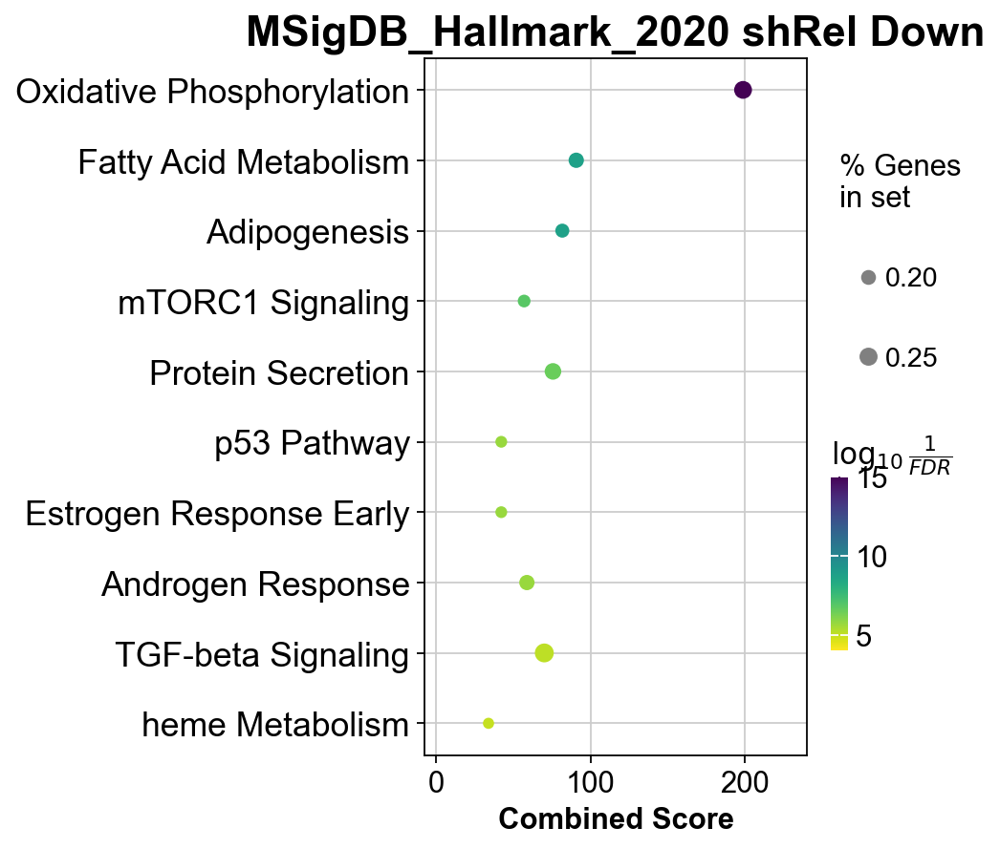

In [259]:
gseapy.dotplot(enr_res0up.res2d,title="%s shNfkb1 Up" % gsets)
gseapy.dotplot(enr_res0down.res2d,title="%s shNfkb1 Down" % gsets)
gseapy.dotplot(enr_res1up.res2d,title="%s shRela Up" % gsets)
gseapy.dotplot(enr_res1down.res2d,title="%s shRela Down" % gsets)
gseapy.dotplot(enr_res2up.res2d,title="%s shRel Up" % gsets)
gseapy.dotplot(enr_res2down.res2d,title="%s shRel Down" % gsets)

In [260]:
#Save dotplots
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
gseapy.dotplot(enr_res0up.res2d,title="%s shNfkb1 Up" % gsets, ofname="figures/%s-shNfkb1-up.pdf" % gsets)
gseapy.dotplot(enr_res0down.res2d,title="%s shNfkb1 Down" % gsets, ofname="figures/%s-shNfkb1-down.pdf" % gsets)
gseapy.dotplot(enr_res1up.res2d,title="%s shRela Up" % gsets, ofname="figures/%s-shRela-up.pdf" % gsets)
gseapy.dotplot(enr_res1down.res2d,title="%s shRela Down" % gsets, ofname="figures/%s-shRela-down.pdf" % gsets)
gseapy.dotplot(enr_res2up.res2d,title="%s shRel Up" % gsets, ofname="figures/%s-shRel-up.pdf" % gsets)
gseapy.dotplot(enr_res2down.res2d,title="%s shRel Down" % gsets, ofname="figures/%s-shRel-down.pdf" % gsets)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

## EnrichR using Cancer Cell Clusters

In [261]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
gsets = [clusters]
#clusters

In [262]:
degs_sig = degs[degs.shNfkb1_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.shNfkb1_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.shNfkb1_logfoldchanges < 0]

In [263]:
enr_res0up = gseapy.enrichr(gene_list=degs_up.shNfkb1_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0up.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,4/240,0.006953,0.023426,7.048324,35.019963,Psmb9;Psmb8;B2m;Bst2
1,gs_ind_0,Cluster 10,1/500,0.835602,0.835602,0.806696,0.144885,Eif2s3y
2,gs_ind_0,Cluster 11,2/500,0.518230,0.777345,1.455366,0.956665,Hist1h2bc;Gnb4
3,gs_ind_0,Cluster 12,1/500,0.835602,0.835602,0.806696,0.144885,Atp5e
4,gs_ind_0,Cluster 5,2/406,0.405701,0.777345,1.840049,1.659978,Ly6a;Osbpl3
5,gs_ind_0,Cluster 9,4/248,0.007809,0.023426,6.803681,33.014865,Rpl13;CT010467.1;Rpl32;Rps20


In [264]:
enr_res0down = gseapy.enrichr(gene_list=degs_dw.shNfkb1_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,80/240,3.176441e-16,1.905865e-15,3.577848,1.276776e+02,Ier2;Rnaset2b;Amotl2;Stat3;Gja1;Btg2;Socs2;Nr4...
1,gs_ind_0,Cluster 10,37/500,9.999981e-01,1.000000e+00,0.482727,8.970413e-07,Sh3yl1;Txndc5;Nectin4;Pnp;Mif4gd;Mir22hg;Plxnb...
2,gs_ind_0,Cluster 11,28/500,1.000000e+00,1.000000e+00,0.352769,1.431093e-10,B4galt5;Creb3l2;Hspb1;Mxra8;Ugdh;Rcn2;Bmp1;Plp...
3,gs_ind_0,Cluster 12,66/500,6.068378e-01,1.000000e+00,0.975826,4.874190e-01,Tspo;Ociad2;Slpi;Tmem123;Ubr3;Wfdc2;Ssx2ip;Atp...
4,gs_ind_0,Cluster 2,16/82,7.903226e-02,2.370968e-01,1.604450,4.071933e+00,Scd1;Scd2;Lbp;Smarca2;Dcxr;Atp11a;mt-Atp6;Dhrs...
5,gs_ind_0,Cluster 3,94/209,1.628984e-30,1.954781e-29,6.091104,4.177864e+02,Hopx;Flrt3;Rasgef1b;Wls;4930523C07Rik;Il10rb;N...
6,gs_ind_0,Cluster 4,9/63,4.835215e-01,9.670429e-01,1.116641,8.114180e-01,Slc15a2;Tmem50b;Lcn2;Trf;Inhbb;Urah;Rbms3;Hsp9...
7,gs_ind_0,Cluster 5,98/406,6.755730e-10,2.702292e-09,2.264066,4.780679e+01,Trib1;Ocln;Mpp5;Mafk;Rdh10;Picalm;Ccnl1;Epcam;...
8,gs_ind_0,Cluster 6,71/500,3.353265e-01,8.047835e-01,1.073979,1.173483e+00,Ldha;Paqr8;Serinc2;Sh3bp4;Cd55;Clip1;Mecom;Ttc...
9,gs_ind_0,Cluster 7,5/500,1.000000e+00,1.000000e+00,0.061765,-0.000000e+00,Stmn1;Nasp;Ckap4;Ube2s;Cks2


In [265]:
enr_res0down.results.to_excel('Nfkb1Cl5down.xlsx')

In [266]:
degs_sig = degs[degs.shRela_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.shRela_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.shRela_logfoldchanges < 0]

In [267]:
enr_res1up = gseapy.enrichr(gene_list=degs_up.shRela_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res1up.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,2/240,9.775714e-01,9.999282e-01,0.426742,0.009680,Car2;B2m
1,gs_ind_0,Cluster 10,3/500,9.995678e-01,9.999282e-01,0.269809,0.000117,Fam213a;Ephx2;Bst1
2,gs_ind_0,Cluster 11,3/500,9.995678e-01,9.999282e-01,0.269809,0.000117,Fxyd5;Hist1h2bc;Upp1
3,gs_ind_0,Cluster 12,7/500,9.517358e-01,9.999282e-01,0.609878,0.030169,Atp5e;Wfdc2;S100a11;Romo1;Rpl30;Rpl37a;Ndufa7
4,gs_ind_0,Cluster 3,1/209,9.931307e-01,9.999282e-01,0.292071,0.002013,Anxa5
5,gs_ind_0,Cluster 5,21/406,2.527231e-04,1.137254e-03,2.739552,22.692301,Eif2s2;Ezr;Cycs;Procr;Lgals3;Krt8;Anxa3;Rack1;...
6,gs_ind_0,Cluster 6,3/500,9.995678e-01,9.999282e-01,0.269809,0.000117,Gsto1;Fxyd3;Tns4
7,gs_ind_0,Cluster 8,1/391,9.999282e-01,9.999282e-01,0.148548,0.000011,Rps28
8,gs_ind_0,Cluster 9,54/248,5.041009e-43,4.536908e-42,25.998358,2532.072498,Eef1a1;Rpl41;Rpl28;Rpl39;Rpl12;Naca;Rps3a3;Gm1...


In [268]:
enr_res1down = gseapy.enrichr(gene_list=degs_dw.shRela_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res1down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,131/240,2.270478e-23,1.362287e-22,3.887149,2.026739e+02,Ier2;Rnaset2b;Abcd3;Gpx8;Amotl2;Itih4;Stat3;Gj...
1,gs_ind_0,Cluster 10,80/500,1.000000e+00,1.000000e+00,0.525841,1.520941e-08,Txndc5;Golga4;Pnp;Nectin4;Mif4gd;Orai1;Plxnb1;...
2,gs_ind_0,Cluster 11,43/500,1.000000e+00,1.000000e+00,0.248099,-0.000000e+00,B4galt5;Ier5l;Klf10;Creb3l2;Dlg4;Tcf12;Hspb1;M...
3,gs_ind_0,Cluster 12,137/500,1.481217e-01,2.221825e-01,1.127355,2.152934e+00,Atp9a;Slpi;Tmem123;Ubr3;Slc41a1;Nrbp2;Pim3;Dca...
4,gs_ind_0,Cluster 2,42/82,3.653219e-07,1.095966e-06,3.168938,4.697155e+01,Slco4c1;Napsa;Zdhhc3;Lbp;Smarca2;Atp11a;Elovl1...
5,gs_ind_0,Cluster 3,128/209,1.996338e-29,2.395606e-28,5.134690,3.393191e+02,Hopx;Flrt3;Slc44a2;Rasgef1b;Wls;4930523C07Rik;...
6,gs_ind_0,Cluster 4,27/63,1.737020e-03,3.474040e-03,2.244830,1.426721e+01,Tspan11;Eif4a2;Cyp2f2;Urah;Rbms3;Hsp90b1;Pla2g...
7,gs_ind_0,Cluster 5,166/406,3.796663e-13,1.518665e-12,2.227034,6.369202e+01,Trib1;Tpd52l2;Ocln;Tnf;Rbms1;Mpp5;Bcr;Mafk;Rdh...
8,gs_ind_0,Cluster 6,159/500,3.488252e-04,8.371805e-04,1.437803,1.144626e+01,Sh3bp4;Snx15;Nr2f2;Hspa4l;B4gat1;B3gat3;Lrp5;F...
9,gs_ind_0,Cluster 7,18/500,1.000000e+00,1.000000e+00,0.096699,-0.000000e+00,Lmnb1;Smchd1;Stmn1;Dnajc9;Smc6;Larp7;Rif1;Hat1...


In [269]:
enr_res1down.results.to_excel('RelaCl5down.xlsx')

In [270]:
degs_sig = degs[degs.shRel_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.shRel_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.shRel_logfoldchanges < 0]

In [271]:
enr_res2up = gseapy.enrichr(gene_list=degs_up.shRel_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res2up.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,16/240,1.136776e-10,9.094205e-10,12.123821,277.607077,H2-Eb1;Psmb8;Bst2;Gm12216;Ifi27l2a;H2-Ab1;Tap1...
1,gs_ind_0,Cluster 10,2/500,9.587112e-01,9.587112e-01,0.481779,0.020314,Irf8;Misp
2,gs_ind_0,Cluster 11,4/500,7.105902e-01,9.587112e-01,0.920259,0.314415,Hist1h2bc;Upp1;Gnb4;Colec12
3,gs_ind_0,Cluster 12,4/500,7.105902e-01,9.587112e-01,0.920259,0.314415,Sp140;Grina;Hist1h1c;Parp3
4,gs_ind_0,Cluster 4,2/63,1.181094e-01,3.149583e-01,4.378862,9.353881,Pla2g16;H2-T23
5,gs_ind_0,Cluster 5,7/406,8.157031e-02,3.149583e-01,2.138153,5.358832,Itga3;Tpm1;Osbpl3;Gng5;Trim15;Ly6a;Krt18
6,gs_ind_0,Cluster 6,3/500,8.669739e-01,9.587112e-01,0.694555,0.099145,Cavin3;Tpm2;Stat1
7,gs_ind_0,Cluster 9,1/248,9.111865e-01,9.587112e-01,0.606612,0.056420,Rps20


In [272]:
enr_res2down = gseapy.enrichr(gene_list=degs_dw.shRel_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res2down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,66/240,6.991526e-10,4.194916e-09,2.731469,5.758252e+01,Tinag;Prrg3;Nfkbiz;Nrp1;Zfp131;Ramp1;Iah1;Rnas...
1,gs_ind_0,Cluster 10,35/500,9.999988e-01,1.000000e+00,0.469645,5.848848e-07,Txndc5;Golga4;Nectin4;Reep3;Plxnb1;Aco1;Gprc5c...
2,gs_ind_0,Cluster 11,22/500,1.000000e+00,1.000000e+00,0.281185,3.802328e-13,Creb3l2;Hspb1;Nrn1;Tead2;Bmp1;Smad7;Fn1;Timp2;...
3,gs_ind_0,Cluster 12,71/500,2.420636e-01,4.841272e-01,1.115983,1.583083e+00,Tspo;Ociad2;1700020I14Rik;Tmem123;Ubr3;Wfdc2;N...
4,gs_ind_0,Cluster 2,28/82,6.861721e-07,2.744688e-06,3.593598,5.100084e+01,Slco4c1;Npw;Lbp;Smarca2;Atp11a;Fasn;Sfta2;Arfg...
5,gs_ind_0,Cluster 3,89/209,1.088238e-27,1.305885e-26,5.681256,3.527221e+02,Hopx;Flrt3;Rasgef1b;Wls;4930523C07Rik;Il10rb;H...
6,gs_ind_0,Cluster 4,14/63,3.065449e-02,7.357078e-02,1.962543,6.839416e+00,Slc15a2;Tmem50b;Pros1;Lcn2;Cebpa;Trf;Inhbb;Cyp...
7,gs_ind_0,Cluster 5,52/406,6.020534e-01,9.030801e-01,0.977011,4.957444e-01,Trib1;Ube2d3;F11r;Tead1;Cdc42;Neat1;Krt23;Chrn...
8,gs_ind_0,Cluster 6,66/500,5.001178e-01,8.573448e-01,1.013652,7.023715e-01,Ldha;Usp47;Serinc2;Cd55;C1galt1;Clip1;Mecom;Tj...
9,gs_ind_0,Cluster 7,6/500,1.000000e+00,1.000000e+00,0.075872,-0.000000e+00,Stmn1;Dnajc9;Hat1;Nasp;Fzd2;Ckap4


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

<Axes: title={'center': 'shRel Down'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

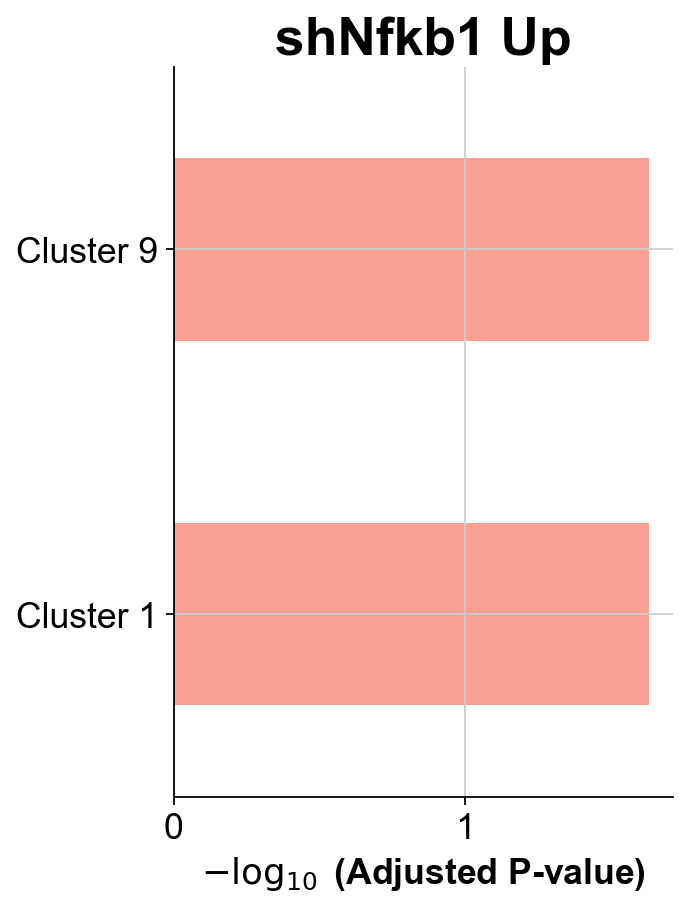

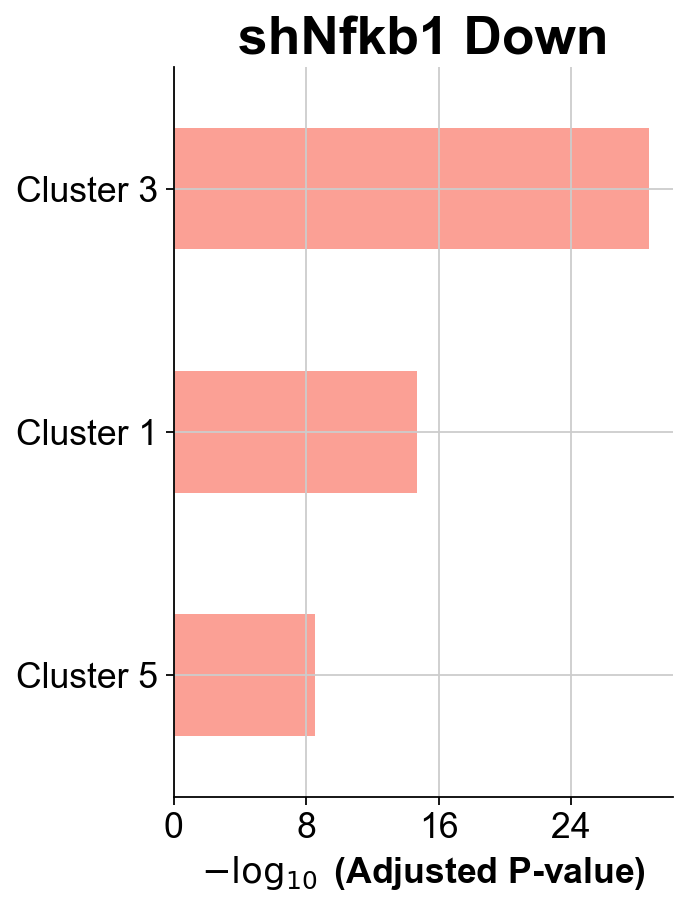

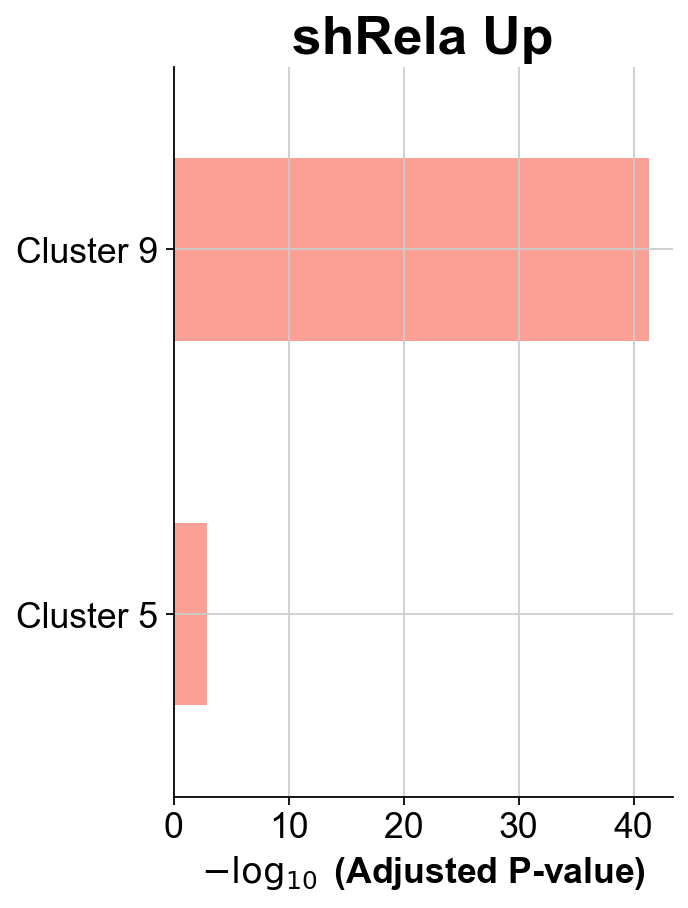

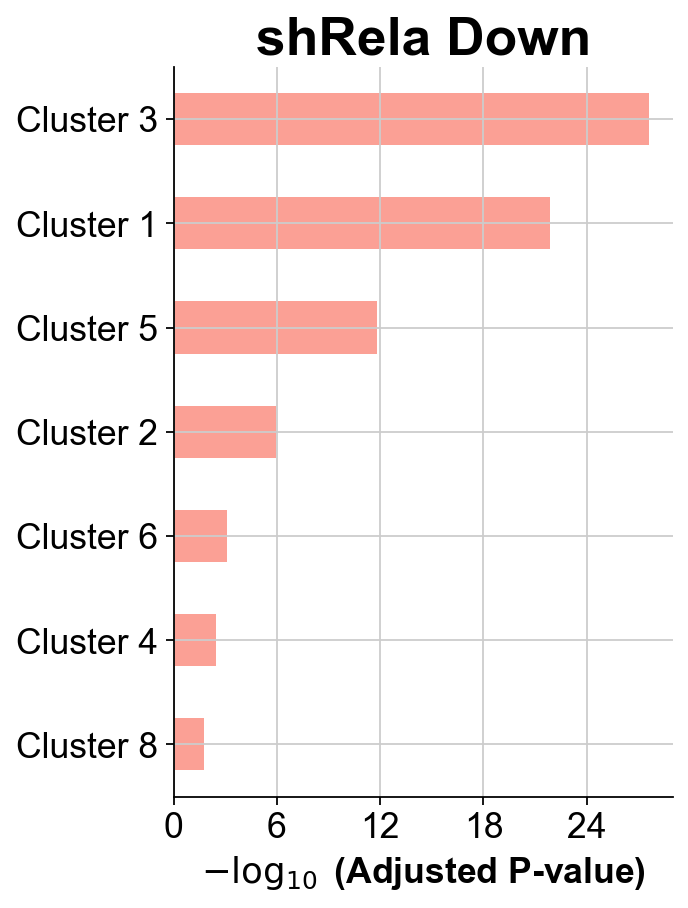

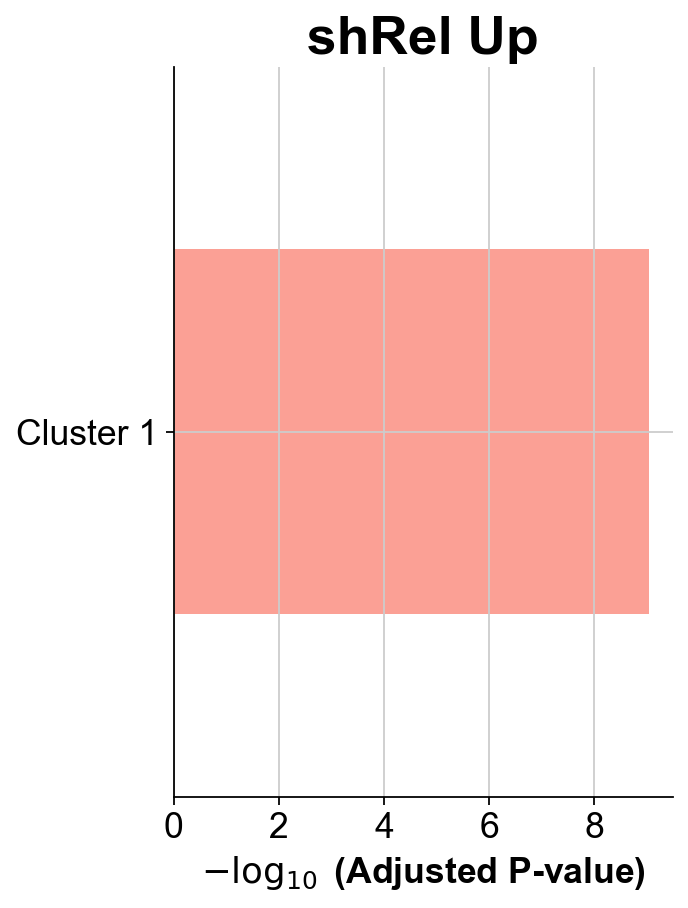

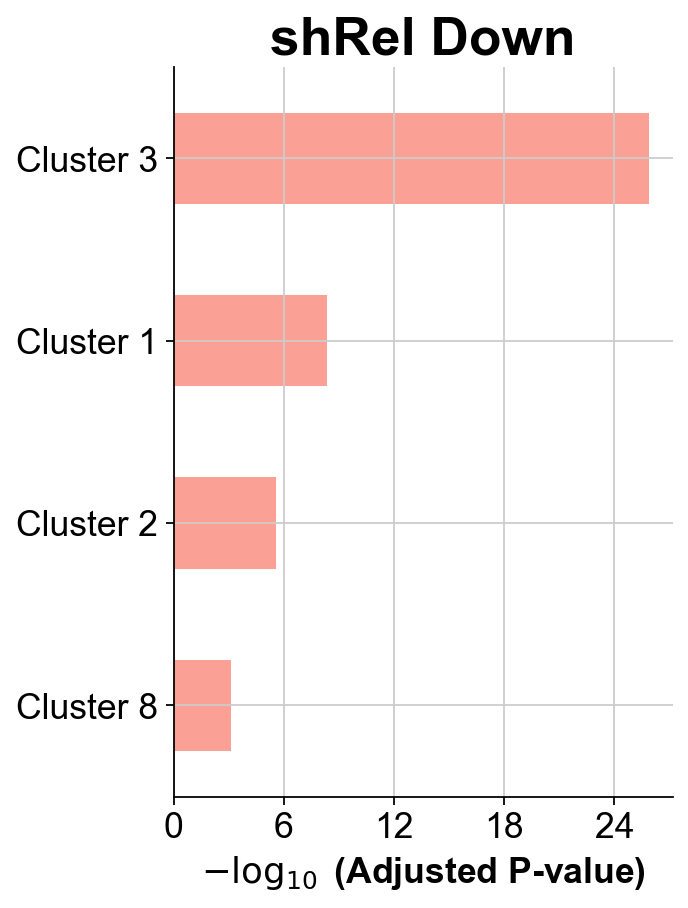

In [273]:
gseapy.barplot(enr_res0up.res2d,title="shNfkb1 Up")
gseapy.barplot(enr_res0down.res2d,title="shNfkb1 Down")
gseapy.barplot(enr_res1up.res2d,title="shRela Up")
gseapy.barplot(enr_res1down.res2d,title="shRela Down")
gseapy.barplot(enr_res2up.res2d,title="shRel Up")
gseapy.barplot(enr_res2down.res2d,title="shRel Down")

In [274]:
gseapy.barplot(enr_res0up.res2d,title="shNfkb1 Up",ofname="figures/Cluster_shNfkb1_up_barplot.pdf")
gseapy.barplot(enr_res0down.res2d,title="shNfkb1 Down",ofname="figures/Cluster_shNfkb1_down_barplot.pdf")
gseapy.barplot(enr_res1up.res2d,title="shRela Up",ofname="figures/Cluster_shRela_up_barplot.pdf")
gseapy.barplot(enr_res1down.res2d,title="shRela Down",ofname="figures/Cluster_shRela_down_barplot.pdf")
gseapy.barplot(enr_res2up.res2d,title="shRel Up",ofname="figures/Cluster_shRel_up_barplot.pdf")
gseapy.barplot(enr_res2down.res2d,title="shRel Down",ofname="figures/Cluster_shRel_down_barplot.pdf")

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

In [275]:
gseapy.dotplot(enr_res0up.res2d,title="shNfkb1 Up",ofname="figures/Cluster_shNfkb1_up_dotplot.pdf")
gseapy.dotplot(enr_res0down.res2d,title="shNfkb1 Down",ofname="figures/Cluster_shNfkb1_down_dotplot.pdf")
gseapy.dotplot(enr_res1up.res2d,title="shRela Up",ofname="figures/Cluster_shRela_up_dotplot.pdf")
gseapy.dotplot(enr_res1down.res2d,title="shRela Down",ofname="figures/Cluster_shRela_down_dotplot.pdf")
gseapy.dotplot(enr_res2up.res2d,title="shRel Up",ofname="figures/Cluster_shRel_up_dotplot.pdf")
gseapy.dotplot(enr_res2down.res2d,title="shRel Down",ofname="figures/Cluster_shRel_down_dotplot.pdf")

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

<Axes: title={'center': 'shRel Down'}, xlabel='Combined Score'>

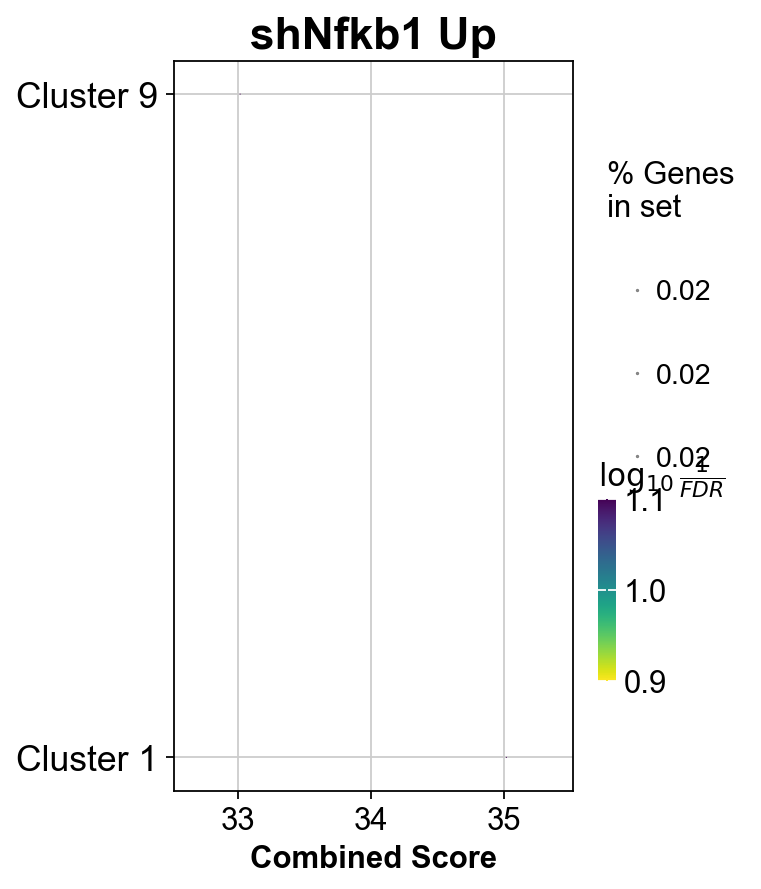

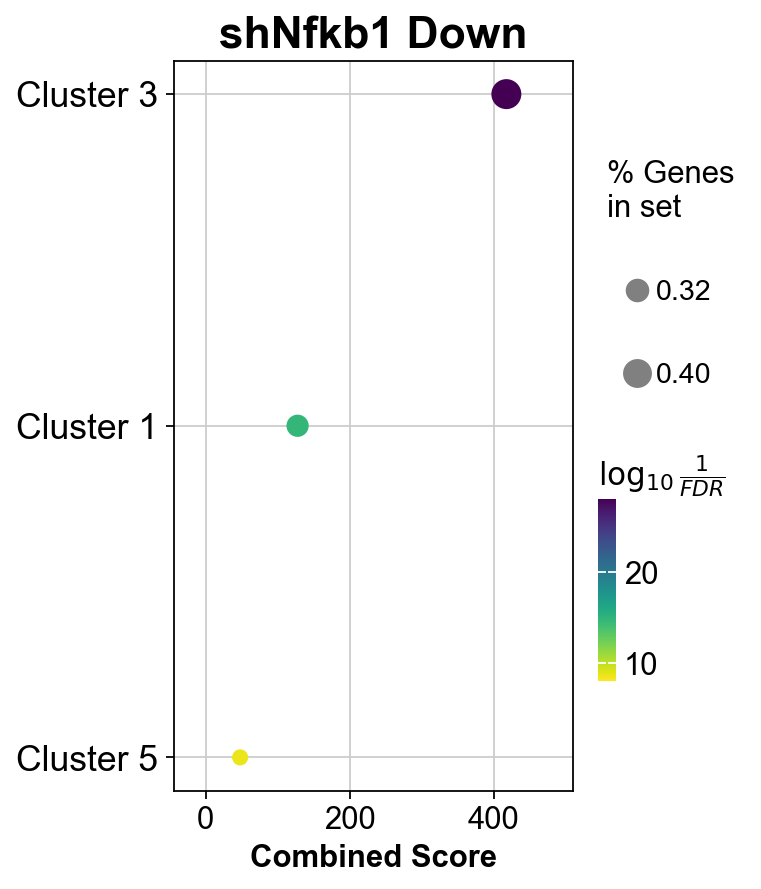

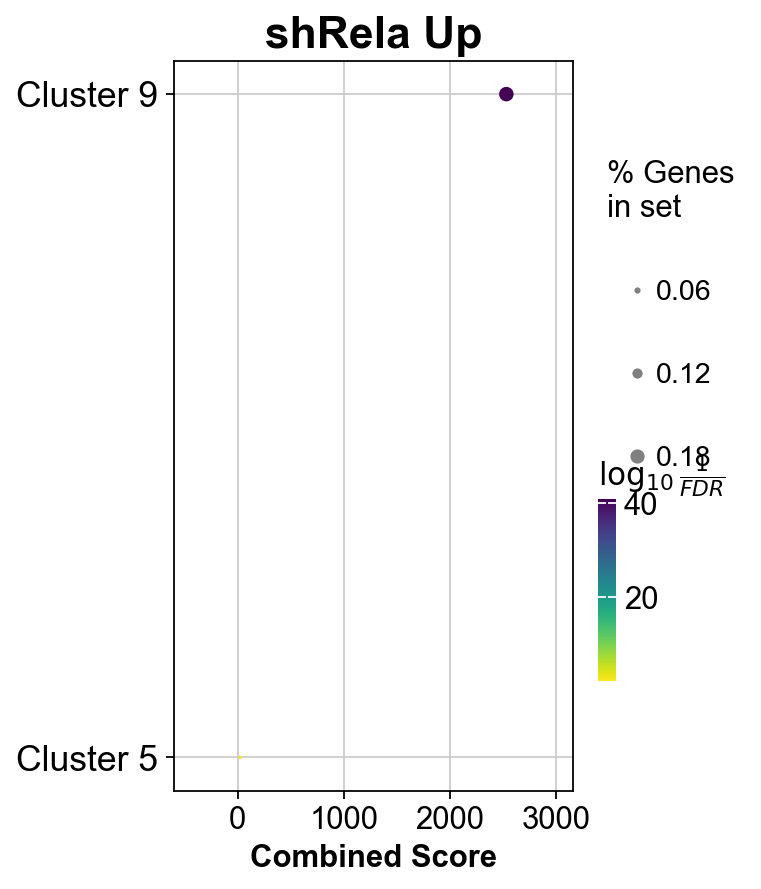

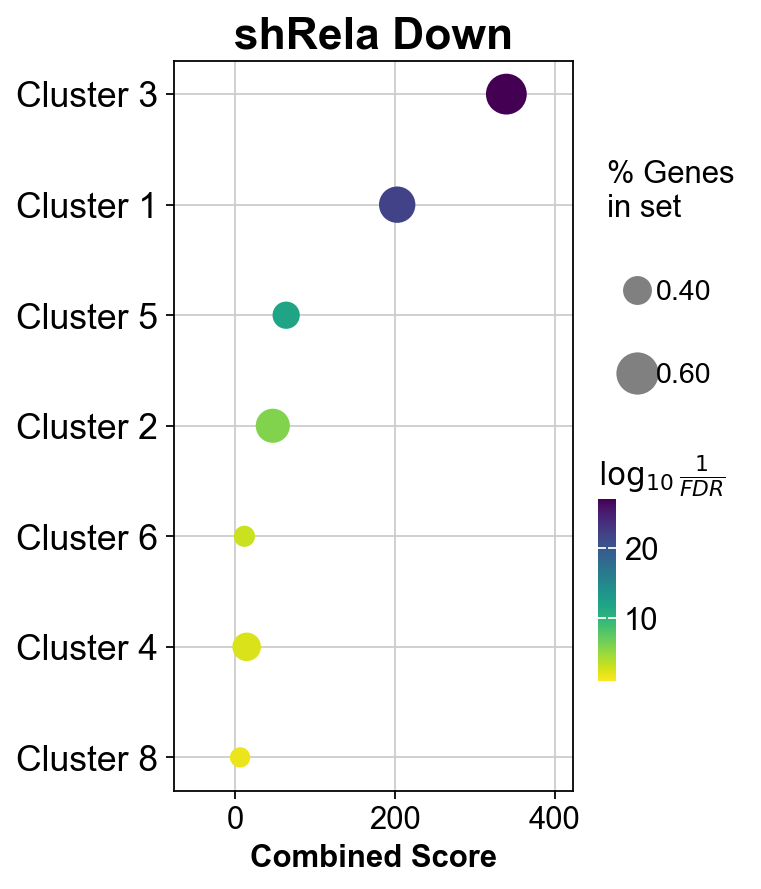

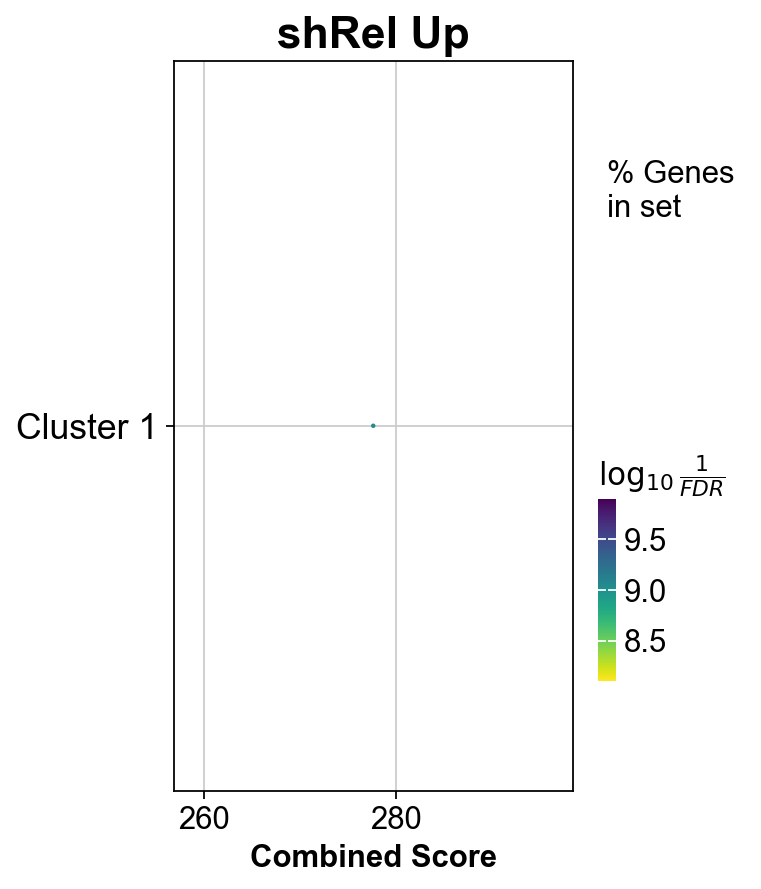

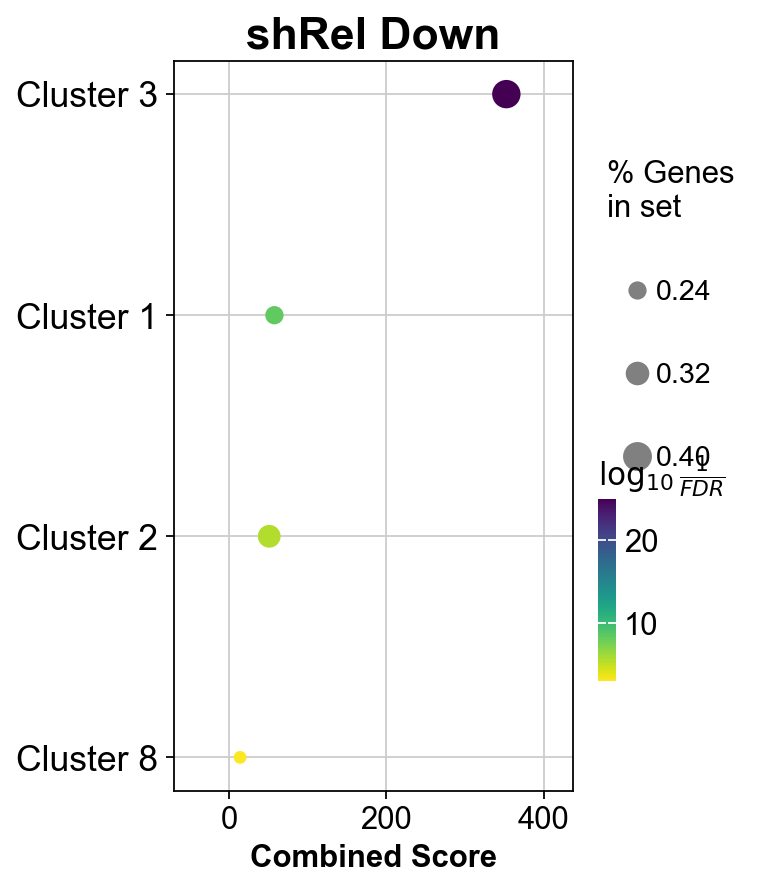

In [276]:
gseapy.dotplot(enr_res0up.res2d,title="shNfkb1 Up")
gseapy.dotplot(enr_res0down.res2d,title="shNfkb1 Down")
gseapy.dotplot(enr_res1up.res2d,title="shRela Up")
gseapy.dotplot(enr_res1down.res2d,title="shRela Down")
gseapy.dotplot(enr_res2up.res2d,title="shRel Up")
gseapy.dotplot(enr_res2down.res2d,title="shRel Down")

## Annotate with GSEA - shNfkb1

In [277]:
# Read it raw data
adata2 = sc.read('write/allmice-tumor.h5ad')

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [278]:
bdata = adata2[adata2.obs.Group.isin(['shNfkb1','shRenilla']),:]

In [279]:
adata

AnnData object with n_obs × n_vars = 1673 × 3608
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'shRen', '2118-Nfkb1', 'shRela', 'shRel', 'GFP_count', 'Cre_count', 'shRNA', 'Group', 'score', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'Cl5Bootstrap2', 'HPCS_unscaled', 'HPCS_scaled', 'umap_density_Classification', 'leiden', 'Cluster 5 high', 'clusterK12', 'clusterK12_stringent', 'umap_density_Group', 'Rela5down'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Classification_colors', 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'umap_density_Classification_params', 'leiden', 'leiden_colors', 'Cluster 5 h

In [280]:
bdata.obs.Group

AAACCCATCGACGTCG-1    shRenilla
AAACGAATCGAACACT-1    shRenilla
AAAGGATAGGATGTTA-1    shRenilla
AAAGGTAGTAGAGCTG-1    shRenilla
AAAGTGACAACATACC-1      shNfkb1
                        ...    
TTTCACAAGAGTCAGC-1    shRenilla
TTTCACAAGCGCTGAA-1    shRenilla
TTTCAGTTCGATCCCT-1    shRenilla
TTTCATGAGCTGCCTG-1    shRenilla
TTTCCTCCACAAATAG-1    shRenilla
Name: Group, Length: 647, dtype: category
Categories (2, object): ['shNfkb1', 'shRenilla']

In [281]:
bdata.obs['Group'] = pd.Categorical(bdata.obs['Group'], categories=['shNfkb1','shRenilla'],ordered=True)

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/1581105927.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  bdata.obs['Group'] = pd.Categorical(bdata.obs['Group'], categories=['shNfkb1','shRenilla'],ordered=True)


In [282]:
bdata.obs.Group

AAACCCATCGACGTCG-1    shRenilla
AAACGAATCGAACACT-1    shRenilla
AAAGGATAGGATGTTA-1    shRenilla
AAAGGTAGTAGAGCTG-1    shRenilla
AAAGTGACAACATACC-1      shNfkb1
                        ...    
TTTCACAAGAGTCAGC-1    shRenilla
TTTCACAAGCGCTGAA-1    shRenilla
TTTCAGTTCGATCCCT-1    shRenilla
TTTCATGAGCTGCCTG-1    shRenilla
TTTCCTCCACAAATAG-1    shRenilla
Name: Group, Length: 647, dtype: category
Categories (2, object): ['shNfkb1' < 'shRenilla']

In [283]:
indices = bdata.obs.sort_values(['Group']).index

In [284]:
indices

Index(['GAAGTAAAGAATACAC-1', 'CGGCAGTCACGGCCAT-1', 'TCCAGAAAGCATATGA-1',
       'TCCAGAAAGGTTAGTA-1', 'TCCATCGGTATCACGT-1', 'CGCATAAAGCAGATAT-1',
       'CGATGGCTCGACGTCG-1', 'CGAGGAACAGACCAAG-1', 'CGAGGAACACCTCGTT-1',
       'TCATTGTTCCGAGAAG-1',
       ...
       'CTCCAACAGTTGCGAG-1', 'CTCATGCCAGGTTCGC-1', 'CTAGGTAAGCACTCGC-1',
       'CTAGACACATACTGTG-1', 'CTACTATAGATCCAAA-1', 'CTACCTGAGATGAATC-1',
       'CTACAGATCGTAGGAG-1', 'CGTTAGACATCCAACA-1', 'CGTGAATGTCCGCAGT-1',
       'TTTCCTCCACAAATAG-1'],
      dtype='object', length=647)

In [285]:
bdata = bdata[indices,:]

In [286]:
import time
t1 = time.time()
# NOTE: To speed up, use gp.prerank instead with your own ranked list.
res = gseapy.gsea(data=bdata.to_df().T, # row -> genes, column-> samples
        gene_sets=gsets,
        cls=bdata.obs.Group,
        permutation_num=1000,
        permutation_type='phenotype',
        outdir=None,
        method='s2n', # signal_to_noise
        threads= 16)
t2=time.time()
print(t2-t1)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/gsea.py:105: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  df_std = df.groupby(by=cls_dict, axis=1).std(numeric_only=True)


9.226226806640625


In [287]:
res.res2d.head(10)

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,gsea,0__Cluster 3,-0.723869,-2.631943,0.0,0.0,0.0,134/202,16.51%,Zfp36l1;Jup;Sparc;Aqp5;Cyr61;Dapk2;Timp3;Dag1;...
1,gsea,0__Cluster 6,-0.450576,-2.615444,0.0,0.0,0.0,214/468,28.51%,Mal2;Adrb2;Lurap1l;Hspa1a;Ripk4;Sh2d4a;Rab25;R...
2,gsea,0__Cluster 12,-0.449209,-2.594045,0.0,0.0,0.0,196/469,27.86%,Tmem37;Ppic;Hp;Itm2c;Igfbp7;Gjb2;Tmem123;Atp1a...
3,gsea,0__Cluster 1,-0.586522,-2.412143,0.0,0.000454,0.001001,107/236,18.04%,Nr4a1;Nfkbiz;Dusp1;Gm20186;Atf3;Zfp36;Ctsc;Fos...
4,gsea,0__Cluster 8,-0.45604,-2.400069,0.0,0.000363,0.001001,169/378,28.31%,Mgst1;Gstm1;Ddah2;Fmo2;Acaa2;Slc12a2;Hadh;Gstt...
5,gsea,0__Cluster 5,-0.487307,-2.132645,0.0,0.002118,0.007007,191/396,28.88%,Rhob;Klf6;Zfand5;Trib1;Maff;Sfn;Ier3;Slc38a2;H...
6,gsea,0__Cluster 10,-0.32874,-2.065309,0.0,0.004668,0.018018,238/459,46.87%,Ahr;Slc16a12;Hs6st1;Aco1;Tenm4;Tubb2b;Gprc5c;M...
7,gsea,0__Cluster 11,-0.381309,-1.988712,0.0,0.006581,0.027027,182/451,28.75%,Smad7;Fn1;Rem2;Plpp3;Cdkn2b;Creb3l2;Camk2n1;Np...
8,gsea,0__Cluster 4,-0.437246,-1.590948,0.088757,0.068585,0.249249,25/60,26.60%,Tmem50b;Trf;Cyp2f2;Rbms3;Slc7a4;Urah;Hsp90b1;I...
9,gsea,0__Cluster 2,-0.478923,-1.517994,0.146535,0.083694,0.313313,29/78,25.79%,Dhrs3;Scd2;Ptprf;Dcxr;Scd1;Dram1;Npc1;Smarca2;...


In [288]:
res.ranking.shape # raking metric

(21399,)

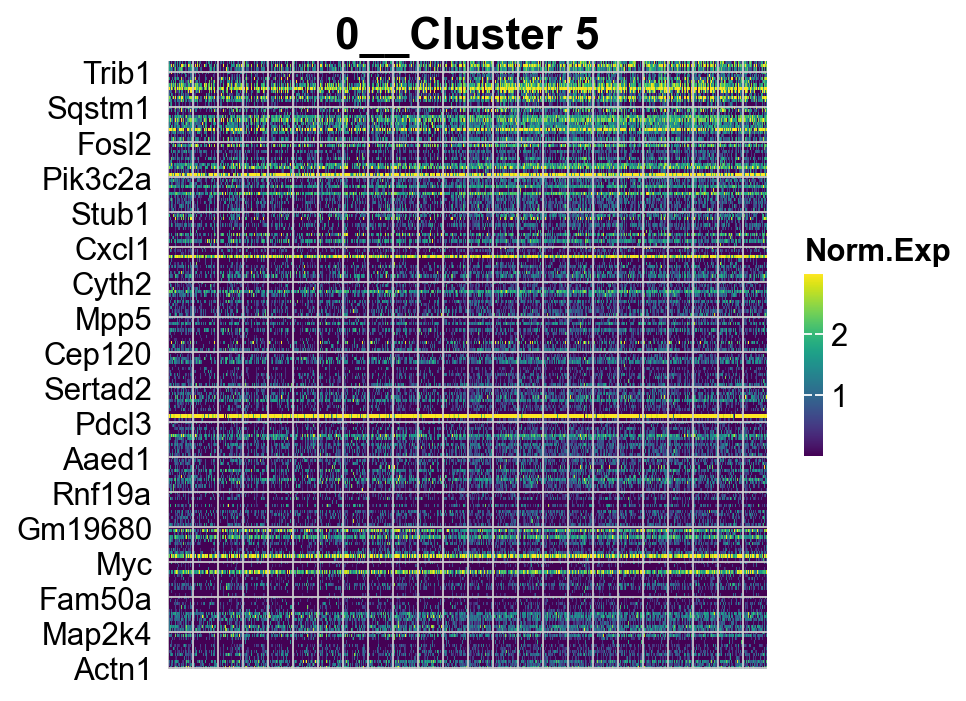

In [289]:
## Heatmap of gene expression
i = 5
genes = res.res2d.Lead_genes.iloc[i].split(";")
ax = gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(6,5),
           cmap=plt.cm.viridis,
           xticklabels=False)

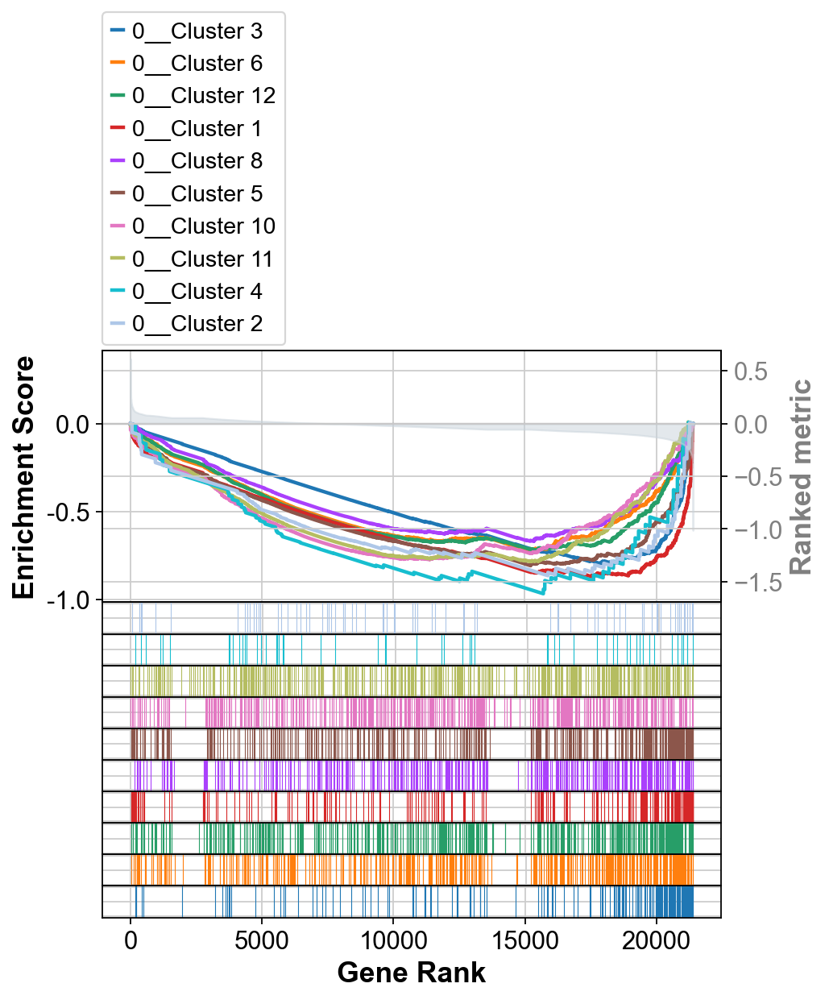

In [290]:
term = res.res2d.Term
# gp.gseaplot(res.ranking, term=term[i], **res.results[term[i]])
axs = res.plot(terms=term[:10])

In [291]:
sc.tl.rank_genes_groups(bdata,
                        groupby='Group',
                        use_raw=False,
                        method='wilcoxon',
                        groups=["shNfkb1"],
                        reference='shRenilla')

ranking genes


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


In [292]:
bdata.X.max() # already log1p

8.601066

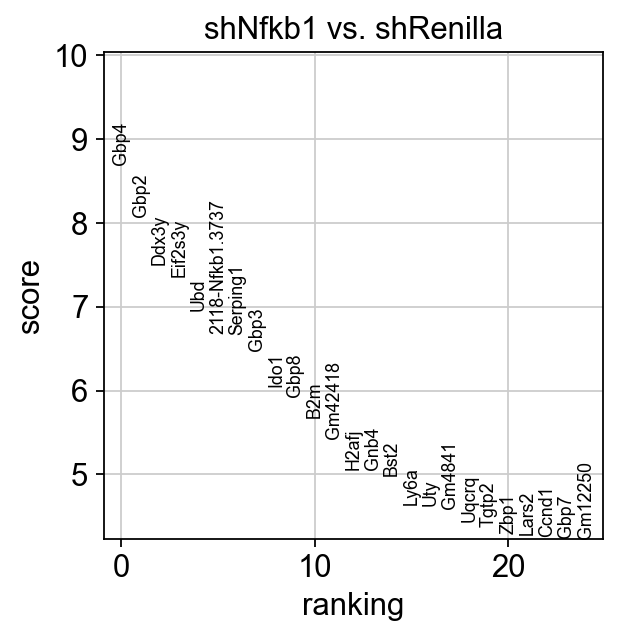

In [293]:
sc.pl.rank_genes_groups(bdata, n_genes=25, sharey=False)

In [294]:
# get deg result
result = bdata.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})

In [295]:
bdata.obs[['Group','Classification']].value_counts(sort=False)

Group      Classification       
shNfkb1    BD1939_B0303              49
           BE1137_B0304              35
           BE1155_(BD1672)_B0302     96
           BE1156_(BD1671)_B0301    134
shRenilla  BF1087_B0313             326
           BF1240_(BE1834)_B0312      7
Name: count, dtype: int64

In [296]:
degs_sig = degs[degs.shNfkb1_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.shNfkb1_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.shNfkb1_logfoldchanges < 0]

In [297]:
enr_res0down = gseapy.enrichr(gene_list=degs_up.shNfkb1_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,4/240,0.006953,0.023426,7.048324,35.019963,Psmb9;Psmb8;B2m;Bst2
1,gs_ind_0,Cluster 10,1/500,0.835602,0.835602,0.806696,0.144885,Eif2s3y
2,gs_ind_0,Cluster 11,2/500,0.518230,0.777345,1.455366,0.956665,Hist1h2bc;Gnb4
3,gs_ind_0,Cluster 12,1/500,0.835602,0.835602,0.806696,0.144885,Atp5e
4,gs_ind_0,Cluster 5,2/406,0.405701,0.777345,1.840049,1.659978,Ly6a;Osbpl3
5,gs_ind_0,Cluster 9,4/248,0.007809,0.023426,6.803681,33.014865,Rpl13;CT010467.1;Rpl32;Rps20


In [298]:
enr_res0down = gseapy.enrichr(gene_list=degs_dw.shNfkb1_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,80/240,3.176441e-16,1.905865e-15,3.577848,1.276776e+02,Ier2;Rnaset2b;Amotl2;Stat3;Gja1;Btg2;Socs2;Nr4...
1,gs_ind_0,Cluster 10,37/500,9.999981e-01,1.000000e+00,0.482727,8.970413e-07,Sh3yl1;Txndc5;Nectin4;Pnp;Mif4gd;Mir22hg;Plxnb...
2,gs_ind_0,Cluster 11,28/500,1.000000e+00,1.000000e+00,0.352769,1.431093e-10,B4galt5;Creb3l2;Hspb1;Mxra8;Ugdh;Rcn2;Bmp1;Plp...
3,gs_ind_0,Cluster 12,66/500,6.068378e-01,1.000000e+00,0.975826,4.874190e-01,Tspo;Ociad2;Slpi;Tmem123;Ubr3;Wfdc2;Ssx2ip;Atp...
4,gs_ind_0,Cluster 2,16/82,7.903226e-02,2.370968e-01,1.604450,4.071933e+00,Scd1;Scd2;Lbp;Smarca2;Dcxr;Atp11a;mt-Atp6;Dhrs...
5,gs_ind_0,Cluster 3,94/209,1.628984e-30,1.954781e-29,6.091104,4.177864e+02,Hopx;Flrt3;Rasgef1b;Wls;4930523C07Rik;Il10rb;N...
6,gs_ind_0,Cluster 4,9/63,4.835215e-01,9.670429e-01,1.116641,8.114180e-01,Slc15a2;Tmem50b;Lcn2;Trf;Inhbb;Urah;Rbms3;Hsp9...
7,gs_ind_0,Cluster 5,98/406,6.755730e-10,2.702292e-09,2.264066,4.780679e+01,Trib1;Ocln;Mpp5;Mafk;Rdh10;Picalm;Ccnl1;Epcam;...
8,gs_ind_0,Cluster 6,71/500,3.353265e-01,8.047835e-01,1.073979,1.173483e+00,Ldha;Paqr8;Serinc2;Sh3bp4;Cd55;Clip1;Mecom;Ttc...
9,gs_ind_0,Cluster 7,5/500,1.000000e+00,1.000000e+00,0.061765,-0.000000e+00,Stmn1;Nasp;Ckap4;Ube2s;Cks2


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

<Axes: title={'center': 'shNfkb1 Down'}, xlabel='Combined Score'>

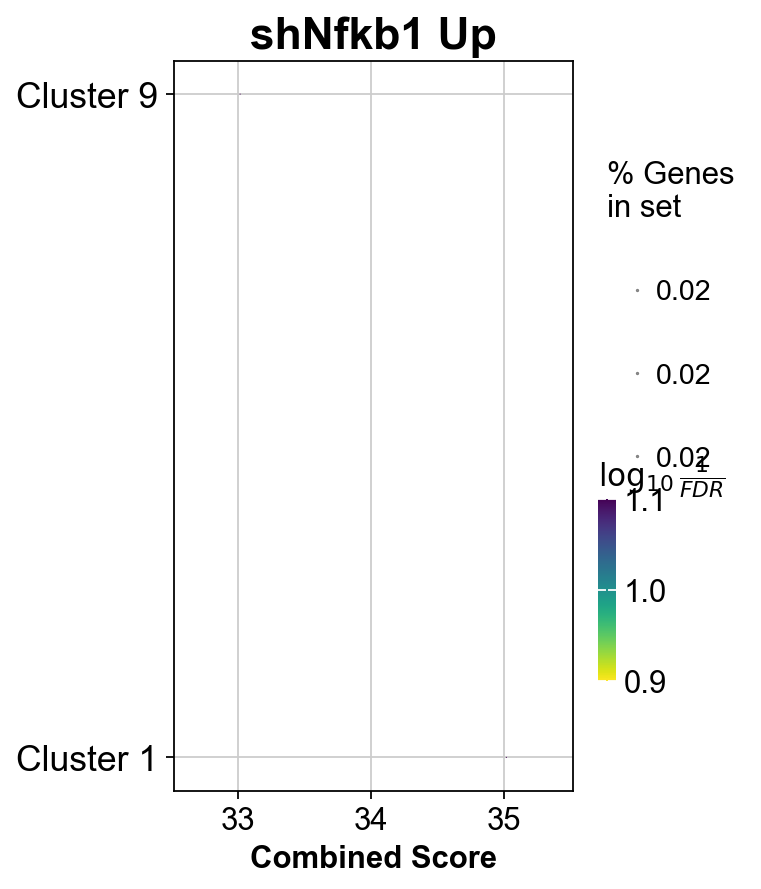

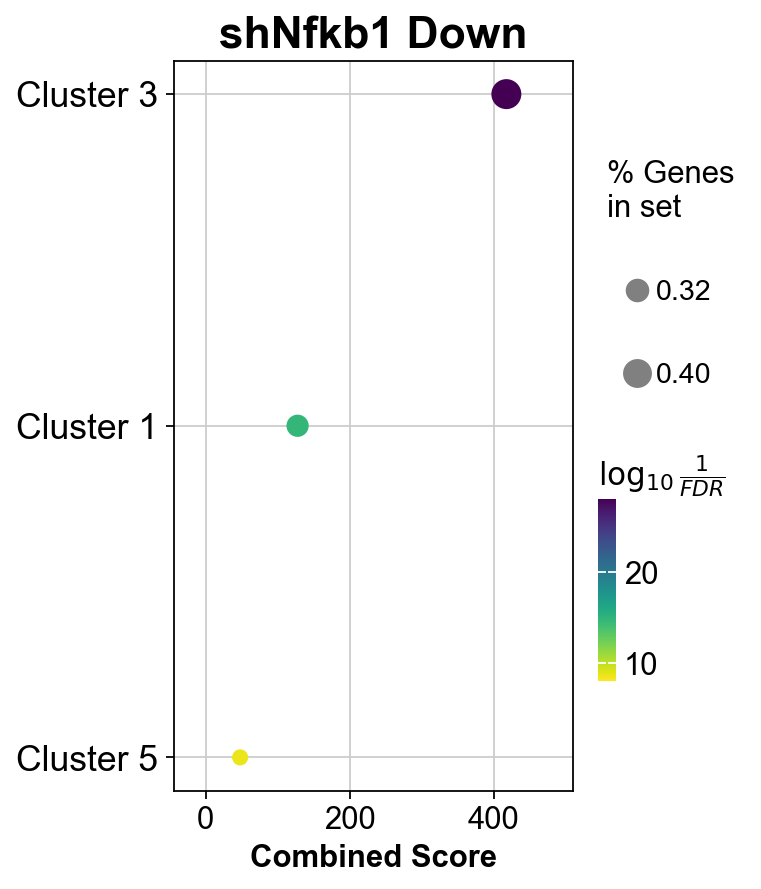

In [299]:
gseapy.dotplot(enr_res0up.res2d,title="shNfkb1 Up" % gsets)
gseapy.dotplot(enr_res0down.res2d,title="shNfkb1 Down" % gsets)

## Annotate with GSEA - shRela

In [300]:
bdata = adata2[adata2.obs.Group.isin(['shRela','shRenilla']),:]

In [301]:
bdata.obs.Group

AAACCCATCGACGTCG-1    shRenilla
AAACGAAGTCGAACAG-1       shRela
AAACGAATCGAACACT-1    shRenilla
AAACGCTGTCACGCTG-1       shRela
AAAGGATAGGATGTTA-1    shRenilla
                        ...    
TTTCCTCCACAAATAG-1    shRenilla
TTTCGATTCGGAATTC-1       shRela
TTTGACTAGGGTACAC-1       shRela
TTTGACTGTCGATTCA-1       shRela
TTTGATCAGACTAGAT-1       shRela
Name: Group, Length: 919, dtype: category
Categories (2, object): ['shRela', 'shRenilla']

In [302]:
bdata.obs['Group'] = pd.Categorical(bdata.obs['Group'], categories=['shRela','shRenilla'],ordered=True)

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2884006817.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  bdata.obs['Group'] = pd.Categorical(bdata.obs['Group'], categories=['shRela','shRenilla'],ordered=True)


In [303]:
bdata.obs.Group

AAACCCATCGACGTCG-1    shRenilla
AAACGAAGTCGAACAG-1       shRela
AAACGAATCGAACACT-1    shRenilla
AAACGCTGTCACGCTG-1       shRela
AAAGGATAGGATGTTA-1    shRenilla
                        ...    
TTTCCTCCACAAATAG-1    shRenilla
TTTCGATTCGGAATTC-1       shRela
TTTGACTAGGGTACAC-1       shRela
TTTGACTGTCGATTCA-1       shRela
TTTGATCAGACTAGAT-1       shRela
Name: Group, Length: 919, dtype: category
Categories (2, object): ['shRela' < 'shRenilla']

In [304]:
indices = bdata.obs.sort_values(['Group']).index

In [305]:
indices

Index(['GACTCAACATCTGGGC-1', 'GGAAGTGGTGAATGTA-1', 'GGAGCAAAGAGAGTTT-1',
       'GGATGTTAGCCTCTCT-1', 'GGCACGTGTCTTGTCC-1', 'GGCACGTGTGAATAAC-1',
       'GGCAGTCCAGTCTTCC-1', 'GGCTTGGGTAGCTGCC-1', 'GGCTTTCCACCGTGAC-1',
       'GCTTTCGTCCTTGAAG-1',
       ...
       'GTCCACTAGGCCTTCG-1', 'GTCATGAGTCCGGACT-1', 'GTCATCCAGAACAAGG-1',
       'GTCAGCGAGGCGACAT-1', 'ATCCTATAGTTAGTAG-1', 'ATCGCCTGTTGGCTAT-1',
       'GTAGGAGAGTGCACAG-1', 'GTAGCTAAGCATCCCG-1', 'ATCACTTCAGTGTGCC-1',
       'AAACCCATCGACGTCG-1'],
      dtype='object', length=919)

In [306]:
bdata = bdata[indices,:]

In [307]:
import time
t1 = time.time()
# NOTE: To speed up, use gp.prerank instead with your own ranked list.
res = gseapy.gsea(data=bdata.to_df().T, # row -> genes, column-> samples
        gene_sets=gsets,
        cls=bdata.obs.Group,
        permutation_num=1000,
        permutation_type='phenotype',
        outdir=None,
        method='s2n', # signal_to_noise
        threads= 16)
t2=time.time()
print(t2-t1)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/gsea.py:105: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  df_std = df.groupby(by=cls_dict, axis=1).std(numeric_only=True)


12.672746896743774


In [308]:
res.res2d.head(10)

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,gsea,0__Cluster 8,-0.549644,-2.710366,0.0,0.0,0.0,219/381,31.65%,Gstt1;Mgst1;Ski;Arid4b;Gstm1;Ddah2;Sorcs2;Tst;...
1,gsea,0__Cluster 1,-0.717351,-2.65015,0.0,0.0,0.0,137/237,16.03%,Dusp1;Fosb;Pnrc1;Fos;Atf3;Jun;Nfkbia;Zfp36;Cts...
2,gsea,0__Cluster 12,-0.483095,-2.605092,0.0,0.0,0.0,231/473,28.97%,Hp;Tmem37;Bhlhe40;Alas1;Pdgfb;Ifitm3;Slpi;Igfb...
3,gsea,0__Cluster 6,-0.49449,-2.587994,0.0,0.0,0.0,265/468,32.53%,Hspa1a;Hspa1b;Adrb2;Mal2;Elf3;Lurap1l;Nab1;Rnf...
4,gsea,0__Cluster 9,0.68115,2.548118,0.0,0.0,0.0,93/204,9.42%,Rps3a3;Gm10036;Rpsa-ps10;Rpl14-ps1;Rpl32;CT010...
5,gsea,0__Cluster 3,-0.714247,-2.458203,0.0,0.0,0.0,140/202,19.17%,Zfp36l1;Mcl1;Aqp5;Cyr61;Sparc;Icam1;Dag1;Nedd9...
6,gsea,0__Cluster 4,-0.669652,-2.321059,0.0,0.0,0.0,28/61,11.77%,Tmem50b;Tgoln1;Lcn2;H2-DMa;Inhbb;Hsp90b1;Ciita...
7,gsea,0__Cluster 5,-0.512587,-2.074726,0.001901,0.002323,0.009045,163/398,18.22%,Klf6;Rela;Junb;H3f3b;Zfand5;Rhob;Sfn;Slc38a2;C...
8,gsea,0__Cluster 2,-0.66203,-1.994232,0.0,0.005421,0.024121,39/78,14.88%,Dhrs3;Ptprf;Scd1;Lbp;Alcam;Scd2;Dram1;Atp11a;N...
9,gsea,0__Cluster 10,-0.306351,-1.792638,0.0,0.027308,0.113568,248/463,51.14%,Ahr;Hs6st1;Slc16a12;Gprc5c;Tenm4;Tmed9;Gadd45g...


In [309]:
res.ranking.shape # raking metric

(22209,)

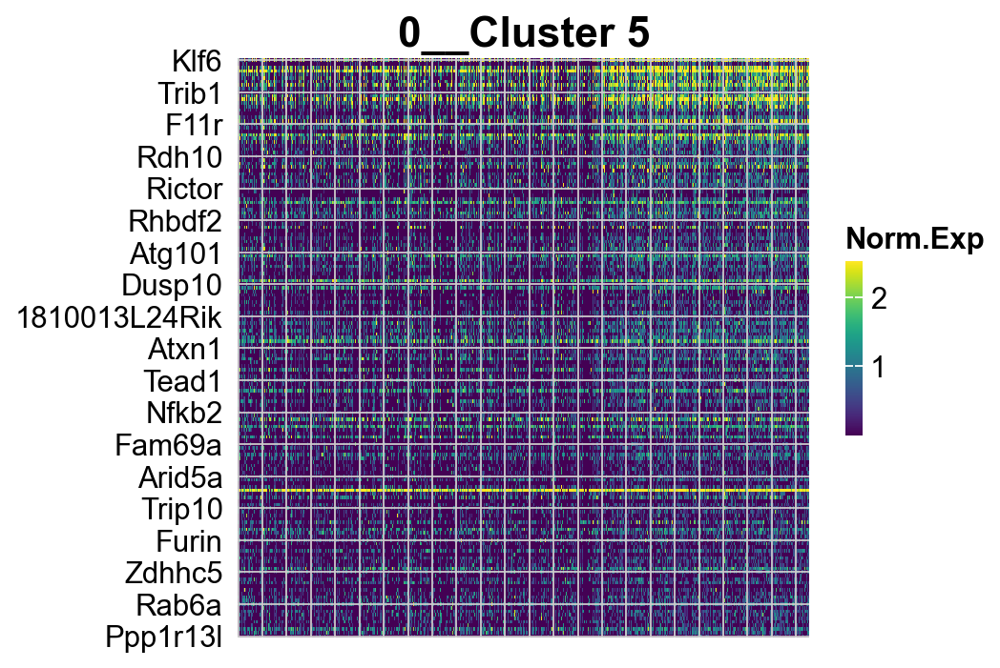

In [310]:
## Heatmap of gene expression
i = 7
genes = res.res2d.Lead_genes.iloc[i].split(";")
ax = gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(6,5),
           cmap=plt.cm.viridis,
           xticklabels=False)

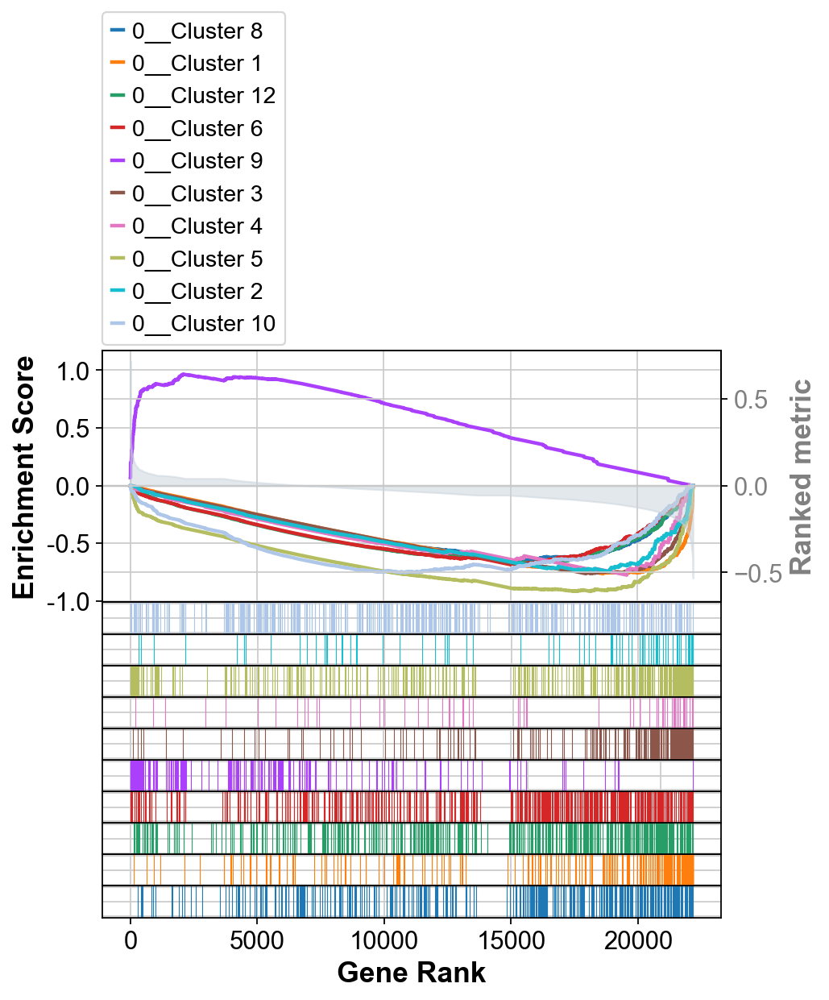

In [311]:
term = res.res2d.Term
# gp.gseaplot(res.ranking, term=term[i], **res.results[term[i]])
axs = res.plot(terms=term[:10])

In [312]:
sc.tl.rank_genes_groups(bdata,
                        groupby='Group',
                        use_raw=False,
                        method='wilcoxon',
                        groups=["shRela"],
                        reference='shRenilla')

ranking genes


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


In [313]:
bdata.X.max() # already log1p

8.703675

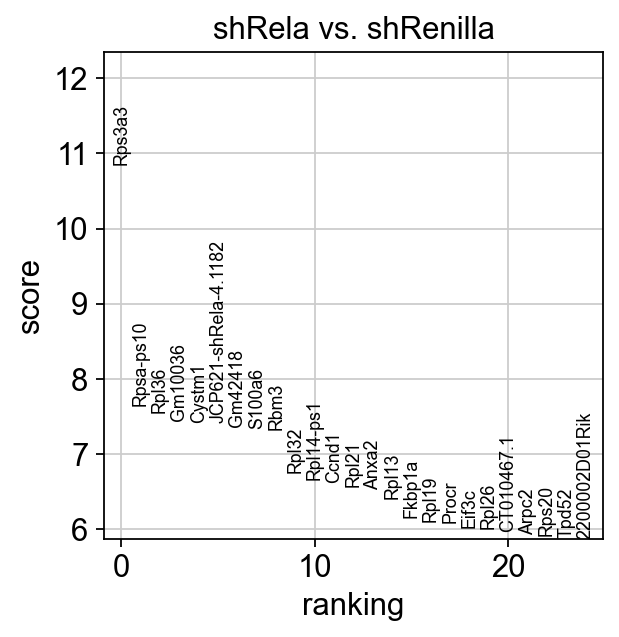

In [314]:
sc.pl.rank_genes_groups(bdata, n_genes=25, sharey=False)

In [315]:
# get deg result
result = bdata.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})

In [316]:
bdata.obs[['Group','Classification']].value_counts(sort=False)

Group      Classification       
shRela     BD1941_B0306             209
           BE1139_B0307              37
           BE1140-NT_B0308           45
           BE1157_(BD1674)_B0305    295
shRenilla  BF1087_B0313             326
           BF1240_(BE1834)_B0312      7
Name: count, dtype: int64

In [317]:
degs_sig = degs[degs.shRela_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.shRela_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.shRela_logfoldchanges < 0]

In [318]:
enr_res0up = gseapy.enrichr(gene_list=degs_up.shRela_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0up.results.to_excel("write/shRela_up.xlsx")
enr_res0up.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,2/240,9.775714e-01,9.999282e-01,0.426742,0.009680,Car2;B2m
1,gs_ind_0,Cluster 10,3/500,9.995678e-01,9.999282e-01,0.269809,0.000117,Fam213a;Ephx2;Bst1
2,gs_ind_0,Cluster 11,3/500,9.995678e-01,9.999282e-01,0.269809,0.000117,Fxyd5;Hist1h2bc;Upp1
3,gs_ind_0,Cluster 12,7/500,9.517358e-01,9.999282e-01,0.609878,0.030169,Atp5e;Wfdc2;S100a11;Romo1;Rpl30;Rpl37a;Ndufa7
4,gs_ind_0,Cluster 3,1/209,9.931307e-01,9.999282e-01,0.292071,0.002013,Anxa5
5,gs_ind_0,Cluster 5,21/406,2.527231e-04,1.137254e-03,2.739552,22.692301,Eif2s2;Ezr;Cycs;Procr;Lgals3;Krt8;Anxa3;Rack1;...
6,gs_ind_0,Cluster 6,3/500,9.995678e-01,9.999282e-01,0.269809,0.000117,Gsto1;Fxyd3;Tns4
7,gs_ind_0,Cluster 8,1/391,9.999282e-01,9.999282e-01,0.148548,0.000011,Rps28
8,gs_ind_0,Cluster 9,54/248,5.041009e-43,4.536908e-42,25.998358,2532.072498,Eef1a1;Rpl41;Rpl28;Rpl39;Rpl12;Naca;Rps3a3;Gm1...


In [319]:
enr_res0down = gseapy.enrichr(gene_list=degs_dw.shRela_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0down.results.to_excel("write/shRela_down.xlsx")
enr_res0down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,131/240,2.270478e-23,1.362287e-22,3.887149,2.026739e+02,Ier2;Rnaset2b;Abcd3;Gpx8;Amotl2;Itih4;Stat3;Gj...
1,gs_ind_0,Cluster 10,80/500,1.000000e+00,1.000000e+00,0.525841,1.520941e-08,Txndc5;Golga4;Pnp;Nectin4;Mif4gd;Orai1;Plxnb1;...
2,gs_ind_0,Cluster 11,43/500,1.000000e+00,1.000000e+00,0.248099,-0.000000e+00,B4galt5;Ier5l;Klf10;Creb3l2;Dlg4;Tcf12;Hspb1;M...
3,gs_ind_0,Cluster 12,137/500,1.481217e-01,2.221825e-01,1.127355,2.152934e+00,Atp9a;Slpi;Tmem123;Ubr3;Slc41a1;Nrbp2;Pim3;Dca...
4,gs_ind_0,Cluster 2,42/82,3.653219e-07,1.095966e-06,3.168938,4.697155e+01,Slco4c1;Napsa;Zdhhc3;Lbp;Smarca2;Atp11a;Elovl1...
5,gs_ind_0,Cluster 3,128/209,1.996338e-29,2.395606e-28,5.134690,3.393191e+02,Hopx;Flrt3;Slc44a2;Rasgef1b;Wls;4930523C07Rik;...
6,gs_ind_0,Cluster 4,27/63,1.737020e-03,3.474040e-03,2.244830,1.426721e+01,Tspan11;Eif4a2;Cyp2f2;Urah;Rbms3;Hsp90b1;Pla2g...
7,gs_ind_0,Cluster 5,166/406,3.796663e-13,1.518665e-12,2.227034,6.369202e+01,Trib1;Tpd52l2;Ocln;Tnf;Rbms1;Mpp5;Bcr;Mafk;Rdh...
8,gs_ind_0,Cluster 6,159/500,3.488252e-04,8.371805e-04,1.437803,1.144626e+01,Sh3bp4;Snx15;Nr2f2;Hspa4l;B4gat1;B3gat3;Lrp5;F...
9,gs_ind_0,Cluster 7,18/500,1.000000e+00,1.000000e+00,0.096699,-0.000000e+00,Lmnb1;Smchd1;Stmn1;Dnajc9;Smc6;Larp7;Rif1;Hat1...


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

<Axes: title={'center': 'shRela Down'}, xlabel='Combined Score'>

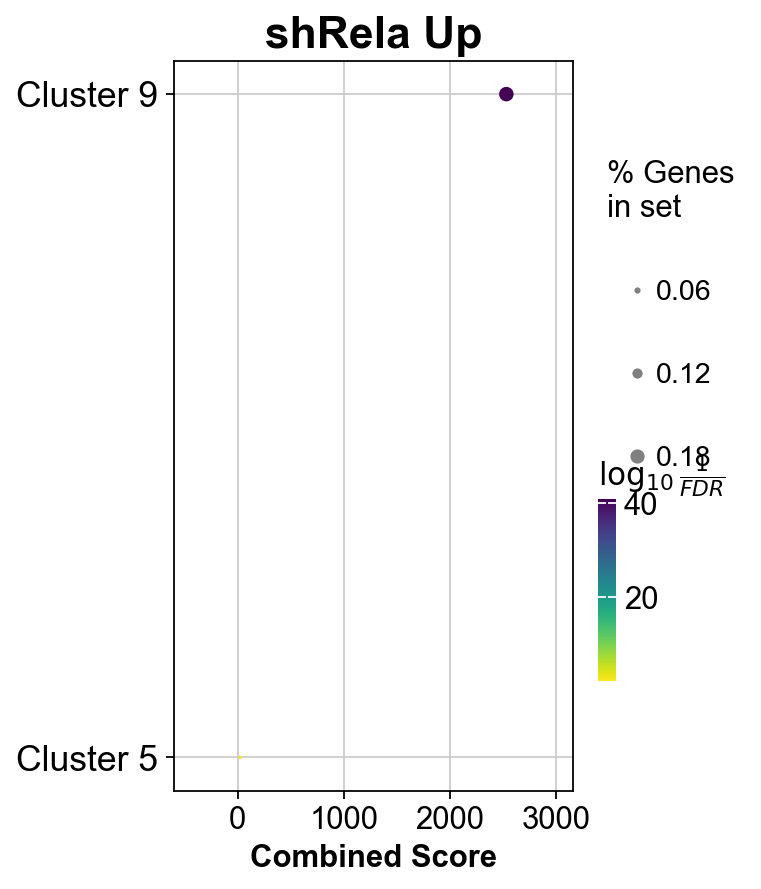

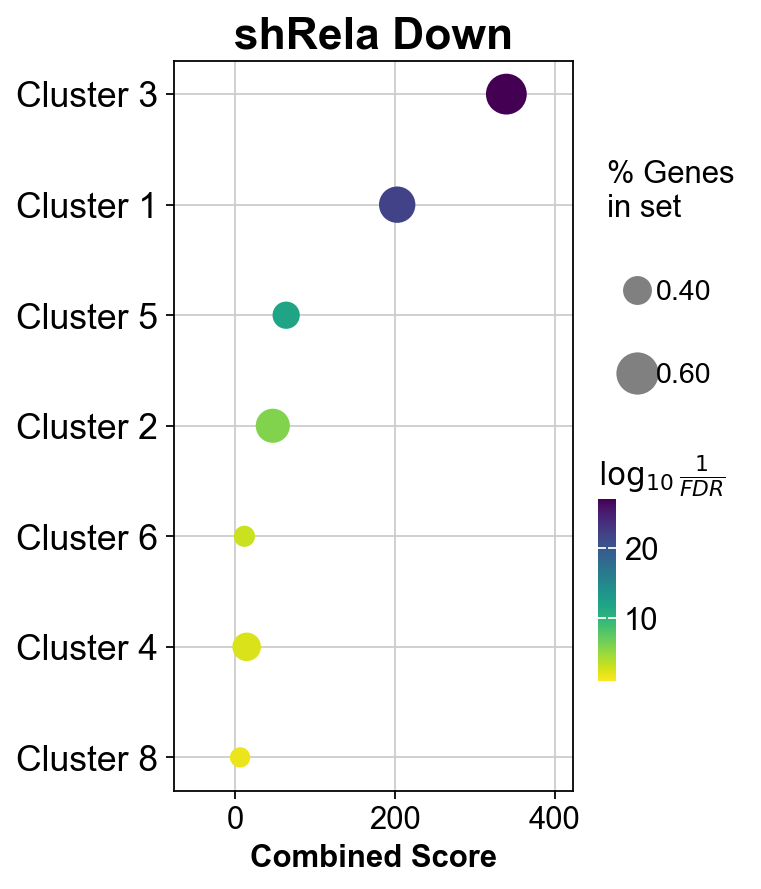

In [320]:
gseapy.dotplot(enr_res0up.res2d,title="shRela Up" % gsets)
gseapy.dotplot(enr_res0down.res2d,title="shRela Down" % gsets)

## Annotate with GSEA - shRel

In [321]:
bdata = adata2[adata2.obs.Group.isin(['shRel','shRenilla']),:]

In [322]:
bdata.obs.Group

AAACCCATCGACGTCG-1    shRenilla
AAACGAATCGAACACT-1    shRenilla
AAAGAACAGCTCGAAG-1        shRel
AAAGAACAGTTGTACC-1        shRel
AAAGAACGTGTGTCCG-1        shRel
                        ...    
TTTGATCAGGATCATA-1        shRel
TTTGTTGAGATGGGCT-1        shRel
TTTGTTGAGCTGAAAT-1        shRel
TTTGTTGAGTACCATC-1        shRel
TTTGTTGTCTATCACT-1        shRel
Name: Group, Length: 773, dtype: category
Categories (2, object): ['shRel', 'shRenilla']

In [323]:
bdata.obs['Group'] = pd.Categorical(bdata.obs['Group'], categories=['shRel','shRenilla'],ordered=True)

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_44732/2043539781.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  bdata.obs['Group'] = pd.Categorical(bdata.obs['Group'], categories=['shRel','shRenilla'],ordered=True)


In [324]:
bdata.obs.Group

AAACCCATCGACGTCG-1    shRenilla
AAACGAATCGAACACT-1    shRenilla
AAAGAACAGCTCGAAG-1        shRel
AAAGAACAGTTGTACC-1        shRel
AAAGAACGTGTGTCCG-1        shRel
                        ...    
TTTGATCAGGATCATA-1        shRel
TTTGTTGAGATGGGCT-1        shRel
TTTGTTGAGCTGAAAT-1        shRel
TTTGTTGAGTACCATC-1        shRel
TTTGTTGTCTATCACT-1        shRel
Name: Group, Length: 773, dtype: category
Categories (2, object): ['shRel' < 'shRenilla']

In [325]:
indices = bdata.obs.sort_values(['Group']).index

In [326]:
indices

Index(['TTTGTTGTCTATCACT-1', 'CTTAGGACAGCACAGA-1', 'TCCGAAATCGATTTCT-1',
       'CTGGCAGTCCGTAGTA-1', 'TCCGTGTCAATGCAAA-1', 'CTGCTCAAGGCGCTTC-1',
       'TCCTAATTCTGGAGAG-1', 'CTGCGAGCAACGCCCA-1', 'CTGCCTACAAACCGGA-1',
       'CTGCATCAGCTGTCCG-1',
       ...
       'CTTACCGAGCGAGTCA-1', 'CTGTCGTGTGCAGTGA-1', 'CTGTCGTCAGTTTCGA-1',
       'CTGTAGACACAGAGAC-1', 'CTGCTCACACAGTACT-1', 'CTGCGAGGTAGCTTAC-1',
       'CTGCGAGCAGGTATGG-1', 'CTGCATCAGCCTGGAA-1', 'GAACACTAGAGTCCGA-1',
       'GACTCTCCAGCAGAAC-1'],
      dtype='object', length=773)

In [327]:
bdata = bdata[indices,:]

In [328]:
import time
t1 = time.time()
# NOTE: To speed up, use gp.prerank instead with your own ranked list.
res = gseapy.gsea(data=bdata.to_df().T, # row -> genes, column-> samples
        gene_sets=gsets,
        cls=bdata.obs.Group,
        permutation_num=1000,
        permutation_type='phenotype',
        outdir=None,
        method='s2n', # signal_to_noise
        threads= 16)
t2=time.time()
print(t2-t1)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/gsea.py:105: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  df_std = df.groupby(by=cls_dict, axis=1).std(numeric_only=True)


10.611112117767334


In [329]:
res.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,gsea,0__Cluster 8,-0.579398,-3.025925,0.0,0.0,0.0,192/380,23.52%,Gstm1;Fmo2;Mgst1;Zfp704;Cat;Acaa2;Hadh;Ddah2;T...
1,gsea,0__Cluster 12,-0.457716,-2.583731,0.0,0.0,0.0,190/473,24.05%,Ppic;Hp;Cyb5a;Ly6k;Igfbp7;Tmem123;Atp1a1;Acss2...
2,gsea,0__Cluster 3,-0.700903,-2.504927,0.0,0.000598,0.001003,122/201,14.94%,Dag1;Sparc;Jup;Zfp36l1;Dapk2;Aqp5;Scnn1b;Slc9a...
3,gsea,0__Cluster 6,-0.401222,-2.275674,0.0,0.000897,0.002006,252/472,42.91%,Mal2;Sh2d4a;Pam;Rab25;Dnajc3;Mgat5;Nab1;Kctd14...
4,gsea,0__Cluster 2,-0.68552,-2.077944,0.0,0.002511,0.007021,51/78,20.31%,Scd2;Dhrs3;Scd1;Lbp;Alcam;Ptprf;Dram1;Dcxr;Scp...
5,gsea,0__Cluster 1,-0.50751,-2.017004,0.003766,0.006874,0.022066,129/236,23.10%,Ctsc;Ldhb;Aplp2;Gde1;Cbr2;Tinag;Gm20186;Add3;A...
6,gsea,0__Cluster 10,-0.319343,-1.931826,0.0,0.012041,0.041123,232/465,46.51%,Slc16a12;Tenm4;Ahr;Man1c1;Bphl;Tgfbr1;Usp9x;Ga...
7,gsea,0__Cluster 4,-0.521103,-1.871357,0.011173,0.015691,0.059178,28/60,24.39%,Tmem50b;Hsp90b1;Rbms3;Trf;Ace2;Inhbb;Cyp2f2;Sl...
8,gsea,0__Cluster 11,-0.303534,-1.589997,0.014768,0.068145,0.251755,237/453,47.79%,Creb3l2;Nrn1;Fn1;Golim4;Tead2;Ltbp3;Ackr3;Fkbp...
9,gsea,0__Cluster 5,-0.269545,-1.141296,0.308617,0.329247,0.740221,206/396,52.47%,Cdc42;Rhoa;Klf6;Rhob;Pik3c2a;Neat1;Slc38a2;Esy...


In [330]:
res.ranking.shape # raking metric

(21974,)

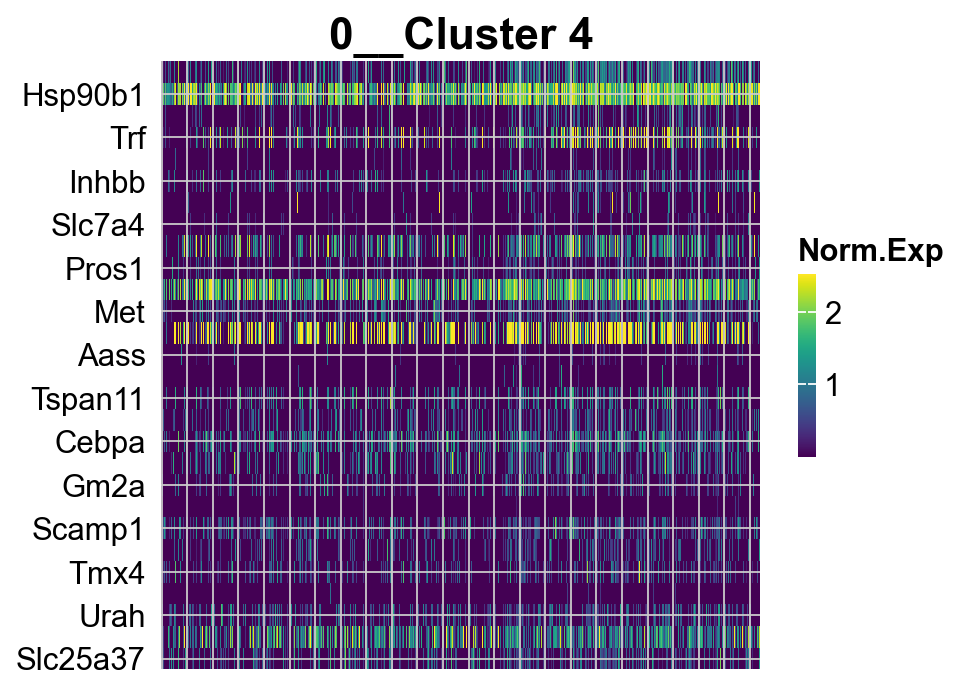

In [331]:
## Heatmap of gene expression
i = 7
genes = res.res2d.Lead_genes.iloc[i].split(";")
ax = gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(6,5),
           cmap=plt.cm.viridis,
           xticklabels=False)

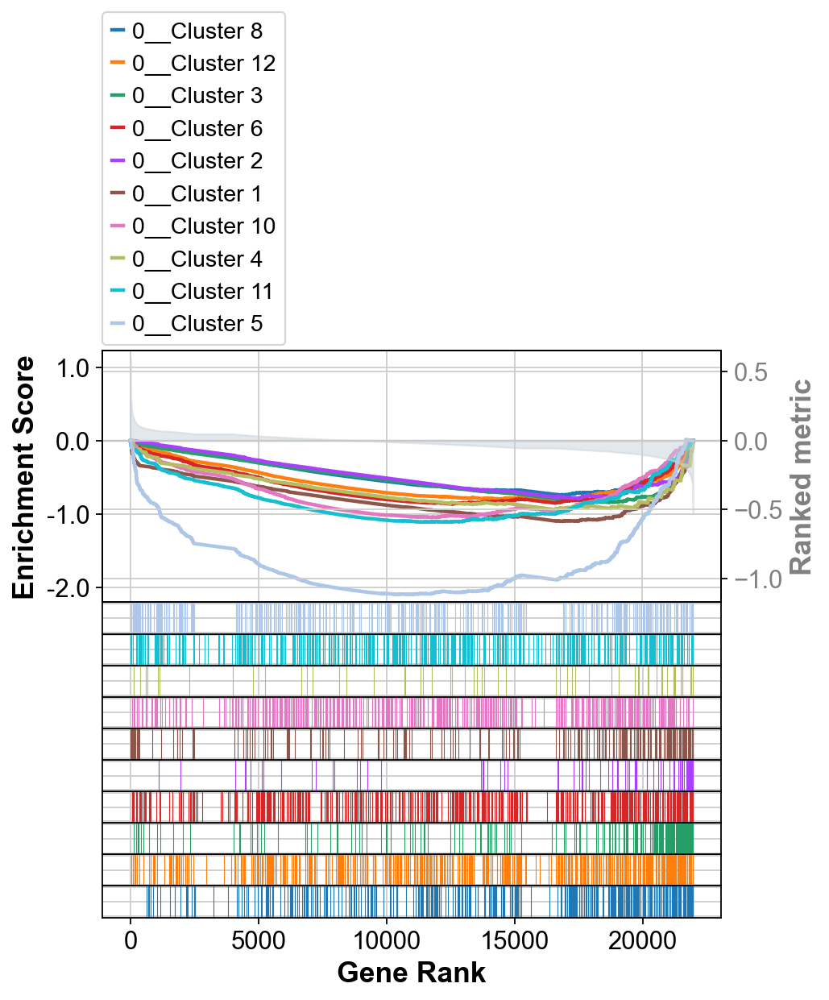

In [332]:
term = res.res2d.Term
# gp.gseaplot(res.ranking, term=term[i], **res.results[term[i]])
axs = res.plot(terms=term[:10])

In [333]:
sc.tl.rank_genes_groups(bdata,
                        groupby='Group',
                        use_raw=False,
                        method='wilcoxon',
                        groups=["shRel"],
                        reference='shRenilla')

ranking genes


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


In [334]:
bdata.X.max() # already log1p

8.601066

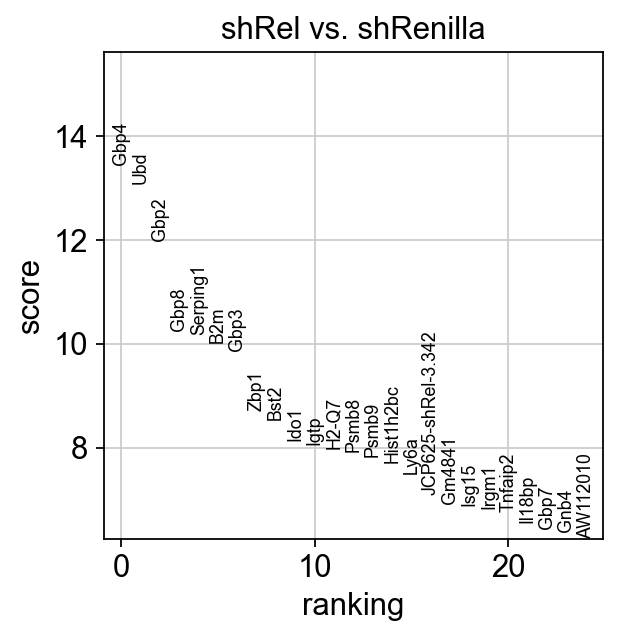

In [335]:
sc.pl.rank_genes_groups(bdata, n_genes=25, sharey=False)

In [336]:
# get deg result
result = bdata.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})

In [337]:
bdata.obs[['Group','Classification']].value_counts(sort=False)

Group      Classification       
shRel      BE1490_B0309             253
           BE1491-NT_B0310          131
           BE1662_B0311              56
shRenilla  BF1087_B0313             326
           BF1240_(BE1834)_B0312      7
Name: count, dtype: int64

In [338]:
degs_sig = degs[degs.shRel_pvals_adj < 0.05]
degs_up = degs_sig[degs_sig.shRel_logfoldchanges > 0]
degs_dw = degs_sig[degs_sig.shRel_logfoldchanges < 0]

In [339]:
enr_res0up = gseapy.enrichr(gene_list=degs_up.shRel_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0up.results.to_excel("write/shRela_up.xlsx")
enr_res0up.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,16/240,1.136776e-10,9.094205e-10,12.123821,277.607077,H2-Eb1;Psmb8;Bst2;Gm12216;Ifi27l2a;H2-Ab1;Tap1...
1,gs_ind_0,Cluster 10,2/500,9.587112e-01,9.587112e-01,0.481779,0.020314,Irf8;Misp
2,gs_ind_0,Cluster 11,4/500,7.105902e-01,9.587112e-01,0.920259,0.314415,Hist1h2bc;Upp1;Gnb4;Colec12
3,gs_ind_0,Cluster 12,4/500,7.105902e-01,9.587112e-01,0.920259,0.314415,Sp140;Grina;Hist1h1c;Parp3
4,gs_ind_0,Cluster 4,2/63,1.181094e-01,3.149583e-01,4.378862,9.353881,Pla2g16;H2-T23
5,gs_ind_0,Cluster 5,7/406,8.157031e-02,3.149583e-01,2.138153,5.358832,Itga3;Tpm1;Osbpl3;Gng5;Trim15;Ly6a;Krt18
6,gs_ind_0,Cluster 6,3/500,8.669739e-01,9.587112e-01,0.694555,0.099145,Cavin3;Tpm2;Stat1
7,gs_ind_0,Cluster 9,1/248,9.111865e-01,9.587112e-01,0.606612,0.056420,Rps20


In [340]:
enr_res0down = gseapy.enrichr(gene_list=degs_dw.shRel_names,
                     organism='Mouse',
                     gene_sets=gsets,
#                     description='pathway',
                     cutoff = 0.5)
enr_res0down.results.to_excel("write/shRela_down.xlsx")
enr_res0down.results.head(20)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,Genes
0,gs_ind_0,Cluster 1,66/240,6.991526e-10,4.194916e-09,2.731469,5.758252e+01,Tinag;Prrg3;Nfkbiz;Nrp1;Zfp131;Ramp1;Iah1;Rnas...
1,gs_ind_0,Cluster 10,35/500,9.999988e-01,1.000000e+00,0.469645,5.848848e-07,Txndc5;Golga4;Nectin4;Reep3;Plxnb1;Aco1;Gprc5c...
2,gs_ind_0,Cluster 11,22/500,1.000000e+00,1.000000e+00,0.281185,3.802328e-13,Creb3l2;Hspb1;Nrn1;Tead2;Bmp1;Smad7;Fn1;Timp2;...
3,gs_ind_0,Cluster 12,71/500,2.420636e-01,4.841272e-01,1.115983,1.583083e+00,Tspo;Ociad2;1700020I14Rik;Tmem123;Ubr3;Wfdc2;N...
4,gs_ind_0,Cluster 2,28/82,6.861721e-07,2.744688e-06,3.593598,5.100084e+01,Slco4c1;Npw;Lbp;Smarca2;Atp11a;Fasn;Sfta2;Arfg...
5,gs_ind_0,Cluster 3,89/209,1.088238e-27,1.305885e-26,5.681256,3.527221e+02,Hopx;Flrt3;Rasgef1b;Wls;4930523C07Rik;Il10rb;H...
6,gs_ind_0,Cluster 4,14/63,3.065449e-02,7.357078e-02,1.962543,6.839416e+00,Slc15a2;Tmem50b;Pros1;Lcn2;Cebpa;Trf;Inhbb;Cyp...
7,gs_ind_0,Cluster 5,52/406,6.020534e-01,9.030801e-01,0.977011,4.957444e-01,Trib1;Ube2d3;F11r;Tead1;Cdc42;Neat1;Krt23;Chrn...
8,gs_ind_0,Cluster 6,66/500,5.001178e-01,8.573448e-01,1.013652,7.023715e-01,Ldha;Usp47;Serinc2;Cd55;C1galt1;Clip1;Mecom;Tj...
9,gs_ind_0,Cluster 7,6/500,1.000000e+00,1.000000e+00,0.075872,-0.000000e+00,Stmn1;Dnajc9;Hat1;Nasp;Fzd2;Ckap4


/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

<Axes: title={'center': 'shRel Down'}, xlabel='Combined Score'>

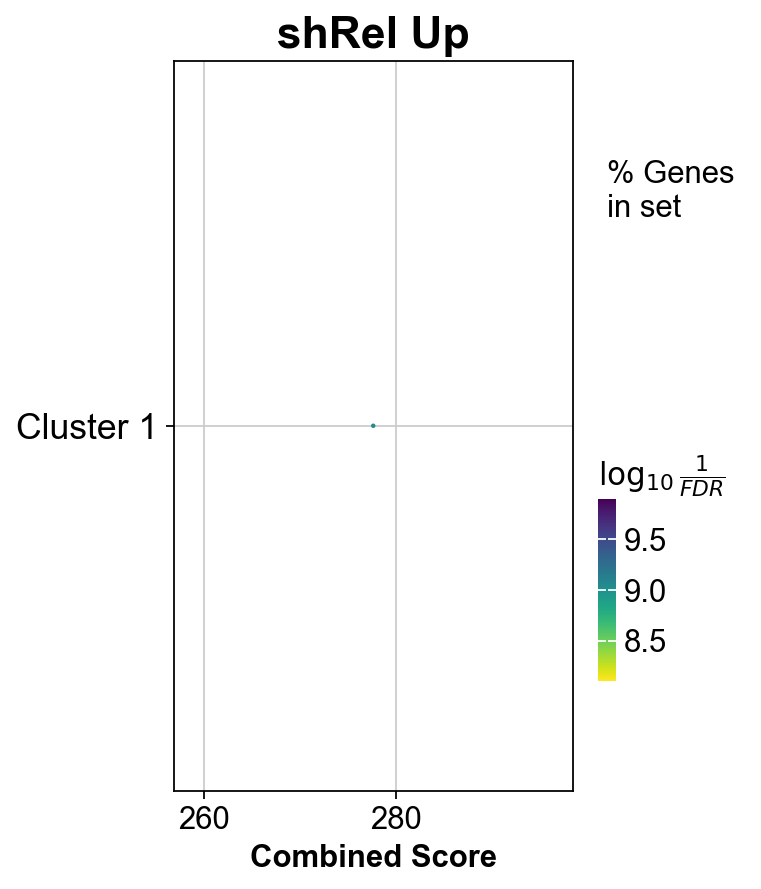

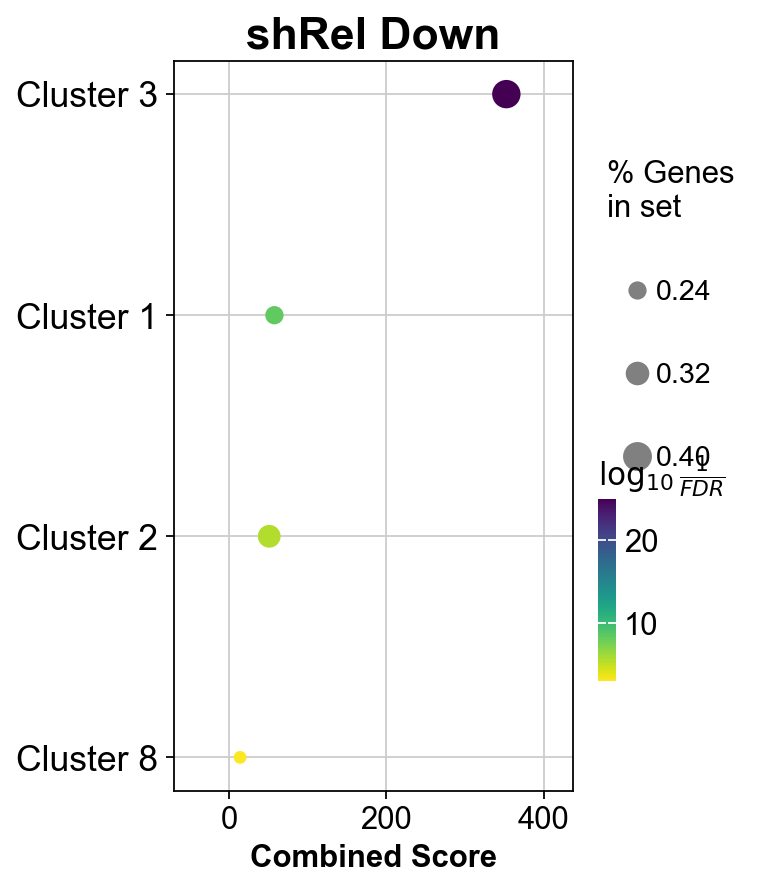

In [341]:
gseapy.dotplot(enr_res0up.res2d,title="shRel Up" % gsets)
gseapy.dotplot(enr_res0down.res2d,title="shRel Down" % gsets)

In [342]:
gseapy.dotplot(enr_res0up.res2d,title="%s shNfkb1 Up" % gsets)
gseapy.dotplot(enr_res0down.res2d,title="%s shNfkb1 Down" % gsets)
grseapy.dotplot(enr_res1up.res2d,title="%s shRela Up" % gsets)
gseapy.dotplot(enr_res1down.res2d,title="%s shRela Down" % gsets)
gseapy.dotplot(enr_res2up.res2d,title="%s shRel Up" % gsets)
gseapy.dotplot(enr_res2down.res2d,title="%s shRel Down" % gsets)
#gseapy.barplot(enr_res2.res2d,title="%s Cluster 2" % gsets)

/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(
/Users/chanj2/opt/miniconda3/envs/scanalysis20240131/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: Th

NameError: name 'grseapy' is not defined

Error in callback <function _draw_all_if_interactive at 0x1af0f9b20> (for post_execute), with arguments args (),kwargs {}:


RuntimeError: In draw_glyphs_to_bitmap: Could not convert glyph to bitmap (raster overflow; error code 0x62)

ValueError: Image size of 793104x889 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 320x480 with 2 Axes>

ValueError: Image size of 793166x889 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 320x480 with 2 Axes>